<div style="background-color: darkslategray; color: white; padding: 15px; border-radius: 8px;">
    <center><h1 style="font-family: Arial, sans-serif;">ABCDEats Inc.</h1></center>
    <center><h3 style="font-family: Arial, sans-serif;">Data Mining Project</h3></center>
</div>


**<h3>Table of Contents</h3>**
* [1. Environment Setup](#1.-Environment-Setup)
    * [1.1 Importing Libraries](#1.1-Importing-Libraries)
    * [1.2 Importing the data set](#1.2-Importing-the-data-set)
    * [1.3 Functions](#1.3-Functions)
* [2. Exploratory Data Analysis](#2.-Exploratory-Data-Analysis)
    * [2.1 General analysis of the data set](#2.1-General-analysis-of-the-data-set)
        * [2.1.1 Treating duplicates](#2.1.1-Treating-duplicates)
        * [2.1.2 Data Coherence](#2.1.2-Data-Coherence)
        * [2.1.3 Missing Values](#2.1.3-Missing-Values)
    * [2.2 Quantitative features Analysis](#2.2-Quantitative-features-Analysis)
    * [2.3 Qualitative features Analysis](#2.3-Qualitative-features-Analysis)
    * [2.4 Feature Engineering](#2.4-Feature-Engineering)
    * [2.5 Multivariate Analysis](#2.5-Multivariate-Analysis)
* [3. Data Preprocessing](#3-Data-Preprocessing)
    * [3.1 Missing Values Treatment](#3.1-Missing-Values-Treatment)
    * [3.2 Outlier Treatment](#3.2-Outlier-Treatment)
    * [3.3 Scaling Data](#3.3-Scaling-Data)
    * [3.4 Encoding](#3.4-Encoding)
    * [3.5 Feature Engineering after Missings and Outliers Treatment](#3.5-Feature-Engineering-after-Missings-and-Outliers-Treatment)
* [4. Clustering](#4-Clustering)
    * [4.1 Perspective 1: Diversity Spending Profile](#4.1-Perspective-1-Diversity-Spending-Profile)
        * [4.1.1 Hierarchical Clustering](#4.1.1-Hierarchical-Clustering)
        * [4.1.2 K-Means](#4.1.2-K-Means)
        * [4.1.3 SOM](#4.1.3-SOM)
        * [4.1.4 Density Clustering](#4.1.4-Density-Clustering)
    * [4.2 Perspective 2: Meal Period](#4.2-Perspective-2-Meal-Period)
        * [4.2.1 Hierarchical Clustering](#4.2.1-Hierarchical-Clustering)
        * [4.2.2 K-Means](#4.2.2-K-Means)
        * [4.2.3 SOM](#4.2.3-SOM)
        * [4.2.4 Density Clustering](#4.2.4-Density-Clustering)
    * [4.3 Perspective 3: Diversity Order Profile](#4.3-Perspective-3-Diversity-Order-Profile)
        * [4.3.1 Hierarchical Clustering](#4.3.1-Hierarchical-Clustering)
        * [4.3.2 K-Means](#4.3.2-K-Means)
        * [4.3.3 SOM](#4.3.3-SOM)
        * [4.3.4 Density Clustering](#4.3.4-Density-Clustering)
    * [4.4 Perspective 4: Global Features](#4.4-Perspective-4-Global-Features)
        * [4.4.1 Hierarchical Clustering](#4.4.1-Hierarchical-Clustering)
        * [4.4.2 K-Means](#4.4.2-K-Means)
        * [4.4.3 SOM](#4.4.3-SOM)
        * [4.4.4 Density Clustering](#4.4.4-Density-Clustering)
    * [4.5 Multiple Perspectives](#46-multiple-perspectives)
        * [4.5.1 Merging Perspectives](#4.5.1-Merging-Perspectives)
        * [4.5.2 Merging using Hierarchical Clustering](#4.5.2-Merging-using-Hierarchical-Clustering)
        * [4.5.3 Merging using K-Means](#4.5.2-Merging-using-K-Means)
        * [4.5.4 Cluster Analysis](#4.5.4-Cluster-Analysis)
* [5. Profiling](#5-Profiling)
    * [5.1 Last Promo](#5.1-Last-Promo)
    * [5.2 Payment Method](#5.2-Payment-Method)
    * [5.3 Customer Region](#5.3-Customer-Region)
    * [5.4 Customer Age](#5.4-Customer-Age)
    * [5.5 Cuisines](#5.5-Cuisines)


# 1. Environment Setup

## 1.1 Importing libraries

In [1]:
import numpy as np
import pandas as pd
import collections as col
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.stats import chi2_contingency

from sklearn.impute import KNNImputer
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder
from sklearn.cluster import KMeans

from os.path import join
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram

from sklearn.metrics import calinski_harabasz_score, davies_bouldin_score, silhouette_score, silhouette_samples

from sklearn.neighbors import KNeighborsClassifier, NearestNeighbors

from minisom import MiniSom
from matplotlib.patches import RegularPolygon, Ellipse
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import cm, colorbar
from matplotlib import colors as mpl_colors
from matplotlib.colors import LinearSegmentedColormap

from matplotlib.lines import Line2D
import seaborn as sns

from matplotlib import __version__ as mplver
from math import sqrt, ceil

from sklearn.mixture import GaussianMixture
from sklearn.cluster import MeanShift, DBSCAN, estimate_bandwidth

from itertools import combinations
import random

from sklearn.manifold import TSNE

## 1.2 Importing the data set

In [2]:
data=pd.read_csv('DM2425_ABCDEats_DATASET.csv',sep=',')

In [3]:
data.head()

,customer_id,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
0,1b8f824d5e,2360,18.0,2,5,1,0.0,1,DELIVERY,DIGI,...,0,0,0,0,2,0,0,0,0,0
1,5d272b9dcb,8670,17.0,2,2,2,0.0,1,DISCOUNT,DIGI,...,0,0,0,0,0,0,0,0,0,0
2,f6d1b2ba63,4660,38.0,1,2,2,0.0,1,DISCOUNT,CASH,...,0,0,0,0,0,0,0,0,0,0
3,180c632ed8,4660,NaN,2,3,1,0.0,2,DELIVERY,DIGI,...,1,0,0,0,0,0,0,0,0,0
4,4eb37a6705,4660,20.0,2,5,0,0.0,2,-,DIGI,...,0,0,0,0,0,0,0,0,0,0


In [4]:
data.tail()  # to check if the last row is the total

,customer_id,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
31883,f4e366c281,8670,30.0,1,1,1,NaN,0,FREEBIE,DIGI,...,0,0,0,0,0,0,0,0,0,0
31884,f6b6709018,8670,NaN,1,1,0,NaN,0,DELIVERY,DIGI,...,0,0,1,0,0,0,0,0,0,0
31885,f74ad8ce3f,8670,24.0,1,1,1,NaN,0,-,DIGI,...,0,0,0,0,0,0,0,0,0,0
31886,f7b19c0241,8670,34.0,1,1,0,NaN,0,DISCOUNT,DIGI,...,0,0,0,0,0,0,0,0,0,0
31887,fd40d3b0e0,4660,30.0,1,1,0,NaN,0,-,CASH,...,0,0,1,0,0,0,0,0,0,0


## 1.3 Functions

In [5]:
def knn_impute_column(data, column_to_impute, n_neighbors=5):
    """
    Impute missing values in a specific column using k-NN imputation.
    This function ensures that only the specified column is updated, without scaling the entire DataFrame.
    """
    # Select numerical columns to use as features for k-NN imputation
    features_for_knn = data.select_dtypes(exclude=['object', 'category']).columns
    features_for_knn = [col for col in features_for_knn if col != column_to_impute]

    # Combine columns for imputation
    imputation_data = data[[column_to_impute] + features_for_knn]

    # Scale the features
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(imputation_data)

    # Perform k-NN imputation
    knn_imputer = KNNImputer(n_neighbors=n_neighbors)
    imputed_data = knn_imputer.fit_transform(scaled_data)

    # Inverse transform the scaled data back to original scale
    imputed_data_original_scale = scaler.inverse_transform(imputed_data)

    # Convert the result back to a DataFrame
    imputed_df = pd.DataFrame(imputed_data_original_scale, columns=imputation_data.columns, index=data.index)

    # Update the original data with the imputed values for the specified column
    data[column_to_impute] = imputed_df[column_to_impute]

    return data

# Let's wrap them into functions

def get_ss(df, feats):
    """
    Calculate the sum of squares (SS) for the given DataFrame.

    """
    df_ = df[feats]
    ss = np.sum(df_.var() * (df_.count() - 1))
    
    return ss 


def get_ssb(df, feats, label_col):
    """
    Calculate the between-group sum of squares (SSB) for the given DataFrame.
    The between-group sum of squares is computed as the sum of the squared differences
    between the mean of each group and the overall mean, weighted by the number of observations
    in each group.

    """
    
    ssb_i = 0
    for i in np.unique(df[label_col]):
        df_ = df.loc[:, feats]
        X_ = df_.values
        X_k = df_.loc[df[label_col] == i].values
        
        ssb_i += (X_k.shape[0] * (np.square(X_k.mean(axis=0) - X_.mean(axis=0))) )

    ssb = np.sum(ssb_i)
    

    return ssb


def get_ssw(df, feats, label_col):
    """
    Calculate the sum of squared within-cluster distances (SSW) for a given DataFrame.

    """
    feats_label = feats+[label_col]

    df_k = df[feats_label].groupby(by=label_col).apply(lambda col: get_ss(col, feats), 
                                                       include_groups=False)

    return df_k.sum()


def get_rsq(df, feats, label_col):
    """
    Calculate the R-squared value for a given DataFrame and features.

    """

    df_sst_ = get_ss(df, feats)                 # get total sum of squares
    df_ssw_ = get_ssw(df, feats, label_col)     # get ss within
    df_ssb_ = df_sst_ - df_ssw_                 # get ss between

    # r2 = ssb/sst 
    return (df_ssb_/df_sst_)
    


def get_r2_hc(df, link_method, max_nclus, min_nclus=1, dist="euclidean"):
    """This function computes the R2 for a set of cluster solutions given by the application of a hierarchical method.
    The R2 is a measure of the homogenity of a cluster solution. It is based on SSt = SSw + SSb and R2 = SSb/SSt. 
    
    """
    
    r2 = []  # where we will store the R2 metrics for each cluster solution
    feats = df.columns.tolist()
    
    for i in range(min_nclus, max_nclus+1):  # iterate over desired ncluster range
        
        cluster = AgglomerativeClustering(n_clusters=i, metric=dist, linkage=link_method)
        
        # get cluster labels
        hclabels = cluster.fit_predict(df) 
        
        # concat df with labels
        df_concat = pd.concat([df, pd.Series(hclabels, name='labels', index=df.index)], axis=1)  
        
        
        # append the R2 of the given cluster solution
        r2.append(get_rsq(df_concat, feats, 'labels'))
        
    return np.array(r2)

def winsorize(data, column, lower_percentile, upper_percentile):
    """
    Performs winsorization on a numerical dataset by replacing extreme values
    with the values at specified percentiles.

    """
    
    # Calculate the percentile thresholds
    lower_bound = data[column].quantile(lower_percentile).round()
    upper_bound = data[column].quantile(upper_percentile).round()

    winsorized_data = data.copy()
    winsorized_data[column] = winsorized_data[column].apply(lambda x: lower_bound if x < lower_bound else upper_bound if x > upper_bound else x)
    
    return winsorized_data

In [6]:
def silhouette_analysis(data, labels, n_clusters):
    # Compute silhouette score
    silhouette_avg = silhouette_score(data, labels)
    silhouette_values = silhouette_samples(data, labels)

    print(f"Number of clusters: {n_clusters}")
    print(f"Average Silhouette Score: {silhouette_avg}\n")

    # Calculate and print silhouette score for each cluster
    for i in range(n_clusters):
        cluster_silhouette_values = silhouette_values[labels == i]
        cluster_avg = np.mean(cluster_silhouette_values)
        print(f"Cluster {i}: Average Silhouette Score = {cluster_avg}")

    # Visualize Silhouette Scores
    y_lower = 10
    plt.figure(figsize=(10, 6))

    for i in range(n_clusters):
        # Aggregate silhouette scores for cluster i
        cluster_silhouette_values = silhouette_values[labels == i]
        cluster_silhouette_values.sort()

        size_cluster_i = cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        # Plot each cluster's silhouette
        plt.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            cluster_silhouette_values,
            alpha=0.7
        )
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10  # Add space between clusters

    # Overall silhouette score line
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    plt.title(f"Silhouette Plot for {n_clusters} Clusters")
    plt.xlabel("Silhouette Coefficient")
    plt.ylabel("Cluster")

    plt.show()

def evaluate_clustering_metrics(data, labels):
    ch_score = calinski_harabasz_score(data, labels)
    db_score = davies_bouldin_score(data, labels)
    print(f"Calinski-Harabasz Index: {ch_score}")
    print(f"Davies-Bouldin Index: {db_score}\n")

In [7]:
def plot_hexagons(som,              # Trained SOM model 
                  sf,               # matplotlib figure object
                  colornorm,        # colornorm
                  matrix_vals,      # SOM weights or
                  label="",         # title for figure
                  cmap=cm.Grays,    # colormap to use
                  annot=False       
                  ):

    
    axs = sf.subplots(1,1)
    
    for i in range(matrix_vals.shape[0]):
        for j in range(matrix_vals.shape[1]):

            wx, wy = som.convert_map_to_euclidean((i,j)) 

            hex = RegularPolygon((wx, wy), 
                                numVertices=6, 
                                radius= np.sqrt(1/3),
                                facecolor=cmap(colornorm(matrix_vals[i, j])), 
                                alpha=1, 
                                edgecolor='white',
                                linewidth=.5)
            axs.add_patch(hex)
            if annot==True:
                annot_val = np.round(matrix_vals[i,j],2)
                if int(annot_val) == annot_val:
                    annot_val = int(annot_val)
                axs.text(wx,wy, annot_val, 
                        ha='center', va='center', 
                        fontsize='x-small')


    ## Remove axes for hex plot
    axs.margins(.05)
    axs.set_aspect('equal')
    axs.axis("off")
    axs.set_title(label)

    

    # ## Add colorbar
    divider = make_axes_locatable(axs)
    ax_cb = divider.append_axes("right", size="5%", pad="0%")

    ## Create a Mappable object
    cmap_sm = plt.cm.ScalarMappable(cmap=cmap, norm=colornorm)
    cmap_sm.set_array([])

    ## Create custom colorbar 
    cb1 = colorbar.Colorbar(ax_cb,
                            orientation='vertical', 
                            alpha=1,
                            mappable=cmap_sm
                            )
    cb1.ax.get_yaxis().labelpad = 6

    # Add colorbar to plot
    sf.add_axes(ax_cb)

    return sf 

def calculate_grid_size(n_samples, aspect_ratio=1):
    """Calculate M x N grid size for SOM based on dataset size and aspect ratio.
    """
    total_neurons = ceil(5 * sqrt(n_samples))  # Heuristic for total neurons
    M = ceil(sqrt(total_neurons * aspect_ratio))
    N = ceil(sqrt(total_neurons / aspect_ratio))
    return M, N

def get_ss_2(df):
    ss = np.sum(df.var() * (df.count() - 1))  # Sum of squares
    return ss

In [8]:
def get_r2_scores(df, feats, clusterer, min_k=2, max_k=10):
    """
    Loop over different values of k. To be used with sklearn clusterers.
    """
    r2_clust = {}
    for n in range(min_k, max_k):
        clust = clone(clusterer).set_params(n_clusters=n)
        labels = clust.fit_predict(df)
        df_concat = pd.concat([df, 
                               pd.Series(labels, name='labels', index=df.index)], axis=1)  

        r2_clust[n] = get_rsq(df_concat, feats, 'labels' )
    return r2_clust



In [9]:
def feature_combinations_clustering(X, n_clusters=3, n_combinations=50, subset_sizes=(4, 5, 6)):
    """
    Evaluate clustering quality for a random subset of specific feature combinations using multiple metrics.
    Parameters:
        X (pd.DataFrame): Input dataset with features.
        n_clusters (int): Number of clusters for KMeans.
        n_combinations (int): Number of random combinations to evaluate.
        subset_sizes (tuple): Sizes of feature combinations to consider (e.g., (4, 5, 6)).
    Returns:
        pd.DataFrame: Ranked feature combinations with scores for all metrics.
    """
    results = []
    all_features = X.columns
    all_possible_combinations = []

    # Generate combinations of specified sizes
    for r in subset_sizes:
        all_possible_combinations += list(combinations(all_features, r))

    # Randomly sample combinations
    random_combinations = random.sample(all_possible_combinations, min(n_combinations, len(all_possible_combinations)))

    for combination in random_combinations:
        subset = X[list(combination)]
        
        # Perform clustering
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        labels = kmeans.fit_predict(subset)
        
        # Evaluate clustering quality using all metrics
        silhouette = silhouette_score(subset, labels)
        calinski_harabasz = calinski_harabasz_score(subset, labels)
        davies_bouldin = davies_bouldin_score(subset, labels)
        
        # Store results
        results.append({
            'Features': combination,
            'Silhouette': silhouette,
            'Calinski-Harabasz': calinski_harabasz,
            'Davies-Bouldin': davies_bouldin
        })
    
    # Convert results to a DataFrame
    results_df = pd.DataFrame(results)
    # Sort by Silhouette (or another metric if preferred)
    results_df = results_df.sort_values(by='Silhouette', ascending=False)
    return results_df

In [10]:
def cluster_profiles(df, label_columns, figsize, 
                     cmap="tab10",
                     compare_titles=None):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this label columns to perform the cluster profile according to them.
    """
    
    if compare_titles == None:
        compare_titles = [""]*len(label_columns)
        
    fig, axes = plt.subplots(nrows=len(label_columns), 
                             ncols=2, 
                             figsize=figsize, 
                             constrained_layout=True,
                             squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compare_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, 
                                            label, 
                                            color = sns.color_palette(cmap),
                                            ax=ax[0])



        sns.barplot(x=label, 
                    hue=label,
                    y="counts", 
                    data=counts, 
                    ax=ax[1], 
                    palette=sns.color_palette(cmap),
                    legend=False
                    )

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(text=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), 
                              rotation=40,
                              ha='right'
                              )
        
        ax[0].legend(handles, cluster_labels,
                     loc='center left', bbox_to_anchor=(1, 0.5), title=label
                     ) # Adaptable to number of clusters
        
        ax[1].set_xticks([i for i in range(len(handles))])
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
        
        
    
    # plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.suptitle("Cluster Simple Profiling", fontsize=23)
    plt.show()

# 2. Exploratory Data Analysis

## 2.1 General analysis of the data set

In [11]:
# Number of rows and columns in the data set
print('Total Rows:', data.shape[0]) 
print('Total Columns:', data.shape[1])

Total Rows: 31888
Total Columns: 56


In [12]:
# Name of the columns
data.columns

Index(['customer_id', 'customer_region', 'customer_age', 'vendor_count',
       'product_count', 'is_chain', 'first_order', 'last_order', 'last_promo',
       'payment_method', 'CUI_American', 'CUI_Asian', 'CUI_Beverages',
       'CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts',
       'CUI_Healthy', 'CUI_Indian', 'CUI_Italian', 'CUI_Japanese',
       'CUI_Noodle Dishes', 'CUI_OTHER', 'CUI_Street Food / Snacks',
       'CUI_Thai', 'DOW_0', 'DOW_1', 'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5',
       'DOW_6', 'HR_0', 'HR_1', 'HR_2', 'HR_3', 'HR_4', 'HR_5', 'HR_6', 'HR_7',
       'HR_8', 'HR_9', 'HR_10', 'HR_11', 'HR_12', 'HR_13', 'HR_14', 'HR_15',
       'HR_16', 'HR_17', 'HR_18', 'HR_19', 'HR_20', 'HR_21', 'HR_22', 'HR_23'],
      dtype='object')

features:
- **customer_id**: Unique identifier for each customer. 
- **customer_region**: Geographic region where the customer is located. Categorical variable
- **customer_age**: Age of the customer. Discrete variable
- **vendor_count**: Number of unique vendors the customer has ordered from. Discrete Variable
- **product_count**: Total number of products the customer has ordered. Discrete variable
- **is_chain**: Indicates whether the customer’s order was from a chain restaurant. This variable is not clear so we will have to do further analysis
- **first_order**: Number of days from the start of the dataset when the customer first
placed an order. Discrete variable
- **last_order**: Number of days from the start of the dataset when the customer most
recently placed an order. Discrete variable
- **last_promo**: The category of the promotion or discount most recently used by the
customer. Categorical variable
- **payment_method**: Method most recently used by the customer to pay for their orders. Categorcial variable
- **CUI_[types of cuisine]**: The amount in monetary units spent by the customer from the indicated type of cuisine. Continuous variable
- **DOW_0 to DOW_6**: Number of orders placed on each day of the week. Discrete features
- **HR_0 to HR_23**: Number of orders placed during each hour of the day. Discrete features

In [13]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31888 entries, 0 to 31887
Data columns (total 56 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   customer_id               31888 non-null  object 
 1   customer_region           31888 non-null  object 
 2   customer_age              31161 non-null  float64
 3   vendor_count              31888 non-null  int64  
 4   product_count             31888 non-null  int64  
 5   is_chain                  31888 non-null  int64  
 6   first_order               31782 non-null  float64
 7   last_order                31888 non-null  int64  
 8   last_promo                31888 non-null  object 
 9   payment_method            31888 non-null  object 
 10  CUI_American              31888 non-null  float64
 11  CUI_Asian                 31888 non-null  float64
 12  CUI_Beverages             31888 non-null  float64
 13  CUI_Cafe                  31888 non-null  float64
 14  CUI_Ch

The features **customer_age**, **first_order** and **HR_0** have missing values. Also, these features should be integers.

### 2.1.1 Treating duplicates

In [14]:
print(f'There are {data.duplicated().sum()} duplicates in the dataset.')

There are 13 duplicates in the dataset.


In [15]:
data.drop_duplicates(inplace=True)
data.duplicated().sum()

0

Observation:
When we put `customer_id` as index, we have 60 duplicates. When we consider `customer_id` as a variable, we have 13 duplicates. For that reason, we didn't put `customer_id` as index.

### 2.1.2 Data Coherence

##### Customer Region

In [16]:
print(data['customer_region'].unique())

['2360' '8670' '4660' '2440' '-' '4140' '2490' '8370' '8550']


**Observations:**

The value '-' indicates a lack of information about the customer's region. Therefore, '-' should be treated as a missing value because it represents the absence of data for the customer's region. Converting it will make it easier to handle during analysis and will clearly distinguish between known customer regions and missing data.

In [17]:
data['customer_region'] = data['customer_region'].replace('-', np.nan)


##### Last Promo

In [18]:
print(data['last_promo'].unique())

['DELIVERY' 'DISCOUNT' '-' 'FREEBIE']


- **DELIVERY** : Indicates that the most recent promotion the customer used was related to delivery
- **DISCOUNT** : Indicates that the customer used a discount promotion on their most recent order
- **FREEBIE** : Indicates that the customer received a free item or service on their most recent order
- **-** : Represents customers who did not use any promotion on their most recent order.

For more clarity, we replaced "-" to "NO PROMO"

In [19]:
data['last_promo'] = data['last_promo'].replace('-', 'NO PROMO')

##### First Order

In [20]:
print(data['first_order'].unique())

[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17.
 18. 19. 20. 21. 22. 23. 24. 25. 26. 27. 28. 29. 30. 31. 32. 33. 34. 35.
 36. 37. 38. 39. 40. 41. 42. 43. 44. 45. 46. 47. 48. 49. 50. 51. 52. 53.
 54. 55. 56. 57. 58. 59. 60. 61. 62. 63. 64. 65. 66. 67. 68. 69. 70. 71.
 72. 73. 74. 75. 76. 77. 78. 79. 80. 81. 82. 83. 84. 85. 86. 87. 88. 89.
 90. nan]


In [21]:
# Filter the dataset where 'first_order' is missing
missing_first_order = data[data['first_order'].isna()]

# Check if 'last_order' is always 0
last_order_is_zero = (missing_first_order['last_order'] == 0).all()

# Check if the sum of DOW columns is always 0
dow_columns = [col for col in data.columns if col.startswith('DOW')]
dow_sum_is_zero = (missing_first_order[dow_columns].sum(axis=1) == 0).all()

print(f"Is 'last_order' always 0 when 'first_order' is missing? {last_order_is_zero}")
print(f"Is the sum of DOW columns always 0 when 'first_order' is missing? {dow_sum_is_zero}")


Is 'last_order' always 0 when 'first_order' is missing? True
Is the sum of DOW columns always 0 when 'first_order' is missing? False


In [22]:
# Filter the dataset where 'first_order' is missing
missing_first_order = data[data['first_order'].isna()]

# Calculate the sum of DOW columns where 'first_order' is missing
dow_columns = [col for col in data.columns if col.startswith('DOW')]
sum_dow_values = missing_first_order[dow_columns].sum(axis=1).value_counts()

sum_dow_values


1    104
2      2
Name: count, dtype: int64

##### HR_0

In [23]:
print(data['HR_0'].unique())

[ 0. nan]


This variable only assumes 0 or missing value.
Even though, 0 could indicate that no customer places order at midnight, it could also indicate that midnight orders were not tracked or the information was lost and improperly recorded as 0. Furthermore, the presence of missing values suggests incomplete data for this hour, enphasizing that might be a data quality issue.

This question should be considered for further validation to confirm if the zeros are valid entries or a result of missing data.

##### Is_Chain

In [24]:
print(data['is_chain'].unique())

[ 1  2  0  3  5  4  7 12  6 23  8 11 20 14  9 10 16 15 13 25 17 27 30 32
 24 18 26 28 22 40 31 39 21 37 19 33 65 38 29 45 47 73 81 56 35 46 67 44
 61 34 36 49 83 75 43 42 48 63 54 80]


In [25]:
data["is_chain"].value_counts(normalize=False)

is_chain
1     8543
0     6099
2     5892
3     3696
4     2165
5     1380
6      946
7      679
8      500
9      373
10     291
11     248
12     169
13     152
14     138
15      89
16      68
18      65
17      55
19      35
20      34
21      29
22      26
24      23
23      20
26      20
27      16
25      14
28      13
29      10
31       9
30       9
32       8
33       6
34       6
36       5
43       5
40       5
37       4
35       4
45       4
39       2
42       2
48       2
75       1
63       1
54       1
83       1
49       1
46       1
61       1
44       1
67       1
56       1
81       1
73       1
47       1
38       1
65       1
80       1
Name: count, dtype: int64

This variable is supposed to indicate whether a customer’s order was from a chain restaurant (likely intended to indicate whether an order was placed at a chain restaurant, where a 0 would mean "no" and a 1 would mean "yes").

However, it has a wide range of values that seem unexpected for a binary or categorical indicator, ranging from 0 to 83, which suggests some potential issues:
- There may be data quality problems, with unexpected values making it difficult to interpret;
- The variable could represent the **number of different chain restaurants** the customer has ordered from;
- The variable could represent the **number of orders** the customer has ordered from.

In [26]:
(data['is_chain'] > data['vendor_count']).sum()

6119

The analysis shows that in 6119 records, the is_chain value is greater than the vendor_count, which means:
- If is_chain was meant to count the number of chain restaurants, it cannot logically exceed the vendor_count.
- This suggests that this variable don't represent the **number of different chain restaurants** the customer has ordered from

In [27]:
chain_greater_orders = (data['is_chain'] > data[[col for col in data.columns if col.startswith('DOW')]].sum(axis=1))
chain_greater_orders.sum()

75

In [28]:
# Create a subset of the data where the condition is true
filtered_data = data[chain_greater_orders]

# Calculate the sum of all 'DOW_' columns for the filtered data
dow_sum_filtered = filtered_data[[col for col in data.columns if col.startswith('DOW')]].sum(axis=1)

# Create a DataFrame with 'is_chain' and the sum of 'DOW_' columns for the filtered data
chain_dow_combinations_filtered = pd.DataFrame({
    'is_chain': filtered_data['is_chain'],
    'dow_sum': dow_sum_filtered
})

# Get the distinct combinations of 'is_chain' and 'dow_sum'
distinct_combinations_filtered = chain_dow_combinations_filtered.drop_duplicates()

print("Distinct combinations of 'is_chain' and the sum of 'DOW' columns for the filtered subset:")
print(distinct_combinations_filtered)



Distinct combinations of 'is_chain' and the sum of 'DOW' columns for the filtered subset:
      is_chain  dow_sum
1449         1        0


It appears that is_chain may actually represent the number of orders placed by a customer at chain restaurants, since only 75 records have is chain greater than the total orders (these would be an anomaly because it suggets that there are more chain orders than the total number of orders).
Additionally in these 75 records the value of is_chain was exactly 1 while total_orders was 0, so we proceed to correct it.

Firstly, we checked if in those 75 records the total spending is 0. If so, it would be correct to assume that is_chain is 0.

In [29]:
# Sum the values of all 'CUI_' columns for the filtered data
cui_columns = [col for col in data.columns if col.startswith('CUI')]
cui_sum = filtered_data[cui_columns].sum(axis=1)

# Check if all rows in this subset have a sum of zero for the 'CUI_' columns
all_cui_zero = (cui_sum == 0).all()

if all_cui_zero:
    print("In the subset of chain_greater_orders, the total spending is 0 for every record.")
else:
    print("In the subset of chain_greater_orders, there are records where the total spending is not 0.")


In the subset of chain_greater_orders, the total spending is 0 for every record.


We assume that in those 75 records is chain must be 0.

In [30]:
# Correct the is_chain values to 0 where the condition is met
data.loc[chain_greater_orders, 'is_chain'] = 0

#### 2.1.3 Missing Values

In [31]:
print("Percentage of Missing Values")

missing_percentage = (data.isnull().sum() / data.shape[0]) * 100
print(missing_percentage.round(1).astype(str) + '%')

Percentage of Missing Values
customer_id                 0.0%
customer_region             1.4%
customer_age                2.3%
vendor_count                0.0%
product_count               0.0%
is_chain                    0.0%
first_order                 0.3%
last_order                  0.0%
last_promo                  0.0%
payment_method              0.0%
CUI_American                0.0%
CUI_Asian                   0.0%
CUI_Beverages               0.0%
CUI_Cafe                    0.0%
CUI_Chicken Dishes          0.0%
CUI_Chinese                 0.0%
CUI_Desserts                0.0%
CUI_Healthy                 0.0%
CUI_Indian                  0.0%
CUI_Italian                 0.0%
CUI_Japanese                0.0%
CUI_Noodle Dishes           0.0%
CUI_OTHER                   0.0%
CUI_Street Food / Snacks    0.0%
CUI_Thai                    0.0%
DOW_0                       0.0%
DOW_1                       0.0%
DOW_2                       0.0%
DOW_3                       0.0%
DOW_4         

Upon observation, the **customer_age** has 2.3% of missing values, **customer region** 1.4%, **first_order** has 0.3% and **HR_0** has 3.7%.

## 2.2 Quantitative features Analysis

In [32]:
cuisine_features = [col for col in data.columns if col.startswith('CUI')]
weekday_features = [col for col in data.columns if col.startswith('DOW')]
hourly_features = [col for col in data.columns if col.startswith('HR')]
other_features = [col for col in data.columns if col not in (cuisine_features + weekday_features + hourly_features) and data[col].dtype != 'object']

cuisine_features, weekday_features, hourly_features, other_features


(['CUI_American',
  'CUI_Asian',
  'CUI_Beverages',
  'CUI_Cafe',
  'CUI_Chicken Dishes',
  'CUI_Chinese',
  'CUI_Desserts',
  'CUI_Healthy',
  'CUI_Indian',
  'CUI_Italian',
  'CUI_Japanese',
  'CUI_Noodle Dishes',
  'CUI_OTHER',
  'CUI_Street Food / Snacks',
  'CUI_Thai'],
 ['DOW_0', 'DOW_1', 'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5', 'DOW_6'],
 ['HR_0',
  'HR_1',
  'HR_2',
  'HR_3',
  'HR_4',
  'HR_5',
  'HR_6',
  'HR_7',
  'HR_8',
  'HR_9',
  'HR_10',
  'HR_11',
  'HR_12',
  'HR_13',
  'HR_14',
  'HR_15',
  'HR_16',
  'HR_17',
  'HR_18',
  'HR_19',
  'HR_20',
  'HR_21',
  'HR_22',
  'HR_23'],
 ['customer_age',
  'vendor_count',
  'product_count',
  'is_chain',
  'first_order',
  'last_order'])

### 2.2.1 Cuisine Types

In [33]:
data[cuisine_features].describe().round(2)


,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai
count,31875.00,31875.00,31875.00,31875.00,31875.00,31875.00,31875.00,31875.00,31875.00,31875.00,31875.00,31875.00,31875.00,31875.00,31875.00
mean,4.88,9.96,2.30,0.80,0.77,1.43,0.88,0.95,1.63,3.23,3.00,0.71,3.00,3.91,0.84
std,11.65,23.56,8.48,6.43,3.66,8.19,5.26,5.83,7.44,11.25,10.18,4.54,9.77,15.55,4.43
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
50%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
75%,5.66,11.83,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
max,280.21,896.71,229.22,326.10,219.66,739.73,230.07,255.81,309.07,468.33,706.14,275.11,366.08,454.45,136.38


Relevant insights:
- The highest average spending is for CUI_Asian at 9.96 units followed by CUI_American with an average of 4.88.
- Other categories like CUI_Beverages (2.30) and CUI_Cafe (0.80) show lower average spending.
- The minimum value for all cuisine features is 0 suggesting hat some customers did not order from that specific cuisine.
- The 50% values for all cuisine features are 0, suggesting that over half of the customers did not order from these specific cuisines.

In [34]:
# Dictionary to store the sums of the columns of cuisine types
dic = {} 
for col in cuisine_features:
       dic[col] = data[col].sum()

# Convert the dictionary to a DataFrame
df_dic = pd.DataFrame(list(dic.items()), columns=['Cuisine Type', 'Total Spending'])

# Create the radar chart
fig = px.line_polar(df_dic, r='Total Spending', theta='Cuisine Type', line_close=True,
                    title='Total Spending on Each Cuisine Type')
fig.show()

In [35]:
set2_palette = ['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f', '#e5c494', '#b3b3b3']

# Plot pie chart
fig = px.pie(df_dic, values='Total Spending', names='Cuisine Type', 
             title='Percentage of Spending by Cuisine Type', 
             color_discrete_sequence=set2_palette)
fig.show()

Even though we have Japanese, Chinese and Thai Cuisine, we also have Asian Cuisine. Are those features related?

In [36]:
# Check for rows where CUI_Asian is not equal to the sum of CUI_Japanese, CUI_Chinese, and CUI_Thai
asian_mismatch = data[data['CUI_Asian'] != data[['CUI_Japanese', 'CUI_Chinese', 'CUI_Thai']].sum(axis=1)]

asian_mismatch[['CUI_Asian', 'CUI_Japanese', 'CUI_Chinese', 'CUI_Thai']]

,CUI_Asian,CUI_Japanese,CUI_Chinese,CUI_Thai
1,6.39,0.00,0.0,0.0
3,13.70,0.00,0.0,0.0
4,40.87,0.00,0.0,0.0
5,24.92,0.00,0.0,0.0
9,32.48,0.00,0.0,0.0
...,...,...,...,...
31863,0.00,4.71,0.0,0.0
31866,0.00,11.69,0.0,0.0
31871,6.13,0.00,0.0,0.0
31879,19.06,0.00,0.0,0.0


The dataset contains multiple rows where the spending in CUI_Asian does not match the combined total of spending in CUI_Japanese, CUI_Chinese, and CUI_Thai. Additionally, there are instances where spending is recorded in CUI_Japanese, CUI_Chinese, or CUI_Thai, while CUI_Asian has a value of 0. 

These results indicates that CUI_Asian don't overlaps or includes CUI_Japanese, CUI_Chinese and CUI_Thai. For this reason, this variable is treated as an independent category highlighting the independence of the features and confirming that CUI_Asian is not redundant.








##### Proportion of customers by cuisine order categories

In [37]:
main_food_cuisines = ['CUI_American', 'CUI_Asian', 'CUI_Chinese', 'CUI_Italian', 'CUI_Japanese', 'CUI_Indian', 
                      'CUI_Thai', 'CUI_Chicken Dishes', 'CUI_Noodle Dishes', 'CUI_Healthy']
beverages_addons = ['CUI_Beverages', 'CUI_Cafe', 'CUI_Desserts', 'CUI_Street Food / Snacks']

# total customers
total_customers = len(data)

# Split the customers
customers_only_main_food = ((data[main_food_cuisines].sum(axis=1) > 0) & (data[beverages_addons].sum(axis=1) == 0)).sum()
customers_only_beverages = ((data[main_food_cuisines].sum(axis=1) == 0) & (data[beverages_addons].sum(axis=1) > 0)).sum()
customers_main_food_beverages = ((data[main_food_cuisines].sum(axis=1) > 0) & (data[beverages_addons].sum(axis=1) > 0)).sum()
customers_neither = ((data[main_food_cuisines].sum(axis=1) == 0) & (data[beverages_addons].sum(axis=1) == 0)).sum()

# Calculate proportions
proportion_both = (customers_main_food_beverages / total_customers) * 100
proportion_only_main_food = (customers_only_main_food / total_customers) * 100
proportion_only_beverages = (customers_only_beverages / total_customers) * 100
proportion_neither = (customers_neither / total_customers) * 100

print(f"Proportion of customers who ordered both: {proportion_both:.2f}%")
print(f"Proportion of customers who ordered only main food: {proportion_only_main_food:.2f}%")
print(f"Proportion of customers who ordered only beverages/add-ons: {proportion_only_beverages:.2f}%")
print(f"Proportion of customers who ordered neither: {proportion_neither:.2f}%")

Proportion of customers who ordered both: 26.76%
Proportion of customers who ordered only main food: 62.14%
Proportion of customers who ordered only beverages/add-ons: 7.79%
Proportion of customers who ordered neither: 3.31%


### 2.2.2 Weekdays Orders

In [38]:
data[weekday_features].describe().round(2)

,DOW_0,DOW_1,DOW_2,DOW_3,DOW_4,DOW_5,DOW_6
count,31875.00,31875.00,31875.00,31875.00,31875.00,31875.00,31875.00
mean,0.56,0.57,0.59,0.62,0.68,0.65,0.70
std,1.01,1.04,1.05,1.07,1.09,1.07,1.17
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.00,0.00,0.00,0.00,0.00,0.00,0.00
50%,0.00,0.00,0.00,0.00,0.00,0.00,0.00
75%,1.00,1.00,1.00,1.00,1.00,1.00,1.00
max,16.00,17.00,15.00,17.00,16.00,20.00,20.00


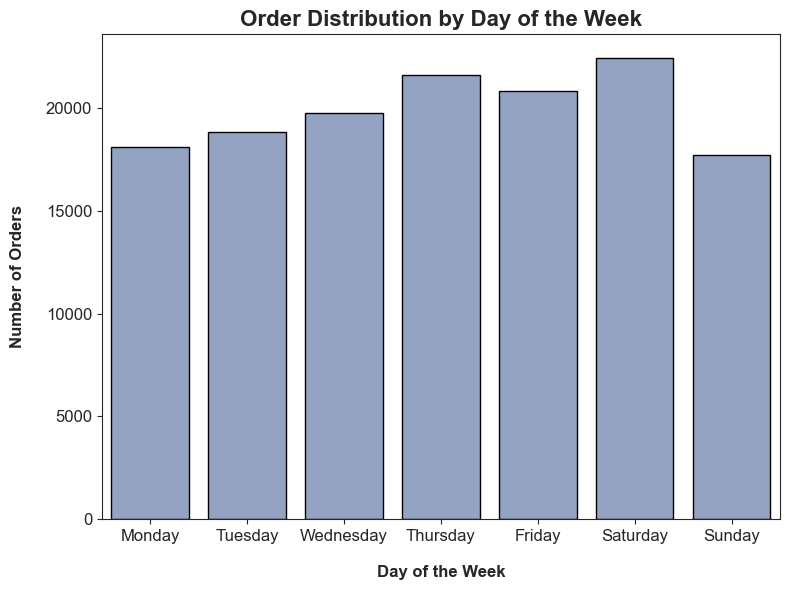

In [39]:
# Reorder the days to start with Monday
days_of_week = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Reorder the `order_count_weekday` to match the new days of the week order
order_count_weekday = data[weekday_features].sum().values
order_count_weekday = [order_count_weekday[1], order_count_weekday[2], order_count_weekday[3], order_count_weekday[4], order_count_weekday[5], order_count_weekday[6], order_count_weekday[0]]

# Create a DataFrame for plotting
weekly_orders = {
    'Day of Week': days_of_week,
    'Order Count': order_count_weekday
}
df_weekly_orders = pd.DataFrame(weekly_orders)

sns.set_style("ticks")
color = sns.color_palette("Set2")[2]

# Plot the bar chart
plt.figure(figsize=(8, 6))
sns.barplot(x='Day of Week', y='Order Count', data=df_weekly_orders, color=color, edgecolor='black')
plt.title('Order Distribution by Day of the Week', fontsize=16, fontweight='bold')
plt.xlabel('Day of the Week', fontsize=12, fontweight='bold', labelpad=15)
plt.ylabel('Number of Orders', fontsize=12, fontweight='bold', labelpad=15)
plt.xticks(fontsize=12) 
plt.yticks(fontsize=12) 

plt.tight_layout()
plt.show()


The highest number of orders occured on Thursdays, Fridays and Saturdays. Sunday, however, has the fewest orders compared to all other days of the week, that might indicate that it’s a quieter day for ordering.

### 2.2.3 Hourly Orders

In [40]:
data[hourly_features].describe().round(2).T

,count,mean,std,min,25%,50%,75%,max
HR_0,30711.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0
HR_1,31875.0,0.05,0.32,0.0,0.0,0.0,0.0,14.0
HR_2,31875.0,0.06,0.35,0.0,0.0,0.0,0.0,12.0
HR_3,31875.0,0.12,0.50,0.0,0.0,0.0,0.0,11.0
HR_4,31875.0,0.10,0.44,0.0,0.0,0.0,0.0,14.0
HR_5,31875.0,0.08,0.36,0.0,0.0,0.0,0.0,7.0
HR_6,31875.0,0.07,0.33,0.0,0.0,0.0,0.0,8.0
HR_7,31875.0,0.08,0.38,0.0,0.0,0.0,0.0,15.0
HR_8,31875.0,0.13,0.64,0.0,0.0,0.0,0.0,52.0
HR_9,31875.0,0.23,0.73,0.0,0.0,0.0,0.0,23.0


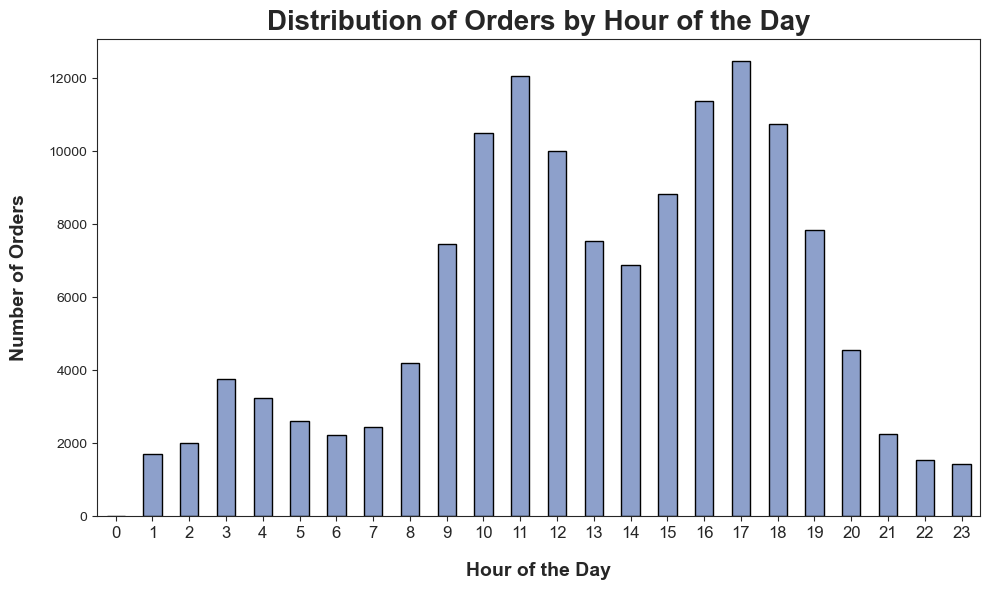

In [41]:
# Create a list of the hours in the dataset
order_count_hour = data[hourly_features].sum().values

# Create a Pandas Series to hold the hourly data
hours = list(range(24))  # Assuming hourly_features represent hours 0 to 23
hourly_data = pd.Series(data=order_count_hour, index=hours)

sns.set_style("ticks")
color = sns.color_palette("Set2")[2]  # Use the Set2 palette's third color

# Plot the bar chart with the improved palette and design
plt.figure(figsize=(10, 6))
hourly_data.plot(kind='bar', color=color, edgecolor='black')
plt.title('Distribution of Orders by Hour of the Day', fontsize=20, fontweight='bold')
plt.xlabel('Hour of the Day', fontsize=14, fontweight='bold', labelpad=15)
plt.ylabel('Number of Orders', fontsize=14, fontweight='bold', labelpad=15)
plt.xticks(rotation=0, fontsize=12)  # Rotate x-axis labels for better readability

plt.tight_layout()
plt.show()


As previously identified, the data for Hour 0 only contains missing values and zeros. This is clearly reflected in the chart, as the number of orders at midnight is actually 0, confirming that this hour has negligible activity.

It would be insightful to compare the sum of weekday orders with the sum of hourly orders, as these totals should ideally match. Any discrepancy between the two sums would likely be attributable to Hour 0, where we previously observed missing values and zeros.
Additionally, it would be valuable to examine cases where Hour 0 is 0 to see if the sum of weekday orders aligns with the sum of hourly orders in these instances. This comparison could help verify the data consistency.

The chart shows clear peaks during typical meal (pronounced peaks during lunch and dinner) times and order volume is notably lower during the late night and early morning hours.

### 2.2.4 Other features

In [42]:
data[other_features].describe().round(2)

,customer_age,vendor_count,product_count,is_chain,first_order,last_order
count,31148.00,31875.00,31875.00,31875.00,31769.00,31875.00
mean,27.51,3.10,5.67,2.82,28.47,63.67
std,7.16,2.77,6.96,3.98,24.10,23.23
min,15.00,0.00,0.00,0.00,0.00,0.00
25%,23.00,1.00,2.00,1.00,7.00,49.00
50%,26.00,2.00,3.00,2.00,22.00,70.00
75%,31.00,4.00,7.00,3.00,45.00,83.00
max,80.00,41.00,269.00,83.00,90.00,90.00


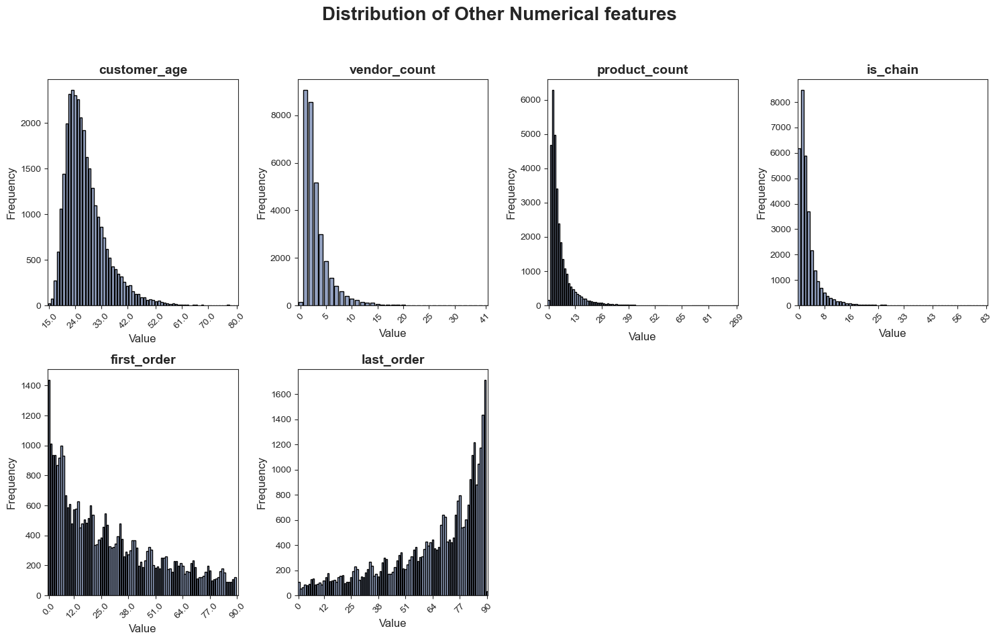

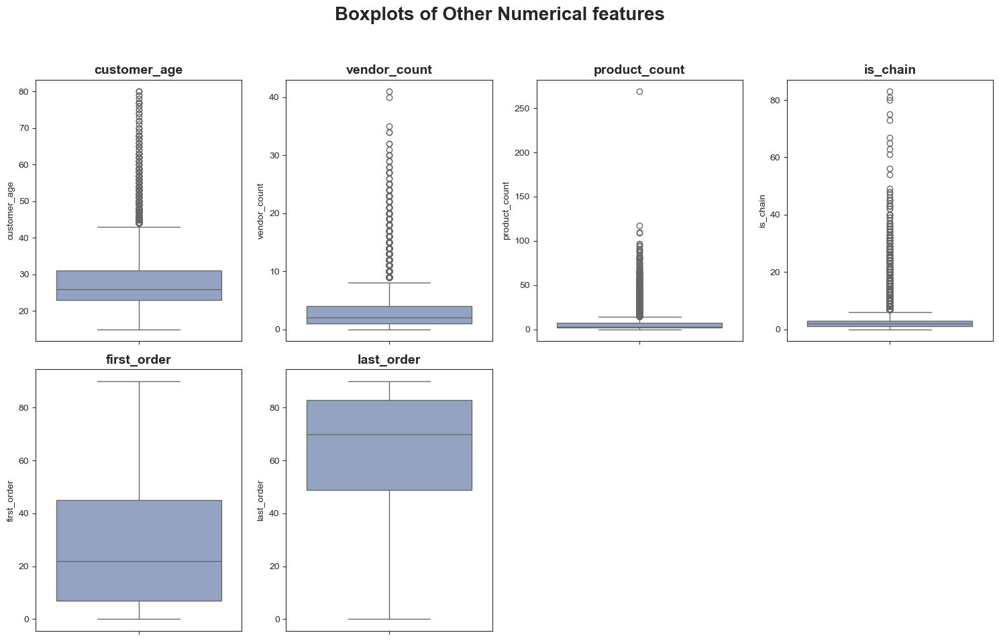

In [43]:
sns.set_style("ticks")
color = sns.color_palette("Set2")[2] 

# Create a figure with 2 rows and 4 columns
fig, axes = plt.subplots(2, 4, figsize=(15, 10))
fig.suptitle('Distribution of Other Numerical features', fontsize=20, fontweight='bold')

# Loop over each 'other variable' and create a histogram for each in a separate subplot
for ax, column in zip(axes.flatten(), other_features):
    sns.countplot(data=data, x=column, color=color, edgecolor='black', ax=ax)
    ax.set_title(column, fontsize=14, fontweight='bold')
    ax.set_xlabel('Value', fontsize=12)
    ax.set_ylabel('Frequency', fontsize=12)
    ax.set_xticks(np.linspace(0, len(ax.get_xticks()) - 1, 8).astype(int))  # Limit x-ticks to 6
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

# Remove any remaining empty axes
for ax in axes.flatten()[len(other_features):]:
    fig.delaxes(ax)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust to leave space for the suptitle
plt.show()



sns.set_style("ticks")

# Create a figure with 2 rows and 4 columns for boxplots
fig, axes = plt.subplots(2, 4, figsize=(15, 10))
fig.suptitle('Boxplots of Other Numerical features', fontsize=20, fontweight='bold')

# Loop over each 'other variable' and create a boxplot for each in a separate subplot
for ax, column in zip(axes.flatten(), other_features):
    sns.boxplot(y=data[column], color=color, ax=ax)
    ax.set_title(column, fontsize=14, fontweight='bold')
    ax.set_xlabel('')

# Remove any remaining empty axes
for ax in axes.flatten()[len(other_features):]:
    fig.delaxes(ax)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust to leave space for the suptitle
plt.show()


**Relevant Insights:**

- **Customer Region:** clear concentration in three specific regions: 2360, 4660 and 8670, which dominate the dataset.

- **Customer Age:** right-skewed distribution, with most customers falling within a younger age range (mean age of 27.51 and median 26). There are a few outliers for older customers, indicating that while some older individuals do use the platform, they are in the minority.

- **Vendor Count:** most customers have a low vendor count (mean of 3.10 and median of 2), suggesting that they might prefer ordering from a limited number of vendors. A significant number of outliers show that some customers have a much higher vendor count (max is 41), potentially indicating a preference for variety or access to a wider range of options. The data is right-skewed.

- **Product Count:** heavily right-skewed, with the majority of customers having a low product count (mean of 5.67 and median of 3), suggesting they order fewer items per transaction. There are extreme outliers visible (max is 269), with some orders containing a surprisingly high number of products.

- **is_chain Variable:** the analysis reinforce the observation that this variable captures a wide range of values beyond a simple binary yes/no indicator.

- **First Order:** right-skewed pattern, with most customers making their first order relatively early (mean of 28 days after the beginning of the dataset). The tail indicates that some customers take longer to make their first purchase and the spread is wide, with a standard deviation of 24.10.
    
- **Last Order:** many customers have placed recent orders (mean of 63 days after the beginning of the dataset, considering that the data ranges in 3 months), indicating recent engagement with the platform. The minimum value of 0 (meaning someone who didn't order).

## 2.3 Categorical Features Analysis

In [44]:
categorical_features = data.iloc[:,1:].select_dtypes(include='object').columns.tolist()
categorical_features

['customer_region', 'last_promo', 'payment_method']

In [45]:
data[categorical_features].describe()

,customer_region,last_promo,payment_method
count,31433,31875,31875
unique,8,4,3
top,8670,NO PROMO,CARD
freq,9761,16744,20153


In [46]:
# Iterate over each qualitative variable and display its value counts
for column in categorical_features:
    print(f"Value counts for {column}:")
    print(data[column].value_counts())
    print("\n" + "-"*40 + "\n") 


Value counts for customer_region:
customer_region
8670    9761
4660    9550
2360    8829
2440    1483
4140     857
8370     495
2490     445
8550      13
Name: count, dtype: int64

----------------------------------------

Value counts for last_promo:
last_promo
NO PROMO    16744
DELIVERY     6282
DISCOUNT     4496
FREEBIE      4353
Name: count, dtype: int64

----------------------------------------

Value counts for payment_method:
payment_method
CARD    20153
DIGI     6098
CASH     5624
Name: count, dtype: int64

----------------------------------------



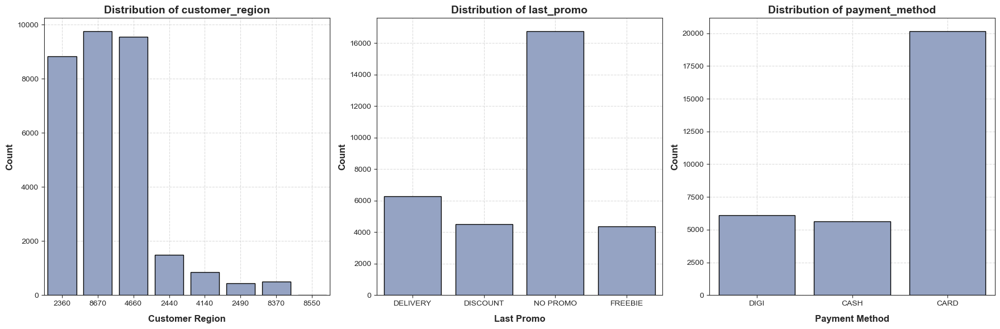

In [47]:
sns.set_style("ticks")
color = sns.color_palette("Set2")[2]

# Create a figure with 2 histograms for categorical features
fig, axes = plt.subplots(1, 3, figsize=(18, 6))  # 1 row, 3 columns

# Plot histograms 
for ax, column in zip(axes, categorical_features[:3]):
    sns.countplot(data=data, x=column, color=color, edgecolor='black', ax=ax)
    ax.set_title(f'Distribution of {column}', fontsize=14, fontweight='bold')
    ax.set_xlabel(column.replace('_', ' ').title(), fontsize=12, fontweight='bold', labelpad=10)
    ax.set_ylabel('Count', fontsize=12, fontweight='bold')
    ax.tick_params(axis='x', labelsize=10) 
    ax.tick_params(axis='y', labelsize=10)
    ax.grid(True, linestyle='--', alpha=0.7) 

plt.tight_layout()
plt.show()

Relevant Insights:
- **Last Promo:** majority of customers had no promotional incentive during their last purchase. Among those who did use a promotion, Delivery and Discount were the most popular types, while Freebie was less frequently used.
- **Payment Method:** dominated by Card payments, which are significantly more frequent than other methods, with DIGI (digital wallets) and Cash being used much less often.
- **Customer Region** we don´t know the exact location of this regions so we can´t take relevant insights. However we can conclude that region 2360, 8670 and 4660 have a significantly higher frequency compares to the others. 

## 2.4 Feature Engineering

#### Total Orders

In [48]:
data['total_orders'] = data[weekday_features].sum(axis=1)

print(data[weekday_features + ['total_orders']])


       DOW_0  DOW_1  DOW_2  DOW_3  DOW_4  DOW_5  DOW_6  total_orders
0          1      0      0      0      0      0      1             2
1          1      0      0      0      0      0      1             2
2          1      0      0      0      0      0      1             2
3          0      1      0      0      0      0      1             2
4          0      1      0      0      0      0      1             2
...      ...    ...    ...    ...    ...    ...    ...           ...
31883      0      0      0      0      0      0      1             1
31884      0      0      0      0      0      0      1             1
31885      0      0      0      0      0      0      1             1
31886      0      0      0      0      0      0      1             1
31887      0      0      0      0      0      0      1             1

[31875 rows x 8 columns]


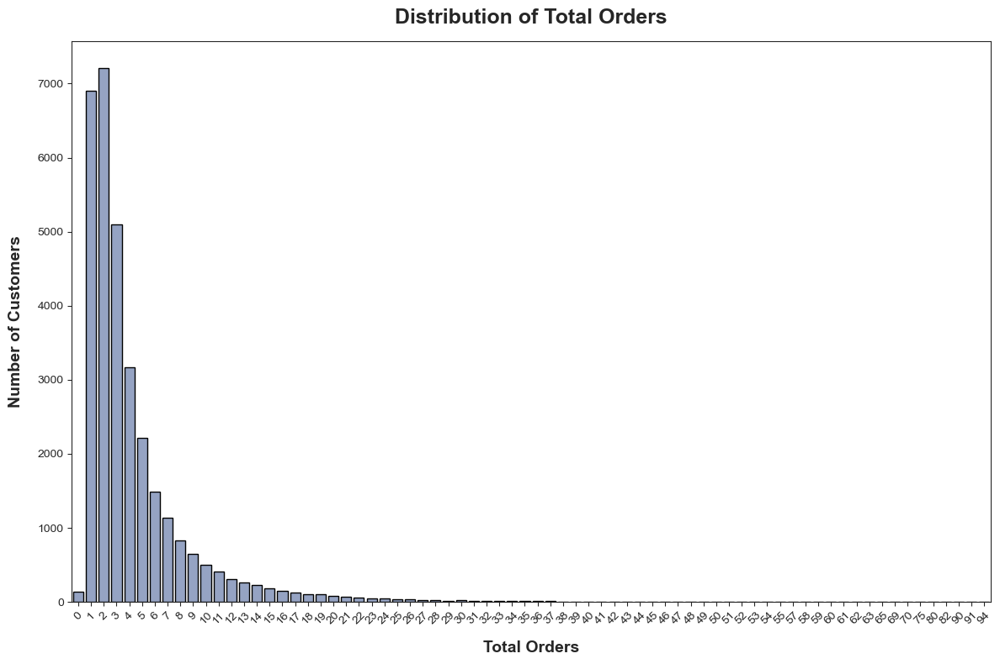

In [49]:
sns.set_style("ticks")
color = sns.color_palette("Set2")[2]

# Create the countplot for 'total_orders'
plt.figure(figsize=(12, 8))  # Increase figure size for better readability
ax = sns.countplot(data=data, x='total_orders', color=color, edgecolor='black')

ax.set_title('Distribution of Total Orders', fontsize=18, fontweight='bold', pad=15)  # Enhanced title
ax.set_xlabel('Total Orders', fontsize=14, fontweight='bold', labelpad=12)  # Increased label font size
ax.set_ylabel('Number of Customers', fontsize=14, fontweight='bold', labelpad=12)  # Enhanced y-axis label
ax.tick_params(axis='x', rotation=45, labelsize=10) 

plt.tight_layout()
plt.show()


Comparing the total orders from hourly orders and total orders from weekdays orders

In [50]:
# Calculate the sum of hourly features directly
total_orders_match = (data['total_orders'] == data[hourly_features].sum(axis=1)).sum()

# Count the total rows where HR_0 is 0
hr_0_0_in_match = ((data['total_orders'] == data[hourly_features].sum(axis=1)) & (data['HR_0'] == 0)).sum()

# Calculate the sum of hourly features directly and compare without adding a column
# Add a condition to also check if HR_0 is missing when they don't match
total_orders_mismatch = (data['total_orders'] != data[hourly_features].sum(axis=1)).sum()

# Additionally, check if HR_0 is missing in these mismatch cases
hr_0_missing_in_mismatch = ((data['total_orders'] != data[hourly_features].sum(axis=1)) & data['HR_0'].isna()).sum()


print(f"Number of matching rows: {total_orders_match}")
print(f"Rows where match occurred and HR_0 is 0: {hr_0_0_in_match}")
print(f"Number of mismatch rows: {total_orders_mismatch}")
print(f"Rows where mismatch occurred and HR_0 is missing: {hr_0_missing_in_mismatch}")


Number of matching rows: 30711
Rows where match occurred and HR_0 is 0: 30711
Number of mismatch rows: 1164
Rows where mismatch occurred and HR_0 is missing: 1164


When the values of total_orders exactly matched (30711 rows) the sum of the hourly orders, the HR_0 value was consistently 0.
In 1164 rows, the total_orders did not match the sum of the hourly columns. In all of these cases, the HR_0 value was found to be missing.

The results strongly indicate that when the order data aligns (total_orders = sum of hourly orders), the HR_0 should be 0.
For rows where the HR_0 is missing, the difference between total_orders and the hourly orders can be attributed to the missing value in HR_0.

#### Total Spending Amount

In [51]:
data['total_spend'] = data[cuisine_features].sum(axis=1)


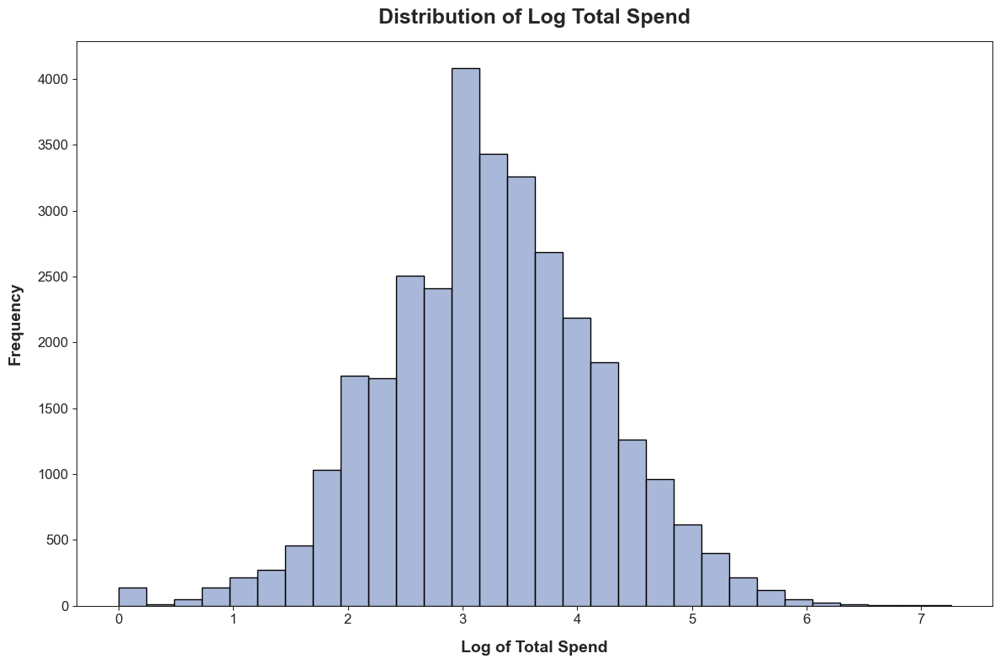

In [52]:
plt.figure(figsize=(12, 8))

sns.set_style("ticks")
color = sns.color_palette("Set2")[2]

# Plot the distribution of total spend using a histogram
sns.histplot(np.log1p(data['total_spend']), bins=30, color=color, edgecolor='black')

plt.title('Distribution of Log Total Spend', fontsize=18, fontweight='bold', pad=15)
plt.xlabel('Log of Total Spend', fontsize=14, fontweight='bold', labelpad=12)
plt.ylabel('Frequency', fontsize=14, fontweight='bold', labelpad=12)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.tight_layout()
plt.show()


We applied a log transformation to the total_spend variable for visual purposes. This transformation is particularly useful when dealing with skewed data, which was evident in the original distribution where most values were concentrated at the lower end, with a few extremely high values.

The log-transformed distribution is approximately bell-shaped, indicating that the log transformation successfully normalized the data to a near-normal distribution.
The peak of the distribution is now clearly visible around a log value of 3, suggesting that most customers have a total spend in that range (e^3=20 units).

#### Different Weekdays

In [53]:
data['different_weekdays'] = (data[['DOW_0', 'DOW_1', 'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5', 'DOW_6']] > 0).sum(axis=1)

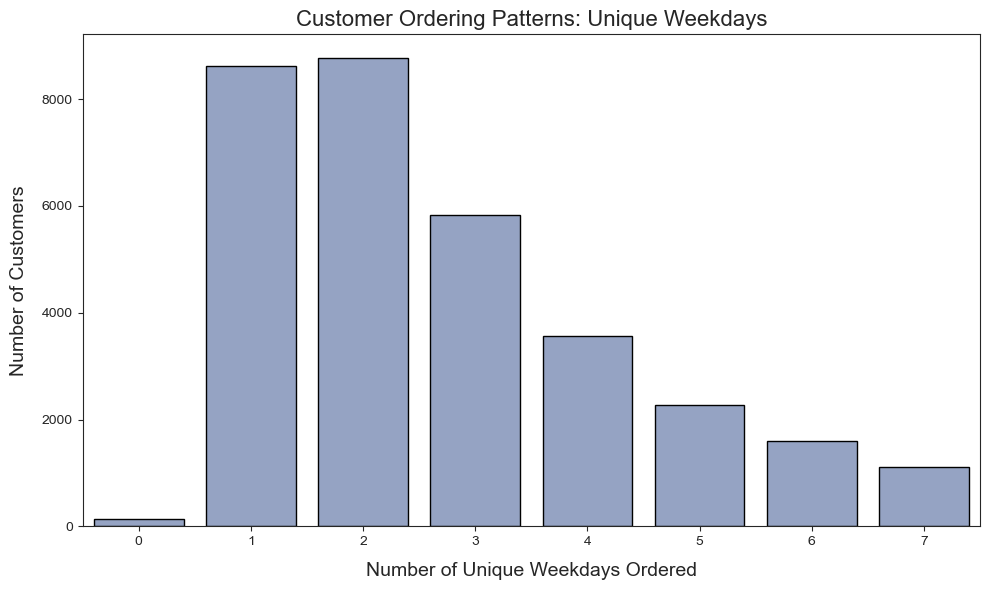

In [54]:
# Create a summary DataFrame for unique weekdays ordering patterns
unique_week_day_totals = pd.DataFrame({
    'Unique Weekdays Ordered': data['different_weekdays'].value_counts().index,
    'Number of Customers': data['different_weekdays'].value_counts().values
}).sort_values('Unique Weekdays Ordered')

# Plot the data
plt.figure(figsize=(10, 6))
sns.set_style("ticks")
color = sns.color_palette("Set2")[2]

sns.barplot(x='Unique Weekdays Ordered', y='Number of Customers', data=unique_week_day_totals,
            edgecolor='black', color=color)
plt.title('Customer Ordering Patterns: Unique Weekdays', fontsize=16)
plt.xlabel('Number of Unique Weekdays Ordered', fontsize=14, labelpad=10)
plt.ylabel('Number of Customers', fontsize=14, labelpad=10)
plt.grid(False)
plt.tight_layout()

plt.show()

Relevant Insights:
- Most customers fall under the "No" category, meaning they do not limit their orders to a single day.
- A smaller yet significant portion of customers always orders on the same day of the week ("Yes"). 

#### Day Patterns for ordering

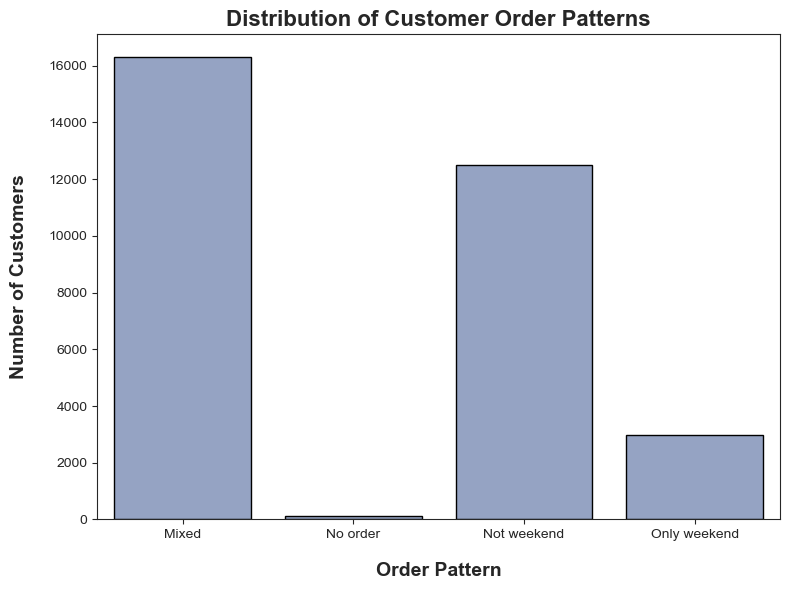

In [55]:
# Defining the conditions for classification based on the day of the week features (DOW_0 to DOW_6)
conditions = [
    (data[['DOW_0', 'DOW_6']].sum(axis=1) > 0) & (data[['DOW_1', 'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5']].sum(axis=1) == 0),  # Only weekend
    (data[['DOW_0', 'DOW_6']].sum(axis=1) == 0) & (data[['DOW_1', 'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5']].sum(axis=1) > 0),  # Not weekend
    (data[['DOW_0', 'DOW_6']].sum(axis=1) > 0) & (data[['DOW_1', 'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5']].sum(axis=1) > 0)   # Mixed
]

# Labels for the classifications
choices = ['Only weekend', 'Not weekend', 'Mixed']

# Create a new categorical column for customer order patterns
data['day_pattern'] = pd.Categorical(np.select(conditions, choices, default='No order'))

# Count the number of customers in each order pattern
pattern_counts = data['day_pattern'].value_counts()

# Create a DataFrame for plotting
order_pattern_df = pd.DataFrame({
    'Order Pattern': pattern_counts.index,
    'Number of Customers': pattern_counts.values
})

sns.set_style("ticks")
color = sns.color_palette("Set2")[2]

plt.figure(figsize=(8, 6))
sns.barplot(x='Order Pattern', y='Number of Customers', data=order_pattern_df, edgecolor='black', color=color)
plt.title('Distribution of Customer Order Patterns', fontsize=16, fontweight='bold')
plt.xlabel('Order Pattern', fontsize=14, fontweight='bold', labelpad=15)
plt.ylabel('Number of Customers', fontsize=14, fontweight='bold', labelpad=15)

plt.tight_layout()
plt.show()

Relevant Insights:
- Majority of customers have mixed patterns (order both on weekends and weekdays). 
- Substantial Segment Prefers Weekdays (second-largest group).
- Smaller Segment Prefers Only Weekends.
- No Order category is extremely small, indicating that most registered customers are actively ordering. This suggests a relatively low number of inactive users within the 90-day data range.

#### Total order by meal period

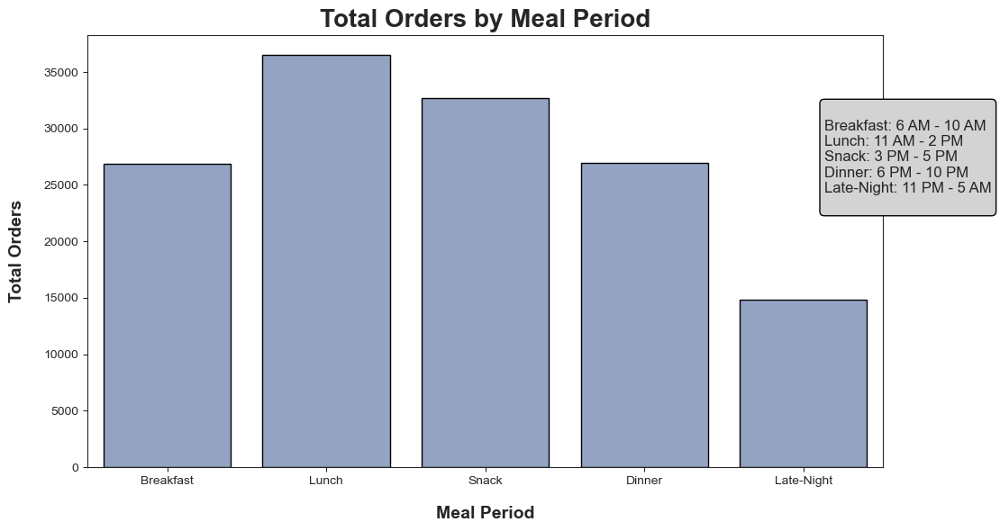

In [56]:
# Define meal period hours
breakfast_hours = hourly_features[6:11]   # HR_6 to HR_10 (6 AM - 10 AM)
lunch_hours = hourly_features[11:15]      # HR_11 to HR_14 (11 AM - 2 PM)
snack_hours = hourly_features[15:18]      # HR_15 to HR_17 (3 PM - 5 PM)
dinner_hours = hourly_features[18:23]     # HR_18 to HR_22 (6 PM - 10 PM)
late_night_hours = hourly_features[23:] + hourly_features[:6]  # HR_23 and HR_0 to HR_5 (Late Night)

# Sum order per customer in each meal period
data['breakfast_orders'] = data[breakfast_hours].sum(axis=1)
data['lunch_orders'] = data[lunch_hours].sum(axis=1)
data['snack_orders'] = data[snack_hours].sum(axis=1)
data['dinner_orders'] = data[dinner_hours].sum(axis=1)
data['night_orders'] = data[late_night_hours].sum(axis=1)

# Create a DataFrame summarizing total orders per meal period
meal_period_totals = pd.DataFrame({
    'Meal Period': ['Breakfast', 'Lunch', 'Snack', 'Dinner', 'Late-Night'],
    'Total Orders': [data['breakfast_orders'].sum(), 
                     data['lunch_orders'].sum(), 
                     data['snack_orders'].sum(),
                     data['dinner_orders'].sum(), 
                     data['night_orders'].sum()]
})


sns.set_style("ticks")
color = sns.color_palette("Set2")[2]  # Use the third color from the Set2 palette
plt.figure(figsize=(10, 6))
sns.barplot(x='Meal Period', y='Total Orders', data=meal_period_totals, color=color,edgecolor='black')

legend_text = """
Breakfast: 6 AM - 10 AM
Lunch: 11 AM - 2 PM
Snack: 3 PM - 5 PM
Dinner: 6 PM - 10 PM
Late-Night: 11 PM - 5 AM
"""
plt.gcf().text(0.92, 0.7, legend_text, fontsize=12, ha='left', va='center', bbox=dict(boxstyle="round,pad=0.3", edgecolor='black', facecolor='lightgrey'))

plt.title('Total Orders by Meal Period', fontsize=20, fontweight='bold')
plt.xlabel('Meal Period', fontsize=14, fontweight='bold', labelpad=15)
plt.ylabel('Total Orders', fontsize=14, fontweight='bold', labelpad=15)

plt.tight_layout()
plt.show()

Relevant Insights:
- The data shows that lunch time (from 12 PM to 3 PM) is the most popular period for orders
- Both breakfast (6 AM - 10 AM) and dinner (6 PM - 10 PM) periods have a similar number of total orders.
- Snack Time Demand: The snack period (3 PM - 5 PM) maintains a moderate number of orders.
-Late-Night: As expected, the late-night period (11 PM - 5 AM) has the lowest volume of orders.

#### Diversity of Cuisine Types

In [57]:
data['diversity_cuisine_types'] = (data[cuisine_features] > 0).sum(axis=1)

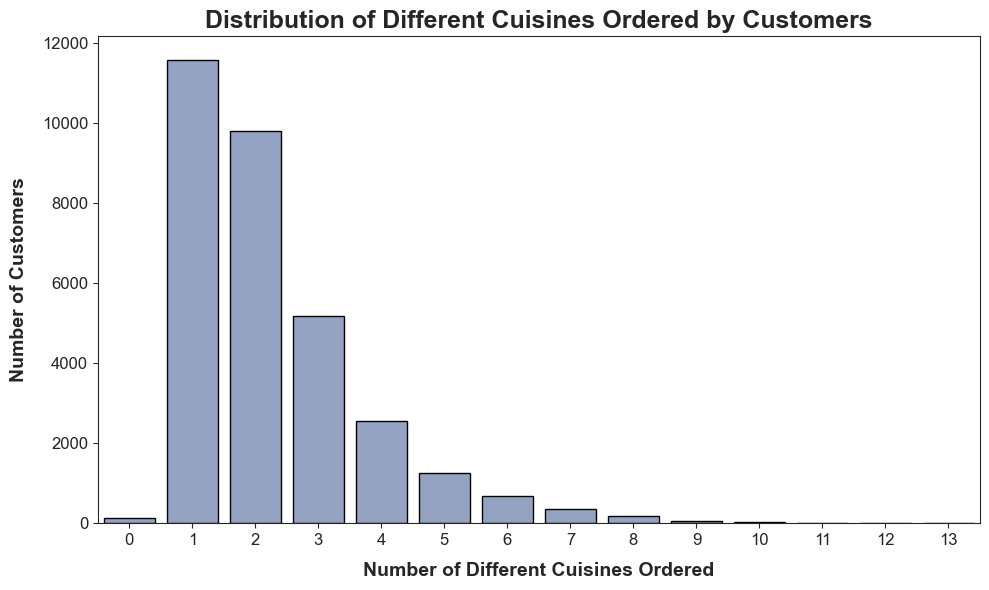

In [58]:
sns.set_style("ticks")
color = sns.color_palette("Set2")[2]

# Plot the bar plot for the number of different cuisines ordered by customers
plt.figure(figsize=(10, 6))
sns.countplot(x='diversity_cuisine_types', data=data, color=color, edgecolor='black')

plt.title('Distribution of Different Cuisines Ordered by Customers', fontsize=18, fontweight='bold')
plt.xlabel('Number of Different Cuisines Ordered', fontsize=14, fontweight='bold', labelpad=10)
plt.ylabel('Number of Customers', fontsize=14, fontweight='bold', labelpad=10)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.tight_layout()
plt.show()



Relevant Insights:
- The majority of customers have a low diversity in the types of cuisines they order
- There are some customers who show higher diversity (5 or more different cuisines), but they represent a very small percentage of the dataset.
- There’s a small bar for customers who ordered 0 different cuisines, for the customers who didn't ordered in the three months range.

#### Purchase Frequency

In [59]:
data['purchase_frequency'] = data.apply(lambda row: row['product_count'] / (row['last_order'] - row['first_order'] + 1), axis=1)

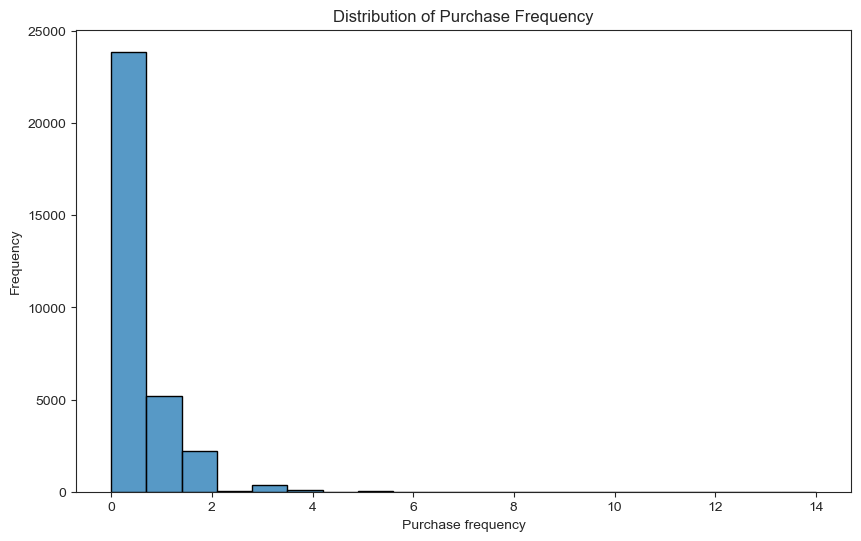

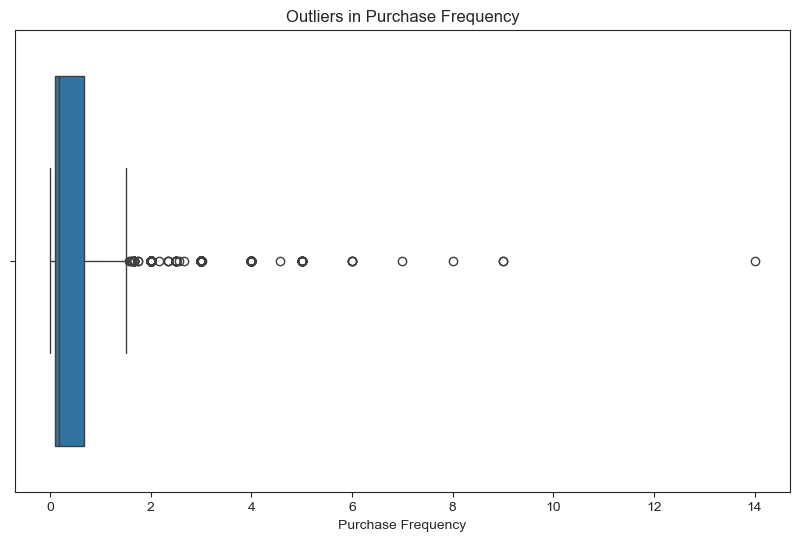

In [60]:
sns.set_style("ticks")
plt.figure(figsize=(10, 6))
sns.histplot(data['purchase_frequency'], bins=20,edgecolor="black")
plt.title('Distribution of Purchase Frequency')
plt.xlabel('Purchase frequency')
plt.ylabel('Frequency')
plt.show()

plt.figure(figsize=(10, 6))
sns.boxplot(x=data['purchase_frequency'])
plt.title('Outliers in Purchase Frequency')
plt.xlabel('Purchase Frequency')
plt.show()

#### Recency

In [61]:
data['recency'] = 90 - data['last_order']

Represents the difference between the end of the dataset (90 days) and the number of days since the last order.

Instead of indicating how long ago the last order was placed, it shifts the focus to how recently a customer has engaged. 

However, we have to keep in mind that these two variable are redundant but allows algorithms to decide which is more relevant for the task at hand.

#### Top Cuisine

In [62]:
data['top_cuisine'] = data[cuisine_features].idxmax(axis=1)

In [63]:
set2_palette = ['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f', '#e5c494', '#b3b3b3']

# Count occurrences of top cuisine for the pie chart
top_cuisine_counts = data['top_cuisine'].value_counts().reset_index()
top_cuisine_counts.columns = ['Cuisine Type', 'Count']

# Plot pie chart
fig = px.pie(top_cuisine_counts, values='Count', names='Cuisine Type',
             title='Percentage of Customers by Top Cuisine',
             color_discrete_sequence=set2_palette)

fig.show()


#### Age Group

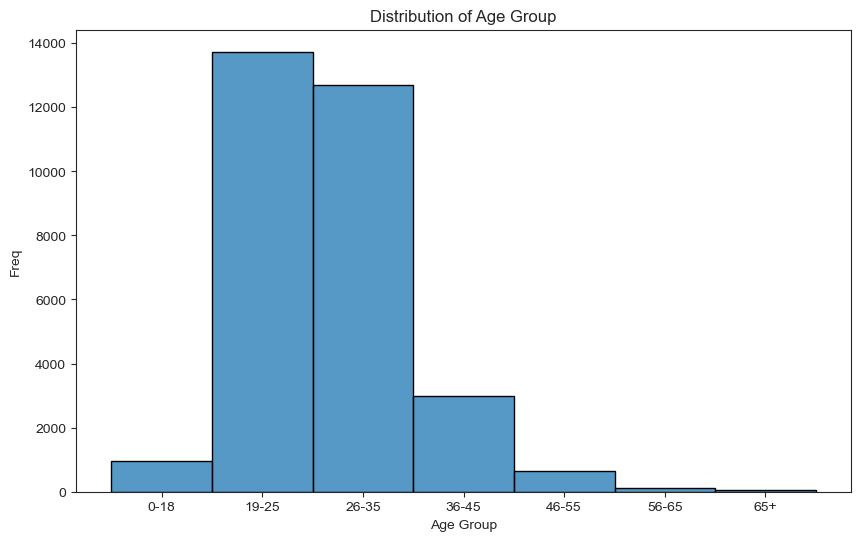

In [64]:
age_bins = [0, 18, 25, 35, 45, 55, 65, 100]
age_labels = ['0-18', '19-25', '26-35', '36-45', '46-55', '56-65', '65+']

data['age_group'] = pd.cut(data['customer_age'], bins=age_bins, labels=age_labels)

sns.set_style("ticks")
plt.figure(figsize=(10, 6))
sns.histplot(data['age_group'], bins=20,edgecolor="black")
plt.title('Distribution of Age Group')
plt.xlabel('Age Group')
plt.ylabel('Freq')
plt.show()



#### Proportion Spent in Top Cuisine

In [65]:
data['spent_top_cuisine'] = data.apply(lambda row: row[row['top_cuisine']]/row['total_spend'] if row['top_cuisine'] in data.columns and row['total_spend'] != 0 else 0, axis=1)

#### Total Spending per Order

In [66]:
data['spend_per_order'] = data.apply(lambda row: row['total_spend'] / row['total_orders'] if row['total_orders'] != 0 else 0, axis=1)

#### Type of cuisine

In [67]:
# Define the cuisine categories
main_food_cuisines = ['CUI_American', 'CUI_Asian', 'CUI_Chinese', 'CUI_Italian', 'CUI_Japanese', 
                      'CUI_Indian', 'CUI_Thai', 'CUI_Chicken Dishes', 'CUI_Noodle Dishes', 'CUI_Healthy']
beverages_addons = ['CUI_Beverages', 'CUI_Cafe', 'CUI_Desserts', 'CUI_Street Food / Snacks']

data['spent_main_food'] = data[main_food_cuisines].sum(axis=1) / data['total_spend']
data['spent_beverages_addons'] = data[beverages_addons].sum(axis=1) / data['total_spend']

# Handle division by zero or missing values
data['spent_main_food'] = data['spent_main_food'].fillna(0)
data['spent_beverages_addons'] = data['spent_beverages_addons'].fillna(0)

##### Products per order

In [68]:
data['products_per_order'] = data.apply(lambda row: row['product_count'] / row['total_orders'] if row['total_orders'] != 0 else 0, axis=1)

## 2.5 Multivariate Analysis

##### Correlation matrix

In [69]:
# Filter only numerical features
numerical_columns_of_interest = [col for col in data.columns if col not in (cuisine_features + weekday_features + hourly_features) and data[col].dtype in ['int64', 'float64']]

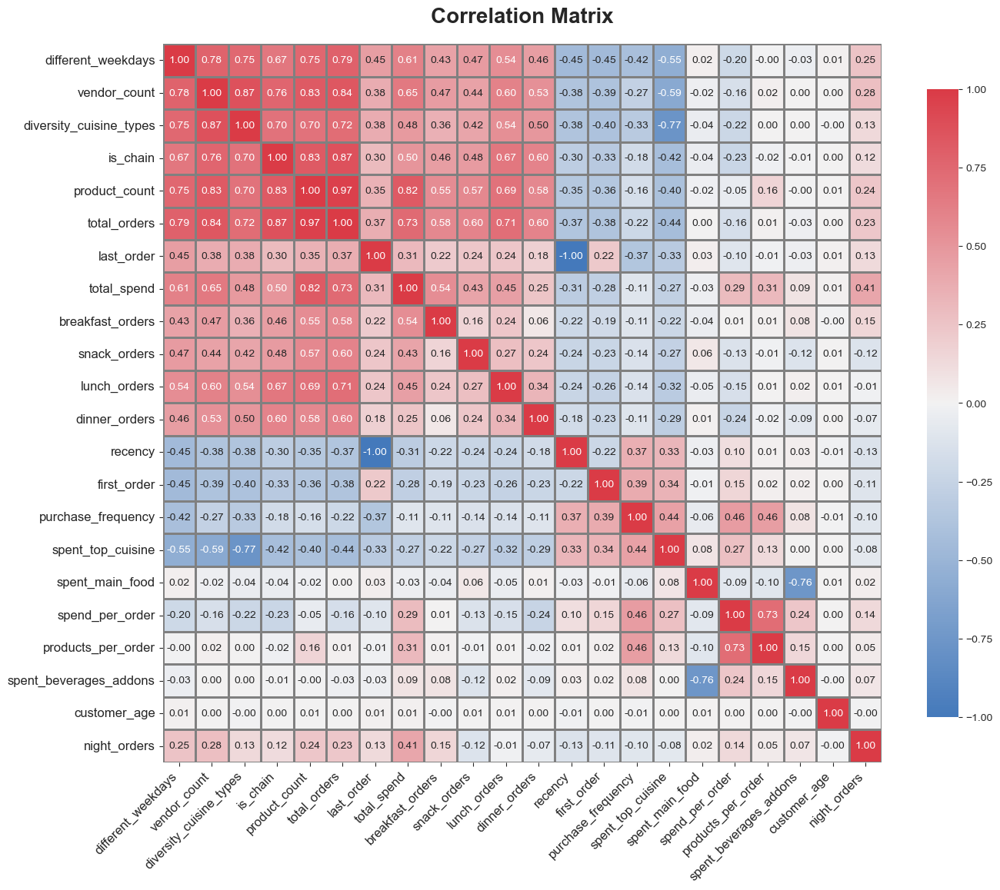

In [70]:
# Compute the correlation matrix
corr_matrix = data[numerical_columns_of_interest].corr()

# Cluster the features using hierarchical clustering
corr_linkage = linkage(corr_matrix, method='ward')
cluster_order = dendrogram(corr_linkage, no_plot=True)['leaves']

# Reorder the correlation matrix based on clustering
clustered_corr = corr_matrix.iloc[cluster_order, cluster_order]

# Plot the clustered heatmap
cmap = sns.diverging_palette(250, 10, as_cmap=True)
plt.figure(figsize=(14, 12))
sns.heatmap(clustered_corr, cmap=cmap, annot=True, fmt=".2f",
            linewidths=0.8, linecolor='gray', cbar_kws={"shrink": 0.8},
            vmin=-1, vmax=1, square=True, center=0,
            annot_kws={"size": 10},
            robust=True)

plt.title('Correlation Matrix', fontsize=20, fontweight='bold', pad=20)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()
plt.show()

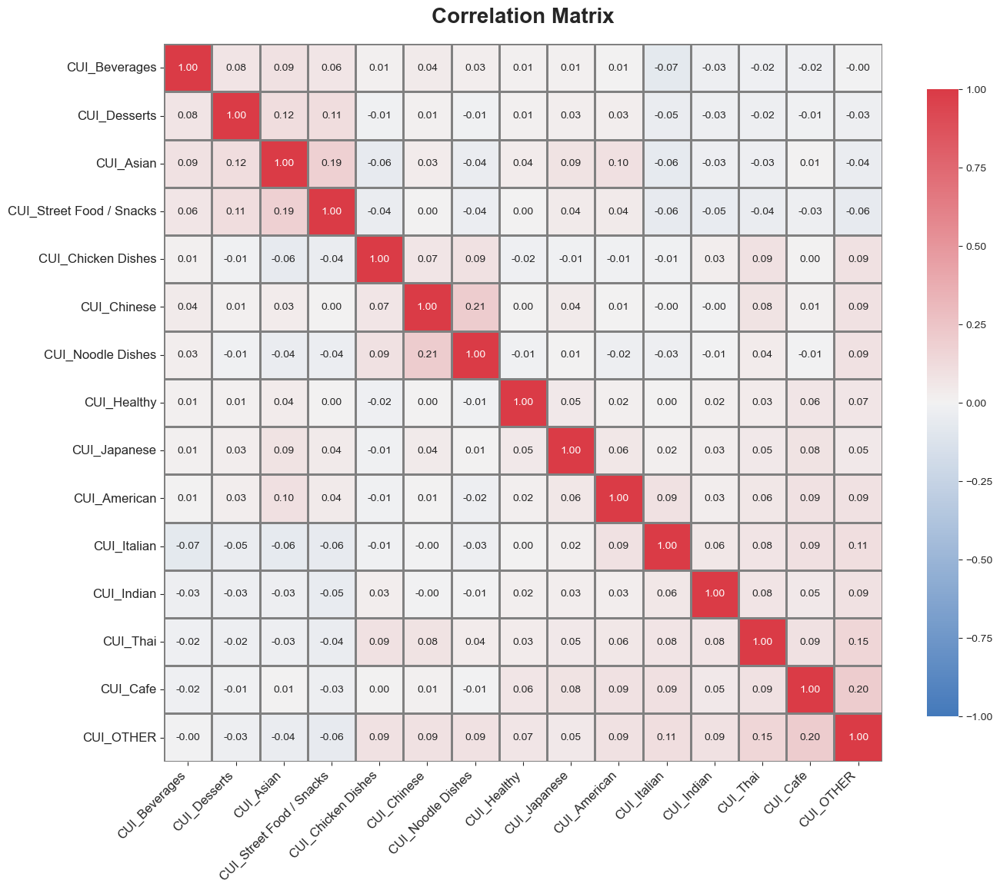

In [71]:
# Compute the correlation matrix
corr_matrix = data[cuisine_features].corr()

# Cluster the features using hierarchical clustering
corr_linkage = linkage(corr_matrix, method='ward')
cluster_order = dendrogram(corr_linkage, no_plot=True)['leaves']

# Reorder the correlation matrix based on clustering
clustered_corr = corr_matrix.iloc[cluster_order, cluster_order]

# Plot the clustered heatmap
cmap = sns.diverging_palette(250, 10, as_cmap=True)
plt.figure(figsize=(14, 12))
sns.heatmap(clustered_corr, cmap=cmap, annot=True, fmt=".2f",
            linewidths=0.8, linecolor='gray', cbar_kws={"shrink": 0.8},
            vmin=-1, vmax=1, square=True, center=0,
            annot_kws={"size": 10},
            robust=True)

plt.title('Correlation Matrix', fontsize=20, fontweight='bold', pad=20)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()
plt.show()

Clustering correlation group features that have similar correlation patterns. The set of features that are highly correlated with each other will be positioned next to each other.

Strong Positive Correlations:
- product_count and total_orders (0.97): Customers who purchase more products also tend to place more orders
- vendor_count and diversity_cuisine_types (0.87): A higher number of vendors corresponds to a greater variety of cuisines ordered
- total_spend and product_count (0.82): There's a strong relationship between how many products are purchased and the total spending
- is_chain and vendor_count (0.83): The is_chain variable is highly correlated with the number of vendors **!!!**

Behavioral Patterns:
- consistent_day_order and purchase_frequency (0.69): A positive correlation indicates that customers with more regular ordering pattern have higher purchase frequencies.
- lunch_order and total_orders (0.76): The high correlation between lunch_order and total orders suggests that lunch is a significant meal period
- dinner_order and product_count (0.60): A positive correlation between dinner orders and the product count shows that customers tend to order multiple items during dinner.

Interesting Observations:
- Weak Correlations for customer_age: Most features have weak correlations with customer_age, indicating that age does not strongly influence factors like spending, order frequency, or vendor diversity. This suggests that customer behavior is not heavily age-dependent in this dataset. Also, it could be influenced by the lack of scaling.

- night_order has low correlation values: Orders made during late-night hours (night_order) don't strongly correlate with other behaviors, indicating that late-night ordering may not follow the same patterns seen during more typical meal times.

- recency and last_order (-1.00): As expected, this perfect negative correlation makes sense because recency is defined in relation to the most recent order date. 
- consistent_day_order and diversity_cuisine_types (-0.47): A negative correlation here suggests that customers who order consistently tend to stick to fewer cuisine types

##### Cramer's V heatmap

In [72]:
categorical_features = data.iloc[:,1:].select_dtypes(include=('object', 'category')).columns.tolist()

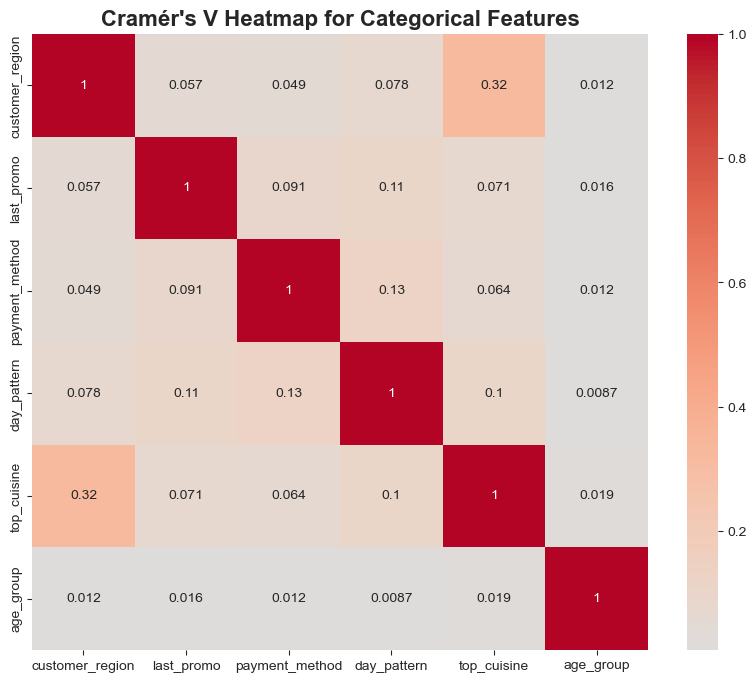

In [73]:
# Function to calculate Cramér's V
def cramers_v(x, y):
    # Create a contingency table
    contingency_table = pd.crosstab(x, y)
    # Calculate the Chi-Square statistic
    chi2, _, _, _ = chi2_contingency(contingency_table)
    # Calculate Cramér's V
    n = contingency_table.sum().sum()
    min_dim = min(contingency_table.shape) - 1
    v = np.sqrt(chi2 / (n * min_dim))
    return v

cramers_v_matrix = pd.DataFrame(index=categorical_features, columns=categorical_features)

# Compute Cramér's V for each pair of categorical columns
for col1 in categorical_features:
    for col2 in categorical_features:
        cramers_v_matrix.loc[col1, col2] = cramers_v(data[col1], data[col2])

cramers_v_matrix = cramers_v_matrix.astype(float)
plt.figure(figsize=(10, 8))
sns.heatmap(cramers_v_matrix, annot=True, cmap='coolwarm', center=0, square=True)
plt.title('Cramér\'s V Heatmap for Categorical Features', fontsize=16, fontweight='bold')
plt.show()


The highest Cramér's V value, approximately 0.32, is between customer_region and top_cuisine. This suggests a moderate relationship, indicating that the region of the customer might have some influence on their preferred type of cuisine.

Most of the relationships between categorical features show low Cramér's V values, under 0.13, indicating weak associations.

Most categorical features in the dataset seem to operate independently, with little overlap or shared patterns, which suggests a diverse customer base with varied preferences and behaviors.

##### Pairwise relationships by customer_region

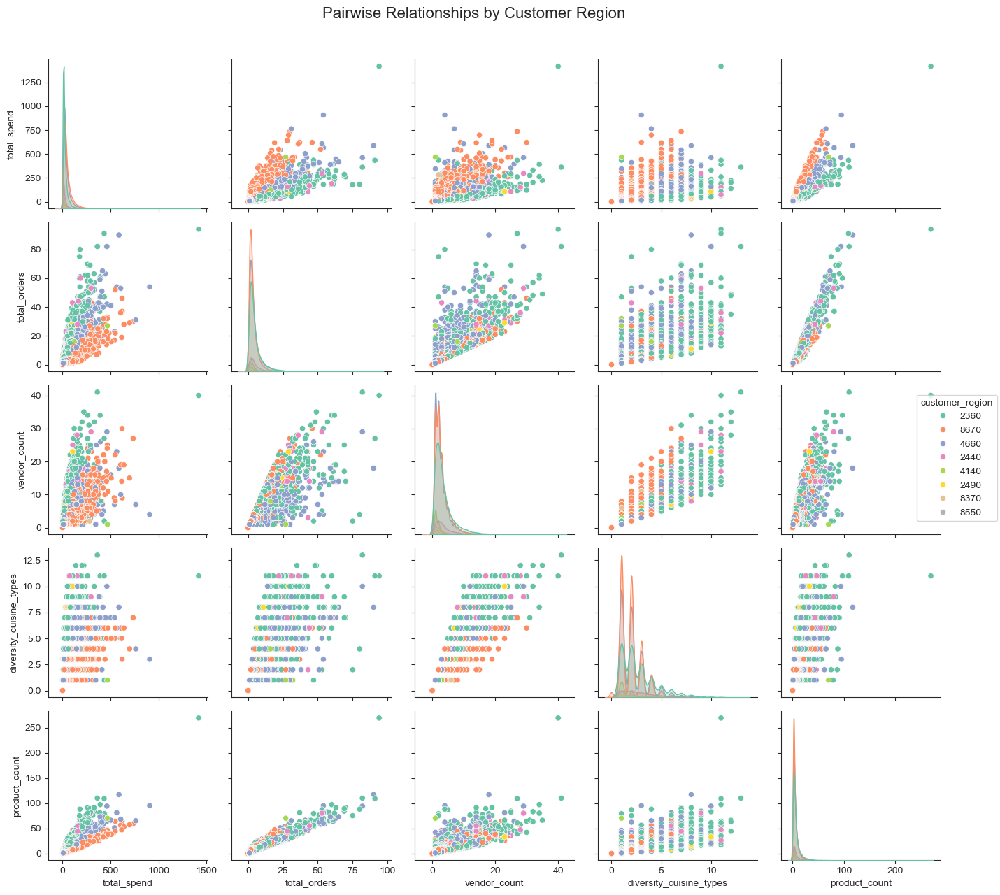

In [74]:
# Pair plot 
g = sns.pairplot(data, vars=['total_spend', 'total_orders', 'vendor_count', 'diversity_cuisine_types', 'product_count'], 
                 hue='customer_region', palette='Set2')

g._legend.set_bbox_to_anchor((1.05, 0.5)) 
g._legend.set_frame_on(True)
plt.suptitle('Pairwise Relationships by Customer Region', y=1.02, fontsize=16)
plt.tight_layout()  
plt.show()




- higher spending correlates with vendor_count and total orders (total_orders). This relationship is expected.
- correlation between total_orders and vendor_count.
- the distribution of diversity_cuisine_types against other features highlights that customers who order from a greater number of vendors tend to explore a broader range of cuisines. This aligns with expectations since more vendors imply more available food options.
- customers with high diversity often have a greater number of orders
- certain regions might have a concentration of high spenders, while others might have more diversity in cuisines

##### Customer age group ~ top cuisine

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\3882132988.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



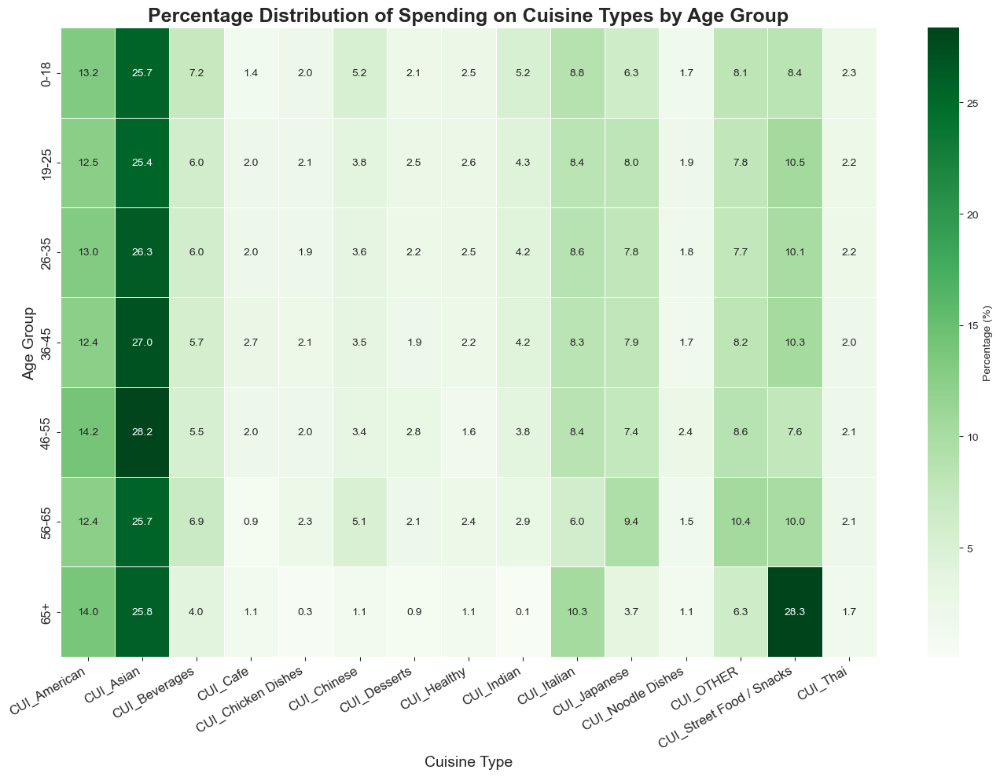

In [75]:
# Calculate average spending on each cuisine type for each age group
age_cuisine_data = data.groupby('age_group')[cuisine_features].mean()

# Normalize the data to represent percentages for each age group
age_cuisine_normalized = age_cuisine_data.div(age_cuisine_data.sum(axis=1), axis=0) * 100

# Plot a heatmap to visualize the normalized spending pattern across age groups and cuisine types
plt.figure(figsize=(14, 10))
sns.heatmap(age_cuisine_normalized, cmap="Greens", annot=True, fmt=".1f", linewidths=0.5, cbar_kws={'label': 'Percentage (%)'})
plt.title('Percentage Distribution of Spending on Cuisine Types by Age Group', fontsize=18, fontweight='bold')
plt.xlabel('Cuisine Type', fontsize=14)
plt.ylabel('Age Group', fontsize=14)
plt.xticks(rotation=30, ha='right', fontsize=12)
plt.yticks(fontsize=12)

plt.tight_layout()
plt.show()

In [76]:
def most_spent_cuisine_by_age(data):
    cuisine_by_age = data.groupby('age_group')[cuisine_features].sum()
    preferred_cuisine = cuisine_by_age.idxmax(axis=1)

    return preferred_cuisine

preferred_cuisine = most_spent_cuisine_by_age(data)
print("Most spent cuisine by age:\n", preferred_cuisine)

Most spent cuisine by age:
 age_group
0-18                    CUI_Asian
19-25                   CUI_Asian
26-35                   CUI_Asian
36-45                   CUI_Asian
46-55                   CUI_Asian
56-65                   CUI_Asian
65+      CUI_Street Food / Snacks
dtype: object


C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\383455079.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



We noticed that for the group 65+, the most spent cuisine was Street Food and Snacks. The question is if this is the most popular cuisine in this age group or there's a group of people that spent a lot in this cuisine.

In [77]:
# most popular cuisine by age group
top_cuisine_by_age_group = (
    data.groupby(['age_group', 'top_cuisine'])
    .size()
    .reset_index(name='count')
    .sort_values(['age_group', 'count'], ascending=[True, False])
)
most_popular_cuisine_by_age_group = top_cuisine_by_age_group.groupby('age_group').first().reset_index()

print(most_popular_cuisine_by_age_group)


  age_group top_cuisine  count
0      0-18   CUI_Asian    207
1     19-25   CUI_Asian   2999
2     26-35   CUI_Asian   2802
3     36-45   CUI_Asian    663
4     46-55   CUI_Asian    155
5     56-65   CUI_Asian     22
6       65+   CUI_Asian     12


C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\3824524901.py:3: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\3824524901.py:8: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [78]:
# Filter for age group '65+'
age_65_plus = data[data['age_group'] == '65+']

age_65_plus[['customer_id', 'CUI_Asian', 'CUI_Street Food / Snacks', 'top_cuisine']]

,customer_id,CUI_Asian,CUI_Street Food / Snacks,top_cuisine
836,c6a14aafd6,0.00,0.00,CUI_OTHER
988,5628ad8f54,0.00,0.00,CUI_Italian
2955,f0ebf1f3d6,0.00,0.00,CUI_Chinese
2962,49b8be7d44,1.82,0.00,CUI_Beverages
3098,d2ef90a47f,30.86,382.39,CUI_Street Food / Snacks
3679,a956a51629,0.00,0.00,CUI_OTHER
4071,65ab5e9447,36.16,30.45,CUI_Asian
5584,17d89ae398,0.00,0.00,CUI_American
5624,97be92b12d,0.00,140.37,CUI_Street Food / Snacks
9376,101f829115,0.00,12.47,CUI_Street Food / Snacks


When examining the spending on street food and snacks, it's evident that the high percentage—28% of the total spending within this category—is skewed by two specific customers (IDs: d2ef90a47f and 97be92b12d) who account for a significant portion of this expenditure. This suggests that, rather than reflecting a general spending pattern across the group, this high percentage is driven by outliers and does not represent a broader trend among other customers.

##### Hours ~ Customer Age Group

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\1984058439.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



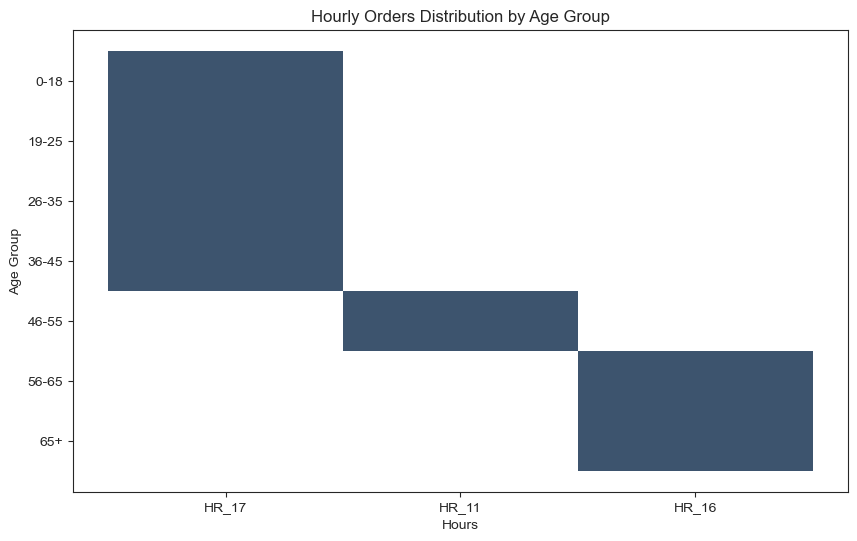

In [79]:
hour_by_age = data.groupby('age_group')[hourly_features].sum()

preferred_hour = hour_by_age.idxmax(axis=1) 
sns.set_style("ticks")
plt.figure(figsize=(10, 6))
sns.histplot(x=preferred_hour.values, y=preferred_hour.index)
plt.title('Hourly Orders Distribution by Age Group')
plt.xlabel('Hours')
plt.ylabel('Age Group')
plt.show()


C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\1685373400.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



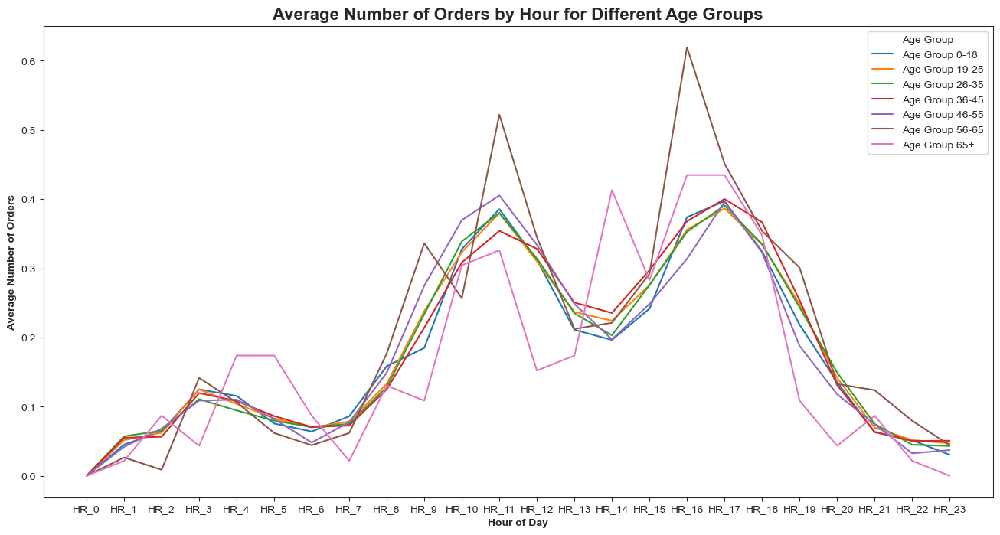

In [80]:
# Prepare data for line plot
age_hourly_mean = data.groupby('age_group')[hourly_features].mean().T

# Plot
plt.figure(figsize=(16, 8))
for age_group in age_hourly_mean.columns:
    plt.plot(age_hourly_mean.index, age_hourly_mean[age_group], label=f'Age Group {age_group}')
plt.legend(title='Age Group')
plt.xlabel('Hour of Day', fontweight='bold')
plt.ylabel('Average Number of Orders', fontweight='bold')
plt.title('Average Number of Orders by Hour for Different Age Groups', fontsize=16, fontweight='bold')
plt.show()

##### Hours ~ Customer Region

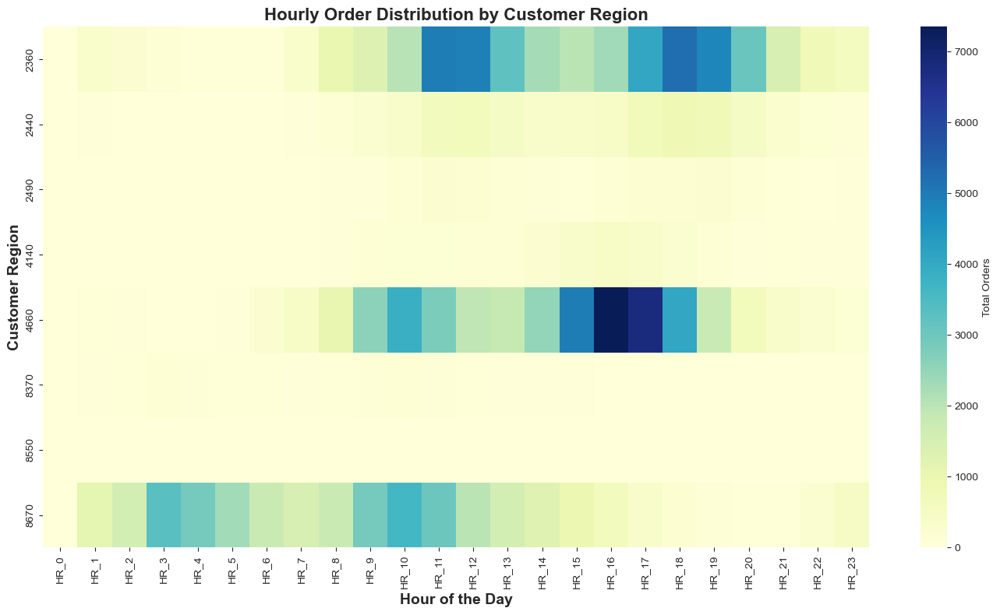

In [81]:
# Aggregate hourly orders by customer region
region_hourly_orders = data.groupby('customer_region')[hourly_features].sum().reset_index()

# Heatmap: Hours vs. Customer Region
plt.figure(figsize=(14, 8))
sns.heatmap(region_hourly_orders[hourly_features], annot=False, fmt=".0f", cmap='YlGnBu', 
            cbar_kws={'label': 'Total Orders'}, yticklabels=region_hourly_orders['customer_region'])
plt.title('Hourly Order Distribution by Customer Region', fontsize=16, fontweight='bold')
plt.xlabel('Hour of the Day', fontsize=14, fontweight='bold')
plt.ylabel('Customer Region', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()


##### Customer Region ~ Cuisine Type

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\2652731569.py:14: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



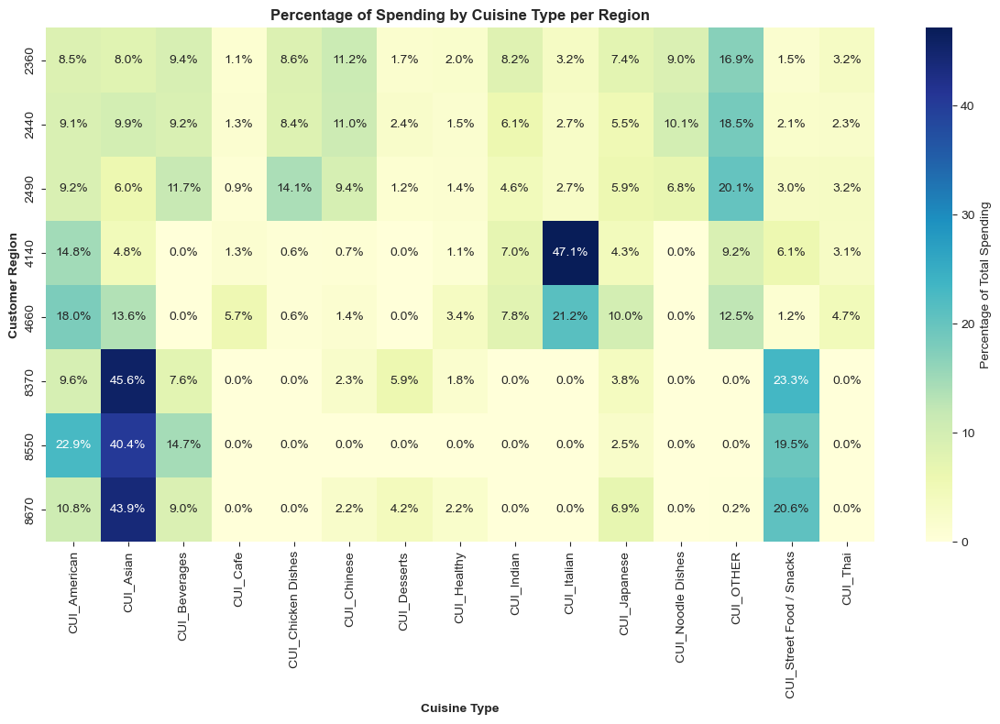

In [82]:
# Calculate the total spending per cuisine type by region
cuisine_spending = data.groupby('customer_region')[cuisine_features].sum()

# Calculate the total spending for each region across all cuisines
total_spending_by_region = cuisine_spending.sum(axis=1)

# Normalize each cuisine type spending by the total spending of the region
cuisine_spending_percentage = cuisine_spending.div(total_spending_by_region, axis=0) * 100

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(
    cuisine_spending_percentage,
    annot=cuisine_spending_percentage.applymap(lambda x: f"{x:.1f}%"),
    fmt="s",
    cmap='YlGnBu',
    cbar_kws={'label': 'Percentage of Total Spending'}
)
plt.title('Percentage of Spending by Cuisine Type per Region', fontweight='bold')
plt.xlabel('Cuisine Type', fontweight='bold')
plt.ylabel('Customer Region', fontweight='bold')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()



##### Product Count ~ Customer Region

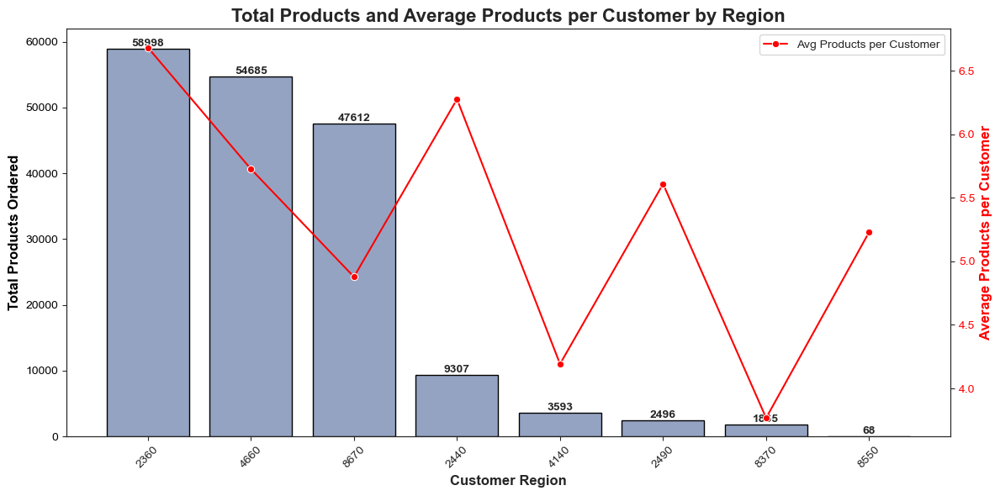

In [83]:
# Calculate total products per region
products_per_region = data.groupby('customer_region')['product_count'].sum().reset_index()
products_per_region.rename(columns={'product_count': 'total_products'}, inplace=True)

# Calculate total unique customers per region
customers_per_region = data.groupby('customer_region')['customer_id'].nunique().reset_index()
customers_per_region.rename(columns={'customer_id': 'total_customers'}, inplace=True)

# Merge the DataFrames
region_stats = pd.merge(products_per_region, customers_per_region, on='customer_region')

# Calculate average products per customer in each region
region_stats['avg_products_per_customer'] = region_stats['total_products'] / region_stats['total_customers']

# Sort the DataFrame by total products for plotting
region_stats.sort_values('total_products', ascending=False, inplace=True)
# Set the figure size
fig, ax1 = plt.subplots(figsize=(12, 6))

sns.set_style("ticks")
single_color = sns.color_palette("Set2")[2]

# Create the bar chart for total products per region
sns.barplot(
    data=region_stats,
    x=region_stats['customer_region'].astype(str),  # Convert to string only for plotting
    y='total_products',
    color=single_color,
    ax=ax1,
    edgecolor='black'
)

for bar in ax1.patches:
    ax1.text(
        x=bar.get_x() + bar.get_width() / 2,  # Center the text above the bar
        y=bar.get_height(),  # Place the text just above the bar
        s=f'{int(bar.get_height())}',  # Display the value as an integer
        ha='center', 
        va='bottom', 
        fontweight='bold'
    )

ax1.set_xlabel('Customer Region', fontsize=12, fontweight='bold')
ax1.set_ylabel('Total Products Ordered', fontsize=12, fontweight='bold', color='black')
ax1.set_title('Total Products and Average Products per Customer by Region', fontsize=16, fontweight='bold')
ax1.tick_params(axis='y', labelcolor='black')
ax1.tick_params(axis='x', rotation=45)

ax2 = ax1.twinx()
# Plot the line for average products per customer
sns.lineplot(
    data=region_stats,
    x=region_stats['customer_region'].astype(str),  # Convert to string only for plotting
    y='avg_products_per_customer',
    marker='o',
    color='red',
    label='Avg Products per Customer',
    ax=ax2
)

# Set the y-axis label for the line chart
ax2.set_ylabel('Average Products per Customer', fontsize=12, fontweight='bold', color='red')
ax2.tick_params(axis='y', labelcolor='red')
ax2.legend(loc='upper right')

fig.tight_layout()
plt.show()

##### Vendor Count ~ Payment Method

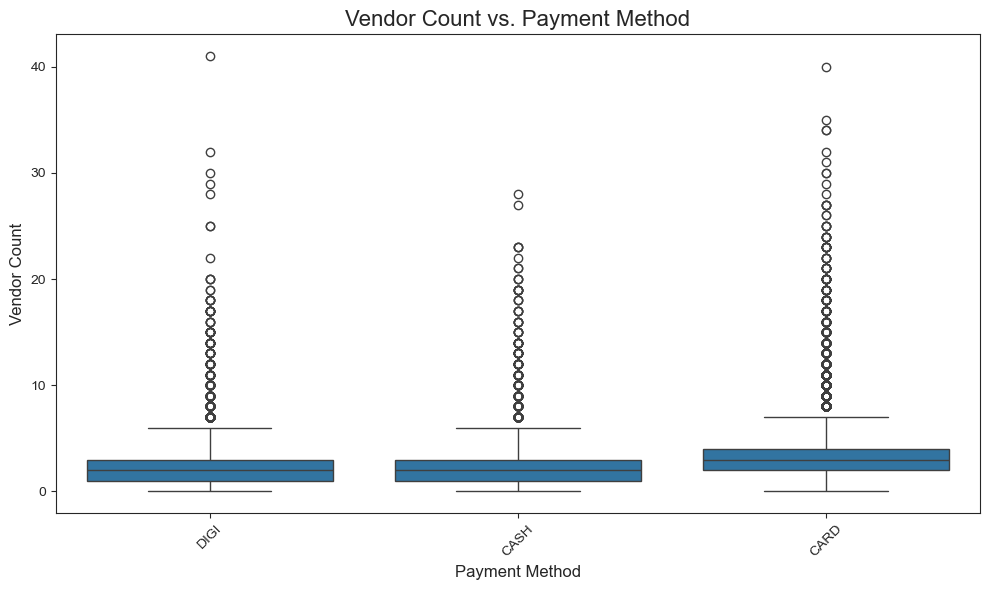

In [84]:
# Set up the plot size and style
plt.figure(figsize=(10, 6))
sns.set_style('ticks')

# Create a boxplot for Vendor Count vs. Payment Method
sns.boxplot(data=data, x='payment_method', y='vendor_count')

plt.title('Vendor Count vs. Payment Method', fontsize=16)
plt.xlabel('Payment Method', fontsize=12)
plt.ylabel('Vendor Count', fontsize=12)
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

This suggests that customers generally tend to order from a similar number of vendors regardless of the payment method. <Br>
These outliers indicate that a small number of customers are ordering from significantly more vendors than the average customer, but it is not typical behavior.<Br>
The DIGI payment method has a slightly tighter distribution, meaning most customers using digital payments tend to order from a smaller range of vendors.
CASH and CARD payments show a broader range of vendor counts, with a higher number of outliers.

While the median number of vendors customers order from seems to be consistent across payment methods, customers paying with cash and card might be more likely to order from more vendors than those using digital payments.

##### Hours ~ cuisine type


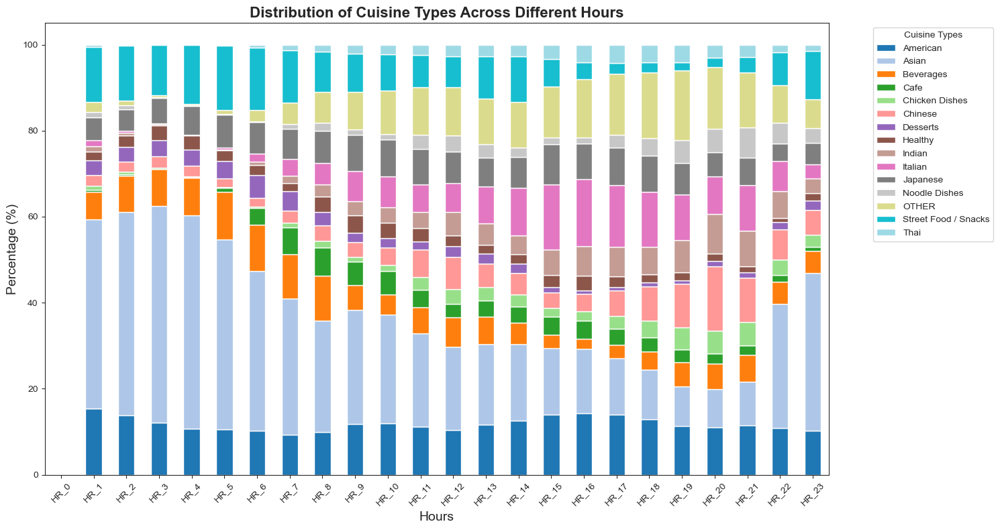

In [85]:
# Calculating the total spending on each cuisine type for each hour
hourly_data = pd.DataFrame()

for hour in hourly_features:
    hourly_data[hour] = (data[cuisine_features].multiply(data[hour], axis=0)).sum()

# Transpose the DataFrame to have hours as rows and cuisine types as columns
hourly_data = hourly_data.T
hourly_data.columns = [col.replace('CUI_', '') for col in hourly_data.columns] 

# Normalize the data to represent percentages
hourly_data_normalized = hourly_data.div(hourly_data.sum(axis=1), axis=0) * 100

# Plotting a stacked bar chart with normalized values
hourly_data_normalized.plot(kind='bar', stacked=True, figsize=(15, 8), colormap='tab20')
plt.title('Distribution of Cuisine Types Across Different Hours', fontsize=16, fontweight='bold')
plt.xlabel('Hours', fontsize=14)
plt.ylabel('Percentage (%)', fontsize=14)
plt.xticks(rotation=45)
plt.legend(title='Cuisine Types', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

plt.show()

<Figure size 1500x800 with 0 Axes>

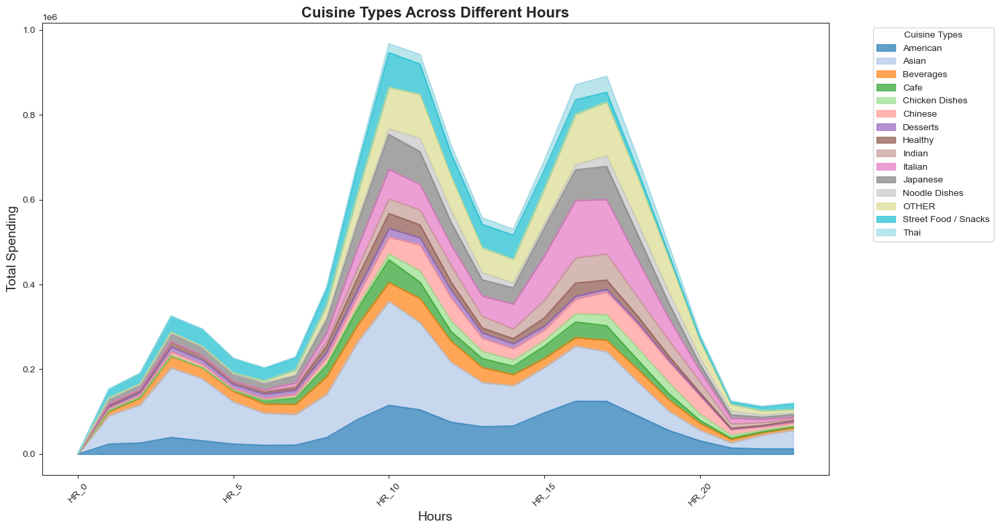

In [86]:
# Plotting a stacked area chart for total spending across different hours
plt.figure(figsize=(15, 8))
hourly_data.plot(kind='area', stacked=True, colormap='tab20', alpha=0.7, figsize=(15, 8))

# Adding title and labels with appropriate descriptions
plt.title('Cuisine Types Across Different Hours', fontsize=16, fontweight='bold')
plt.xlabel('Hours', fontsize=14)
plt.ylabel('Total Spending', fontsize=14)
plt.xticks(rotation=45)
plt.legend(title='Cuisine Types', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()

##### Days of the week ~ Cuisine Types

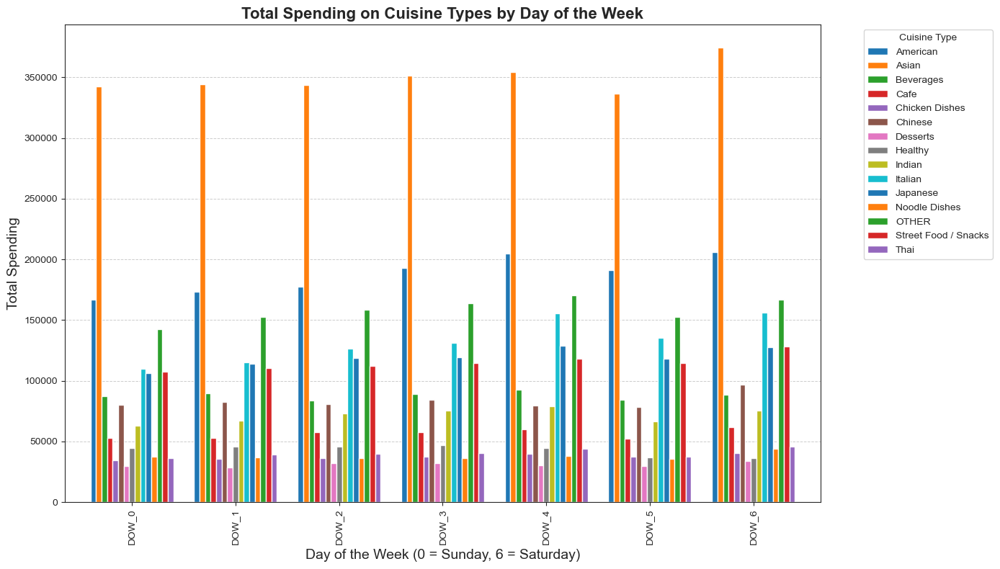

In [87]:
# Sum the values for each cuisine type on each day of the week
cuisine_by_day = pd.DataFrame()

for day in weekday_features:
    cuisine_by_day[day] = data[cuisine_features].multiply(data[day], axis=0).sum()

# Transpose the DataFrame to have days of the week as rows and cuisine types as columns
cuisine_by_day = cuisine_by_day.T
cuisine_by_day.columns = [col.replace('CUI_', '') for col in cuisine_by_day.columns]  # Remove 'CUI_' prefix

# Plot the grouped bar chart
cuisine_by_day.plot(kind='bar', figsize=(14, 8), width=0.8)

# Add titles and labels
plt.title('Total Spending on Cuisine Types by Day of the Week', fontsize=16, fontweight='bold')
plt.xlabel('Day of the Week (0 = Sunday, 6 = Saturday)', fontsize=14)
plt.ylabel('Total Spending', fontsize=14)
plt.legend(title='Cuisine Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(axis='y', linestyle='--', linewidth=0.7)

plt.tight_layout()
plt.show()

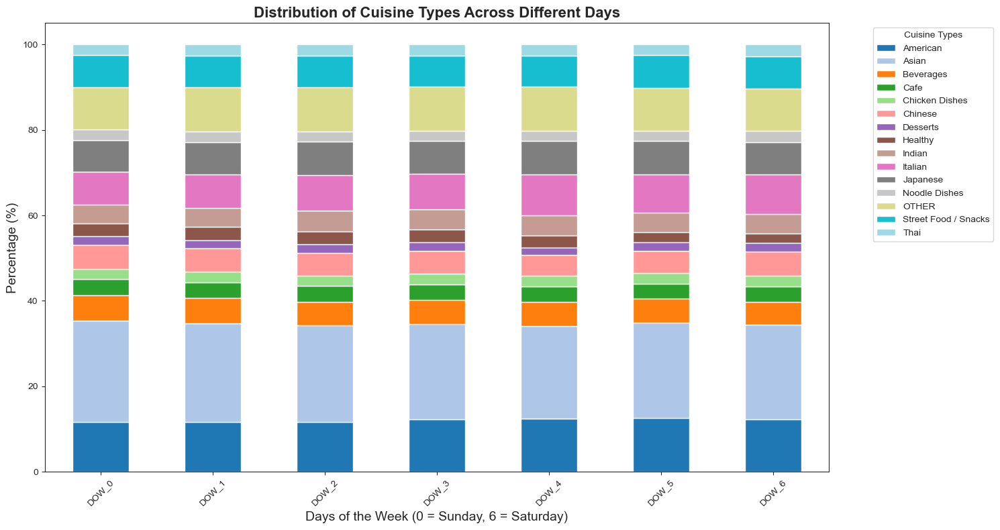

In [88]:
# Calculating the total spending on each cuisine type for each day of the week
weekly_data = pd.DataFrame()

for day in weekday_features:
    weekly_data[day] = (data[cuisine_features].multiply(data[day], axis=0)).sum()

# Transpose the DataFrame to have days as rows and cuisine types as columns
weekly_data = weekly_data.T
weekly_data.columns = [col.replace('CUI_', '') for col in weekly_data.columns] 

# Normalize the data to represent percentages
weekly_data_normalized = weekly_data.div(weekly_data.sum(axis=1), axis=0) * 100

# Plotting a stacked bar chart with normalized values
weekly_data_normalized.plot(kind='bar', stacked=True, figsize=(15, 8), colormap='tab20')
plt.title('Distribution of Cuisine Types Across Different Days', fontsize=16, fontweight='bold')
plt.xlabel('Days of the Week (0 = Sunday, 6 = Saturday)', fontsize=14)
plt.ylabel('Percentage (%)', fontsize=14)
plt.xticks(rotation=45)
plt.legend(title='Cuisine Types', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

##### Last Promo ~ Hours

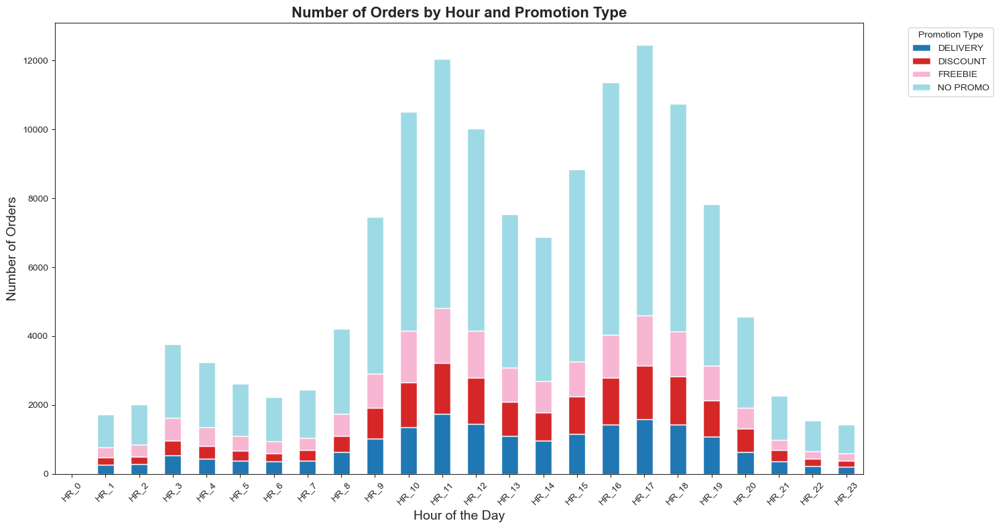

In [89]:
# Creating a DataFrame to hold the count of orders by hour and by promotion type
promotion_data = pd.DataFrame()

# Counting the number of orders using different promotions for each hour
for hour in hourly_features:
    # Filter by promotion type and count occurrences
    promotion_data[hour] = data.groupby('last_promo')[hour].sum()

# Transpose the DataFrame to have hours as rows and promotion types as columns
promotion_data = promotion_data.T

# Plotting the stacked bar chart
promotion_data.plot(kind='bar', stacked=True, figsize=(15, 8), colormap='tab20')
plt.title('Number of Orders by Hour and Promotion Type', fontsize=16, fontweight='bold')
plt.xlabel('Hour of the Day', fontsize=14)
plt.ylabel('Number of Orders', fontsize=14)
plt.xticks(rotation=45)
plt.legend(title='Promotion Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# 3. Data preprocessing

## 3.1 Missing Values Treatment

In [90]:
missing_percentage = (data.isnull().sum() / data.shape[0]) * 100

missing_percentage_nonzero = missing_percentage[missing_percentage > 0]

print("Percentage of Missing Values (greater than 0%):")
print((missing_percentage_nonzero.round(1).astype(str) + '%'))

Percentage of Missing Values (greater than 0%):
customer_region       1.4%
customer_age          2.3%
first_order           0.3%
HR_0                  3.7%
purchase_frequency    0.3%
age_group             2.3%
dtype: object


##### HR_0

In [91]:
data['HR_0'].isna().sum()

1164

In [92]:
# Calculate the sum of orders from 'HR_0' to 'HR_23' 
sum_hours = data[hourly_features].sum(axis=1)

# Calculate the difference between total orders and the sum of hourly orders
data['HR_0'] = data['total_orders'] - sum_hours


##### Customer_age

In [93]:
data['customer_age'].isna().sum()

727

In [94]:
data = knn_impute_column(data, column_to_impute='customer_age')
data['customer_age'] = data['customer_age'].round()

In [95]:
data.head()

,customer_id,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,diversity_cuisine_types,purchase_frequency,recency,top_cuisine,age_group,spent_top_cuisine,spend_per_order,spent_main_food,spent_beverages_addons,products_per_order
0,1b8f824d5e,2360,18.0,2,5,1,0.0,1,DELIVERY,DIGI,...,1,2.500000,89,CUI_Indian,0-18,1.000000,14.440,1.0,0.0,2.5
1,5d272b9dcb,8670,17.0,2,2,2,0.0,1,DISCOUNT,DIGI,...,2,1.000000,89,CUI_American,0-18,0.667361,9.605,1.0,0.0,1.0
2,f6d1b2ba63,4660,38.0,1,2,2,0.0,1,DISCOUNT,CASH,...,1,1.000000,89,CUI_American,36-45,1.000000,4.600,1.0,0.0,1.0
3,180c632ed8,4660,25.0,2,3,1,0.0,2,DELIVERY,DIGI,...,2,1.000000,88,CUI_Indian,NaN,0.565906,15.780,1.0,0.0,1.5
4,4eb37a6705,4660,20.0,2,5,0,0.0,2,NO PROMO,DIGI,...,2,1.666667,88,CUI_Asian,19-25,0.737193,27.720,1.0,0.0,2.5


##### Customer region

In [96]:
data['customer_region'].isna().sum()

442

In [97]:
mode_region = data.groupby('top_cuisine')['customer_region'].agg(lambda x: x.mode().iloc[0] if not x.mode().empty else None)

data['customer_region'] = data.apply(
    lambda row: mode_region[row['top_cuisine']] if pd.isna(row['customer_region']) else row['customer_region'],
    axis=1
)

In [98]:
data['customer_region'].isna().sum()

0

In [99]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 31875 entries, 0 to 31887
Data columns (total 75 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   customer_id               31875 non-null  object  
 1   customer_region           31875 non-null  object  
 2   customer_age              31875 non-null  float64 
 3   vendor_count              31875 non-null  int64   
 4   product_count             31875 non-null  int64   
 5   is_chain                  31875 non-null  int64   
 6   first_order               31769 non-null  float64 
 7   last_order                31875 non-null  int64   
 8   last_promo                31875 non-null  object  
 9   payment_method            31875 non-null  object  
 10  CUI_American              31875 non-null  float64 
 11  CUI_Asian                 31875 non-null  float64 
 12  CUI_Beverages             31875 non-null  float64 
 13  CUI_Cafe                  31875 non-null  float64 


##### First_order

In [100]:
data['first_order'].isna().sum()

106

In [101]:
missing_first_order = data[data['first_order'].isna()]

frequency_table = missing_first_order['last_order'].value_counts().reset_index()
frequency_table.columns = ['last_order', 'frequency']

print("Frequency Table of 'last_order' When 'first_order' is NaN:")
print(frequency_table)

Frequency Table of 'last_order' When 'first_order' is NaN:
   last_order  frequency
0           0        106


In [102]:
# Filter rows where 'first_order' is NaN
missing_first_order = data[data['first_order'].isna()]

# Create a frequency table of 'total_orders'
frequency_table = missing_first_order['total_orders'].value_counts().reset_index()
frequency_table.columns = ['total_orders', 'frequency']

# Display the frequency table
print("Frequency Table of 'total_orders' When 'first_order' is NaN:")
print(frequency_table)


Frequency Table of 'total_orders' When 'first_order' is NaN:
   total_orders  frequency
0             1        104
1             2          2


When the first order is NaN, the last_order is 0 and total_orders > 1. This means that the orders were placed in the beggining of the dataset so we will impute as 0.

In [103]:
data['first_order'].fillna(0, inplace=True)

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\434162698.py:1: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





##### Purchase Frequency

This feature is directly dependent on the first_order. Since first_order contains 0.3% missing values, this feature also exhibits the same percentage of missing values. To address this, we will handle the missing values in this feature using the first_order values after applying the missing values treatment.

In [104]:
data['purchase_frequency'] = data.apply(lambda row: row['product_count'] 
    if row['last_order'] == row['first_order'] 
    else row['product_count'] / (row['last_order'] - row['first_order']), axis=1)

##### Age Group

This feature is directly dependent on the customer_age. Since customer_age contains 2.3% missing values, this feature also exhibits the same percentage of missing values. To address this, we will handle the missing values in this feature using the customer_age values after applying the missing values treatment.

In [105]:
data['age_group'] = pd.cut(data['customer_age'], bins=age_bins, labels=age_labels)

##### Night Orders

This feature includes data from HR_0. Therefore, it is essential to adjust this feature after addressing the missing values in HR_0.

In [106]:
data['night_orders'] = data[late_night_hours].sum(axis=1)

## 3.2 Outlier Treatment

Numerical Variables with Outliers (Identified via Boxplot Analysis):

- **customer_age**: We have chosen not to treat the outliers in this variable, as we believe they reflect the genuine age range of customers rather than anomalies. However, we will explore the potential need to define a threshold for customers aged 65 and above and consider grouping customers in this category for more meaningful analysis.

- Variables related to the number of orders (**vendor_count, product_count, is_chain, total_orders, and columns by days of the week, hours of the day, and meal periods**): The outliers observed in these variables appear to be interconnected. Specifically, we suspect a strong relationship between high values in total_orders which may influence the other variables. To address this, we are prioritizing total_orders as a representative feature for outlier removal. Our expectation is that resolving outliers in total_orders will have a cascading effect on the related variables, simplifying the overall outlier treatment process.

- Variables related to the amount spent by cuisine types (**total_spend, spent_top_cuisine and columns by cuisine type**): The outliers observed in these variables appear to be interconnected. Specifically, we suspect a strong relationship between high values in total_spent which may influence the other variables. To address this, we are prioritizing total_spent as a representative feature for outlier removal. Our expectation is that resolving outliers in total_spend will have a cascading effect on the related variables, simplifying the overall outlier treatment process.

#### Overview

In [107]:
number_of_orders = ['vendor_count', 'product_count', 'is_chain', 'total_orders']

summary_statistics = data[number_of_orders].describe().round(2)
print(summary_statistics)

       vendor_count  product_count  is_chain  total_orders
count      31875.00       31875.00  31875.00      31875.00
mean           3.10           5.67      2.82          4.37
std            2.77           6.96      3.98          5.08
min            0.00           0.00      0.00          0.00
25%            1.00           2.00      1.00          2.00
50%            2.00           3.00      2.00          3.00
75%            4.00           7.00      3.00          5.00
max           41.00         269.00     83.00         94.00


In [108]:
days_of_the_week = [col for col in data.columns if col.startswith('DOW_')]

summary_statistics = data[days_of_the_week].describe().round(2)
print(summary_statistics)

          DOW_0     DOW_1     DOW_2     DOW_3     DOW_4     DOW_5     DOW_6
count  31875.00  31875.00  31875.00  31875.00  31875.00  31875.00  31875.00
mean       0.56      0.57      0.59      0.62      0.68      0.65      0.70
std        1.01      1.04      1.05      1.07      1.09      1.07      1.17
min        0.00      0.00      0.00      0.00      0.00      0.00      0.00
25%        0.00      0.00      0.00      0.00      0.00      0.00      0.00
50%        0.00      0.00      0.00      0.00      0.00      0.00      0.00
75%        1.00      1.00      1.00      1.00      1.00      1.00      1.00
max       16.00     17.00     15.00     17.00     16.00     20.00     20.00


In [109]:
meal_period = [col for col in data.columns if col.endswith('_orders') and col != 'total_orders']

summary_statistics = data[meal_period].describe().round(2)
print(summary_statistics)

       breakfast_orders  lunch_orders  snack_orders  dinner_orders  \
count          31875.00      31875.00      31875.00       31875.00   
mean               0.84          1.14          1.02           0.85   
std                1.82          2.04          1.90           1.86   
min                0.00          0.00          0.00           0.00   
25%                0.00          0.00          0.00           0.00   
50%                0.00          1.00          0.00           0.00   
75%                1.00          1.00          1.00           1.00   
max               72.00         51.00         46.00          51.00   

       night_orders  
count      31875.00  
mean           0.51  
std            1.32  
min            0.00  
25%            0.00  
50%            0.00  
75%            0.00  
max           31.00  


In [110]:
amount_spent = [col for col in data.columns if col.startswith('CUI_')] + ['total_spend'] + ['spent_top_cuisine'] + ['spend_per_order']

summary_statistics = data[amount_spent].describe().round(2)
print(summary_statistics)

       CUI_American  CUI_Asian  CUI_Beverages  CUI_Cafe  CUI_Chicken Dishes  \
count      31875.00   31875.00       31875.00  31875.00            31875.00   
mean           4.88       9.96           2.30      0.80                0.77   
std           11.65      23.56           8.48      6.43                3.66   
min            0.00       0.00           0.00      0.00                0.00   
25%            0.00       0.00           0.00      0.00                0.00   
50%            0.00       0.00           0.00      0.00                0.00   
75%            5.66      11.83           0.00      0.00                0.00   
max          280.21     896.71         229.22    326.10              219.66   

       CUI_Chinese  CUI_Desserts  CUI_Healthy  CUI_Indian  CUI_Italian  \
count     31875.00      31875.00     31875.00    31875.00     31875.00   
mean          1.43          0.88         0.95        1.63         3.23   
std           8.19          5.26         5.83        7.44        1

#### Number of Orders

##### IQR

In [111]:
column = 'total_orders'
Q1 = data[column].quantile(0.25)
Q3 = data[column].quantile(0.75)
IQR = Q3 - Q1

# Determine the upper bound
upper_bound = Q3 + 1.5 * IQR

# Identify outliers
outliers = data[column] > upper_bound

print(f'Using {upper_bound} as threshold, we identified {outliers.sum()} outliers in {column}, that represent {outliers.sum() / len(data) * 100:.2f}% of the dataset.')

Using 9.5 as threshold, we identified 3027 outliers in total_orders, that represent 9.50% of the dataset.


In [112]:
# Display summary statistics for 'product_count', 'vendor_count', and 'is_chain' in the outlier rows
summary_removed_outliers = data[outliers][number_of_orders].describe()

# Print the number of rows removed and the summary statistics
print(f"Number of rows removed: {outliers.sum()}")
print("Summary statistics of removed rows:")
print(summary_removed_outliers)


Number of rows removed: 3027
Summary statistics of removed rows:
       vendor_count  product_count     is_chain  total_orders
count   3027.000000    3027.000000  3027.000000   3027.000000
mean       8.902213      21.483317    10.894615     16.350842
std        4.462558      12.324001     7.894952      8.535130
min        1.000000      10.000000     0.000000     10.000000
25%        6.000000      14.000000     6.000000     11.000000
50%        8.000000      18.000000    10.000000     14.000000
75%       11.000000      25.000000    13.000000     18.000000
max       41.000000     269.000000    83.000000     94.000000


Using the IQR method, we identified outliers that would result in the removal of 9.50% of rows from the dataset. However, removing such a significant portion of our customers could lead to a loss of valuable insights and potentially introduce bias. Therefore, instead of removing all these rows, we opted for a more balanced approach: grouping moderate outliers together and only deleting the extreme outliers, specifically those beyond the 99th percentile.

##### Outlier Handling using the 99th percentile threshold

In [113]:
column='total_orders'

# Setting a new threshold based on the 99th percentile
new_threshold = data[column].quantile(0.99).round()

# Identify outliers based on the new threshold
outliers_order = data[column] > new_threshold
num_outliers = outliers_order.sum()

print(f"Using a threshold of {new_threshold}, we identified {num_outliers} outliers in {column}, that represent {num_outliers / len(data) * 100:.2f}% of the dataset.")

Using a threshold of 25.0, we identified 297 outliers in total_orders, that represent 0.93% of the dataset.


In [114]:
# Display summary statistics for 'product_count', 'vendor_count', and 'is_chain' in the outlier rows
summary_removed_outliers = data[outliers_order][number_of_orders].describe()

# Print the number of rows removed and the summary statistics
print(f"Number of rows removed: {outliers_order.sum()}")
print("Summary statistics of removed rows:")
print(summary_removed_outliers)

Number of rows removed: 297
Summary statistics of removed rows:
       vendor_count  product_count    is_chain  total_orders
count     297.00000     297.000000  297.000000    297.000000
mean       15.00000      47.696970   25.319865     36.373737
std         7.27361      20.880995   13.564985     12.407430
min         1.00000      26.000000    0.000000     26.000000
25%        10.00000      35.000000   18.000000     28.000000
50%        14.00000      41.000000   25.000000     32.000000
75%        19.00000      55.000000   31.000000     41.000000
max        41.00000     269.000000   83.000000     94.000000


In [115]:
data_treated = data[~outliers_order]

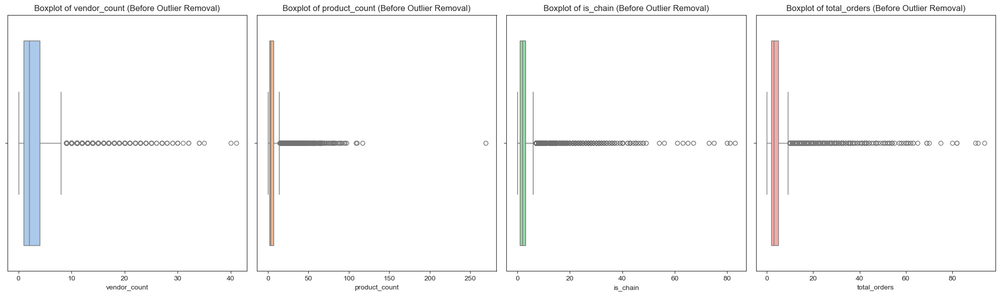

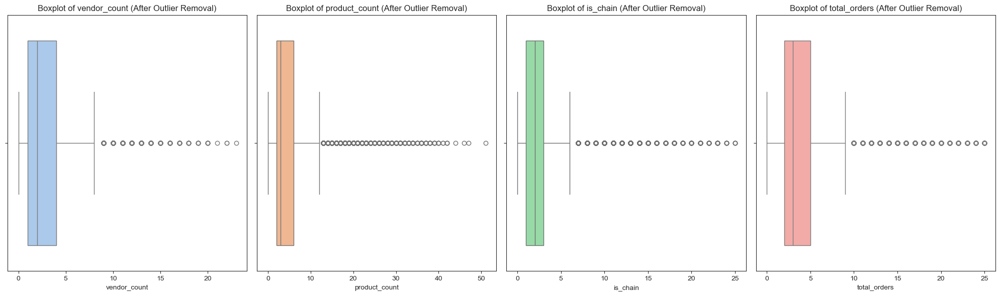

In [116]:
# Variables to plot
variables = number_of_orders
colors = sns.color_palette("pastel", len(variables))

# Boxplots before removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data, x=var, color=color)
    plt.title(f'Boxplot of {var} (Before Outlier Removal)')
plt.tight_layout()
plt.show()

# Boxplots after removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data_treated, x=var, color=color)
    plt.title(f'Boxplot of {var} (After Outlier Removal)')
plt.tight_layout()
plt.show()

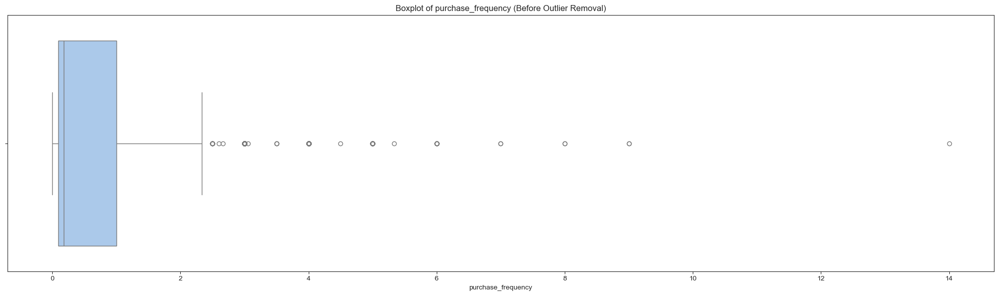

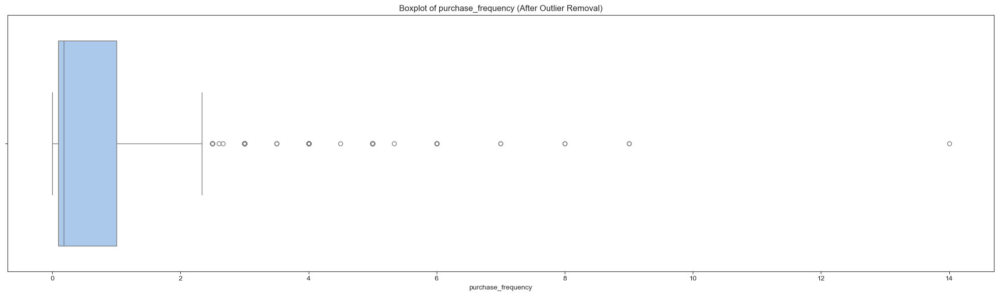

In [117]:
# Variables to plot
variables = ['purchase_frequency']
colors = sns.color_palette("pastel", len(variables))

# Boxplots before removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data, x=var, color=color)
    plt.title(f'Boxplot of {var} (Before Outlier Removal)')
plt.tight_layout()
plt.show()

# Boxplots after removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data_treated, x=var, color=color)
    plt.title(f'Boxplot of {var} (After Outlier Removal)')
plt.tight_layout()
plt.show()

##### Winsorization

In [118]:
threshold_product_count = data_treated['product_count'].quantile(0.995).round()
print(f'The threshold for winsorization of product_count is {threshold_product_count}')
data_treated = winsorize(data_treated, 'product_count', 0, 0.995)

The threshold for winsorization of product_count is 30.0


In [119]:
data_treated['purchase_frequency'] = data_treated.apply(lambda row: row['product_count'] / (row['last_order'] - row['first_order'] + 1), axis=1)

In [120]:
data_treated['products_per_order'] = data_treated.apply(lambda row: row['product_count'] / row['total_orders'] if row['total_orders'] != 0 else 0, axis=1)

In [121]:
threshold_vendor_count = data_treated['vendor_count'].quantile(0.995).round()
threshold_vendor_count
print(f'The threshold for winsorization of vendor_count is {threshold_vendor_count}')
data_treated = winsorize(data_treated, 'vendor_count', 0, 0.995)

The threshold for winsorization of vendor_count is 14.0


In [122]:
threshold_is_chain = data_treated['is_chain'].quantile(0.995).round()
threshold_is_chain
print(f'The threshold for winsorization of is_chain is {threshold_is_chain}')
data_treated = winsorize(data_treated, 'is_chain', 0, 0.995)

The threshold for winsorization of is_chain is 18.0


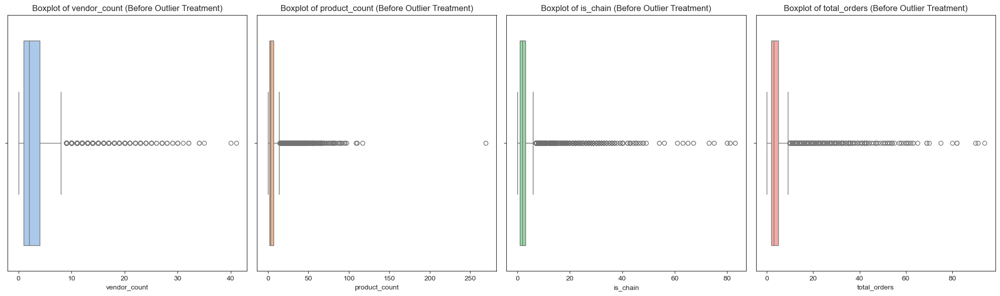

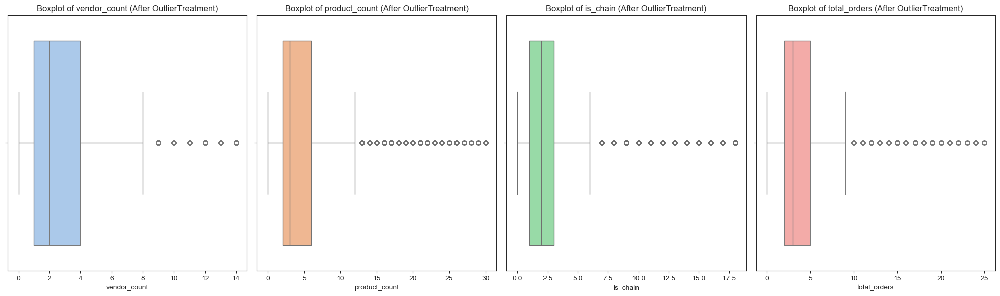

In [123]:
# Variables to plot
variables = number_of_orders
colors = sns.color_palette("pastel", len(variables))

# Boxplots before removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data, x=var, color=color)
    plt.title(f'Boxplot of {var} (Before Outlier Treatment)')
plt.tight_layout()
plt.show()

# Boxplots after removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data_treated, x=var, color=color)
    plt.title(f'Boxplot of {var} (After OutlierTreatment)')
plt.tight_layout()
plt.show()

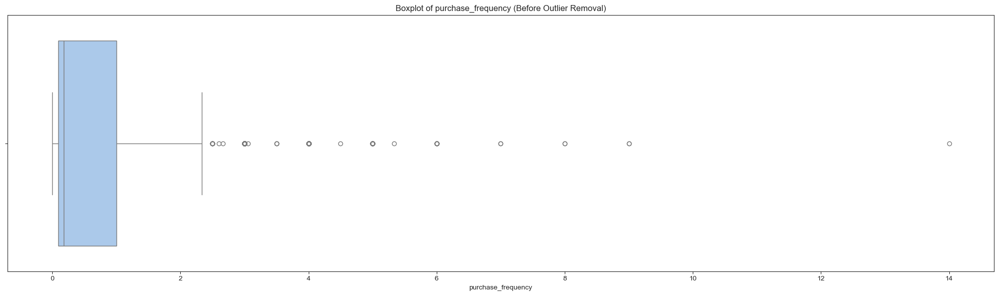

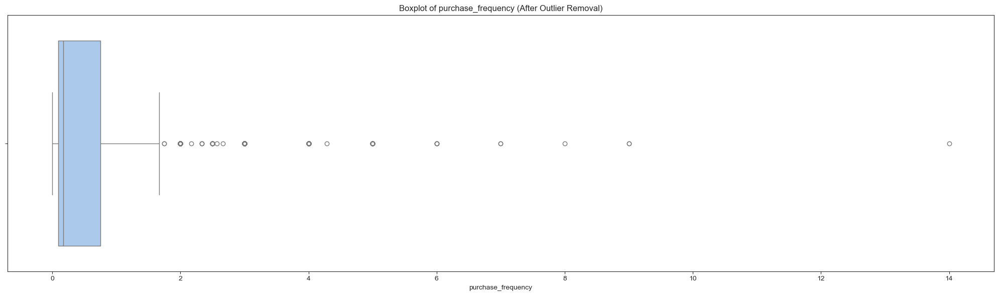

In [124]:
# Variables to plot
variables = ['purchase_frequency']
colors = sns.color_palette("pastel", len(variables))

# Boxplots before removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data, x=var, color=color)
    plt.title(f'Boxplot of {var} (Before Outlier Removal)')
plt.tight_layout()
plt.show()

# Boxplots after removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data_treated, x=var, color=color)
    plt.title(f'Boxplot of {var} (After Outlier Removal)')
plt.tight_layout()
plt.show()

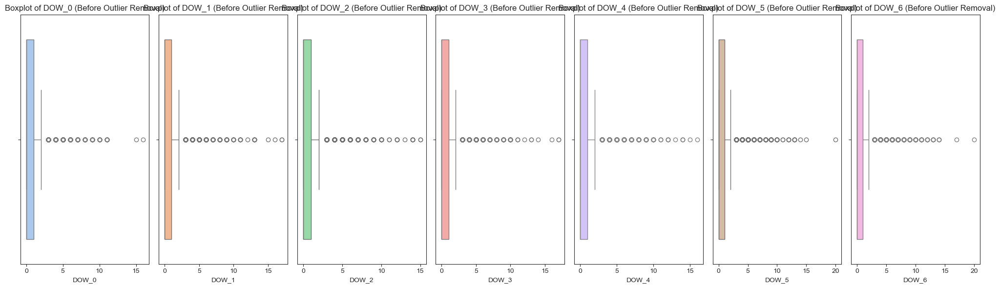

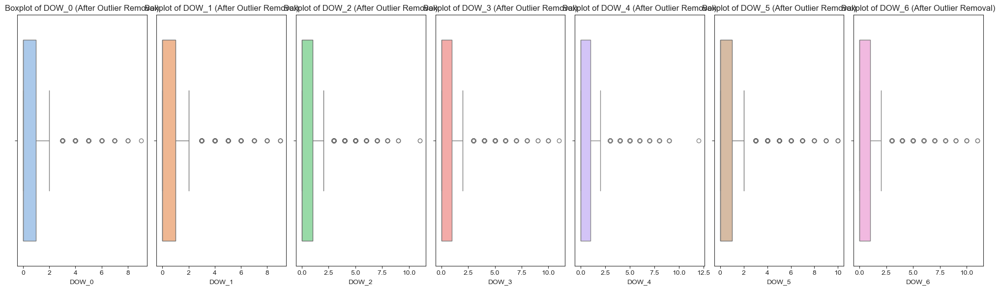

In [125]:
# Variables to plot (DOW_0 to DOW_6)
variables = days_of_the_week
colors = sns.color_palette("pastel", len(variables))  

# Boxplots before removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data, x=var, color=color)
    plt.title(f'Boxplot of {var} (Before Outlier Removal)')
plt.tight_layout()
plt.show()

# Boxplots after removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data_treated, x=var, color=color)
    plt.title(f'Boxplot of {var} (After Outlier Removal)')
plt.tight_layout()
plt.show()


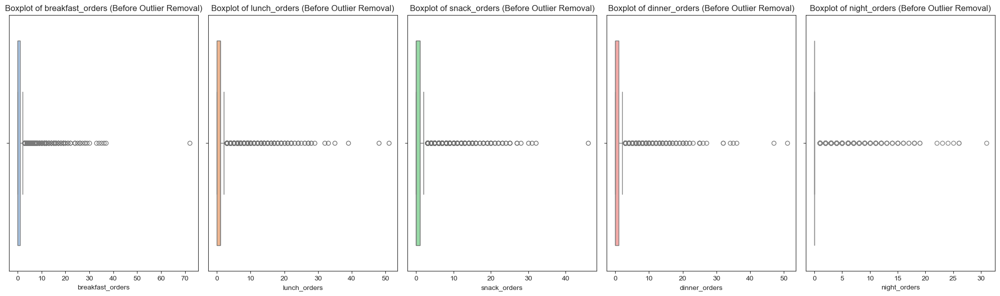

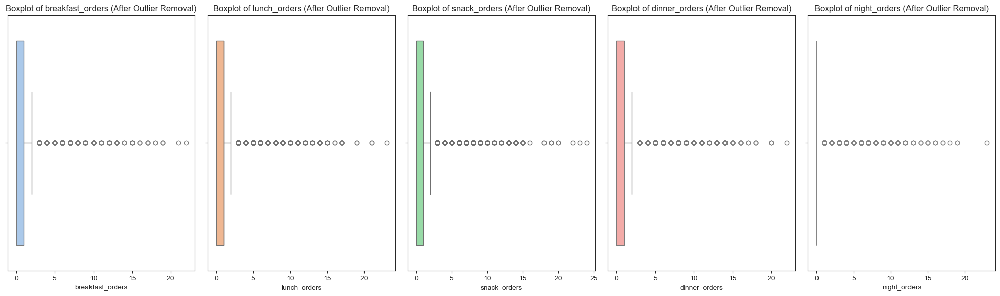

In [126]:
variables = meal_period
colors = sns.color_palette("pastel", len(variables))  

# Boxplots before removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data, x=var, color=color)
    plt.title(f'Boxplot of {var} (Before Outlier Removal)')
plt.tight_layout()
plt.show()

# Boxplots after removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data_treated, x=var, color=color)
    plt.title(f'Boxplot of {var} (After Outlier Removal)')
plt.tight_layout()
plt.show()

We removed customers whose total_orders exceeded the 99th percentile (which corresponds to over 25 products).
By removing these extreme outliers of total_orders, we also effectively removed the extreme outliers of related features, such as vendor_count, is_chain, product_count and the variables related to days of the week, hours of the day and meal_period. Also, we winsorize product_count, is_chain and vendor_count. We don't apply winsorization to features related to the number of orders, such as total_orders, all DOW_, all HR_, breakfast_orders, lunch_orders, snack_orders, dinner_orders and night_orders because they are interconnected. We address this issue by looking to startweek_orders, endweek_orders and other features related to number of orders by meal period in section 3.5.

#### Spending Amounts

##### IQR

In [127]:
amount_spent = ['total_spend'] + ['spend_per_order']

summary_statistics = data_treated[amount_spent].describe().round(2)
print(summary_statistics)

       total_spend  spend_per_order
count     31578.00         31578.00
mean         36.46            10.30
std          40.07             7.89
min           0.00             0.00
25%          12.78             5.04
50%          24.01             8.22
75%          43.93            12.94
max         617.40           104.32


In [128]:
column = 'total_spend'
Q1 = data_treated[column].quantile(0.25)
Q3 = data_treated[column].quantile(0.75)
IQR = Q3 - Q1

# Determine the upper bound
upper_bound = Q3 + 1.5 * IQR

# Identify outliers
outliers = data_treated[column] > upper_bound

print(f'Using {upper_bound} as threshold, we identified {outliers.sum()} outliers in {column}, that represent {outliers.sum() / len(data_treated) * 100:.2f}% of the dataset.')

Using 90.65125 as threshold, we identified 2483 outliers in total_spend, that represent 7.86% of the dataset.


In [129]:
# Display summary statistics for 'product_count', 'vendor_count', and 'is_chain' in the outlier rows
summary_removed_outliers = data_treated[outliers][amount_spent].describe()

# Print the number of rows removed and the summary statistics
print(f"Number of rows removed: {outliers.sum()}")
print("Summary statistics of removed rows:")
print(summary_removed_outliers)


Number of rows removed: 2483
Summary statistics of removed rows:
       total_spend  spend_per_order
count  2483.000000      2483.000000
mean    142.878139        15.731226
std      58.056212         9.253711
min      90.700000         3.833333
25%     104.170000         9.462864
50%     123.770000        13.632222
75%     161.015000        19.235278
max     617.400000       104.320000


Using the IQR method, we identified outliers that would result in the removal of 7.86% of rows from the dataset. However, removing such a significant portion of our customers could lead to a loss of valuable insights and potentially introduce bias. Therefore, instead of removing all these rows, we opted for a more balanced approach: grouping moderate outliers together and only deleting the extreme outliers, specifically those beyond the 99th percentile.

##### Outlier Handling using the 97.5th percentile threshold

In [130]:
column='total_spend'

# Setting a new threshold based on the 97.5th percentile
new_threshold = data_treated[column].quantile(0.975).round()

# Identify outliers based on the new threshold
outliers_spent = data_treated[column] > new_threshold
num_outliers = outliers_spent.sum()

print(f"Using a threshold of {new_threshold}, we identified {num_outliers} outliers in {column}, that represent {num_outliers / len(data) * 100:.2f}% of the original dataset.")

Using a threshold of 148.0, we identified 789 outliers in total_spend, that represent 2.48% of the original dataset.


In [131]:
# Display summary statistics for 'product_count', 'vendor_count', and 'is_chain' in the outlier rows
summary_removed_outliers = data_treated[outliers_spent][amount_spent].describe()

# Print the number of rows removed and the summary statistics
print(f"Number of rows removed: {outliers_spent.sum()}")
print("Summary statistics of removed rows:")
print(summary_removed_outliers)

Number of rows removed: 789
Summary statistics of removed rows:
       total_spend  spend_per_order
count   789.000000       789.000000
mean    206.596781        17.580282
std      64.141487         9.280403
min     148.020000         6.247917
25%     163.510000        11.289167
50%     185.860000        15.514000
75%     225.110000        21.132500
max     617.400000        88.230000


In [132]:
data_treated = data_treated[~outliers_spent]

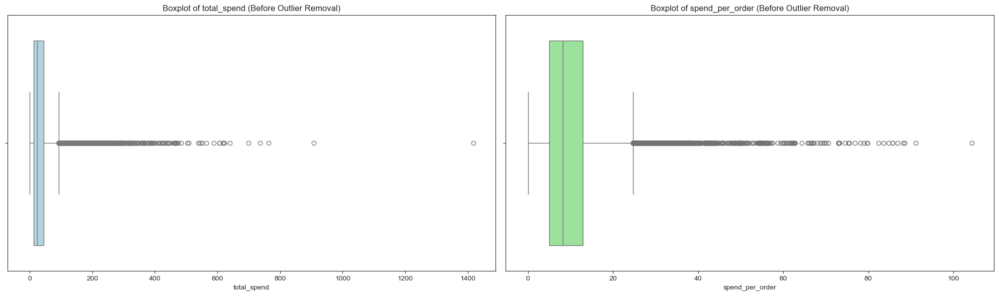

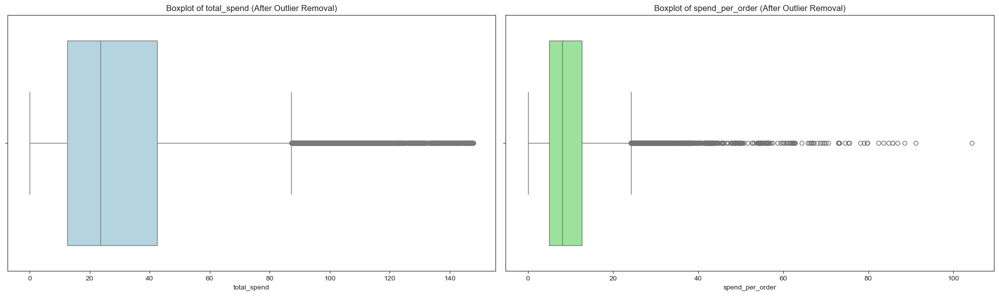

In [133]:
# Variables to plot
variables = amount_spent
colors = ['lightblue', 'lightgreen']

# Boxplots before removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data, x=var, color=color)
    plt.title(f'Boxplot of {var} (Before Outlier Removal)')
plt.tight_layout()
plt.show()

# Boxplots after removing outliers
plt.figure(figsize=(20, 6))
for i, (var, color) in enumerate(zip(variables, colors)):
    plt.subplot(1, len(variables), i + 1)  # Create side-by-side plots
    sns.boxplot(data=data_treated, x=var, color=color)
    plt.title(f'Boxplot of {var} (After Outlier Removal)')
plt.tight_layout()
plt.show()

## 3.3 Scaling Data

In [134]:
data_treated.info()

<class 'pandas.core.frame.DataFrame'>
Index: 30789 entries, 0 to 31887
Data columns (total 75 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   customer_id               30789 non-null  object  
 1   customer_region           30789 non-null  object  
 2   customer_age              30789 non-null  float64 
 3   vendor_count              30789 non-null  float64 
 4   product_count             30789 non-null  float64 
 5   is_chain                  30789 non-null  float64 
 6   first_order               30789 non-null  float64 
 7   last_order                30789 non-null  int64   
 8   last_promo                30789 non-null  object  
 9   payment_method            30789 non-null  object  
 10  CUI_American              30789 non-null  float64 
 11  CUI_Asian                 30789 non-null  float64 
 12  CUI_Beverages             30789 non-null  float64 
 13  CUI_Cafe                  30789 non-null  float64 


In [135]:
numerical_features = [col for col in data_treated.columns if data_treated[col].dtype not in ['object', 'category']]
numerical_features

['customer_age',
 'vendor_count',
 'product_count',
 'is_chain',
 'first_order',
 'last_order',
 'CUI_American',
 'CUI_Asian',
 'CUI_Beverages',
 'CUI_Cafe',
 'CUI_Chicken Dishes',
 'CUI_Chinese',
 'CUI_Desserts',
 'CUI_Healthy',
 'CUI_Indian',
 'CUI_Italian',
 'CUI_Japanese',
 'CUI_Noodle Dishes',
 'CUI_OTHER',
 'CUI_Street Food / Snacks',
 'CUI_Thai',
 'DOW_0',
 'DOW_1',
 'DOW_2',
 'DOW_3',
 'DOW_4',
 'DOW_5',
 'DOW_6',
 'HR_0',
 'HR_1',
 'HR_2',
 'HR_3',
 'HR_4',
 'HR_5',
 'HR_6',
 'HR_7',
 'HR_8',
 'HR_9',
 'HR_10',
 'HR_11',
 'HR_12',
 'HR_13',
 'HR_14',
 'HR_15',
 'HR_16',
 'HR_17',
 'HR_18',
 'HR_19',
 'HR_20',
 'HR_21',
 'HR_22',
 'HR_23',
 'total_orders',
 'total_spend',
 'different_weekdays',
 'breakfast_orders',
 'lunch_orders',
 'snack_orders',
 'dinner_orders',
 'night_orders',
 'diversity_cuisine_types',
 'purchase_frequency',
 'recency',
 'spent_top_cuisine',
 'spend_per_order',
 'spent_main_food',
 'spent_beverages_addons',
 'products_per_order']

In [136]:
# Initialize the scaler
scaler = StandardScaler()

# Apply standard scaling to the numerical features
data_treated[numerical_features] = scaler.fit_transform(data_treated[numerical_features])

# Display the first few rows of the scaled dataset
print(data_treated[numerical_features].head())  

   customer_age  vendor_count  product_count  is_chain  first_order  \
0     -1.337514     -0.386282       0.033644 -0.516141    -1.204903   
1     -1.478193     -0.386282      -0.634938 -0.170336    -1.204903   
2      1.476068     -0.842398      -0.634938 -0.170336    -1.204903   
3     -0.352760     -0.386282      -0.412078 -0.516141    -1.204903   
4     -1.056156     -0.386282       0.033644 -0.861947    -1.204903   

   last_order  CUI_American  CUI_Asian  CUI_Beverages  CUI_Cafe  ...  \
0   -2.661956     -0.445869  -0.491702      -0.288997 -0.148638  ...   
1   -2.661956      0.894361  -0.104773      -0.288997 -0.148638  ...   
2   -2.661956      0.515919  -0.491702      -0.288997 -0.148638  ...   
3   -2.619006     -0.445869   0.337864      -0.288997 -0.148638  ...   
4   -2.619006      1.077310   1.983069      -0.288997 -0.148638  ...   

   dinner_orders  night_orders  diversity_cuisine_types  purchase_frequency  \
0       0.800364      -0.41903                -0.862581      

## 3.4 Encoding

In [137]:
data_ohc = data_treated.copy()

In [138]:
categorical_features

['customer_region',
 'last_promo',
 'payment_method',
 'day_pattern',
 'top_cuisine',
 'age_group']

In [139]:
# Use OneHotEncoder to encode the categorical features. Get feature names and create a DataFrame 
# with the one-hot encoded categorical features (pass feature names)
ohc = OneHotEncoder(sparse_output=False, drop="first")
ohc_feat = ohc.fit_transform(data_ohc[categorical_features])
ohc_feat_names = ohc.get_feature_names_out()

In [140]:
# Get feature names and create a DataFrame 
# with the one-hot encoded categorical features (pass feature names)
ohc_feat = ohc.fit_transform(data_ohc[categorical_features])
ohc_feat_names = ohc.get_feature_names_out()

In [141]:
ohc_data = pd.DataFrame(ohc_feat, index=data_ohc.index, columns=ohc_feat_names)  # Why the index=df_ohc.index?
ohc_data

,customer_region_2440,customer_region_2490,customer_region_4140,customer_region_4660,customer_region_8370,customer_region_8550,customer_region_8670,last_promo_DISCOUNT,last_promo_FREEBIE,last_promo_NO PROMO,...,top_cuisine_CUI_Noodle Dishes,top_cuisine_CUI_OTHER,top_cuisine_CUI_Street Food / Snacks,top_cuisine_CUI_Thai,age_group_19-25,age_group_26-35,age_group_36-45,age_group_46-55,age_group_56-65,age_group_65+
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31883,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
31884,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
31885,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
31886,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [142]:
# Reassigning df to contain ohc variables
data_ohc = pd.concat([data_ohc, ohc_data], axis=1)
list(data_ohc.columns)

['customer_id',
 'customer_region',
 'customer_age',
 'vendor_count',
 'product_count',
 'is_chain',
 'first_order',
 'last_order',
 'last_promo',
 'payment_method',
 'CUI_American',
 'CUI_Asian',
 'CUI_Beverages',
 'CUI_Cafe',
 'CUI_Chicken Dishes',
 'CUI_Chinese',
 'CUI_Desserts',
 'CUI_Healthy',
 'CUI_Indian',
 'CUI_Italian',
 'CUI_Japanese',
 'CUI_Noodle Dishes',
 'CUI_OTHER',
 'CUI_Street Food / Snacks',
 'CUI_Thai',
 'DOW_0',
 'DOW_1',
 'DOW_2',
 'DOW_3',
 'DOW_4',
 'DOW_5',
 'DOW_6',
 'HR_0',
 'HR_1',
 'HR_2',
 'HR_3',
 'HR_4',
 'HR_5',
 'HR_6',
 'HR_7',
 'HR_8',
 'HR_9',
 'HR_10',
 'HR_11',
 'HR_12',
 'HR_13',
 'HR_14',
 'HR_15',
 'HR_16',
 'HR_17',
 'HR_18',
 'HR_19',
 'HR_20',
 'HR_21',
 'HR_22',
 'HR_23',
 'total_orders',
 'total_spend',
 'different_weekdays',
 'day_pattern',
 'breakfast_orders',
 'lunch_orders',
 'snack_orders',
 'dinner_orders',
 'night_orders',
 'diversity_cuisine_types',
 'purchase_frequency',
 'recency',
 'top_cuisine',
 'age_group',
 'spent_top_cuisine

In [143]:
data = data_ohc.copy()

In [144]:
# You can also choose to drop the original non_metric_features from your df
data.drop(columns=categorical_features, inplace=True)

In [145]:
## Rename OHE columns from "feature_val_a" to "oh_feature_val_a"
## e.g. status_Widow to oh_status_Widow
## We do this to be able to distinguish the OHE columns more easily later

## Assemble OHE columns and their new column names
rename_ohe_cols = {}

for i in categorical_features:
    for j in data.columns[data.columns.str.startswith(i)].to_list() :
        if j not in categorical_features:
            rename_ohe_cols[j] = 'oh_' + j

data.rename(columns=rename_ohe_cols, inplace=True)

In [146]:
data

,customer_id,customer_age,vendor_count,product_count,is_chain,first_order,last_order,CUI_American,CUI_Asian,CUI_Beverages,...,oh_top_cuisine_CUI_Noodle Dishes,oh_top_cuisine_CUI_OTHER,oh_top_cuisine_CUI_Street Food / Snacks,oh_top_cuisine_CUI_Thai,oh_age_group_19-25,oh_age_group_26-35,oh_age_group_36-45,oh_age_group_46-55,oh_age_group_56-65,oh_age_group_65+
0,1b8f824d5e,-1.337514,-0.386282,0.033644,-0.516141,-1.204903,-2.661956,-0.445869,-0.491702,-0.288997,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,5d272b9dcb,-1.478193,-0.386282,-0.634938,-0.170336,-1.204903,-2.661956,0.894361,-0.104773,-0.288997,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,f6d1b2ba63,1.476068,-0.842398,-0.634938,-0.170336,-1.204903,-2.661956,0.515919,-0.491702,-0.288997,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,180c632ed8,-0.352760,-0.386282,-0.412078,-0.516141,-1.204903,-2.619006,-0.445869,0.337864,-0.288997,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
4,4eb37a6705,-1.056156,-0.386282,0.033644,-0.861947,-1.204903,-2.619006,1.077310,1.983069,-0.288997,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31883,f4e366c281,0.350635,-0.842398,-0.857799,-0.516141,-1.204903,-2.704905,-0.445869,-0.491702,2.310308,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
31884,f6b6709018,-0.212081,-0.842398,-0.857799,-0.861947,-1.204903,-2.704905,1.440071,-0.491702,-0.288997,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
31885,f74ad8ce3f,-0.493439,-0.842398,-0.857799,-0.516141,-1.204903,-2.704905,-0.445869,-0.491702,-0.288997,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
31886,f7b19c0241,0.913352,-0.842398,-0.857799,-0.861947,-1.204903,-2.704905,-0.445869,0.236742,-0.288997,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [147]:
list(data.columns)

['customer_id',
 'customer_age',
 'vendor_count',
 'product_count',
 'is_chain',
 'first_order',
 'last_order',
 'CUI_American',
 'CUI_Asian',
 'CUI_Beverages',
 'CUI_Cafe',
 'CUI_Chicken Dishes',
 'CUI_Chinese',
 'CUI_Desserts',
 'CUI_Healthy',
 'CUI_Indian',
 'CUI_Italian',
 'CUI_Japanese',
 'CUI_Noodle Dishes',
 'CUI_OTHER',
 'CUI_Street Food / Snacks',
 'CUI_Thai',
 'DOW_0',
 'DOW_1',
 'DOW_2',
 'DOW_3',
 'DOW_4',
 'DOW_5',
 'DOW_6',
 'HR_0',
 'HR_1',
 'HR_2',
 'HR_3',
 'HR_4',
 'HR_5',
 'HR_6',
 'HR_7',
 'HR_8',
 'HR_9',
 'HR_10',
 'HR_11',
 'HR_12',
 'HR_13',
 'HR_14',
 'HR_15',
 'HR_16',
 'HR_17',
 'HR_18',
 'HR_19',
 'HR_20',
 'HR_21',
 'HR_22',
 'HR_23',
 'total_orders',
 'total_spend',
 'different_weekdays',
 'breakfast_orders',
 'lunch_orders',
 'snack_orders',
 'dinner_orders',
 'night_orders',
 'diversity_cuisine_types',
 'purchase_frequency',
 'recency',
 'spent_top_cuisine',
 'spend_per_order',
 'spent_main_food',
 'spent_beverages_addons',
 'products_per_order',
 'oh_cu

## 3.5 Feature Engineering after Missings and Outliers Treatment

In [148]:
hourly_data = data[hourly_features]
scaled_hourly_data_transposed = pd.DataFrame(hourly_data).T

kmeans = KMeans(n_clusters=4, random_state=42) 
hour_clusters = kmeans.fit_predict(scaled_hourly_data_transposed)

hour_groups = {}
for i, hour in enumerate(hourly_features):
    hour_groups[hour] = f'Group_{hour_clusters[i]}'

print("Hour Groupings based on Clustering:")
for hour, group in hour_groups.items():
    print(f"{hour}: {group}")


Hour Groupings based on Clustering:
HR_0: Group_2
HR_1: Group_2
HR_2: Group_2
HR_3: Group_2
HR_4: Group_2
HR_5: Group_0
HR_6: Group_0
HR_7: Group_0
HR_8: Group_0
HR_9: Group_0
HR_10: Group_0
HR_11: Group_1
HR_12: Group_1
HR_13: Group_1
HR_14: Group_3
HR_15: Group_1
HR_16: Group_1
HR_17: Group_1
HR_18: Group_1
HR_19: Group_1
HR_20: Group_3
HR_21: Group_3
HR_22: Group_3
HR_23: Group_3


c:\Users\bruna\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.



In [149]:
# Step 1: Extract weekday columns
weekday_data = data[weekday_features]

# Step 3: Transpose the data to have weekdays as rows
scaled_weekday_data_transposed = pd.DataFrame(weekday_data).T

# Step 4: Apply K-Means clustering to group weekdays
kmeans = KMeans(n_clusters=2, random_state=42)  # You can adjust 'n_clusters' to explore different numbers of groups
weekday_clusters = kmeans.fit_predict(scaled_weekday_data_transposed)

# Step 5: Create a mapping for the weekday groupings
weekday_groups = {}
for i, weekday in enumerate(weekday_features):
    weekday_groups[weekday] = f'Group_{weekday_clusters[i]}'

# Print the clustering result
print("weekday Groupings based on Clustering:")
for weekday, group in weekday_groups.items():
    print(f"{weekday}: {group}")

weekday Groupings based on Clustering:
DOW_0: Group_0
DOW_1: Group_0
DOW_2: Group_0
DOW_3: Group_0
DOW_4: Group_0
DOW_5: Group_1
DOW_6: Group_1


c:\Users\bruna\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.



In [150]:
data[numerical_features] = scaler.inverse_transform(data[numerical_features])

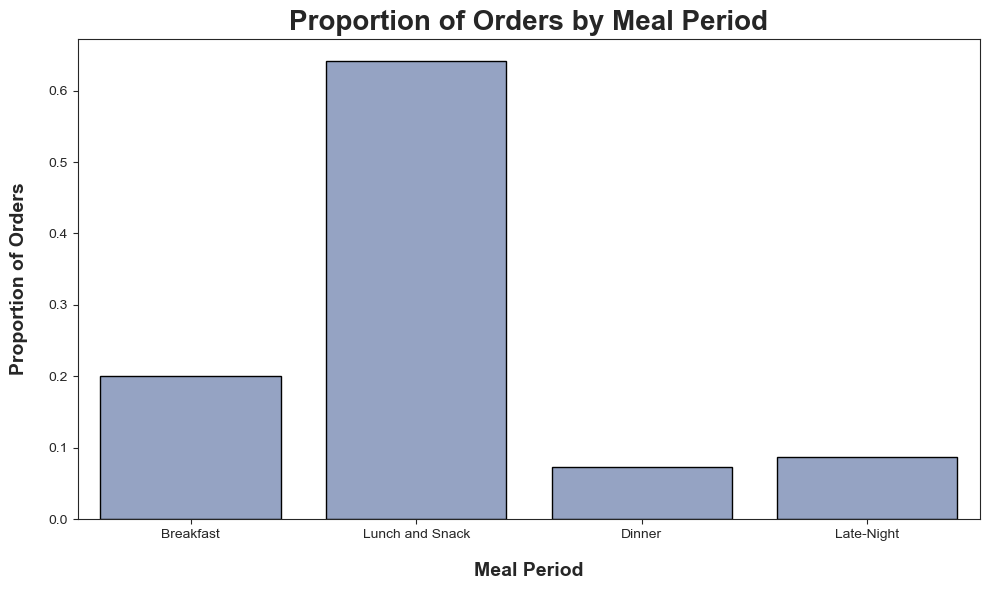

In [151]:
# Define meal period hours
data['breakfast_orders'] = data[[hour for hour, group in hour_groups.items() if group == 'Group_0']].sum(axis=1)
group_1_hours = [hour for hour, group in hour_groups.items() if group == 'Group_1']
data['lunch_snack_orders'] = data[group_1_hours].sum(axis=1) + data['HR_14']
group_3_hours = [hour for hour, group in hour_groups.items() if group == 'Group_3']
data['dinner_orders'] = data[group_3_hours].sum(axis=1) - data['HR_14']
group_2_hours = [hour for hour, group in hour_groups.items() if group == 'Group_2']
data['night_orders'] = data[group_2_hours].sum(axis=1)

# Aggregate total orders for each meal period
meal_period_totals = {
    'Breakfast': data['breakfast_orders'].sum(),
    'Lunch and Snack': data['lunch_snack_orders'].sum(),
    'Dinner': data['dinner_orders'].sum(),
    'Late-Night': data['night_orders'].sum(),
}

# Calculate overall total orders to find proportions
overall_total_orders = sum(meal_period_totals.values())
proportions = {period: orders / overall_total_orders for period, orders in meal_period_totals.items()}

# Create a DataFrame for visualization
meal_period_totals_df = pd.DataFrame({
    'Meal Period': proportions.keys(),
    'Proportion of Orders': proportions.values()
})

# Plot the data
sns.set_style("ticks")
color = sns.color_palette("Set2")[2]  # Use the third color from the Set2 palette
plt.figure(figsize=(10, 6))
sns.barplot(x='Meal Period', y='Proportion of Orders', data=meal_period_totals_df, color=color, edgecolor='black')

# Add titles and labels
plt.title('Proportion of Orders by Meal Period', fontsize=20, fontweight='bold')
plt.xlabel('Meal Period', fontsize=14, fontweight='bold', labelpad=15)
plt.ylabel('Proportion of Orders', fontsize=14, fontweight='bold', labelpad=15)

plt.tight_layout()
plt.show()

# Avoid division by zero by using a conditional
data['breakfast_orders'] = data.apply(
    lambda row: row['breakfast_orders'] / row['total_orders'] if row['total_orders'] > 0 else 0, axis=1
)
data['lunch_snack_orders'] = data.apply(
    lambda row: row['lunch_snack_orders'] / row['total_orders'] if row['total_orders'] > 0 else 0, axis=1
)
data['dinner_orders'] = data.apply(
    lambda row: row['dinner_orders'] / row['total_orders'] if row['total_orders'] > 0 else 0, axis=1
)
data['night_orders'] = data.apply(
    lambda row: row['night_orders'] / row['total_orders'] if row['total_orders'] > 0 else 0, axis=1
)


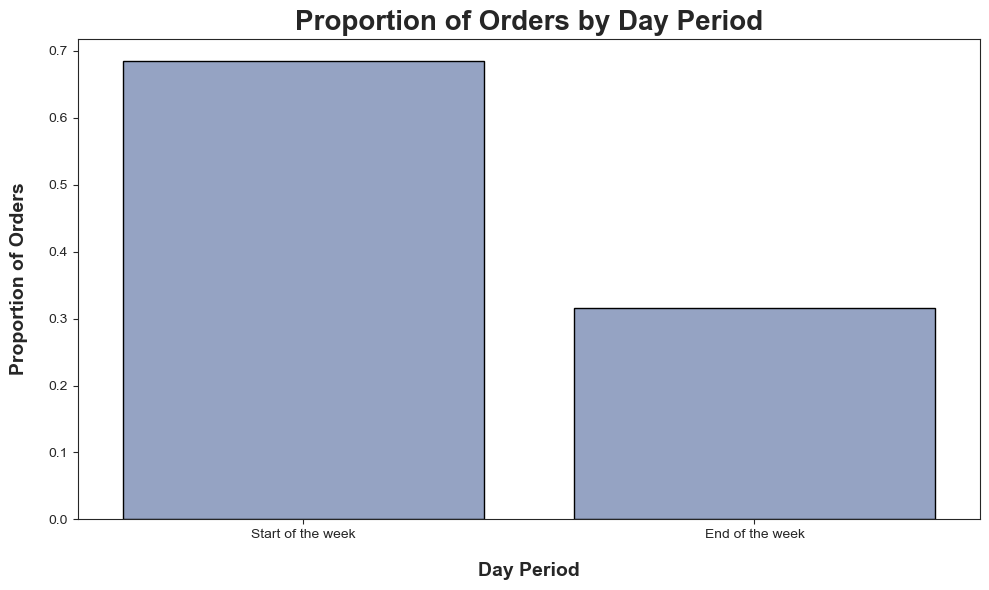

In [152]:
# Calculate total startweek orders
data['startweek_orders'] = data.apply(
    lambda row: row[[day for day, group in weekday_groups.items() if group == 'Group_0']].sum() 
    if row['total_orders'] > 0 else 0, axis=1
)

# Calculate total endweek orders
data['endweek_orders'] = data.apply(
    lambda row: row[[day for day, group in weekday_groups.items() if group == 'Group_1']].sum() 
    if row['total_orders'] > 0 else 0, axis=1
)

# Calculate total endweek orders
data['sunday_orders'] = data.apply(
    lambda row: row[[day for day, group in weekday_groups.items() if group == 'Group_2']].sum() 
    if row['total_orders'] > 0 else 0, axis=1
)

# Aggregate total orders for startweek and endweek
weekday_totals = {
    'Start of the week': data['startweek_orders'].sum(),
    'End of the week': data['endweek_orders'].sum()
}

# Calculate overall total orders
overall_total_orders = sum(weekday_totals.values())

# Calculate proportions for each period
proportions = {period: orders / overall_total_orders for period, orders in weekday_totals.items()}

# Create a DataFrame for visualization
weekday_totals_df = pd.DataFrame({
    'Day Period': proportions.keys(),
    'Proportion of Orders': proportions.values()
})

# Plot the data
sns.set_style("ticks")
color = sns.color_palette("Set2")[2]  # Use the third color from the Set2 palette
plt.figure(figsize=(10, 6))
sns.barplot(x='Day Period', y='Proportion of Orders', data=weekday_totals_df, color=color, edgecolor='black')

# Add titles and labels
plt.title('Proportion of Orders by Day Period', fontsize=20, fontweight='bold')
plt.xlabel('Day Period', fontsize=14, fontweight='bold', labelpad=15)
plt.ylabel('Proportion of Orders', fontsize=14, fontweight='bold', labelpad=15)

plt.tight_layout()
plt.show()

# Calculate startweek orders proportion
data['startweek_orders'] = data.apply(
    lambda row: row[[day for day, group in weekday_groups.items() if group == 'Group_0']].sum() / row['total_orders']
    if row['total_orders'] > 0 else 0, axis=1
)

# Calculate endweek orders proportion
data['endweek_orders'] = data.apply(    
    lambda row: row[[day for day, group in weekday_groups.items() if group == 'Group_1']].sum() / row['total_orders']
    if row['total_orders'] > 0 else 0, axis=1
)

# Calculate endweek orders proportion
data['sunday_orders'] = data.apply(
    lambda row: row[[day for day, group in weekday_groups.items() if group == 'Group_2']].sum() / row['total_orders']
    if row['total_orders'] > 0 else 0, axis=1
)


In [153]:
data.drop(['lunch_orders', 'snack_orders'], axis=1, inplace=True)
numerical_features = [col for col in data.columns if data[col].dtype not in ['object', 'category']]

In [154]:
data[numerical_features] = scaler.fit_transform(data[numerical_features])

# 4. Clustering

In [155]:
data_inversed = data.copy()
data_inversed[numerical_features] = scaler.inverse_transform(data_inversed[numerical_features])

## 4.1 Perspective 1: Diversity Order Profile

The objective of this perspective was to understand how our customer base is divided by age and engagement with the business, considering their spending habits and the weekly distribution of their purchases.

In [156]:
perspective1 = ['customer_age', 'total_orders', 'total_spend', 'diversity_cuisine_types', 'purchase_frequency', 'different_weekdays']

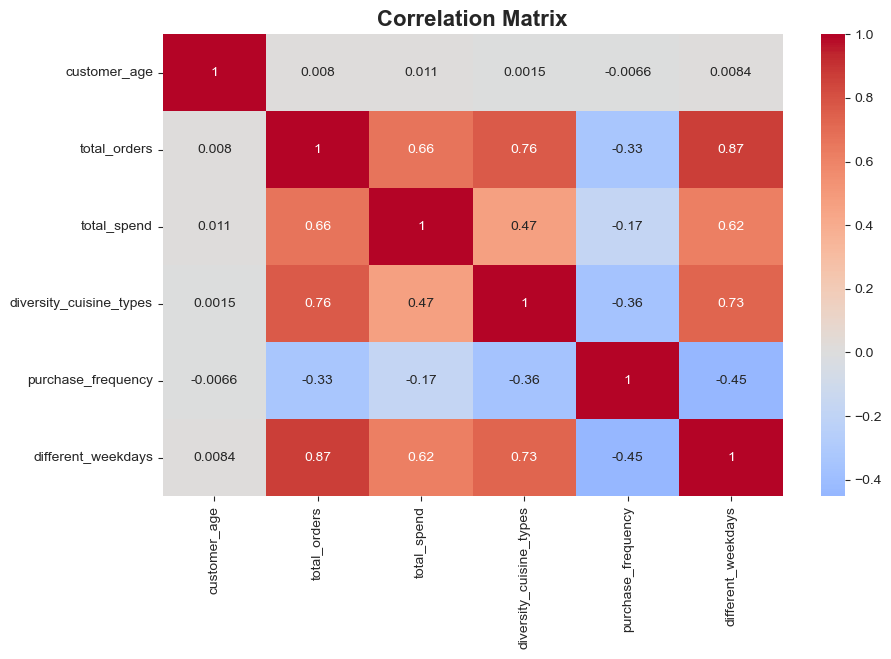

In [157]:
#heatmap perspective 3
plt.figure(figsize=(10, 6))
sns.heatmap(data[perspective1].corr(), annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Matrix', fontsize=16, fontweight='bold')
plt.show()

Since different_weekdays and total_orders are 87% related, we are going to drop total_orders 

In [158]:
perspective1.remove('total_orders')

In [159]:
data_inversed[perspective1].describe().T

,count,mean,std,min,25%,50%,75%,max
customer_age,30789.0,27.507551,7.108491,1.500000e+01,23.000000,26.000000,31.00,80.00
total_spend,30789.0,32.100776,27.944663,0.000000e+00,12.570000,23.600000,42.42,147.97
diversity_cuisine_types,30789.0,2.187470,1.376669,0.000000e+00,1.000000,2.000000,3.00,11.00
purchase_frequency,30789.0,0.477074,0.660767,5.551115e-17,0.090909,0.166667,1.00,14.00
different_weekdays,30789.0,2.598525,1.538708,0.000000e+00,1.000000,2.000000,3.00,7.00


### 4.1.1 Hierarchical Clustering

#### R Squared

In [160]:
# hc_methods = ["ward", "complete", "average", "single"]

hc_methods = ["ward"]
max_nclus = 10

r2_hc = np.vstack([get_r2_hc(data[perspective1], 
                              link, 
                              max_nclus=max_nclus, 
                              min_nclus=1, 
                              dist="euclidean") 
                              for link in hc_methods])

C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\156999461.py:7: UserWarning:

The markers list has more values (4) than needed (1), which may not be intended.



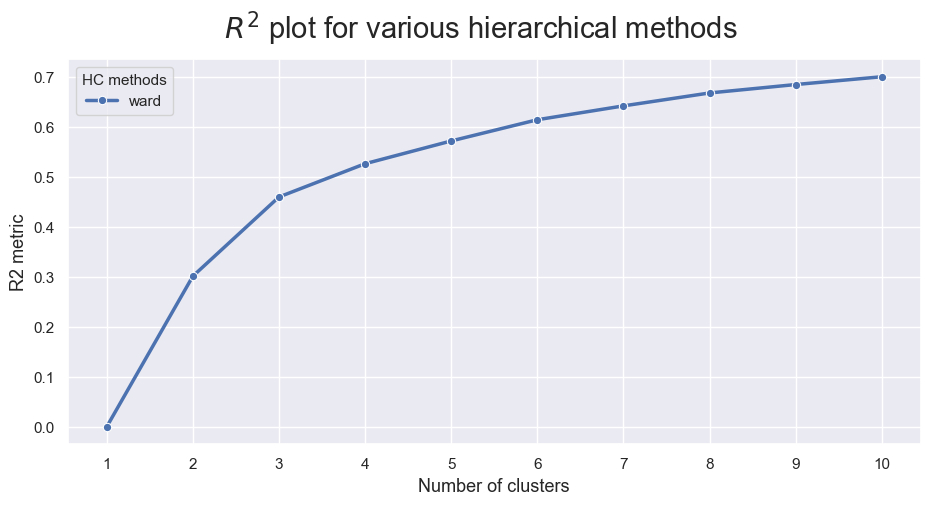

In [161]:
r2_hc_methods = pd.DataFrame(r2_hc.T, index=range(1, max_nclus + 1), columns=hc_methods)

sns.set()

# Plot data
fig = plt.figure(figsize=(11,5))
sns.lineplot(data=r2_hc_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
plt.legend(title="HC methods", title_fontsize=11)
plt.xticks(range(1, max_nclus + 1))
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)

fig.suptitle("$R^2$ plot for various hierarchical methods", fontsize=21)

plt.show()

This part envaluates the possibilities of hierarchical clustering solutions using different numbers of clusters (1 to 10) for the ward linkage method. The R² metric is calculated, which represents how much of the variance in the data is explained by the clustering. <br><br>

The plot provides a good insight of decision-making tool, with the "elbow" pointing to an optimal range of 3 to 5 clusters for further analysis.

#### Dendogram

In [162]:
# setting distance_threshold=0 and n_clusters=None ensures we compute the full tree
linkage = 'ward'
distance = 'euclidean'


hclust = AgglomerativeClustering(linkage=linkage, 
                                 metric=distance,
                                 distance_threshold=0,
                                 n_clusters=None)

hclust.fit_predict(data[perspective1])

array([19663, 24522, 28207, ...,     2,     1,     0], dtype=int64)

In [163]:
# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

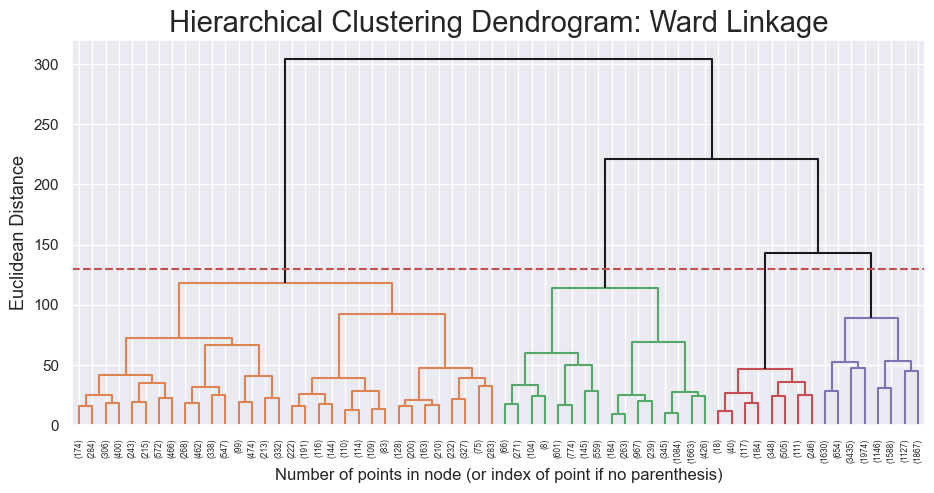

In [164]:
# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 130
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering Dendrogram: {linkage.title()} Linkage', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
plt.show()

#### Defining the number of Clusters

Number of clusters: 3
Average Silhouette Score: 0.2827655349229048

Cluster 0: Average Silhouette Score = 0.3159843526070213
Cluster 1: Average Silhouette Score = 0.13839365592334543
Cluster 2: Average Silhouette Score = 0.36997973713248056


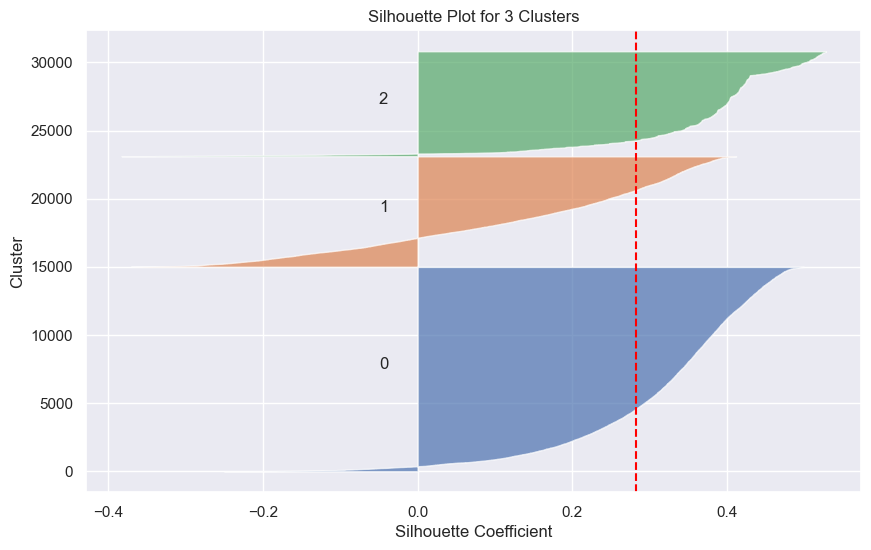

Calinski-Harabasz Index: 13095.051304137027
Davies-Bouldin Index: 1.2768735739321135

Number of clusters: 4
Average Silhouette Score: 0.28528446630607057

Cluster 0: Average Silhouette Score = 0.09675636736677035
Cluster 1: Average Silhouette Score = 0.37479029618541254
Cluster 2: Average Silhouette Score = 0.3285557209852647
Cluster 3: Average Silhouette Score = 0.2806155490483063


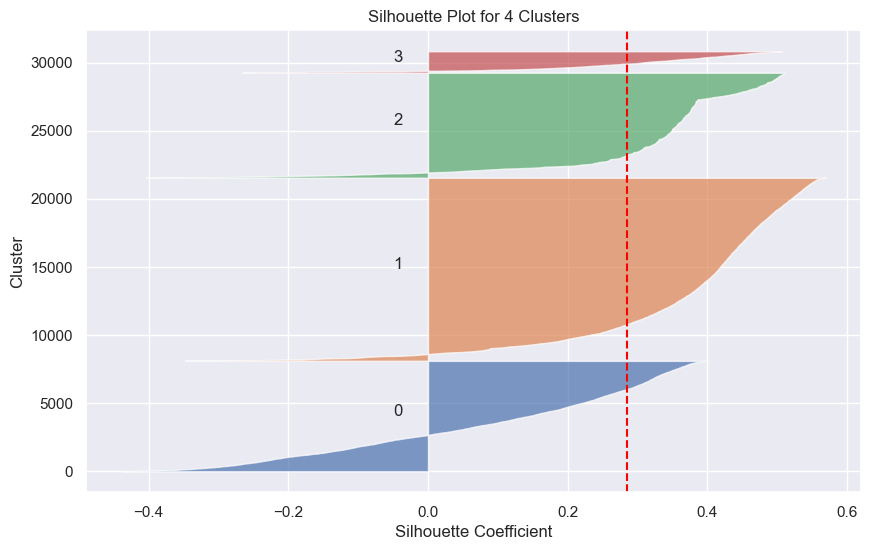

Calinski-Harabasz Index: 11395.925062768794
Davies-Bouldin Index: 1.1362066619492424

Number of clusters: 5
Average Silhouette Score: 0.26226745536350216

Cluster 0: Average Silhouette Score = 0.32854343055767204
Cluster 1: Average Silhouette Score = 0.31894733094540556
Cluster 2: Average Silhouette Score = 0.0894420164098391
Cluster 3: Average Silhouette Score = 0.2771007114478962
Cluster 4: Average Silhouette Score = 0.10903284406116796


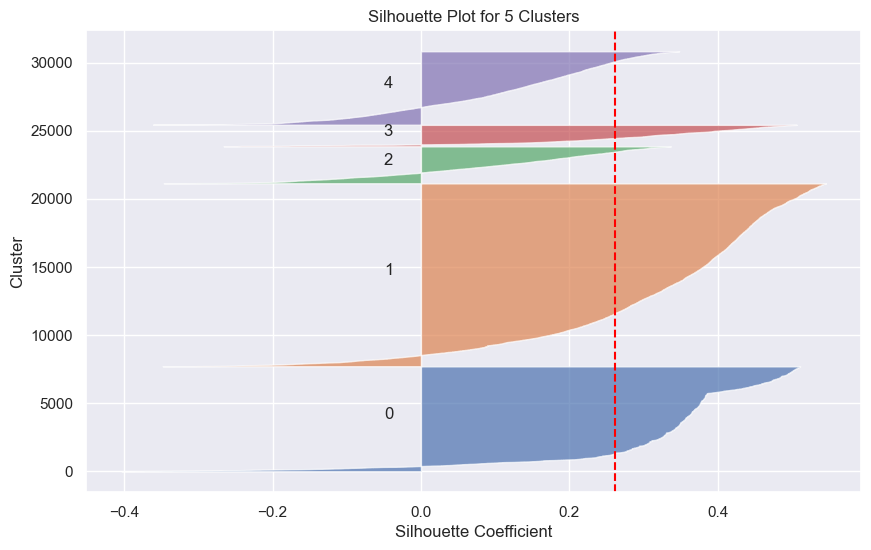

Calinski-Harabasz Index: 10273.804498445721
Davies-Bouldin Index: 1.410426036008713

Number of clusters: 6
Average Silhouette Score: 0.24539598201097454

Cluster 0: Average Silhouette Score = 0.0894420164098391
Cluster 1: Average Silhouette Score = 0.23258386710986192
Cluster 2: Average Silhouette Score = 0.466735043180822
Cluster 3: Average Silhouette Score = 0.2715292791673481
Cluster 4: Average Silhouette Score = 0.1089850092950758
Cluster 5: Average Silhouette Score = 0.302451253482223


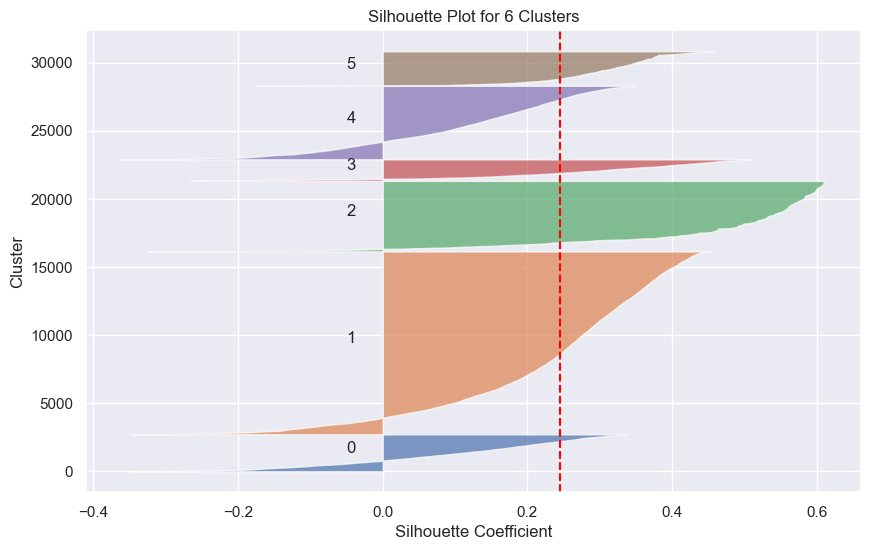

Calinski-Harabasz Index: 9799.491264881513
Davies-Bouldin Index: 1.352639929849113



In [165]:
# Define the range of clusters to test
cluster_range = [3, 4, 5, 6]

# Create a dictionary to store results for each number of clusters
cluster_results = {}

# Run Agglomerative Clustering for each value in the cluster range
for n_clusters in cluster_range:
    hc_model = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    labels = hc_model.fit_predict(data[perspective1])
    silhouette_analysis(data[perspective1], labels, n_clusters)
    evaluate_clustering_metrics(data[perspective1], labels)
    cluster_results[n_clusters] = labels  # Store labels for each n_clusters

# Convert results to a DataFrame for easier visualization
results_df = pd.DataFrame(cluster_results, index=data.index)
results_df.columns = [f'Cluster_{n}' for n in cluster_range]

In [166]:
results_df

,Cluster_3,Cluster_4,Cluster_5,Cluster_6
0,2,2,0,5
1,2,2,0,2
2,2,2,0,2
3,2,2,0,2
4,2,2,0,5
...,...,...,...,...
31883,2,2,0,2
31884,2,2,0,2
31885,2,2,0,2
31886,2,2,0,2


#### Comparison between 4 and 5

In [167]:
pd.crosstab(
    pd.Series(results_df['Cluster_5'], name='Cluster_5', index=data.index),
    pd.Series(results_df['Cluster_4'], name='Cluster_4', index=data.index),)

Cluster_4,0,1,2,3
Cluster_5,,,,
0,0,0,7699,0
1,0,13421,0,0
2,2707,0,0,0
3,0,0,0,1569
4,5393,0,0,0


#### Final Solution **(k=5)**

In [168]:
data_concat = pd.concat([
    data_inversed[perspective1], 
    pd.Series(results_df['Cluster_5'], name='labels', index=data_inversed.index)
    ], 
    axis=1)
data_concat.groupby('labels').mean()

,customer_age,total_spend,diversity_cuisine_types,purchase_frequency,different_weekdays
labels,,,,,
0,26.989869,15.357774,1.077413,1.412301,1.098195
1,26.350048,23.570130,1.867596,0.143087,2.335444
2,26.975988,87.919058,4.817880,0.225676,5.345401
3,45.346080,28.640484,2.265774,0.238976,2.492670
4,26.204154,50.221168,3.225107,0.168569,4.047098


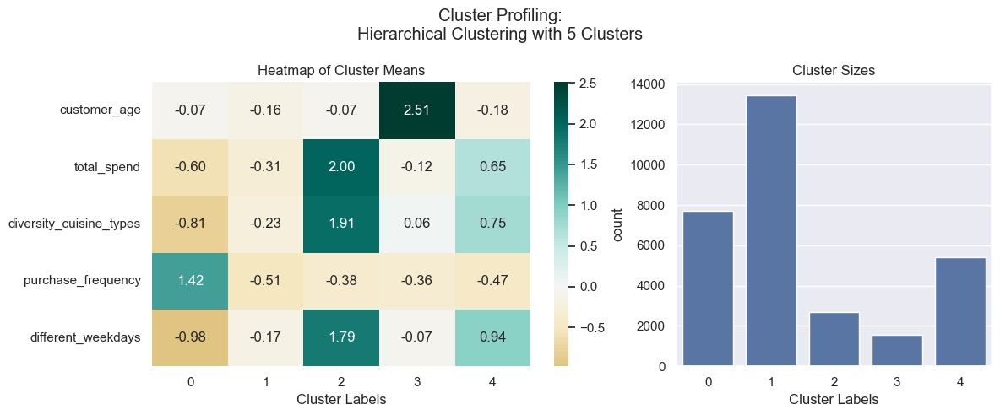

In [169]:
label_counts = None 

fig, axes = plt.subplots(1,2, figsize=(12,5), width_ratios=[.6,.4], tight_layout=True)

data_concat = pd.concat([
    data[perspective1], 
    pd.Series(results_df['Cluster_5'], name='labels', index=data.index)
    ], 
    axis=1)

hc_profile = data_concat.groupby('labels').mean().T

sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0]
            )
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")


sns.countplot(data_concat, x='labels', ax=axes[1])
axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

fig.suptitle("Cluster Profiling:\nHierarchical Clustering with 5 Clusters")
plt.show()

Cluster sizes are not very balanced, cluster 3 being the smallest with less than 2000 clients. Cluster 2 is by far the one with highest spending customers.

In [170]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(data_concat[perspective1])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = data_concat[perspective1 + ["labels"]].groupby(by='labels').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(data_concat)  # Total number of data points
k = data_concat['labels'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.5717
Adjusted R²: 0.5717


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\2988445197.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



### 4.1.2 KMeans

#### Inertia

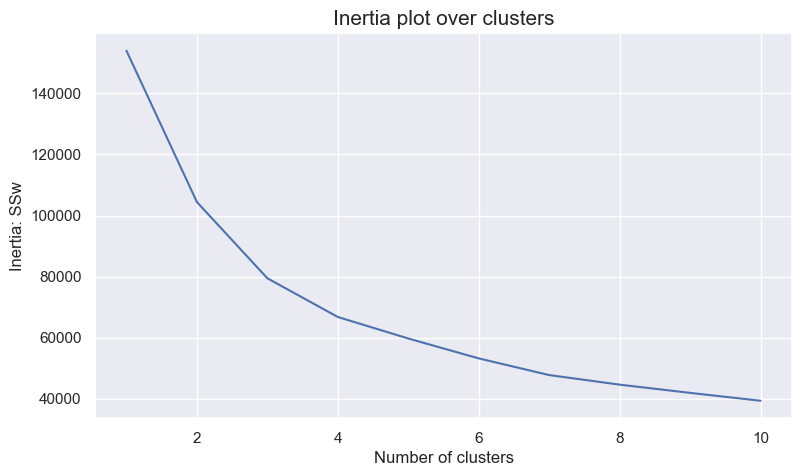

In [171]:
range_clusters = range(1, 11)

inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit(data[perspective1])
    inertia.append(kmclust.inertia_)

# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(range_clusters, inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

The elbow range is between 3 and 5

#### Defining the number of Clusters

In [172]:
# Storing average silhouette metric
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(data[perspective1])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(data[perspective1], cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(data[perspective1], cluster_labels)

For n_clusters = 2, the average silhouette_score is : 0.33315255270706623
For n_clusters = 3, the average silhouette_score is : 0.31662026788145703
For n_clusters = 4, the average silhouette_score is : 0.31794371547518413
For n_clusters = 5, the average silhouette_score is : 0.3166475897205065
For n_clusters = 6, the average silhouette_score is : 0.29387213179705973
For n_clusters = 7, the average silhouette_score is : 0.27917321209524226
For n_clusters = 8, the average silhouette_score is : 0.26184734049303066
For n_clusters = 9, the average silhouette_score is : 0.26097801953660726
For n_clusters = 10, the average silhouette_score is : 0.26715636076715665


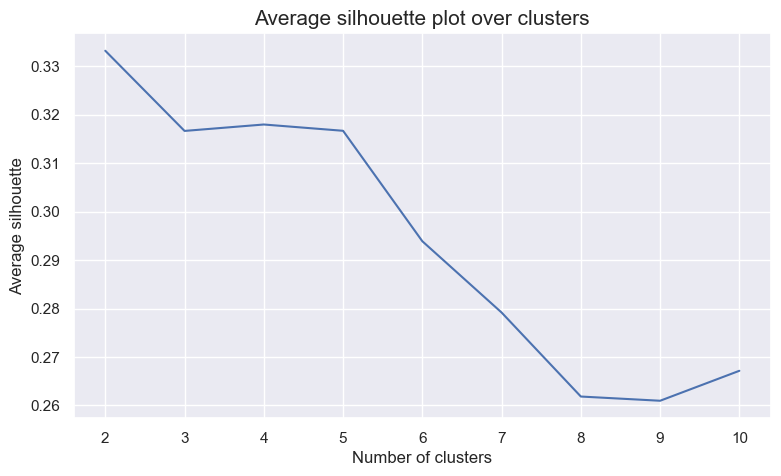

In [173]:
# The average silhouette plot
# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(range_clusters[1:], 
         avg_silhouette)    

plt.ylabel("Average silhouette")
plt.xlabel("Number of clusters")
plt.title("Average silhouette plot over clusters", size=15)
plt.show()

In [174]:
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(data[perspective1])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    print(f"For n_clusters = {nclus}, the metrics are :")
    metrics_avg = evaluate_clustering_metrics(data[perspective1], cluster_labels)

For n_clusters = 2, the metrics are :
Calinski-Harabasz Index: 14597.74802830559
Davies-Bouldin Index: 1.2557862078695017

For n_clusters = 3, the metrics are :
Calinski-Harabasz Index: 14422.989719834502
Davies-Bouldin Index: 1.1801513913132082

For n_clusters = 4, the metrics are :
Calinski-Harabasz Index: 13384.980239787046
Davies-Bouldin Index: 1.1046215746679673

For n_clusters = 5, the metrics are :
Calinski-Harabasz Index: 12126.149554396226
Davies-Bouldin Index: 1.2453936047270395

For n_clusters = 6, the metrics are :
Calinski-Harabasz Index: 11640.273010264493
Davies-Bouldin Index: 1.1865412530117305

For n_clusters = 7, the metrics are :
Calinski-Harabasz Index: 11393.550477960474
Davies-Bouldin Index: 1.1607431691989327

For n_clusters = 8, the metrics are :
Calinski-Harabasz Index: 10759.619928504642
Davies-Bouldin Index: 1.2018153200128512

For n_clusters = 9, the metrics are :
Calinski-Harabasz Index: 10265.21920714957
Davies-Bouldin Index: 1.2339157731788326

For n_clus

##### Cluster = 4

In [175]:
kmclust_4 = KMeans(n_clusters=4, init='k-means++', n_init=15, random_state=1)
kmclust_4.fit(data[perspective1])
labels_4 = kmclust_4.predict(data[perspective1])

Number of clusters: 4
Average Silhouette Score: 0.31794371547518413

Cluster 0: Average Silhouette Score = 0.17888565089985578
Cluster 1: Average Silhouette Score = 0.37767443239786236
Cluster 2: Average Silhouette Score = 0.1862239681157175
Cluster 3: Average Silhouette Score = 0.3891959363526439


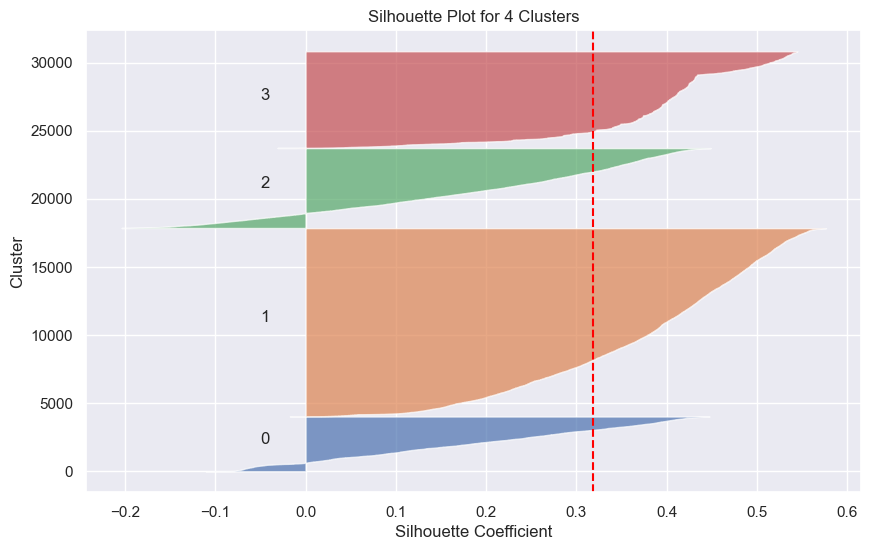

In [176]:
silhouette_analysis(data[perspective1], labels_4, 4)

In [177]:
evaluate_clustering_metrics(data[perspective1], labels_4)

Calinski-Harabasz Index: 13384.980239787046
Davies-Bouldin Index: 1.1046215746679673



##### Cluster = 5

In [178]:
kmclust_5 = KMeans(n_clusters=5, init='k-means++', n_init=15, random_state=1)
kmclust_5.fit(data[perspective1])
labels_5 = kmclust_5.predict(data[perspective1])

Number of clusters: 5
Average Silhouette Score: 0.3166475897205065

Cluster 0: Average Silhouette Score = 0.1986682174826093
Cluster 1: Average Silhouette Score = 0.38418169415086156
Cluster 2: Average Silhouette Score = 0.38096202910039567
Cluster 3: Average Silhouette Score = 0.19042881076622617
Cluster 4: Average Silhouette Score = 0.1791780505235022


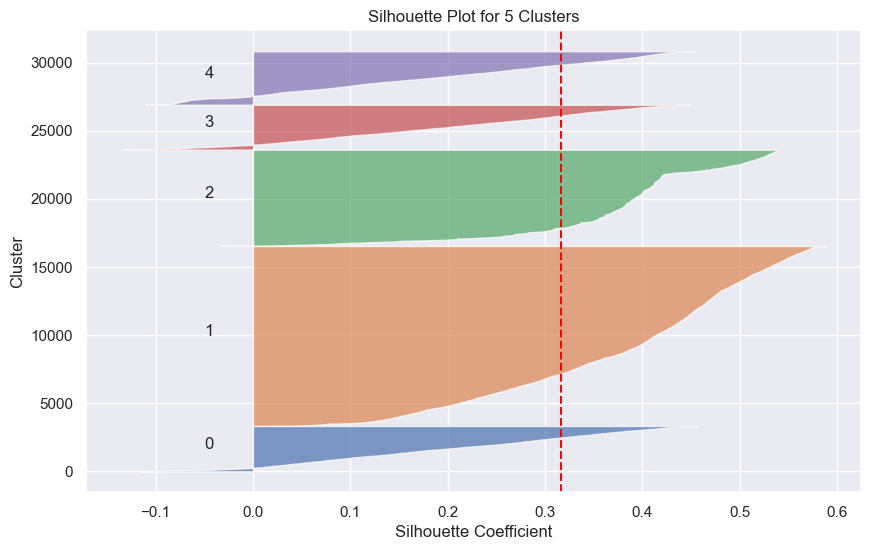

In [179]:
silhouette_analysis(data[perspective1], labels_5, 5)

In [180]:
evaluate_clustering_metrics(data[perspective1], labels_5)

Calinski-Harabasz Index: 12126.149554396226
Davies-Bouldin Index: 1.2453936047270395



##### Comparison between 4 and 5

In [181]:
pd.crosstab(
    pd.Series(labels_5, name='labels_5', index=data.index),
    pd.Series(labels_4, name='labels_4', index=data.index),)

labels_4,0,1,2,3
labels_5,,,,
0,64,347,2910,0
1,1,13149,46,3
2,0,0,0,7062
3,63,317,2905,2
4,3889,0,1,30


#### Final Solution **(k=4)**

In [182]:
data_concat = pd.concat([
    data_inversed[perspective1], 
    pd.Series(labels_4, name='labels', index=data_inversed.index)
    ], 
    axis=1)
data_concat.groupby('labels').mean()

,customer_age,total_spend,diversity_cuisine_types,purchase_frequency,different_weekdays
labels,,,,,
0,40.119492,25.980826,1.975106,0.285162,2.395818
1,24.794035,25.493893,2.028524,0.148038,2.460074
2,26.871375,71.959901,4.065677,0.201461,4.921187
3,26.175849,15.500876,1.065662,1.453759,1.064253


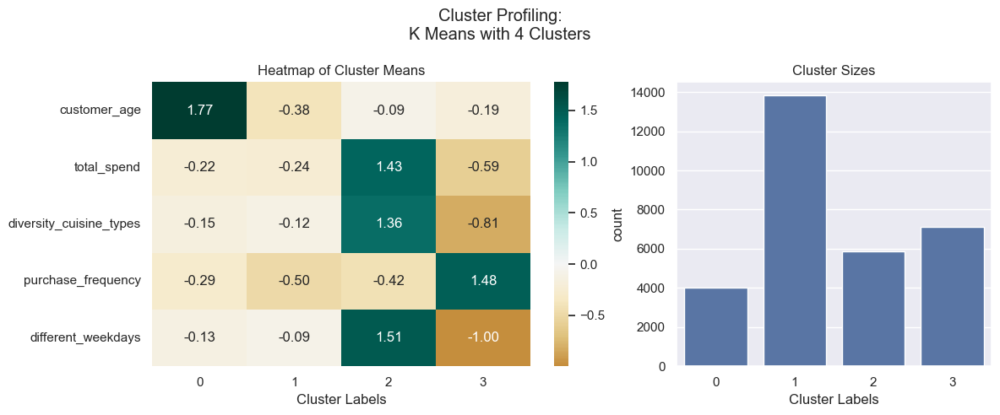

In [183]:
label_counts = None 

fig, axes = plt.subplots(1,2, figsize=(12,5), width_ratios=[.6,.4], tight_layout=True)

data_concat = pd.concat([
    data[perspective1], 
    pd.Series(labels_4, name='labels', index=data.index)
    ], 
    axis=1)

hc_profile = data_concat.groupby('labels').mean().T

sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0]
            )
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")


sns.countplot(data_concat, x='labels', ax=axes[1])
axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

fig.suptitle("Cluster Profiling:\nK Means with 4 Clusters")
plt.show()

Cluster sizes more balanced and cluster 2 is the highest spending customers.


In [184]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(data_concat[perspective1])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = data_concat[perspective1 + ["labels"]].groupby(by='labels').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(data_concat)  # Total number of data points
k = data_concat['labels'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.5660
Adjusted R²: 0.5660


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\2988445197.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



### 4.1.3 SOM

#### Training

In [185]:
neighborhood_function = 'gaussian' # Defines how neighboring neurons affect each other during training. A 'gaussian' function is used here, meaning the influence decreases with distance.
topology = 'rectangular' 
n_feats = len(perspective1)
learning_rate = 0.5

som_data = data[perspective1].values
# M, N = calculate_grid_size(len(som_data), aspect_ratio=1)  # Square grid
M = 50
N = 50
print(f"Grid size: M={M}, N={N}")

sm = MiniSom(M, N,              # 10x10 map size
             n_feats,           # Number of the elements of the vectors in input.
             learning_rate=learning_rate, 
             topology=topology, 
             neighborhood_function=neighborhood_function, 
             activation_distance='euclidean',
             random_seed=42
             )

# Initializes the weights of the SOM picking random samples from data.
sm.random_weights_init(som_data) 


print("Before training:")
print("QE", np.round(sm.quantization_error(som_data),4)) # Quantization Error (QE): Measures how well the SOM represents the input data. It calculates the average distance between input vectors and their best-matching units (BMUs).
print("TE", np.round(sm.topographic_error(som_data),4)) # Topographic Error (TE): Measures how well the SOM preserves the topological relationships in the input data.

# Trains the SOM using all the vectors in data sequentially
# minisom does not distinguish between unfolding and fine tuning phase;

sm.train_batch(som_data, 400000)

print("After training:")
print("QE", np.round(sm.quantization_error(som_data),4))
print("TE", np.round(sm.topographic_error(som_data),4))

Grid size: M=50, N=50
Before training:


c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\minisom.py:513: RuntimeWarning:

invalid value encountered in sqrt



QE 0.2125
TE 0.9978
After training:
QE 0.163
TE 0.2755


In [186]:
bmus = np.array([sm.winner(x) for x in som_data])  # (row, col) for each data point
weights = sm.get_weights().reshape((M*N),len(perspective1))
weights.shape

(2500, 5)

We started with a QE of 0.21, reflecting the mismatch between input data and untrained weights, and a very high value of TE (0.9978), indicating poor topology preservation. This is expected with untrained weights.

After training, there is a **noticeable reduction in QE**, with the final QE value being 0.163. This indicates that the SOM has effectively learned to represent the input data, resulting in improved clustering accuracy. The final QE value, being less than 0.2, suggests good clustering performance as the neurons have adjusted closer to the input data points.

Similarly, there is a **significant improvement in TE**, with the final value dropping to 0.28, which is below the threshold of 0.3 typically considered good for topology preservation. This improvement demonstrates that the trained SOM has successfully captured the input data's topological relationships.

The grid size was set at M=50 and N=50, which is larger than the size recommended by the rule of thumb (5* sqrt(N) where N is the number of input data points). While the rule of thumb provides a general guideline, this larger grid size yielded significantly better results in terms of quality and topology preservation, likely due to the added flexibility in representing the data's structure.

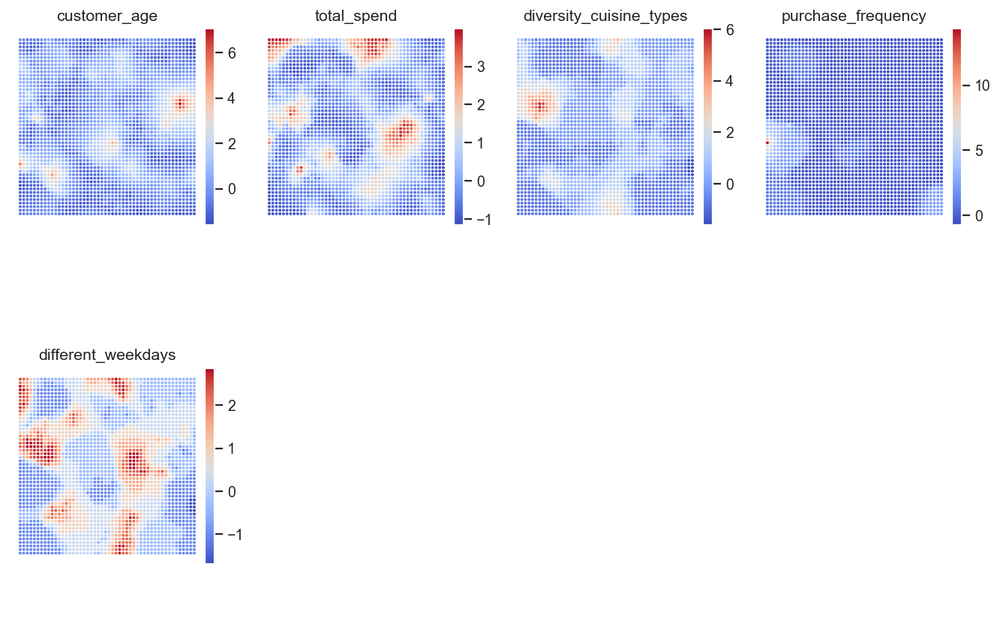

In [187]:
weights = sm.get_weights()

figsize=(10,7)
fig = plt.figure(figsize=figsize, constrained_layout=True, dpi=128, )

subfigs = fig.subfigures(2,4,wspace=.15)

colornorm = mpl_colors.Normalize(vmin=np.min(weights), vmax=np.max(weights))

for cpi, sf in zip(range(len(perspective1)), subfigs.flatten()):
    
    matrix_vals = weights[:,:,cpi]
    vext = np.max(np.abs([np.min(matrix_vals), np.max(matrix_vals)]))
    colornorm = mpl_colors.Normalize(vmin=np.min(matrix_vals), vmax=np.max(matrix_vals))
    # colornorm = mpl_colors.CenteredNorm(vcenter=0, halfrange=vext)


    sf = plot_hexagons(sm, sf, 
                    colornorm,
                    matrix_vals,
                    label=perspective1[cpi],
                    cmap=cm.coolwarm,
                    )

In [188]:
high_frequency = data_inversed[data_inversed['purchase_frequency'] > 6][['customer_id','product_count', 'first_order', 'last_order', 'purchase_frequency']]
print(high_frequency)

      customer_id  product_count  first_order    last_order  \
12221  d3a4f15281            9.0         15.0  1.500000e+01   
19616  3de72b5134            8.0         32.0  3.200000e+01   
24238  2b6806946f            9.0         47.0  4.700000e+01   
24929  e33a106ec6           14.0         49.0  4.900000e+01   
27915  e975dbf7fa            7.0         63.0  6.300000e+01   
31855  c3690a6fa1            7.0          0.0  7.105427e-15   

       purchase_frequency  
12221                 9.0  
19616                 8.0  
24238                 9.0  
24929                14.0  
27915                 7.0  
31855                 7.0  


In [189]:
data[data['customer_id'] == 'c3690a6fa1']['purchase_frequency']

31855    9.871915
Name: purchase_frequency, dtype: float64

In [190]:
high_frequency = data[data['purchase_frequency'] > 9][['customer_id','product_count', 'first_order', 'last_order', 'purchase_frequency']]
print(high_frequency)

      customer_id  product_count  first_order  last_order  purchase_frequency
12221  d3a4f15281       0.925086    -0.583631   -2.060662           12.898751
19616  3de72b5134       0.702226     0.120477   -1.330520           11.385333
24238  2b6806946f       0.925086     0.741749   -0.686276           12.898751
24929  e33a106ec6       2.039389     0.824585   -0.600377           20.465843
27915  e975dbf7fa       0.479365     1.404439    0.000916            9.871915
31855  c3690a6fa1       0.479365    -1.204903   -2.704905            9.871915


**Customer Age:** The heatmap shows no strong concentration in specific regions, suggesting a balanced distribution of ages among clusters.

**Total Spend:** Red areas indicate higher spending concentrated in specific clusters, implying customer groups with significant purchase behavior.

**Diversity Cuisine Types:** Red areas are sparse, highlighting few clusters with a diverse range of cuisines, while most customers stick to fewer types.

**Purchase Frequency:** The red dot corresponds to a single client with a purchase frequency of 14, clearly identifying an outlier. This  does have a noticeable impact on the purchase frequency map, where the outlier skews the color scale and reduces the interpretability of other clusters. 

**Different Weekdays:** Sparse red areas suggest a few clusters with customers ordering on multiple different weekdays, while most customers exhibit limited weekday variety.

#### U-Matrix

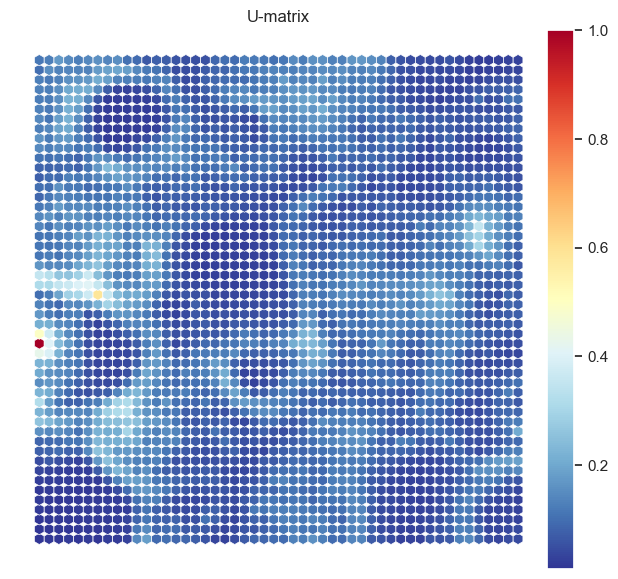

In [191]:
umatrix = sm.distance_map(scaling='mean')
fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=np.min(umatrix), vmax=np.max(umatrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    umatrix,
                    label="U-matrix",
                    cmap=cm.RdYlBu_r
                    )

The outlier seen in the heatmap of purchase frequency affects the overall clustering result as seen above. For this reason, we decided to remove it.

In [192]:
data_2 = data.copy()
data_2 = data[data['purchase_frequency'] <= 9]

In [193]:
data_inversed_2 = data_inversed.copy()
data_inversed_2 = data_inversed_2[data_inversed_2['purchase_frequency'] <= 6]

In [194]:
neighborhood_function = 'gaussian' # Defines how neighboring neurons affect each other during training. A 'gaussian' function is used here, meaning the influence decreases with distance.
topology = 'rectangular' 
n_feats = len(perspective1)
learning_rate = 0.5

som_data = data_2[perspective1].values
# M, N = calculate_grid_size(len(som_data), aspect_ratio=1)  # Square grid
M = 50
N = 50
print(f"Grid size: M={M}, N={N}")

sm = MiniSom(M, N,              # 10x10 map size
             n_feats,           # Number of the elements of the vectors in input.
             learning_rate=learning_rate, 
             topology=topology, 
             neighborhood_function=neighborhood_function, 
             activation_distance='euclidean',
             random_seed=42
             )

# Initializes the weights of the SOM picking random samples from data.
sm.random_weights_init(som_data) 


print("Before training:")
print("QE", np.round(sm.quantization_error(som_data),4)) # Quantization Error (QE): Measures how well the SOM represents the input data. It calculates the average distance between input vectors and their best-matching units (BMUs).
print("TE", np.round(sm.topographic_error(som_data),4)) # Topographic Error (TE): Measures how well the SOM preserves the topological relationships in the input data.

# Trains the SOM using all the vectors in data sequentially
# minisom does not distinguish between unfolding and fine tuning phase;

sm.train_batch(som_data, 200000)

print("After training:")
print("QE", np.round(sm.quantization_error(som_data),4))
print("TE", np.round(sm.topographic_error(som_data),4))

Grid size: M=50, N=50
Before training:


c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\minisom.py:513: RuntimeWarning:

invalid value encountered in sqrt



QE 0.2114
TE 0.9963
After training:
QE 0.1643
TE 0.2851


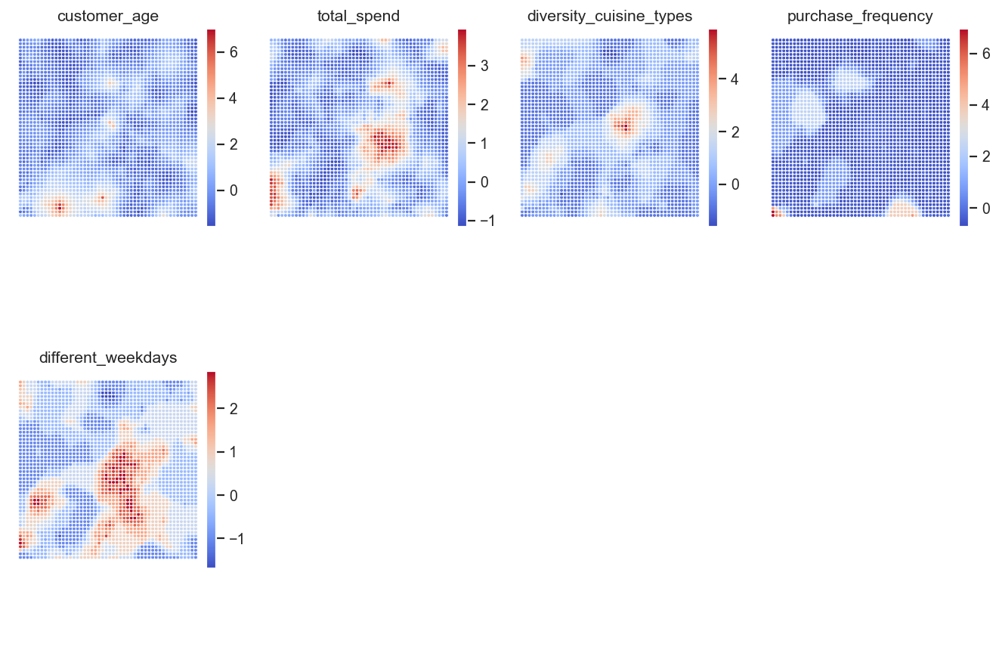

In [195]:
weights = sm.get_weights()
figsize=(10,7)
fig = plt.figure(figsize=figsize, constrained_layout=True, dpi=128, )

subfigs = fig.subfigures(2,4,wspace=.15)

colornorm = mpl_colors.Normalize(vmin=np.min(weights), vmax=np.max(weights))

for cpi, sf in zip(range(len(perspective1)), subfigs.flatten()):
    
    matrix_vals = weights[:,:,cpi]
    vext = np.max(np.abs([np.min(matrix_vals), np.max(matrix_vals)]))
    colornorm = mpl_colors.Normalize(vmin=np.min(matrix_vals), vmax=np.max(matrix_vals))
    # colornorm = mpl_colors.CenteredNorm(vcenter=0, halfrange=vext)


    sf = plot_hexagons(sm, sf, 
                    colornorm,
                    matrix_vals,
                    label=perspective1[cpi],
                    cmap=cm.coolwarm,
                    )

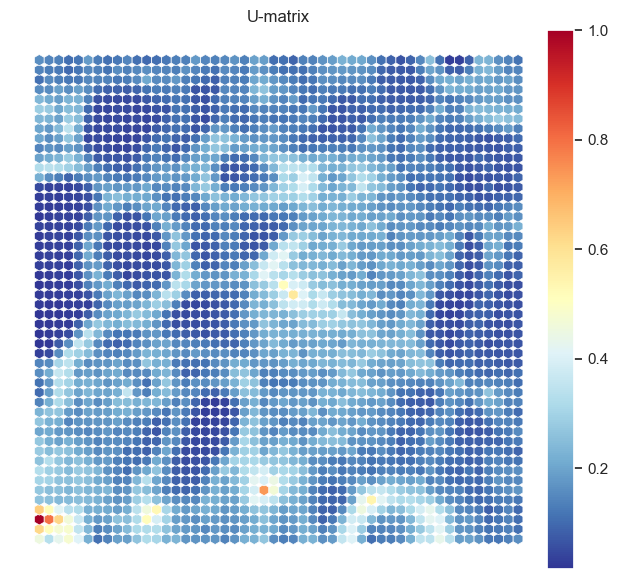

In [196]:
umatrix = sm.distance_map(scaling='mean')
fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=np.min(umatrix), vmax=np.max(umatrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    umatrix,
                    label="U-matrix",
                    cmap=cm.RdYlBu_r
                    )

#### Hit Map

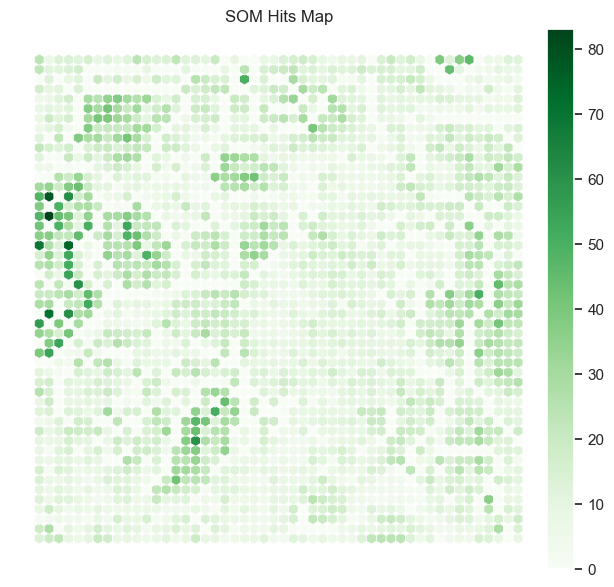

In [197]:
hitsmatrix = sm.activation_response(data_2[perspective1].values)

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hitsmatrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    hitsmatrix,
                    label="SOM Hits Map",
                    cmap=cm.Greens
                    )

#### 4.3.3.1 SOM - Hierarchical

In [198]:
bmus = np.array([sm.winner(x) for x in som_data])  # (row, col) for each data point
weights = sm.get_weights().reshape((M*N),len(perspective1))
weights.shape

(2500, 5)

In [199]:
# setting distance_threshold=0 and n_clusters=None ensures we compute the full tree
linkage = 'ward'
distance = 'euclidean'


hclust = AgglomerativeClustering(linkage=linkage, 
                                 metric=distance,
                                 distance_threshold=0,
                                 n_clusters=None)

hclust.fit_predict(weights)

array([2007, 1631, 2367, ...,    1,    2,    0], dtype=int64)

Number of clusters: 4
Average Silhouette Score: 0.29330847354078105

Cluster 0: Average Silhouette Score = 0.29877136956060885
Cluster 1: Average Silhouette Score = 0.20874598294540841
Cluster 2: Average Silhouette Score = 0.38827672216937587
Cluster 3: Average Silhouette Score = 0.17505544786436275


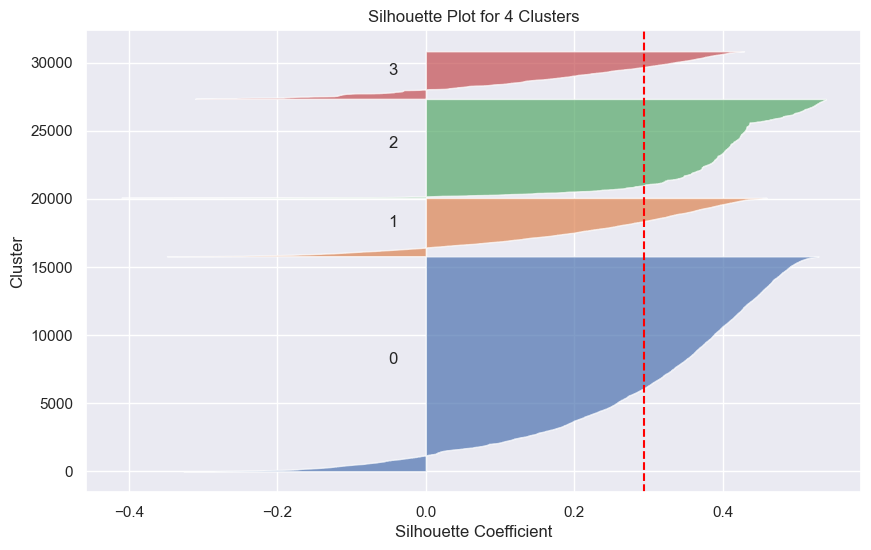

Calinski-Harabasz Index: 11723.088020579324
Davies-Bouldin Index: 1.195036851953938

Number of clusters: 5
Average Silhouette Score: 0.21679545205230003

Cluster 0: Average Silhouette Score = 0.06811863162379876
Cluster 1: Average Silhouette Score = 0.12701841063733268
Cluster 2: Average Silhouette Score = 0.3053285754177698
Cluster 3: Average Silhouette Score = 0.11983385757734283
Cluster 4: Average Silhouette Score = 0.3066106520710423


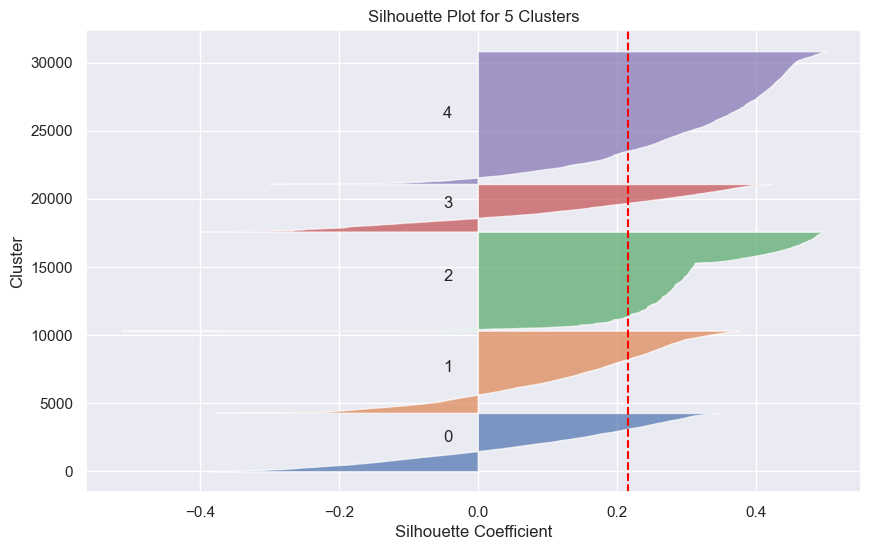

Calinski-Harabasz Index: 10606.528404030929
Davies-Bouldin Index: 1.3799563050995147

Number of clusters: 6
Average Silhouette Score: 0.22325020103492527

Cluster 0: Average Silhouette Score = 0.10714716546734156
Cluster 1: Average Silhouette Score = 0.11620022447020563
Cluster 2: Average Silhouette Score = 0.3052540996730274
Cluster 3: Average Silhouette Score = 0.09496857119385682
Cluster 4: Average Silhouette Score = 0.3066106520710423
Cluster 5: Average Silhouette Score = 0.23874097639115618


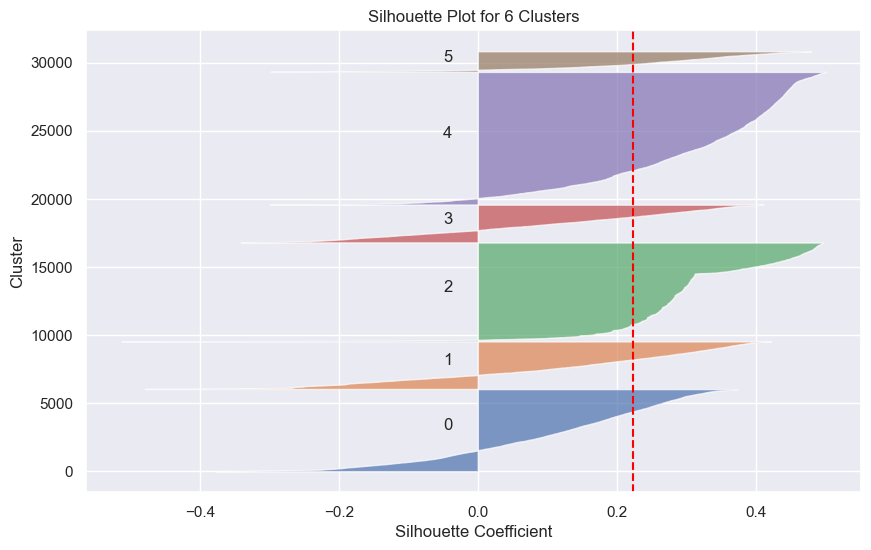

Calinski-Harabasz Index: 9777.272413783694
Davies-Bouldin Index: 1.3694211591524812

Number of clusters: 7
Average Silhouette Score: 0.21295797251389106

Cluster 0: Average Silhouette Score = 0.08499187578207362
Cluster 1: Average Silhouette Score = 0.035736329226350096
Cluster 2: Average Silhouette Score = 0.30504446741231606
Cluster 3: Average Silhouette Score = 0.09361895066844993
Cluster 4: Average Silhouette Score = 0.26533733262848797
Cluster 5: Average Silhouette Score = 0.1714451541561461
Cluster 6: Average Silhouette Score = 0.2797150477889403


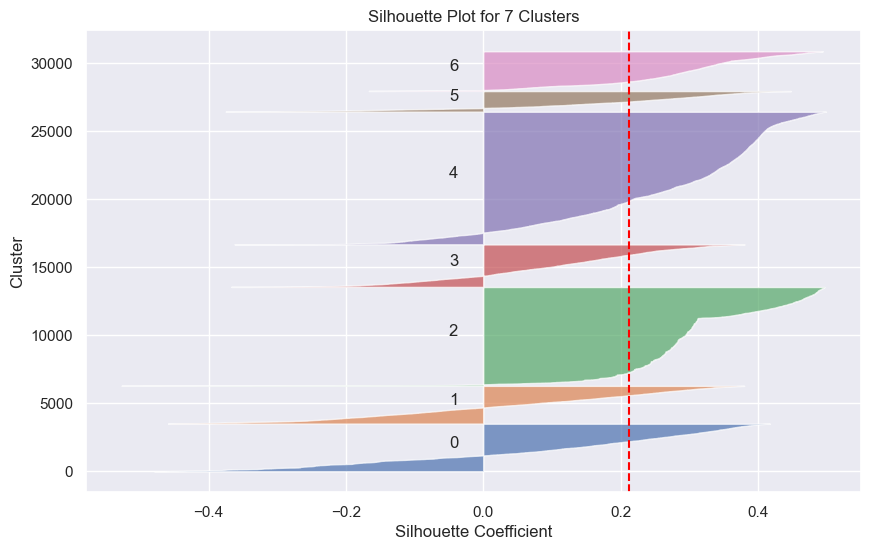

Calinski-Harabasz Index: 8792.935773433443
Davies-Bouldin Index: 1.3536881466621413



In [200]:
# Define the range of clusters to test
cluster_range = [4, 5, 6, 7]


# Run Agglomerative Clustering for each value in the cluster range
for n_clusters in cluster_range:
    hc_model = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    nodeclus_labels = hc_model.fit_predict(weights)
    hclust_matrix = nodeclus_labels.reshape((M,N))

    bmu_index = np.array([sm.winner(x) for x in data[perspective1].values])
    som_final_labels = [hclust_matrix[i[0]][i[1]] for i in bmu_index]

    df_final = pd.concat([data,
                    pd.Series(som_final_labels, name='label', index=data.index)], axis=1)
    
    silhouette_analysis(df_final[perspective1], np.array(som_final_labels), n_clusters)
    evaluate_clustering_metrics(df_final[perspective1], np.array(som_final_labels))

In [201]:
# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

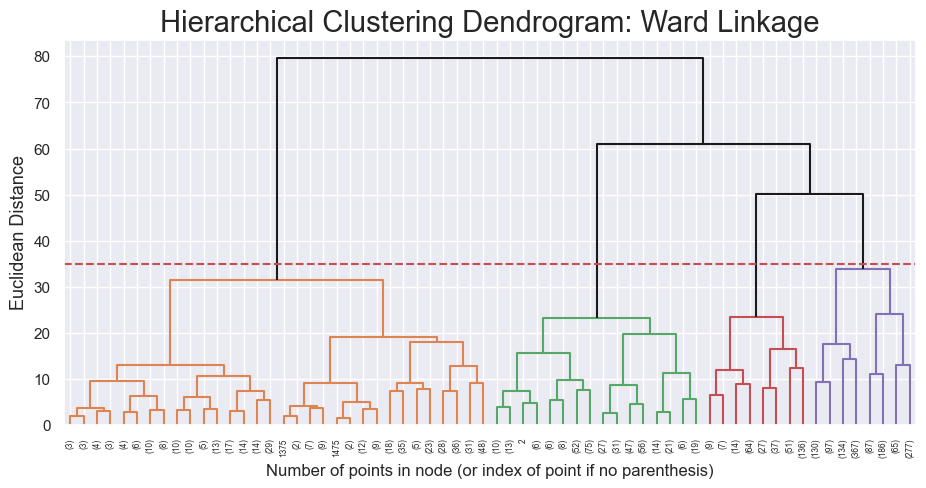

In [202]:
# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 35
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering Dendrogram: {linkage.title()} Linkage', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
plt.show()

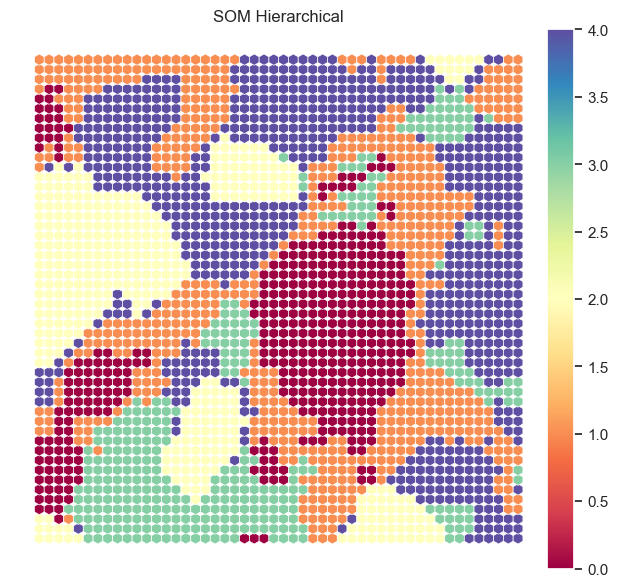

In [203]:
# Perform Hierarchical clustering on top of the MxN units 
hierclust = AgglomerativeClustering(n_clusters=5, linkage='ward')
nodeclus_labels = hierclust.fit_predict(weights)
hclust_matrix = nodeclus_labels.reshape((M,N))
figsize=(10,7)
fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hclust_matrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    hclust_matrix,
                    label="SOM Hierarchical",
                    cmap=cm.Spectral,
                    )

The map provides a clear and structured view of the dataset's segmentation. The clear boundaries between most clusters show that the data has strong separability, but there are a few transition areas where boundaries are less sharp, suggesting some overlap or gradual shifts in behavior. 

In [204]:
# Check the nodes and and respective clusters
nodes = weights

df_nodes = pd.DataFrame(nodes, columns=perspective1)
df_nodes['label'] = nodeclus_labels

bmu_index = np.array([sm.winner(x) for x in data_2[perspective1].values])
som_final_labels = [hclust_matrix[i[0]][i[1]] for i in bmu_index]

df_final = pd.concat([data_inversed_2,
                pd.Series(som_final_labels, name='label', index=data_inversed_2.index)], axis=1)

# Characterizing the final clusters
df_final[perspective1+['label']].groupby('label').mean()

,customer_age,total_spend,diversity_cuisine_types,purchase_frequency,different_weekdays
label,,,,,
0,26.923347,77.700612,4.329750,0.209441,5.217107
1,25.082878,40.482221,2.791812,0.145434,3.395989
2,26.921728,15.349572,1.054528,1.444986,1.048316
3,39.710112,28.787376,2.328846,0.198111,2.660842
4,25.328882,20.465382,1.664236,0.174810,2.085559


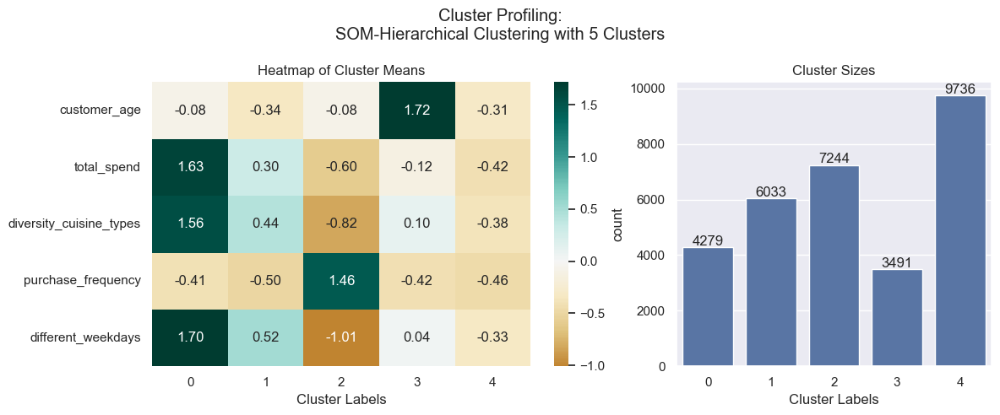

In [205]:
# Define figure and axes
fig, axes = plt.subplots(1, 2, figsize=(12, 5), width_ratios=[0.6, 0.4], tight_layout=True)

df_final = pd.concat([data_2,
                pd.Series(som_final_labels, name='label', index=data_2.index)], axis=1)

# Heatmap for cluster means
hc_profile = df_final[perspective1 + ['label']].groupby('label').mean().T
sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0])
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")

# Countplot for cluster sizes
sns.countplot(data=df_final, x='label', ax=axes[1])

# Annotate counts above bars
for bar in axes[1].patches:
    count = int(bar.get_height())  # Get the height of each bar
    axes[1].annotate(f"{count}", 
                     xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()),  # Position at the top of the bar
                     xytext=(0, 5),  # Offset text by 5 points
                     textcoords="offset points",
                     ha='center', va='center')

axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

# Add an overall title
fig.suptitle("Cluster Profiling:\nSOM-Hierarchical Clustering with 5 Clusters")
plt.show()

In [206]:
silhouette_score(data_2[perspective1], som_final_labels)

0.21757361823509577

In [207]:
evaluate_clustering_metrics(data_2[perspective1], som_final_labels)

Calinski-Harabasz Index: 10737.366299672414
Davies-Bouldin Index: 1.3797705180423159



In [208]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(df_final[perspective1])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = df_final[perspective1 + ["label"]].groupby(by='label').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(df_final)  # Total number of data points
k = df_final['label'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.5825
Adjusted R²: 0.5825


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\3495638694.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



#### 4.3.3.2 SOM - K-Means

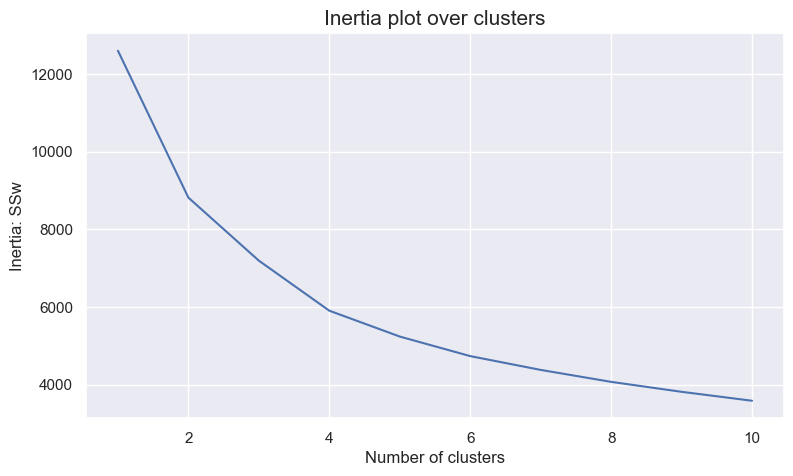

In [209]:
range_clusters = range(1, 11)

inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit_predict(weights)
    inertia.append(kmclust.inertia_)

# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(range_clusters, inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

Number of clusters: 3
Average Silhouette Score: 0.3176470354841078

Cluster 0: Average Silhouette Score = 0.33624970156175166
Cluster 1: Average Silhouette Score = 0.19482674296747668
Cluster 2: Average Silhouette Score = 0.3750676911709703


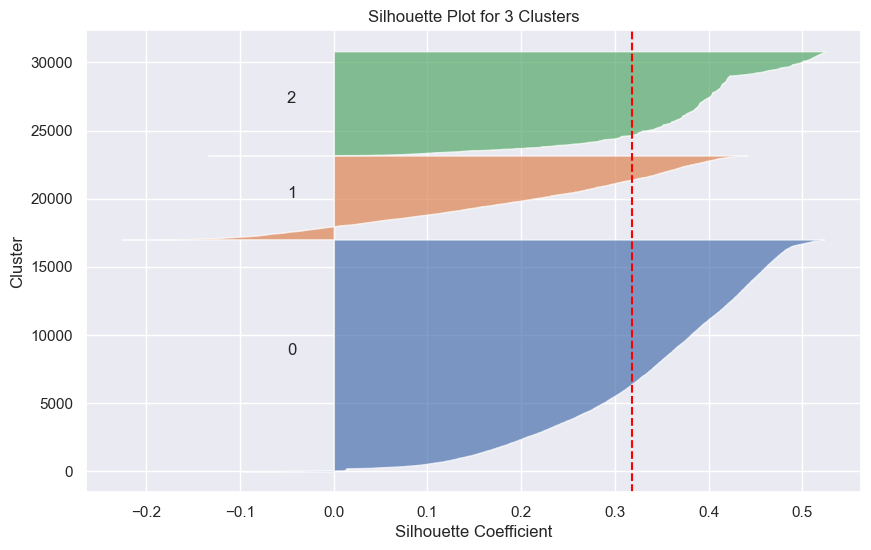

Calinski-Harabasz Index: 14360.103387506184
Davies-Bouldin Index: 1.1761089211724143

Number of clusters: 4
Average Silhouette Score: 0.32275175864842476

Cluster 0: Average Silhouette Score = 0.38667743589063014
Cluster 1: Average Silhouette Score = 0.36722650932281115
Cluster 2: Average Silhouette Score = 0.19776014252336868
Cluster 3: Average Silhouette Score = 0.20067714592459782


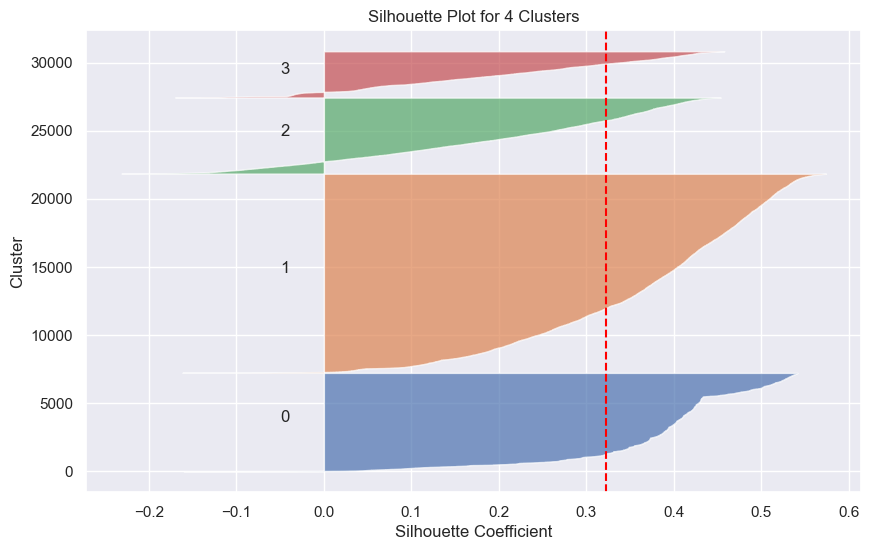

Calinski-Harabasz Index: 13228.202998380695
Davies-Bouldin Index: 1.0940235894048258

Number of clusters: 5
Average Silhouette Score: 0.31817165570801376

Cluster 0: Average Silhouette Score = 0.369575101138098
Cluster 1: Average Silhouette Score = 0.18936179170642722
Cluster 2: Average Silhouette Score = 0.38110903170335286
Cluster 3: Average Silhouette Score = 0.21011886488678336
Cluster 4: Average Silhouette Score = 0.19549980635731884


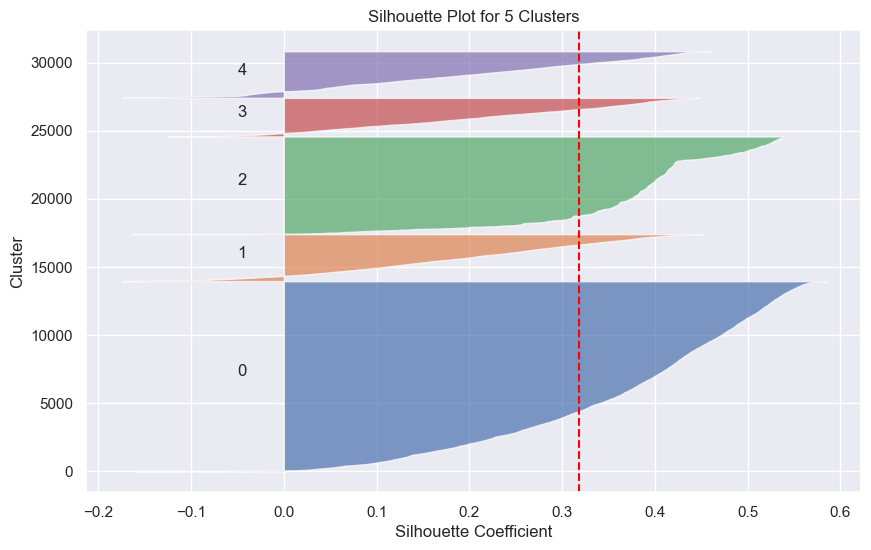

Calinski-Harabasz Index: 11912.490556979219
Davies-Bouldin Index: 1.2296945218454176

Number of clusters: 6
Average Silhouette Score: 0.2758752572256205

Cluster 0: Average Silhouette Score = 0.3333649156085108
Cluster 1: Average Silhouette Score = 0.18749526527044166
Cluster 2: Average Silhouette Score = 0.19343424870372353
Cluster 3: Average Silhouette Score = 0.20167435324466018
Cluster 4: Average Silhouette Score = 0.17989275866816973
Cluster 5: Average Silhouette Score = 0.33863321956864967


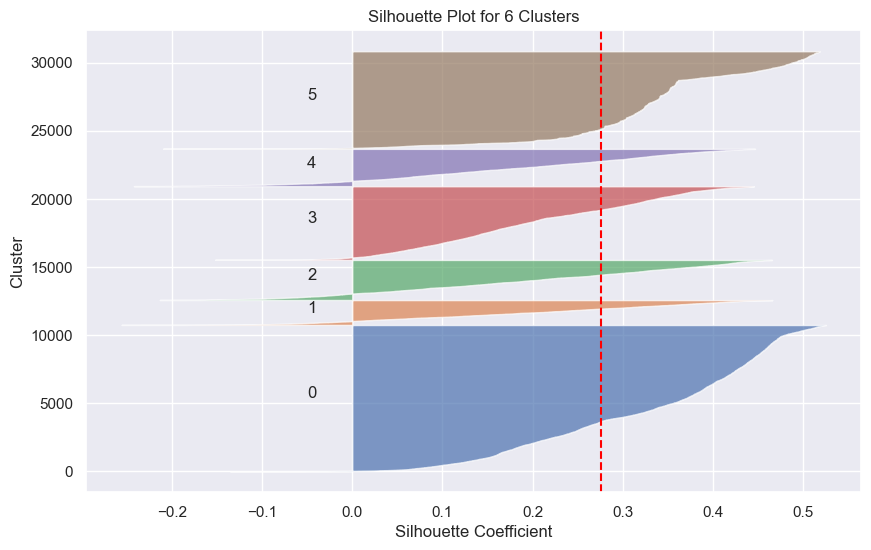

Calinski-Harabasz Index: 11226.771216643465
Davies-Bouldin Index: 1.2019882848267949



In [210]:
# Storing average silhouette metric
cluster_range = [3,4,5,6]
for nclus in cluster_range:
    # Skip nclus == 1
    if nclus == 1:
        continue

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(weights)
    bmu_index = np.array([sm.winner(x) for x in data[perspective1].values])
    kmeans_matrix = cluster_labels.reshape((M,N))
    som_final_labels = [kmeans_matrix[i[0]][i[1]] for i in bmu_index]

    df_final = pd.concat([data,
                    pd.Series(som_final_labels, name='label', index=data.index)], axis=1)
    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_analysis(df_final[perspective1], np.array(som_final_labels), nclus)
    evaluate_clustering_metrics(df_final[perspective1], np.array(som_final_labels))



##### Cluster = 4

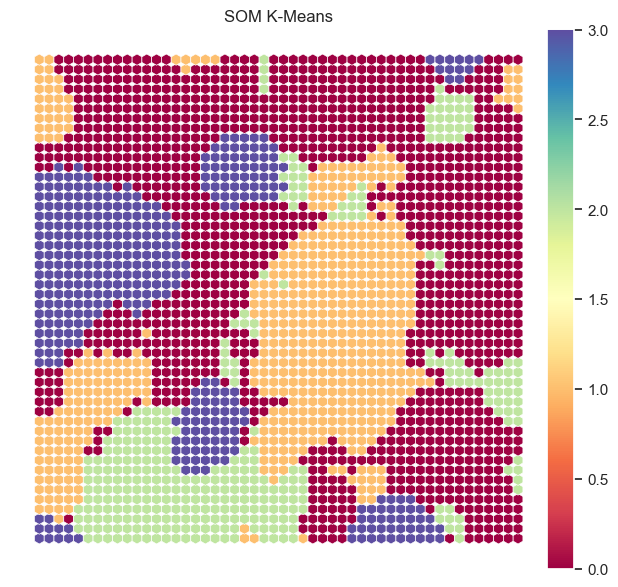

In [211]:
kmeans = KMeans(n_clusters=4, init='k-means++', n_init=20, random_state=42)
nodeclus_labels = kmeans.fit_predict(weights)
nodeclus_labels

kmeans_matrix = nodeclus_labels.reshape((M,N))

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(kmeans_matrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    kmeans_matrix,
                    label="SOM K-Means",
                    cmap=cm.Spectral,
                    )

In [212]:
# Check the nodes and and respective clusters
nodes = weights

df_nodes = pd.DataFrame(nodes, columns=perspective1)
df_nodes['label'] = nodeclus_labels

bmu_index = np.array([sm.winner(x) for x in data_2[perspective1].values])
som_final_labels = [kmeans_matrix[i[0]][i[1]] for i in bmu_index]

df_final = pd.concat([data_inversed_2,
                pd.Series(som_final_labels, name='label', index=data_inversed_2.index)], axis=1)

# Characterizing the final clusters
df_final[perspective1+['label']].groupby('label').mean()

,customer_age,total_spend,diversity_cuisine_types,purchase_frequency,different_weekdays
label,,,,,
0,25.102978,25.899217,2.044300,0.150613,2.476481
1,26.839283,73.077239,4.086996,0.202528,4.979013
2,41.256486,26.974104,2.067512,0.265772,2.477889
3,26.429205,15.322467,1.066010,1.442842,1.063375


In [213]:
df_final = pd.concat([data_2,
                pd.Series(som_final_labels, name='label', index=data_2.index)], axis=1)

# Compute SST (Total Sum of Squares)
sst = get_ss_2(df_final[perspective1])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = df_final[perspective1 + ["label"]].groupby(by='label').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(df_final)  # Total number of data points
k = df_final['label'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.5661
Adjusted R²: 0.5660


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\2759863077.py:8: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



##### Cluster = 5

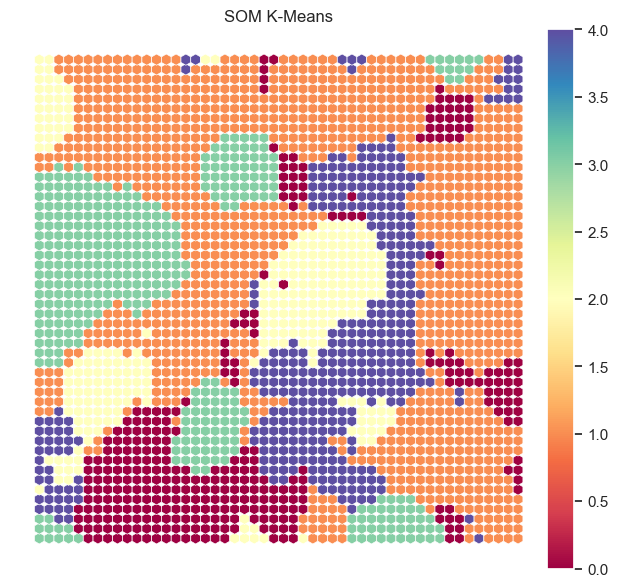

In [214]:
kmeans = KMeans(n_clusters=5, init='k-means++', n_init=20, random_state=42)
nodeclus_labels = kmeans.fit_predict(weights)
nodeclus_labels

kmeans_matrix = nodeclus_labels.reshape((M,N))

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(kmeans_matrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    kmeans_matrix,
                    label="SOM K-Means",
                    cmap=cm.Spectral,
                    )

In [215]:
# Check the nodes and and respective clusters
nodes = weights

df_nodes = pd.DataFrame(nodes, columns=perspective1)
df_nodes['label'] = nodeclus_labels

bmu_index = np.array([sm.winner(x) for x in data_2[perspective1].values])
som_final_labels = [kmeans_matrix[i[0]][i[1]] for i in bmu_index]

df_final = pd.concat([data_inversed_2,
                pd.Series(som_final_labels, name='label', index=data_inversed_2.index)], axis=1)

# Characterizing the final clusters
df_final[perspective1+['label']].groupby('label').mean()

,customer_age,total_spend,diversity_cuisine_types,purchase_frequency,different_weekdays
label,,,,,
0,41.281628,25.741035,1.998526,0.293473,2.416691
1,25.059973,24.196311,2.049667,0.148677,2.443212
2,27.031858,55.810998,5.252389,0.202155,5.310088
3,26.276432,15.364665,1.064837,1.443297,1.062456
4,26.825080,85.398816,2.746308,0.198183,4.366638


In [216]:
df_final = pd.concat([data_2,
                pd.Series(som_final_labels, name='label', index=data_2.index)], axis=1)

# Compute SST (Total Sum of Squares)
sst = get_ss_2(df_final[perspective1])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = df_final[perspective1 + ["label"]].groupby(by='label').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(df_final)  # Total number of data points
k = df_final['label'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.6109
Adjusted R²: 0.6109


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\2759863077.py:8: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



##### Final Solution **(k=5)**

In [217]:
kmeans = KMeans(n_clusters=5, init='k-means++', n_init=20, random_state=42)
nodeclus_labels = kmeans.fit_predict(weights)
nodeclus_labels

kmeans_matrix = nodeclus_labels.reshape((M,N))

In [218]:
# Check the nodes and and respective clusters
nodes = weights

df_nodes = pd.DataFrame(nodes, columns=perspective1)
df_nodes['label'] = nodeclus_labels

bmu_index = np.array([sm.winner(x) for x in data_2[perspective1].values])
som_final_labels = [kmeans_matrix[i[0]][i[1]] for i in bmu_index]

df_final = pd.concat([data_inversed_2,
                pd.Series(som_final_labels, name='label', index=data_inversed_2.index)], axis=1)

# Characterizing the final clusters
df_final[perspective1+['label']].groupby('label').mean()

,customer_age,total_spend,diversity_cuisine_types,purchase_frequency,different_weekdays
label,,,,,
0,41.281628,25.741035,1.998526,0.293473,2.416691
1,25.059973,24.196311,2.049667,0.148677,2.443212
2,27.031858,55.810998,5.252389,0.202155,5.310088
3,26.276432,15.364665,1.064837,1.443297,1.062456
4,26.825080,85.398816,2.746308,0.198183,4.366638


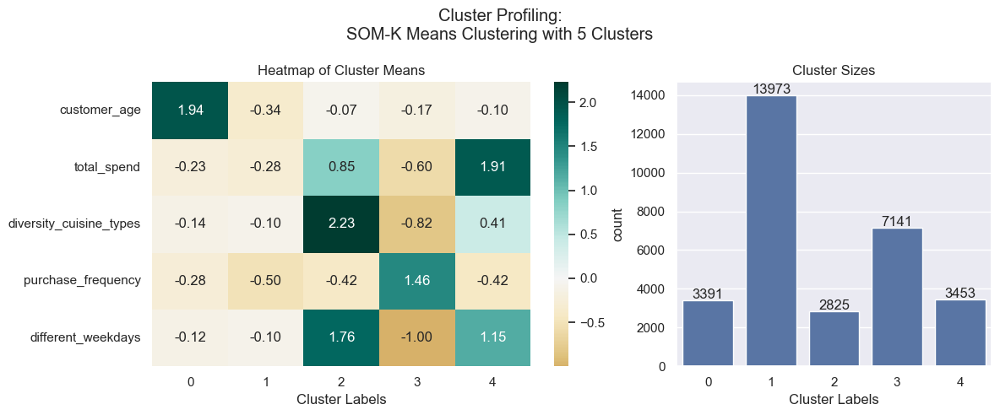

In [219]:
df_final = pd.concat([data_2,
                pd.Series(som_final_labels, name='label', index=data_2.index)], axis=1)

# Define figure and axes
fig, axes = plt.subplots(1, 2, figsize=(12, 5), width_ratios=[0.6, 0.4], tight_layout=True)

# Heatmap for cluster means
km_profile = df_final[perspective1 + ['label']].groupby('label').mean().T
sns.heatmap(km_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0])
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")

# Countplot for cluster sizes
sns.countplot(data=df_final, x='label', ax=axes[1])

# Annotate counts above bars
for bar in axes[1].patches:
    count = int(bar.get_height())  # Get the height of each bar
    axes[1].annotate(f"{count}", 
                     xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()),  # Position at the top of the bar
                     xytext=(0, 5),  # Offset text by 5 points
                     textcoords="offset points",
                     ha='center', va='center')

axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

# Add an overall title
fig.suptitle("Cluster Profiling:\nSOM-K Means Clustering with 5 Clusters")
plt.show()

The clustering explains nearly 70% of the variance, indicating that the clusters capture significant patterns in the data.<br>
This R^2 value suggests a reasonable trade-off between simplicity (fewer clusters) and explained variance.

**Limitations:**
About 30% of the variance remains unexplained (SSW), indicating potential noise or unaccounted complexity in the data.

### 4.1.4 Density Clustering

#### Mean Shift

In [220]:
# defines the size of the neighborhood around each data point when forming clusters
# It determines how far the algorithm will look to consider data points as part of the same cluster.
# A small bandwidth results in many small clusters (high granularity), while a large bandwidth results in fewer, broader clusters.
bandwidth = estimate_bandwidth(data[perspective1], quantile=0.15, random_state=1, n_jobs=-1)
bandwidth

1.7169499946715276

In [221]:
# Perform mean-shift clustering with bandwidth set using estimate_bandwidth
ms = MeanShift(bandwidth=bandwidth, bin_seeding=True, n_jobs=4)
ms_labels = ms.fit_predict(data[perspective1])

ms_n_clusters = len(np.unique(ms_labels))
print("Number of estimated clusters : %d" % ms_n_clusters)

Number of estimated clusters : 11


In [222]:
# Concatenating the labels to df
df_concat = pd.concat([data[perspective1], pd.Series(ms_labels, index=data.index, name="ms_labels")], axis=1)

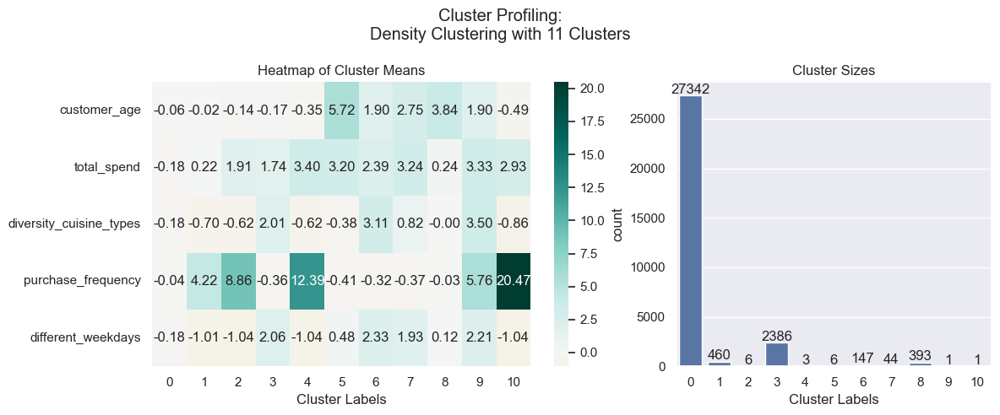

In [223]:
# Define figure and axes
fig, axes = plt.subplots(1, 2, figsize=(12, 5), width_ratios=[0.6, 0.4], tight_layout=True)

# Heatmap for cluster means
den_profile = df_concat[perspective1+['ms_labels']].groupby('ms_labels').mean().T
sns.heatmap(den_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0])
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")

# Countplot for cluster sizes
sns.countplot(data=df_concat, x='ms_labels', ax=axes[1])

# Annotate counts above bars
for bar in axes[1].patches:
    count = int(bar.get_height())  # Get the height of each bar
    axes[1].annotate(f"{count}", 
                     xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()),  # Position at the top of the bar
                     xytext=(0, 5),  # Offset text by 5 points
                     textcoords="offset points",
                     ha='center', va='center')

axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

# Add an overall title
fig.suptitle("Cluster Profiling:\nDensity Clustering with 11 Clusters")
plt.show()

In [224]:
# Computing the R^2 of the cluster solution
sst = get_ss_2(data[perspective1])  # get total sum of squares
ssw_labels = df_concat.groupby(by='ms_labels').apply(get_ss_2)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
print("Cluster solution with R^2 of %0.4f" % r2)

Cluster solution with R^2 of 0.3328


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\509605510.py:3: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



## 4.2 Perspective 2: Spending Profile

**Customer Engagement and Spending Profile** : It provides insights into how customers interact with the platform, their financial contribution, and their preference diversity,

In [225]:
perspective2=['total_spend', 'spent_top_cuisine','diversity_cuisine_types','spend_per_order', 'spent_main_food', 'spent_beverages_addons']

To analyse the correlation between features we create a heatmap

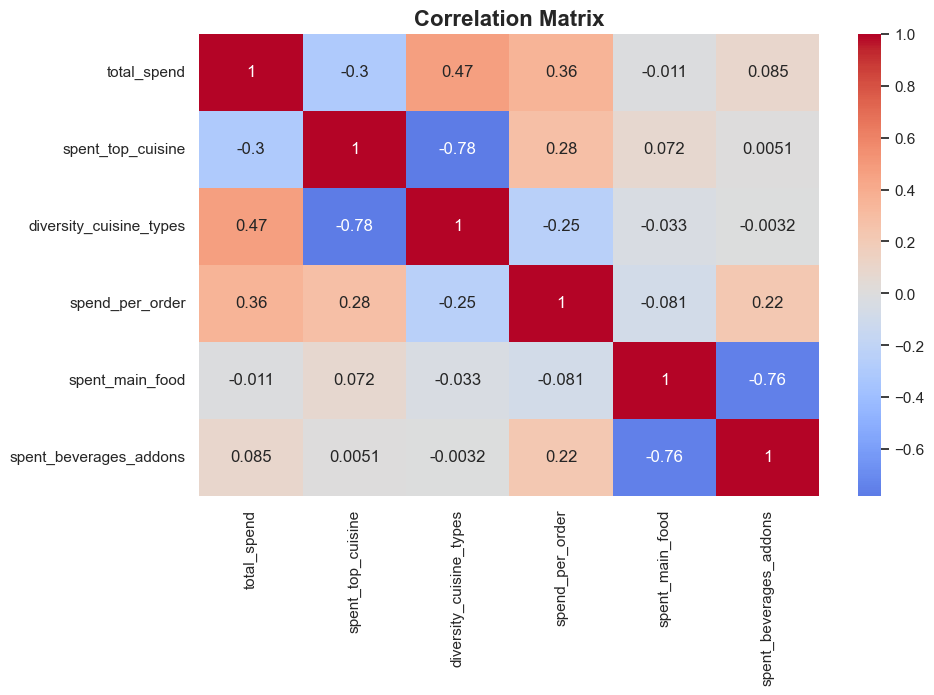

In [226]:
#heatmap perspective 2
plt.figure(figsize=(10, 6))
sns.heatmap(data[perspective2].corr(), annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Matrix', fontsize=16, fontweight='bold')
plt.show()

In [227]:
# UNCOMMENT TO RUN!!

# combinations_results = feature_combinations_clustering(
#     data[perspective2], 
#     n_clusters=4, 
#     n_combinations=10, 
#     subset_sizes=(5, 6)
# )

# print(combinations_results)
# best_combination = combinations_results.iloc[0]
# print("\nBest Combination:")
# print(best_combination)

# combinations_results.to_csv('combinations_results_2.csv', index=False)

In [228]:
# perspective2 = [feature for feature in combinations_results.iloc[0]['Features']]
# perspective2

perspective2 = ['total_spend', 'spent_top_cuisine', 'diversity_cuisine_types', 'spent_main_food', 'spent_beverages_addons']

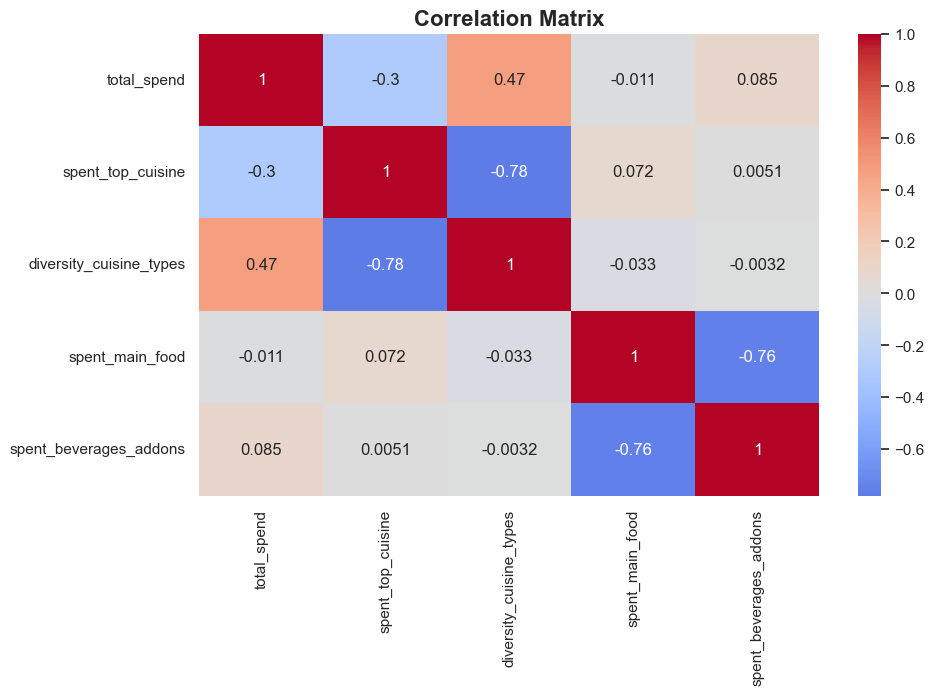

In [229]:
#heatmap perspective 2
plt.figure(figsize=(10, 6))
sns.heatmap(data[perspective2].corr(), annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Matrix', fontsize=16, fontweight='bold')
plt.show()

### 4.2.1 Hierarchical Clustering

#### R squared

In [230]:
hc_methods = ["ward"]
max_nclus = 10

r2_hc = np.vstack([get_r2_hc(data[perspective2], 
                              link, 
                              max_nclus=max_nclus, 
                              min_nclus=1, 
                              dist="euclidean") 
                              for link in hc_methods])

In [231]:
r2_hc_methods = pd.DataFrame(r2_hc.T, index=range(1, max_nclus + 1), columns=hc_methods)

C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\2967480448.py:5: UserWarning:

The markers list has more values (4) than needed (1), which may not be intended.



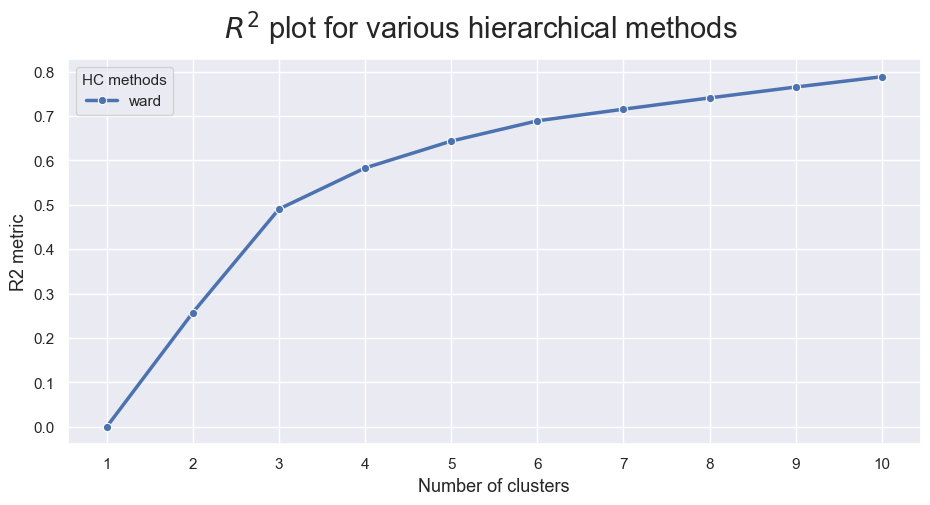

In [232]:
sns.set()

# Plot data
fig = plt.figure(figsize=(11,5))
sns.lineplot(data=r2_hc_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
plt.legend(title="HC methods", title_fontsize=11)
plt.xticks(range(1, max_nclus + 1))
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)

fig.suptitle("$R^2$ plot for various hierarchical methods", fontsize=21)

plt.show()

#### Dendogram

The following graphic shows the better performance of HC cluster with the method 'ward'

In [233]:
# setting distance_threshold=0 and n_clusters=None ensures we compute the full tree
linkage = 'ward'
distance = 'euclidean'


hclust = AgglomerativeClustering(linkage=linkage, metric=distance, distance_threshold=0, n_clusters=None)
hclust.fit_predict(data[perspective2])

array([22507, 21248, 30788, ...,     5,     2,     0], dtype=int64)

In [234]:
# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

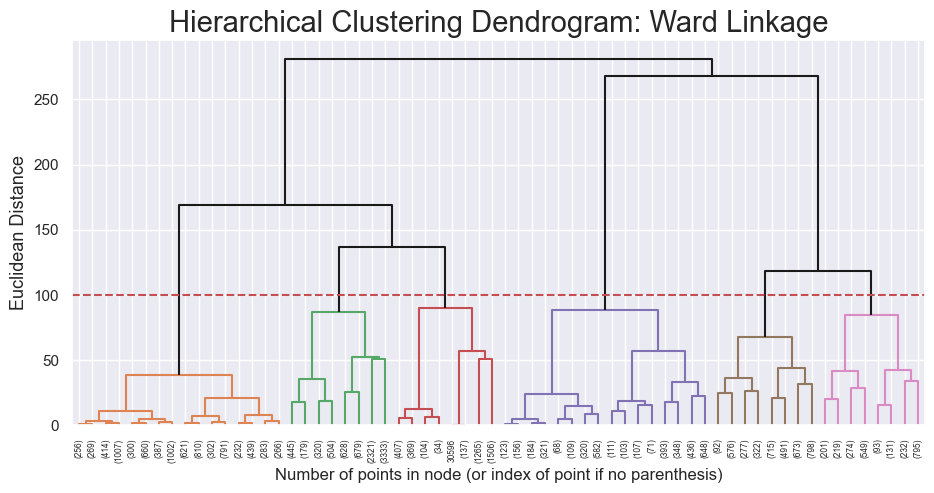

In [235]:
# Visualize the Dendrogram with y_threshold = 100

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold =100
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering Dendrogram: {linkage.title()} Linkage', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
plt.show()

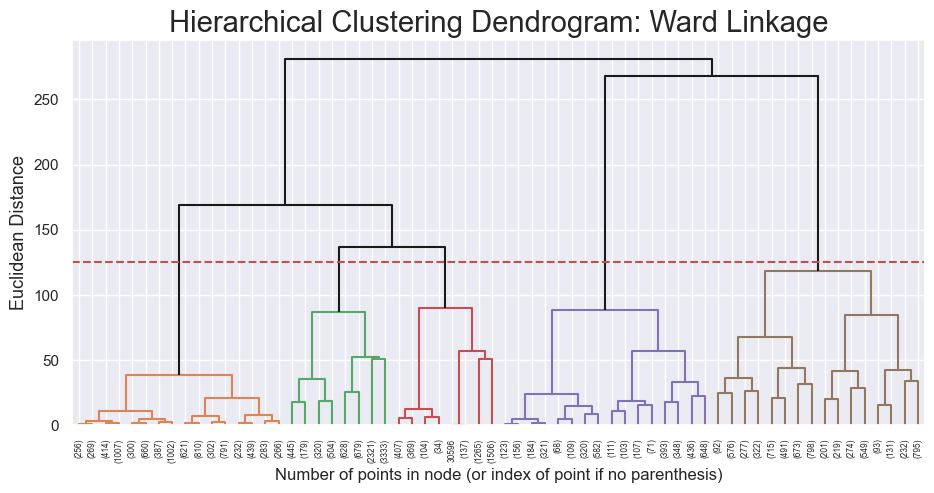

In [236]:
# Visualize the Dendrogram with y_threshold = 125

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 125
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering Dendrogram: {linkage.title()} Linkage', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
plt.show()

#### Defining the number of Clusters

Number of clusters: 5
Average Silhouette Score: 0.34973599378833997

Cluster 0: Average Silhouette Score = 0.06584485158122448
Cluster 1: Average Silhouette Score = 0.16043446024673874
Cluster 2: Average Silhouette Score = 0.40398717707033815
Cluster 3: Average Silhouette Score = 0.789615937256305
Cluster 4: Average Silhouette Score = 0.20630053688852154


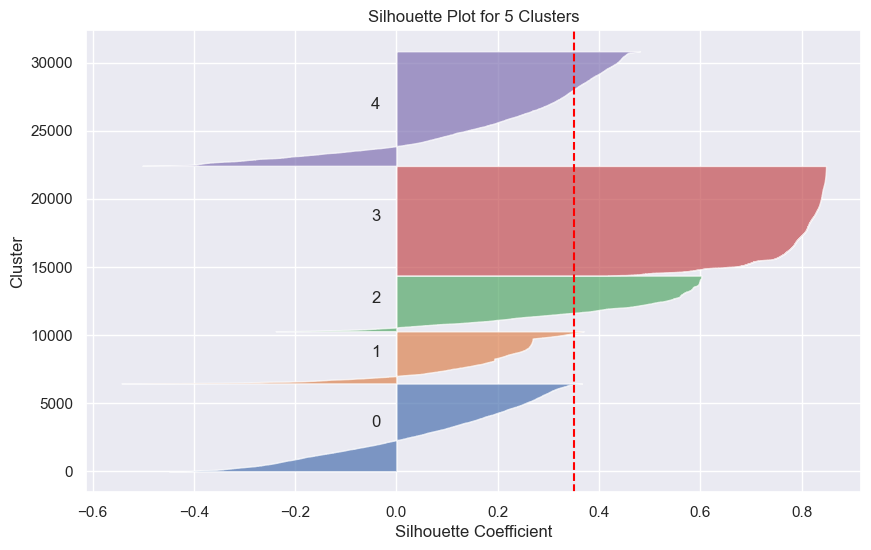

Calinski-Harabasz Index: 13875.148484234343
Davies-Bouldin Index: 1.177846804589399

Number of clusters: 6
Average Silhouette Score: 0.35317228031640185

Cluster 0: Average Silhouette Score = 0.12891598834924786
Cluster 1: Average Silhouette Score = 0.17476937677513552
Cluster 2: Average Silhouette Score = 0.3979847024027557
Cluster 3: Average Silhouette Score = 0.789615937256305
Cluster 4: Average Silhouette Score = 0.12269709320888461
Cluster 5: Average Silhouette Score = 0.16070820741145278


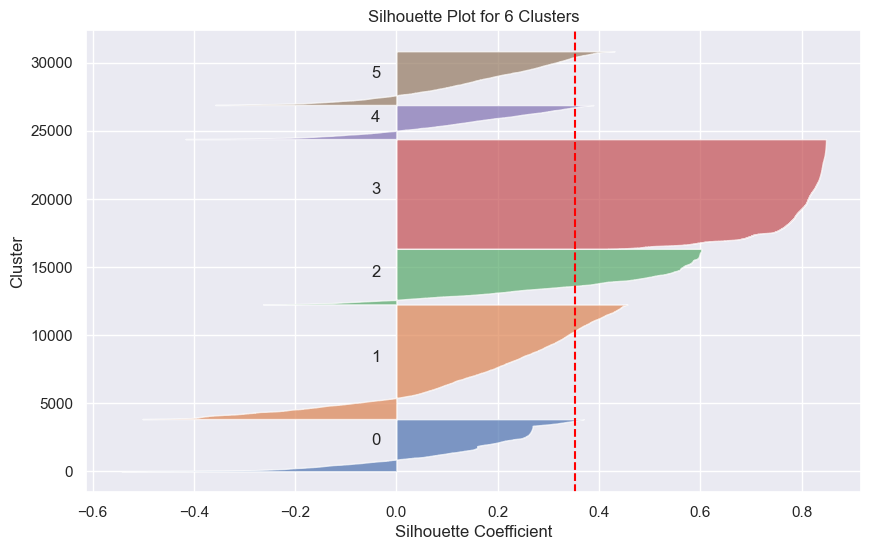

Calinski-Harabasz Index: 13634.428756793784
Davies-Bouldin Index: 1.2527803829345212



In [237]:
# Define the range of clusters to test
cluster_range = [5, 6]

# Create a dictionary to store results for each number of clusters
cluster_results = {}

# Run Agglomerative Clustering for each value in the cluster range
for n_clusters in cluster_range:
    hc_model = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    labels = hc_model.fit_predict(data[perspective2]) 
    silhouette_analysis(data[perspective2], labels, n_clusters)
    evaluate_clustering_metrics(data[perspective2], labels)
    cluster_results[n_clusters] = labels  # Store labels for each n_clusters

# Convert results to a DataFrame for easier visualization
results_df = pd.DataFrame(cluster_results, index=data.index)
results_df.columns = [f'Cluster_{n}' for n in cluster_range]

The silhouette score measures how similar an object is to its own cluster compared to other clusters. It ranges from -1 to 1:

- A value close to 1 means well-clustered points.
- A value close to 0 means points lie between clusters.
- A negative value indicates points are likely assigned to the wrong cluster.

**Calinski-Harabasz Index**
This index measures the ratio of the sum of between-cluster dispersion to within-cluster dispersion:

- Higher values indicate well-separated clusters.
- Use this metric across clustering runs to evaluate the feature set.


**Davies-Bouldin Index**
This metric evaluates the average similarity ratio of each cluster with its most similar cluster:

- Lower values are better (indicating better separation between clusters).
- It's sensitive to feature selection and can provide insights into whether features differentiate clusters effectively.

Davies-Bouldin Index > 1 suggest less distinct clustering or overlapping clusters.


#### Comparison between 5 and 6

In [238]:
pd.crosstab(
    pd.Series(results_df['Cluster_6'], name='Cluster_6', index=data.index),
    pd.Series(results_df['Cluster_5'], name='Cluster_5', index=data.index),)

Cluster_5,0,1,2,3,4
Cluster_6,,,,,
0,0,3823,0,0,0
1,0,0,0,0,8409
2,0,0,4080,0,0
3,0,0,0,8039,0
4,2494,0,0,0,0
5,3944,0,0,0,0


In [239]:
# Characterizing the 5 clusters
df_concat = pd.concat([data_inversed[perspective2], 
                       pd.Series(results_df['Cluster_5'], 
                                 name='labels', 
                                 index=data_inversed.index)], 
                    axis=1)

df_concat.groupby('labels').mean()

,total_spend,spent_top_cuisine,diversity_cuisine_types,spent_main_food,spent_beverages_addons
labels,,,,,
0,60.521283,0.481890,4.143678,0.692449,0.169326
1,16.889213,0.691216,1.858750,0.359962,0.146624
2,29.780725,0.834577,1.693137,0.110964,0.866421
3,16.283765,1.000000,1.000000,1.000000,0.000000
4,33.504193,0.692112,2.214294,0.969014,0.010505


In [240]:
# Characterizing the 6 clusters
df_concat = pd.concat([data_inversed[perspective2], 
                       pd.Series(results_df['Cluster_6'], 
                                 name='labels', 
                                 index=data_inversed.index)], 
                    axis=1)

df_concat.groupby('labels').mean()

,total_spend,spent_top_cuisine,diversity_cuisine_types,spent_main_food,spent_beverages_addons
labels,,,,,
0,16.889213,0.691216,1.858750,0.359962,0.146624
1,33.504193,0.692112,2.214294,0.969014,0.010505
2,29.780725,0.834577,1.693137,0.110964,0.866421
3,16.283765,1.000000,1.000000,1.000000,0.000000
4,96.140706,0.501337,4.520850,0.743508,0.161178
5,37.997236,0.469593,3.905172,0.660161,0.174478


#### Final Solution **(k=5)**

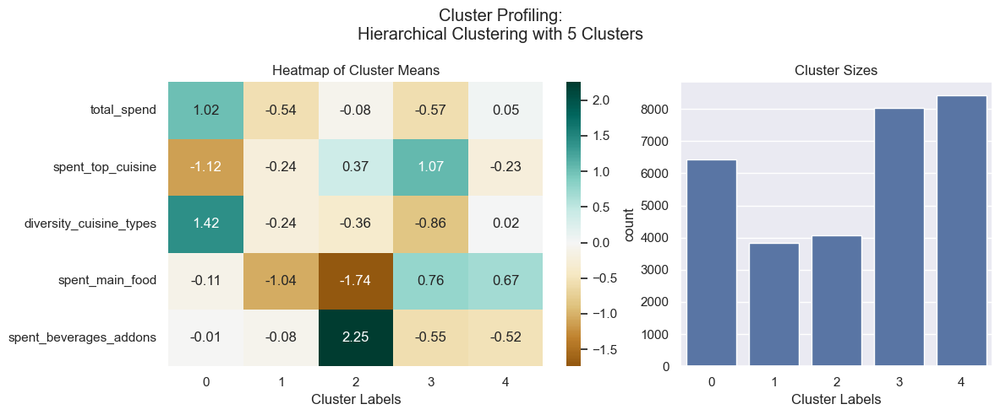

In [241]:
label_counts = None 

fig, axes = plt.subplots(1,2, figsize=(12,5), width_ratios=[.6,.4], tight_layout=True)

data_concat = pd.concat([
    data[perspective2], 
    pd.Series(results_df['Cluster_5'], name='labels', index=data.index)
    ], 
    axis=1)

hc_profile = data_concat.groupby('labels').mean().T

sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0]
            )
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")


sns.countplot(data_concat, x='labels', ax=axes[1])
axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

fig.suptitle("Cluster Profiling:\nHierarchical Clustering with 5 Clusters")
plt.show()

In [242]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(data_concat[perspective2])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = data_concat[perspective2 + ["labels"]].groupby(by='labels').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(data_concat)  # Total number of data points
k = data_concat['labels'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.6432
Adjusted R²: 0.6432


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\2100281759.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



### 4.2.2 K Means

#### Inertia

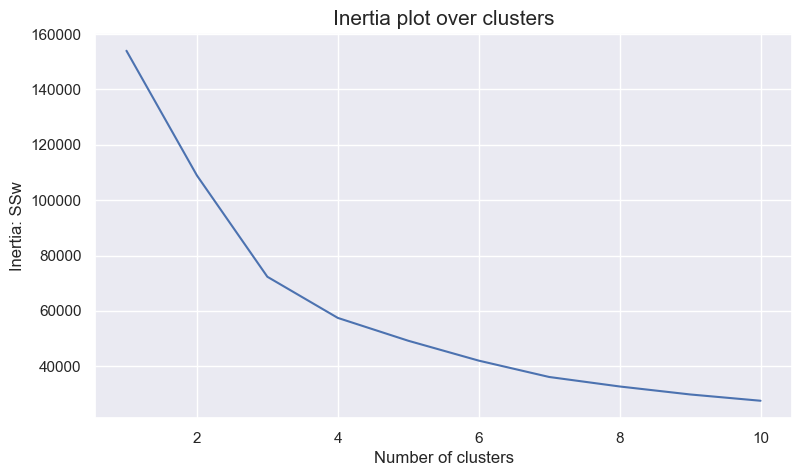

In [243]:
range_clusters = range(1, 11)

inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit(data[perspective2])
    inertia.append(kmclust.inertia_)

# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(range_clusters, inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

#### Defining the number of Clusters

In [244]:
# Storing average silhouette metric
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(data[perspective2])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(data[perspective2], cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(data[perspective2], cluster_labels)

For n_clusters = 2, the average silhouette_score is : 0.3411503550966042
For n_clusters = 3, the average silhouette_score is : 0.40216411594525664
For n_clusters = 4, the average silhouette_score is : 0.3824658036196323
For n_clusters = 5, the average silhouette_score is : 0.3842437890316782
For n_clusters = 6, the average silhouette_score is : 0.39844272715089696
For n_clusters = 7, the average silhouette_score is : 0.42997064961989595
For n_clusters = 8, the average silhouette_score is : 0.40979249846166066
For n_clusters = 9, the average silhouette_score is : 0.4207593685073916
For n_clusters = 10, the average silhouette_score is : 0.4282821728263872


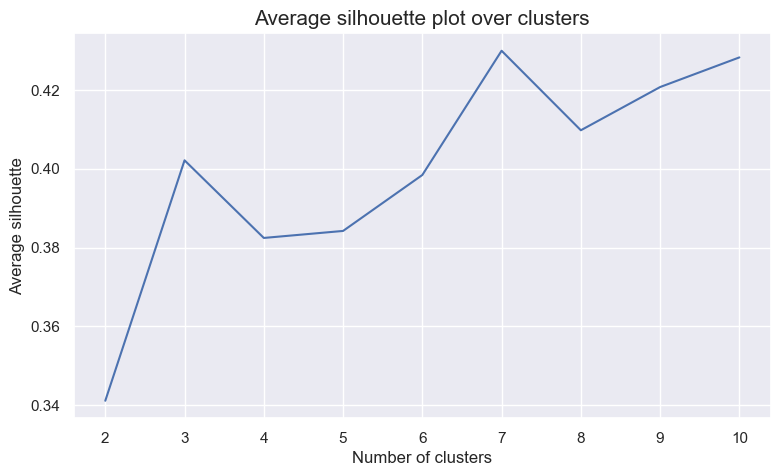

In [245]:
# The average silhouette plot
# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(range_clusters[1:], 
         avg_silhouette)    

plt.ylabel("Average silhouette")
plt.xlabel("Number of clusters")
plt.title("Average silhouette plot over clusters", size=15)
plt.show()

In [246]:
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(data[perspective2])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    print(f"For n_clusters = {nclus}, the metrics are :")
    metrics_avg = evaluate_clustering_metrics(data[perspective2], cluster_labels)

For n_clusters = 2, the metrics are :
Calinski-Harabasz Index: 12727.40008275958
Davies-Bouldin Index: 1.4012456747206974

For n_clusters = 3, the metrics are :
Calinski-Harabasz Index: 17369.03122410923
Davies-Bouldin Index: 1.0508082573911783

For n_clusters = 4, the metrics are :
Calinski-Harabasz Index: 17225.515060213642
Davies-Bouldin Index: 1.1011842785789598

For n_clusters = 5, the metrics are :
Calinski-Harabasz Index: 16373.105095571545
Davies-Bouldin Index: 1.1277682471901935

For n_clusters = 6, the metrics are :
Calinski-Harabasz Index: 16384.843128712604
Davies-Bouldin Index: 1.1263583645553308

For n_clusters = 7, the metrics are :
Calinski-Harabasz Index: 16722.78507242885
Davies-Bouldin Index: 0.9859524581528528

For n_clusters = 8, the metrics are :
Calinski-Harabasz Index: 16296.078745528757
Davies-Bouldin Index: 1.0190087926002838

For n_clusters = 9, the metrics are :
Calinski-Harabasz Index: 16006.597534377961
Davies-Bouldin Index: 1.0270235860218289

For n_clust

#### Final solution **(k=7)**

In [247]:
kmclust_7 = KMeans(n_clusters=7, init='k-means++', n_init=15, random_state=1)
kmclust_7.fit(data[perspective2])
labels_7 = kmclust_7.predict(data[perspective2])

Number of clusters: 7
Average Silhouette Score: 0.42997064961989595

Cluster 0: Average Silhouette Score = 0.3033513708972065
Cluster 1: Average Silhouette Score = 0.673857960226379
Cluster 2: Average Silhouette Score = 0.21942181955422574
Cluster 3: Average Silhouette Score = 0.22886637064142856
Cluster 4: Average Silhouette Score = 0.5735691712641294
Cluster 5: Average Silhouette Score = 0.1786603301404316
Cluster 6: Average Silhouette Score = 0.5544509461359298


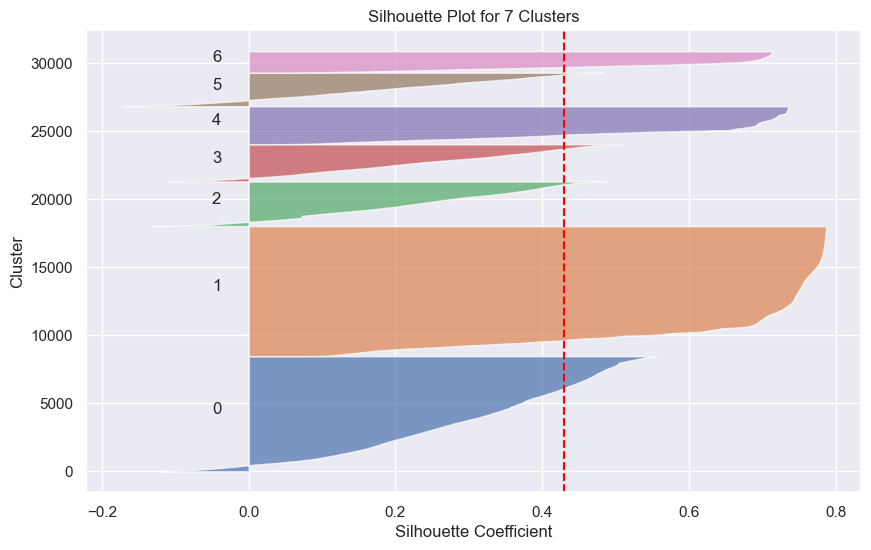

In [248]:
silhouette_analysis(data[perspective2], labels_7, 7)

In [249]:
evaluate_clustering_metrics(data[perspective2], labels_7)

Calinski-Harabasz Index: 16722.78507242885
Davies-Bouldin Index: 0.9859524581528528



In [250]:
data_concat = pd.concat([
    data_inversed[perspective2], 
    pd.Series(labels_7, name='labels', index=data_inversed.index)
    ], 
    axis=1)
data_concat.groupby('labels').mean()

,total_spend,spent_top_cuisine,diversity_cuisine_types,spent_main_food,spent_beverages_addons
labels,,,,,
0,25.174598,0.613790,2.451521,0.890466,0.026155
1,19.916141,0.987173,1.101739,0.997364,0.001429
2,28.966604,0.529687,2.540226,0.406919,0.485069
3,54.337248,0.393350,5.295371,0.717080,0.131378
4,27.711247,0.933683,1.320273,0.030851,0.964231
5,97.991380,0.648000,3.017915,0.783566,0.161808
6,16.101957,0.899596,1.481198,0.090060,0.010344


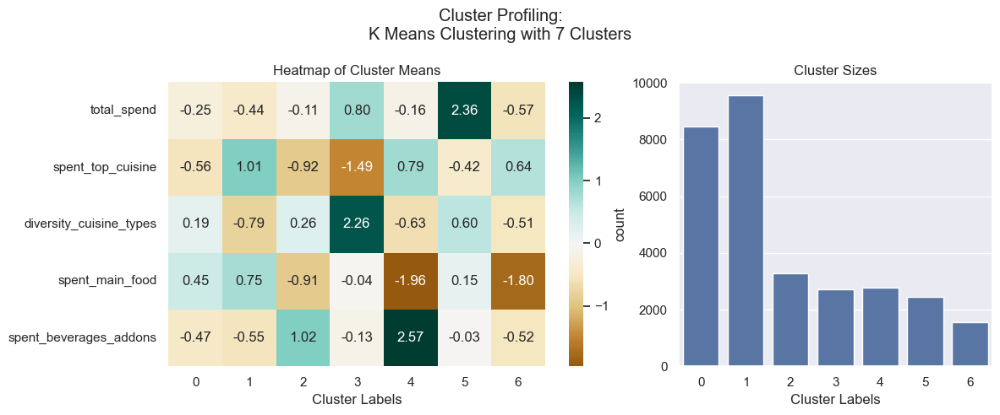

In [251]:
label_counts = None 

fig, axes = plt.subplots(1,2, figsize=(12,5), width_ratios=[.6,.4], tight_layout=True)

data_concat = pd.concat([
    data[perspective2], 
    pd.Series(labels_7, name='labels', index=data.index)
    ], 
    axis=1)

hc_profile = data_concat.groupby('labels').mean().T

sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0]
            )
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")


sns.countplot(data_concat, x='labels', ax=axes[1])
axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

fig.suptitle("Cluster Profiling:\nK Means Clustering with 7 Clusters")
plt.show()

In [252]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(data_concat[perspective2])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = data_concat[perspective2 + ["labels"]].groupby(by='labels').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(data_concat)  # Total number of data points
k = data_concat['labels'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.7652
Adjusted R²: 0.7652


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\2100281759.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



### 4.2.3 SOM

#### Training

In [253]:
neighborhood_function = 'gaussian' # Defines how neighboring neurons affect each other during training. A 'gaussian' function is used here, meaning the influence decreases with distance.
topology = 'rectangular' 
n_feats = len(perspective2)
learning_rate = 0.6

som_data = data[perspective2].values
# M, N = calculate_grid_size(len(som_data), aspect_ratio=1)  # Square grid
M = 50
N = 50
print(f"Grid size: M={M}, N={N}")

sm = MiniSom(M, N,              # 10x10 map size
             n_feats,           # Number of the elements of the vectors in input.
             learning_rate=learning_rate, 
             topology=topology, 
             neighborhood_function=neighborhood_function, 
             activation_distance='euclidean',
             random_seed=42
             )

# Initializes the weights of the SOM picking random samples from data.
sm.random_weights_init(som_data) 


print("Before training:")
print("QE", np.round(sm.quantization_error(som_data),4)) # Quantization Error (QE): Measures how well the SOM represents the input data. It calculates the average distance between input vectors and their best-matching units (BMUs).
print("TE", np.round(sm.topographic_error(som_data),4)) # Topographic Error (TE): Measures how well the SOM preserves the topological relationships in the input data.

# Trains the SOM using all the vectors in data sequentially
# minisom does not distinguish between unfolding and fine tuning phase;

sm.train_batch(som_data, 400000)

print("After training:")
print("QE", np.round(sm.quantization_error(som_data),4))
print("TE", np.round(sm.topographic_error(som_data),4))

Grid size: M=50, N=50
Before training:


c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\minisom.py:513: RuntimeWarning:

invalid value encountered in sqrt



QE 0.1232
TE 0.9975
After training:
QE 0.0806
TE 0.2965


In [254]:
bmus = np.array([sm.winner(x) for x in som_data])  # (row, col) for each data point
weights = sm.get_weights().reshape((M*N),len(perspective2))
weights.shape

(2500, 5)

We started with a QE of 0.12, reflecting the mismatch between input data and untrained weights, and a very high value of TE (0.9975), indicating poor topology preservation, which is expected with untrained weights.

After training, we observe an **improvement in QE**, showing that the SOM has learned to represent the input data better. The final QE value is 0.08 (<0.2), which is considered good, indicating that the neurons are closer to the input data points, leading to better cluster quality.

We also observe an **improvement in TE**, indicating that the trained SOM preserves the topology much better. The final TE value is 0.2965, which, which is below the ideal threshold of 0.3, and represents a significant improvement in the preservation of the data's topological structure.

The grid size was set at M=50 and N=50, which is larger than the size recommended by the rule of thumb (5* sqrt(N) where N is the number of input data points). While the rule of thumb provides a general guideline, this larger grid size yielded significantly better results in terms of quality and topology preservation, likely due to the added flexibility in representing the data's structure.

##### Hexagons heatmap

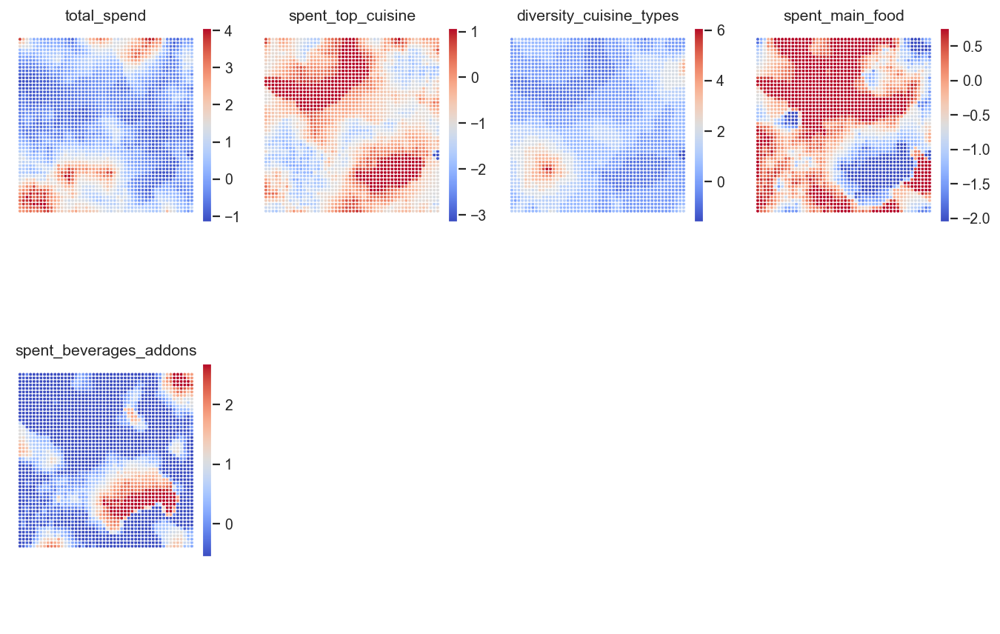

In [255]:
weights = sm.get_weights()

figsize=(10,7)
fig = plt.figure(figsize=figsize, constrained_layout=True, dpi=128, )

subfigs = fig.subfigures(2,4,wspace=.15)

colornorm = mpl_colors.Normalize(vmin=np.min(weights), vmax=np.max(weights))

for cpi, sf in zip(range(len(perspective2)), subfigs.flatten()):
    
    matrix_vals = weights[:,:,cpi]
    vext = np.max(np.abs([np.min(matrix_vals), np.max(matrix_vals)]))
    colornorm = mpl_colors.Normalize(vmin=np.min(matrix_vals), vmax=np.max(matrix_vals))
    # colornorm = mpl_colors.CenteredNorm(vcenter=0, halfrange=vext)


    sf = plot_hexagons(sm, sf, 
                    colornorm,
                    matrix_vals,
                    label=perspective2[cpi],
                    cmap=cm.coolwarm,
                    )

**spent_top_cuisine**
- High values in specific regions indicate customers who focus a large proportion of their spending on their top cuisine. Blue regions correspond to customers with lower spending on their top cuisine.

**spend_per_order**
- A small, distinct red area indicates customers with anomalously high spending per order (identified in previous clustering approaches). This cluster might represent outliers that can be seen as a unique high-value customer segment.

##### U-Matrix

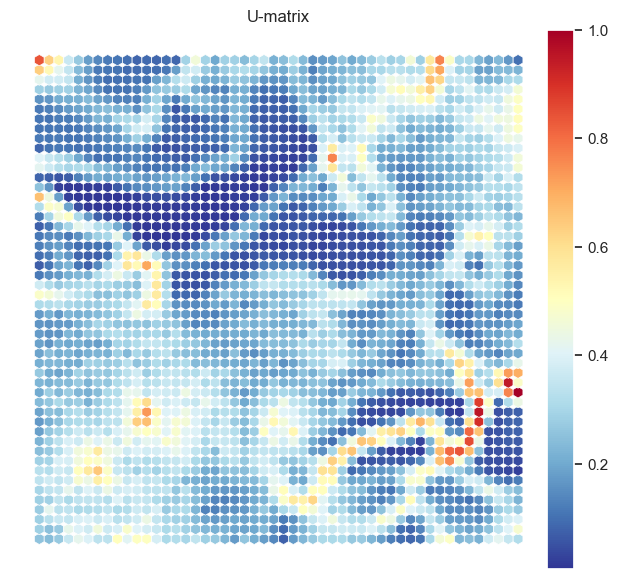

In [256]:
umatrix = sm.distance_map(scaling='mean')
fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=np.min(umatrix), vmax=np.max(umatrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    umatrix,
                    label="U-matrix",
                    cmap=cm.RdYlBu_r
                    )

The U-Matrix shows the distances between neighboring neurons, giving us a sense of how the data clusters. 

**Insights**

The U-Matrix shows **clear boundaries in the red and yellow areas**, indicating well-separated groups, but **there aren’t many tightly packed clusters**, suggesting only a few strong patterns in the data. The blue areas suggest **overlap**, where clusters blend together, likely because some features like age or cuisine preferences aren’t distinct enough. The sharp red spots might be driven by features like spend_per_order or age dominating the clustering, making other variables like diversity or total orders less influential.


##### Hit-map

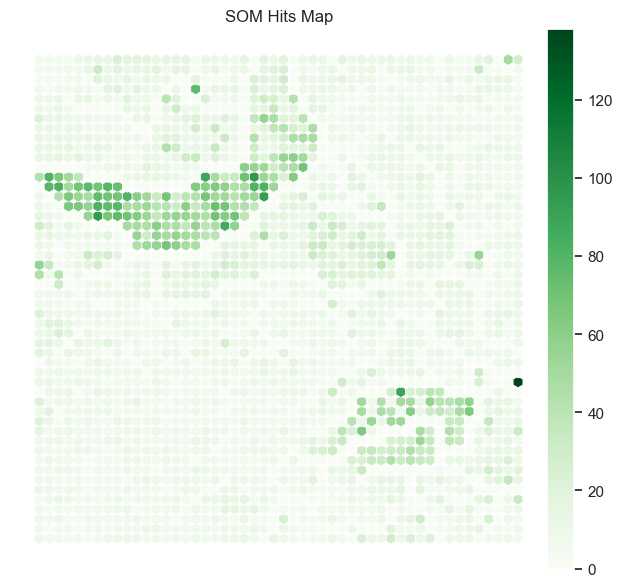

In [257]:
hitsmatrix = sm.activation_response(data[perspective2].values)


fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hitsmatrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    hitsmatrix,
                    label="SOM Hits Map",
                    cmap=cm.Greens
                    )

The SOM Hits Map shows how many data points are mapped to each neuron, with dark green areas representing the busiest clusters. 

**Insights**

There's a big uneven spread. The dense regions suggest that common patterns dominate, which might mean smaller, unique behaviors are being overlooked. On the other hand, the light areas with few hits could indicate that some neurons aren’t being used effectively. This shows the SOM captures the main patterns well but might miss out on smaller, less obvious ones.

#### 4.1.3.1 SOM - Hierarchical

In [258]:
# setting distance_threshold=0 and n_clusters=None ensures we compute the full tree
linkage = 'ward'
distance = 'euclidean'
weights = sm.get_weights().reshape((M*N),len(perspective2))

hclust = AgglomerativeClustering(linkage=linkage, 
                                 metric=distance,
                                 distance_threshold=0,
                                 n_clusters=None)

hclust.fit_predict(weights)

array([2355, 2227, 1347, ...,    1,    2,    0], dtype=int64)

Number of clusters: 4
Average Silhouette Score: 0.330984397283945

Cluster 0: Average Silhouette Score = 0.3733639529721687
Cluster 1: Average Silhouette Score = 0.24572012765697804
Cluster 2: Average Silhouette Score = 0.4471646331493673
Cluster 3: Average Silhouette Score = 0.16892718706994758


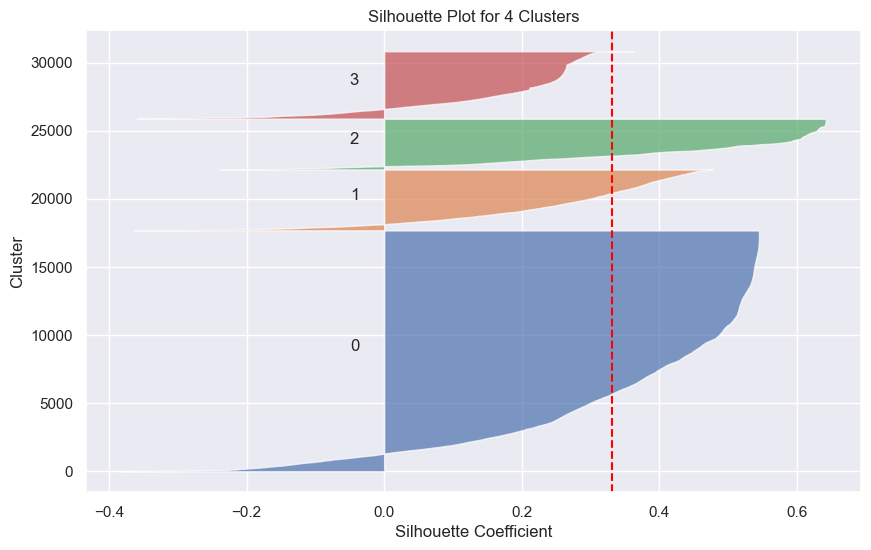

Calinski-Harabasz Index: 12577.005472767265
Davies-Bouldin Index: 1.3216852438508757

Number of clusters: 5
Average Silhouette Score: 0.3143791636514135

Cluster 0: Average Silhouette Score = 0.18879141191618412
Cluster 1: Average Silhouette Score = 0.3885312280834468
Cluster 2: Average Silhouette Score = 0.44657572021308517
Cluster 3: Average Silhouette Score = 0.1376650821616773
Cluster 4: Average Silhouette Score = 0.23227155482027517


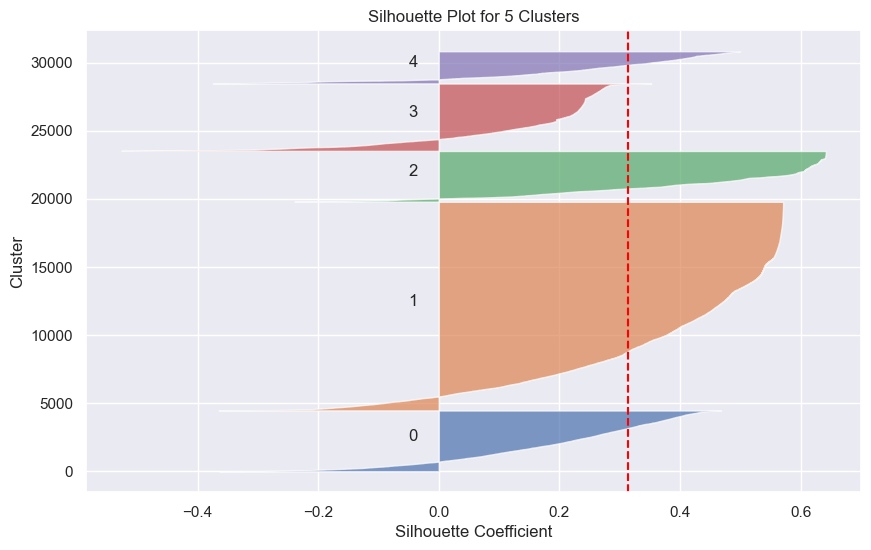

Calinski-Harabasz Index: 11666.798394258945
Davies-Bouldin Index: 1.2555900384685714

Number of clusters: 6
Average Silhouette Score: 0.30879162678729716

Cluster 0: Average Silhouette Score = 0.3793470234605687
Cluster 1: Average Silhouette Score = 0.12147764762930924
Cluster 2: Average Silhouette Score = 0.17355406567622214
Cluster 3: Average Silhouette Score = 0.24064251248718238
Cluster 4: Average Silhouette Score = 0.19624409328155384
Cluster 5: Average Silhouette Score = 0.4441367099310571


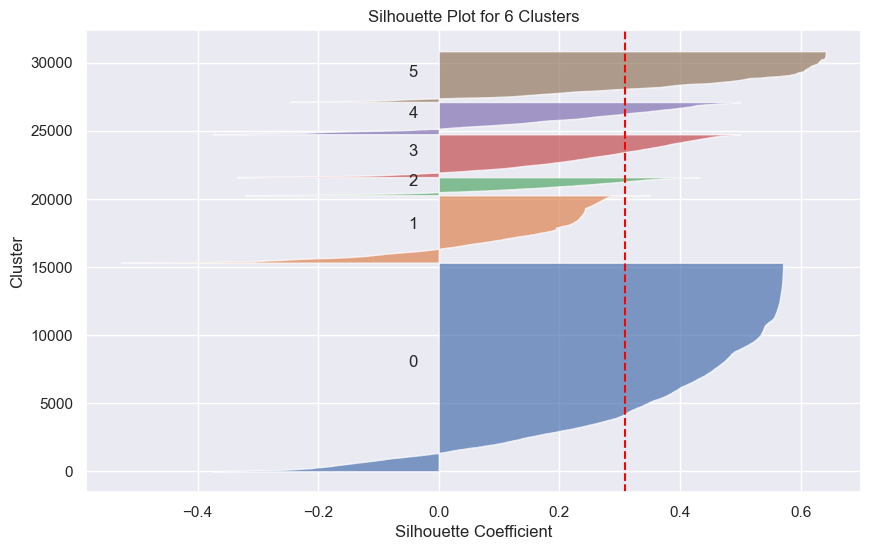

Calinski-Harabasz Index: 10485.875240470566
Davies-Bouldin Index: 1.3269790300201068

Number of clusters: 7
Average Silhouette Score: 0.373002872409159

Cluster 0: Average Silhouette Score = 0.033415752866605926
Cluster 1: Average Silhouette Score = 0.1541749161697601
Cluster 2: Average Silhouette Score = 0.17355406567622214
Cluster 3: Average Silhouette Score = 0.3174744473806881
Cluster 4: Average Silhouette Score = 0.11310377401448433
Cluster 5: Average Silhouette Score = 0.4441367099310571
Cluster 6: Average Silhouette Score = 0.7913528687385816


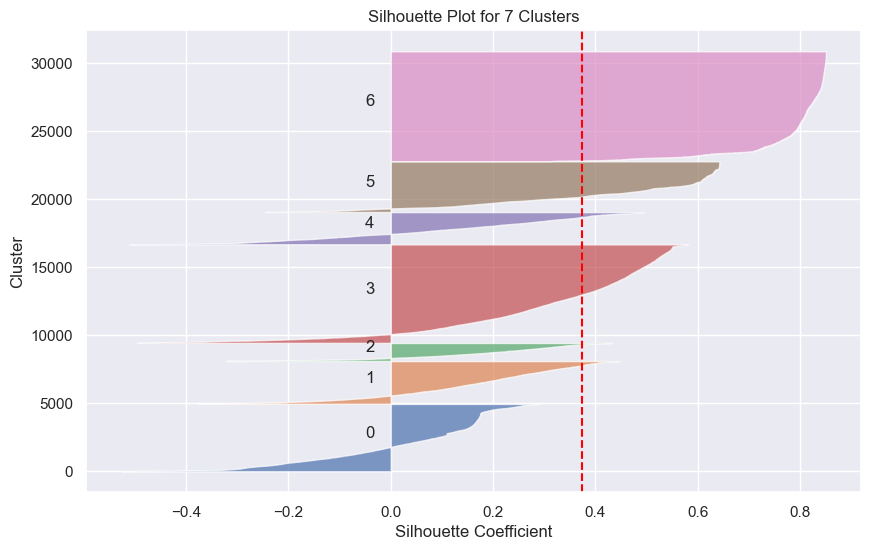

Calinski-Harabasz Index: 13212.930343444032
Davies-Bouldin Index: 1.2374103646178842



In [259]:
# Define the range of clusters to test
cluster_range = [4, 5, 6, 7]


# Run Agglomerative Clustering for each value in the cluster range
for n_clusters in cluster_range:
    hc_model = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    nodeclus_labels = hc_model.fit_predict(weights)
    hclust_matrix = nodeclus_labels.reshape((M,N))

    bmu_index = np.array([sm.winner(x) for x in data[perspective2].values])
    som_final_labels = [hclust_matrix[i[0]][i[1]] for i in bmu_index]

    df_final = pd.concat([data,
                    pd.Series(som_final_labels, name='label', index=data.index)], axis=1)
    
    silhouette_analysis(df_final[perspective2], np.array(som_final_labels), n_clusters)
    evaluate_clustering_metrics(df_final[perspective2], np.array(som_final_labels))

In [260]:
# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

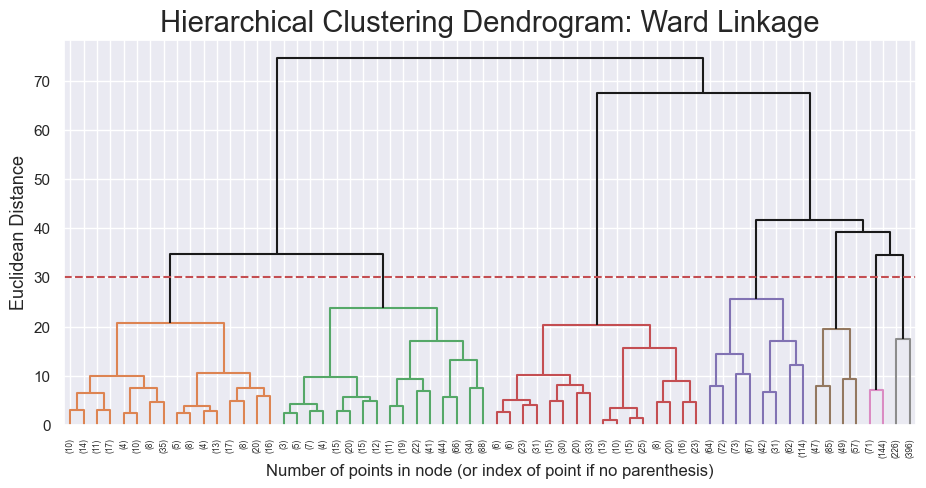

In [261]:
# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 30
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering Dendrogram: {linkage.title()} Linkage', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
plt.show()

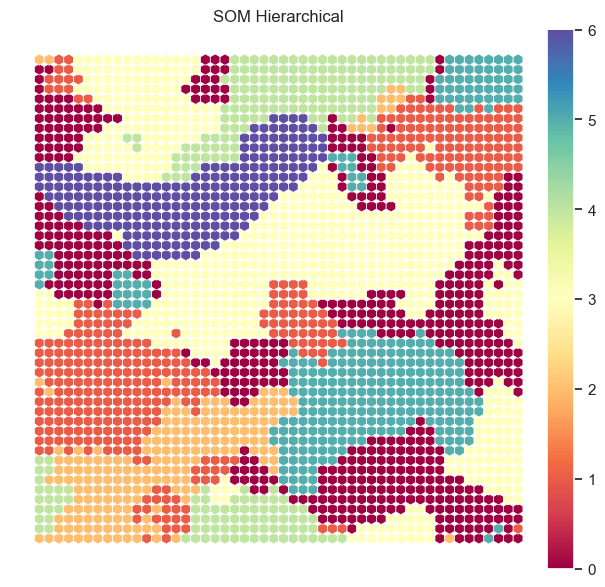

In [262]:
# Perform Hierarchical clustering on top of the MxN units 

hierclust = AgglomerativeClustering(n_clusters=7, linkage='ward')
nodeclus_labels = hierclust.fit_predict(weights)
hclust_matrix = nodeclus_labels.reshape((M,N))

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hclust_matrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    hclust_matrix,
                    label="SOM Hierarchical",
                    cmap=cm.Spectral,
                    )

In [263]:
# Check the nodes and and respective clusters
nodes = weights

df_nodes = pd.DataFrame(nodes, columns=perspective2)
df_nodes['label'] = nodeclus_labels

bmu_index = np.array([sm.winner(x) for x in data[perspective2].values])
som_final_labels = [hclust_matrix[i[0]][i[1]] for i in bmu_index]

df_final = pd.concat([data_inversed,
                pd.Series(som_final_labels, name='label', index=data_inversed.index)], axis=1)

# Characterizing the final clusters
df_final[perspective2+['label']].groupby('label').mean()

,total_spend,spent_top_cuisine,diversity_cuisine_types,spent_main_food,spent_beverages_addons
label,,,,,
0,25.207790,0.673375,2.032376,0.395727,0.188198
1,47.150564,0.410132,4.820325,0.688908,0.164837
2,104.166073,0.492777,4.351782,0.622997,0.275485
3,22.909423,0.626314,2.426103,0.945949,0.015513
4,74.145890,0.827816,2.051271,0.966933,0.021449
5,28.226298,0.855913,1.604839,0.089889,0.887180
6,16.429325,1.000000,1.000000,1.000000,0.000000


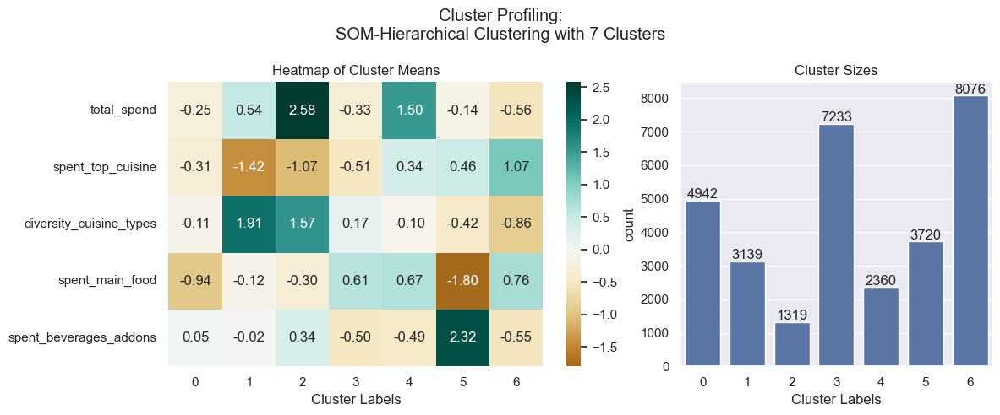

In [264]:
# Define figure and axes
fig, axes = plt.subplots(1, 2, figsize=(12, 5), width_ratios=[0.6, 0.4], tight_layout=True)

df_final = pd.concat([data,
                pd.Series(som_final_labels, name='label', index=data.index)], axis=1)

# Heatmap for cluster means
hc_profile = df_final[perspective2 + ['label']].groupby('label').mean().T
sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0])
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")

# Countplot for cluster sizes
sns.countplot(data=df_final, x='label', ax=axes[1])

# Annotate counts above bars
for bar in axes[1].patches:
    count = int(bar.get_height())  # Get the height of each bar
    axes[1].annotate(f"{count}", 
                     xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()),  # Position at the top of the bar
                     xytext=(0, 5),  # Offset text by 5 points
                     textcoords="offset points",
                     ha='center', va='center')

axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

# Add an overall title
fig.suptitle("Cluster Profiling:\nSOM-Hierarchical Clustering with 7 Clusters")
plt.show()

In [265]:
silhouette_score(data[perspective2], som_final_labels)

0.373002872409159

In [266]:
evaluate_clustering_metrics(data[perspective2], som_final_labels)

Calinski-Harabasz Index: 13212.930343444032
Davies-Bouldin Index: 1.2374103646178842



In [267]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(df_final[perspective2])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = df_final[perspective2 + ["label"]].groupby(by='label').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(df_final)  # Total number of data points
k = df_final['label'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.7203
Adjusted R²: 0.7203


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\1073167240.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



#### 4.1.3.2 SOM - K-Means

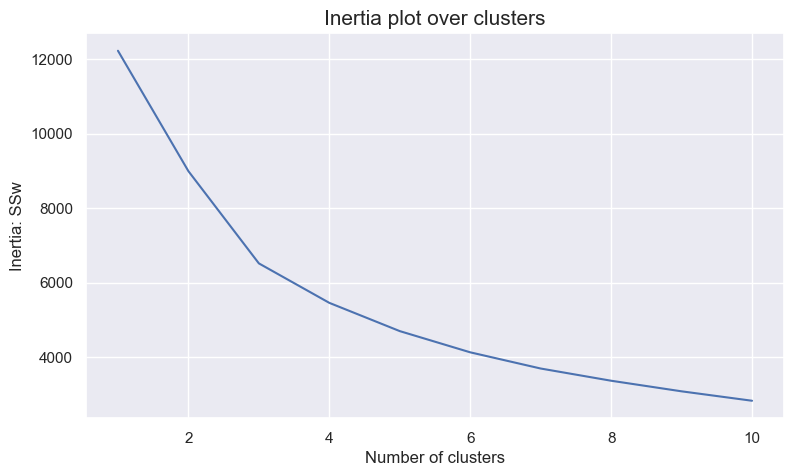

In [268]:
range_clusters = range(1, 11)

inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit_predict(weights)
    inertia.append(kmclust.inertia_)

# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(range_clusters, inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

Number of clusters: 3
Average Silhouette Score: 0.4098102861609593

Cluster 0: Average Silhouette Score = 0.287175725258527
Cluster 1: Average Silhouette Score = 0.4867326545353413
Cluster 2: Average Silhouette Score = 0.2745573462397732


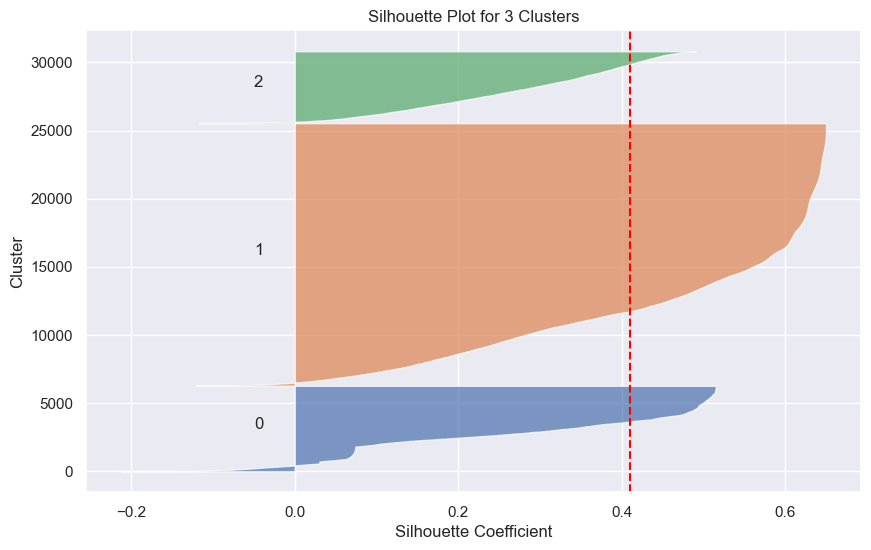

Calinski-Harabasz Index: 15779.079025027044
Davies-Bouldin Index: 1.022019030520202

Number of clusters: 4
Average Silhouette Score: 0.3749151416196727

Cluster 0: Average Silhouette Score = 0.49340475791712013
Cluster 1: Average Silhouette Score = 0.33004494346544033
Cluster 2: Average Silhouette Score = 0.25143177400636463
Cluster 3: Average Silhouette Score = 0.1816638402561344


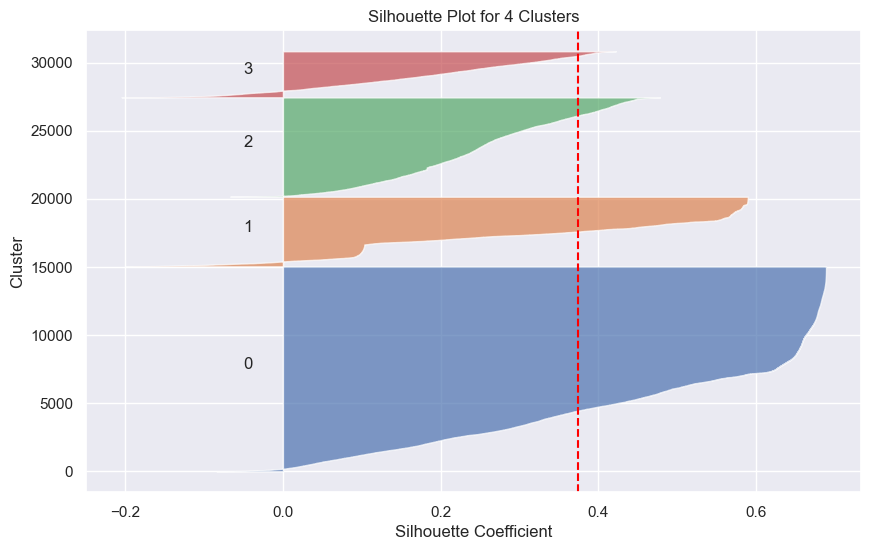

Calinski-Harabasz Index: 15876.528492586547
Davies-Bouldin Index: 1.1654736565602084

Number of clusters: 5
Average Silhouette Score: 0.3710308122713053

Cluster 0: Average Silhouette Score = 0.21837197347180348
Cluster 1: Average Silhouette Score = 0.25798195394338447
Cluster 2: Average Silhouette Score = 0.45290937555715216
Cluster 3: Average Silhouette Score = 0.4690220538068757
Cluster 4: Average Silhouette Score = 0.23441562492308352


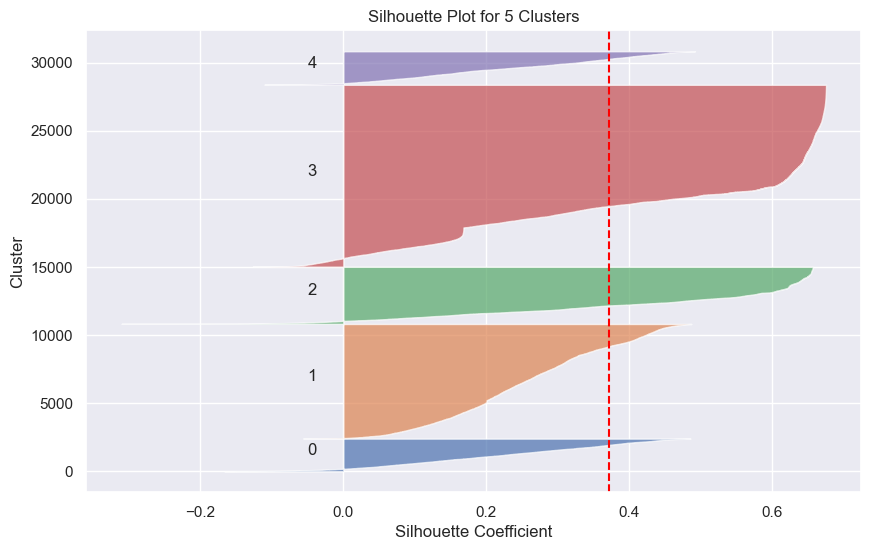

Calinski-Harabasz Index: 15126.748813270915
Davies-Bouldin Index: 1.0822242743890507

Number of clusters: 6
Average Silhouette Score: 0.3806098963384615

Cluster 0: Average Silhouette Score = 0.09871955908996088
Cluster 1: Average Silhouette Score = 0.23691871648609694
Cluster 2: Average Silhouette Score = 0.20826491768668384
Cluster 3: Average Silhouette Score = 0.3412832025608762
Cluster 4: Average Silhouette Score = 0.49869760683190334
Cluster 5: Average Silhouette Score = 0.5403498724540974


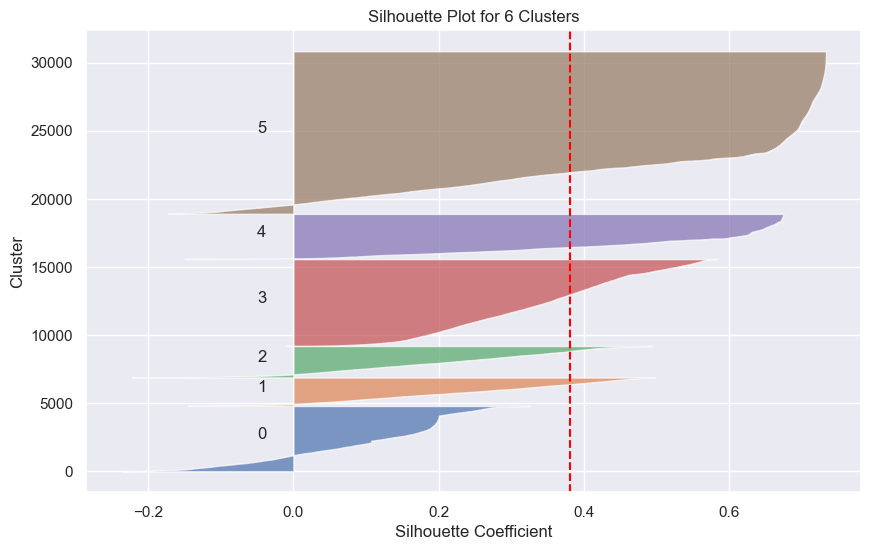

Calinski-Harabasz Index: 15448.772657655063
Davies-Bouldin Index: 1.1581525108291115



In [269]:
# Storing average silhouette metric
cluster_range = [3,4,5,6]
for nclus in cluster_range:
    # Skip nclus == 1
    if nclus == 1:
        continue

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(weights)
    bmu_index = np.array([sm.winner(x) for x in data[perspective2].values])
    kmeans_matrix = cluster_labels.reshape((M,N))
    som_final_labels = [kmeans_matrix[i[0]][i[1]] for i in bmu_index]

    df_final = pd.concat([data,
                    pd.Series(som_final_labels, name='label', index=data.index)], axis=1)
    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_analysis(df_final[perspective2], np.array(som_final_labels), nclus)
    evaluate_clustering_metrics(df_final[perspective2], np.array(som_final_labels))



##### Cluster = 5

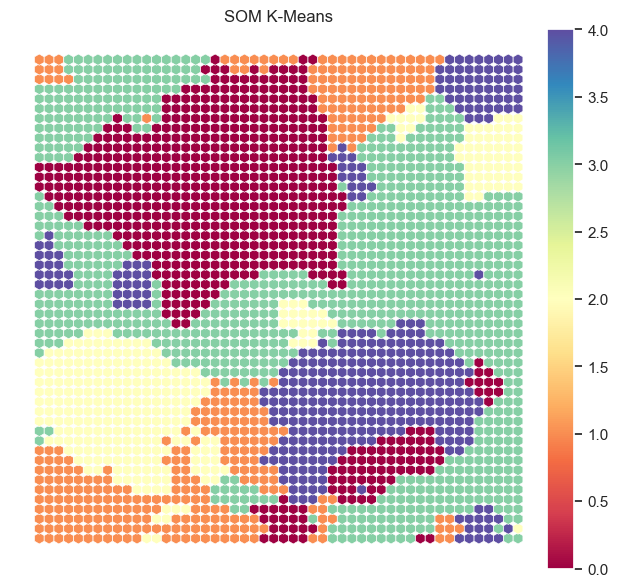

In [270]:
kmeans = KMeans(n_clusters=5, init='k-means++', n_init=20, random_state=42)
nodeclus_labels = kmeans.fit_predict(weights)
nodeclus_labels

kmeans_matrix = nodeclus_labels.reshape((M,N))

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(kmeans_matrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    kmeans_matrix,
                    label="SOM K-Means",
                    cmap=cm.Spectral,
                    )

In [271]:
# Check the nodes and and respective clusters
nodes = weights

df_nodes = pd.DataFrame(nodes, columns=perspective2)
df_nodes['label'] = nodeclus_labels

bmu_index = np.array([sm.winner(x) for x in data[perspective2].values])
som_final_labels = [kmeans_matrix[i[0]][i[1]] for i in bmu_index]

df_final = pd.concat([data_inversed,
                pd.Series(som_final_labels, name='label', index=data_inversed.index)], axis=1)

# Characterizing the final clusters
df_final[perspective2+['label']].groupby('label').mean()

,total_spend,spent_top_cuisine,diversity_cuisine_types,spent_main_food,spent_beverages_addons
label,,,,,
0,21.050512,0.934063,1.301444,0.914751,0.005763
1,98.070524,0.623697,3.113192,0.759473,0.180345
2,56.903251,0.390019,5.508044,0.703121,0.152239
3,25.376074,0.541098,2.659986,0.738987,0.100669
4,29.271849,0.827812,1.700502,0.114055,0.851310


In [272]:
df_final = pd.concat([data,
                pd.Series(som_final_labels, name='label', index=data.index)], axis=1)

# Compute SST (Total Sum of Squares)
sst = get_ss_2(df_final[perspective2])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = df_final[perspective2 + ["label"]].groupby(by='label').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(df_final)  # Total number of data points
k = df_final['label'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.6619
Adjusted R²: 0.6618


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\1726555062.py:8: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



#### Final Solution **(k=5)**

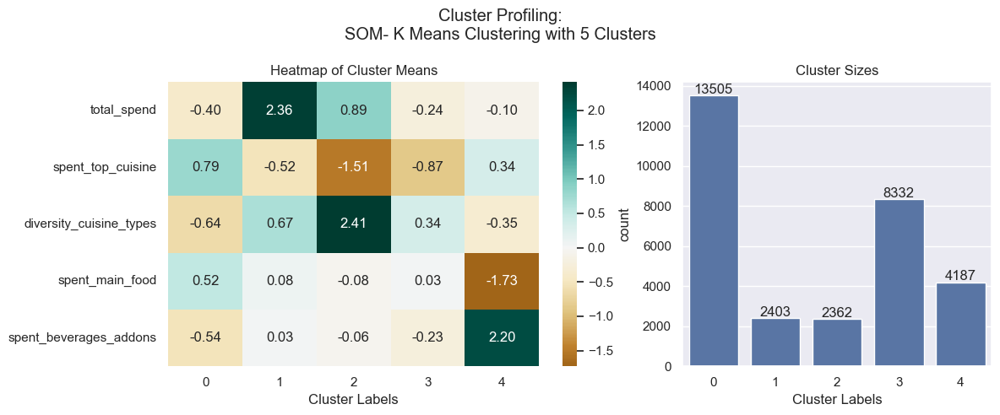

In [273]:
df_final = pd.concat([data,
                pd.Series(som_final_labels, name='label', index=data.index)], axis=1)

# Define figure and axes
fig, axes = plt.subplots(1, 2, figsize=(12, 5), width_ratios=[0.6, 0.4], tight_layout=True)

# Heatmap for cluster means
km_profile = df_final[perspective2 + ['label']].groupby('label').mean().T
sns.heatmap(km_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0])
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")

# Countplot for cluster sizes
sns.countplot(data=df_final, x='label', ax=axes[1])

# Annotate counts above bars
for bar in axes[1].patches:
    count = int(bar.get_height())  # Get the height of each bar
    axes[1].annotate(f"{count}", 
                     xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()),  # Position at the top of the bar
                     xytext=(0, 5),  # Offset text by 5 points
                     textcoords="offset points",
                     ha='center', va='center')

axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

# Add an overall title
fig.suptitle("Cluster Profiling:\nSOM- K Means Clustering with 5 Clusters")
plt.show()

### 4.2.4 Density Clustering

#### Mean Shift

In [274]:
# defines the size of the neighborhood around each data point when forming clusters
# It determines how far the algorithm will look to consider data points as part of the same cluster.
# A small bandwidth results in many small clusters (high granularity), while a large bandwidth results in fewer, broader clusters.
bandwidth = estimate_bandwidth(data[perspective2], quantile=0.1, random_state=1, n_jobs=-1)
bandwidth

1.3242616679607102

In [275]:
# Perform mean-shift clustering with bandwidth set using estimate_bandwidth
ms = MeanShift(bandwidth=bandwidth, bin_seeding=True, n_jobs=4)
ms_labels = ms.fit_predict(data[perspective2])

ms_n_clusters = len(np.unique(ms_labels))
print("Number of estimated clusters : %d" % ms_n_clusters)

Number of estimated clusters : 7


In [276]:
# Concatenating the labels to df
df_concat = pd.concat([data[perspective2], pd.Series(ms_labels, index=data.index, name="ms_labels")], axis=1)

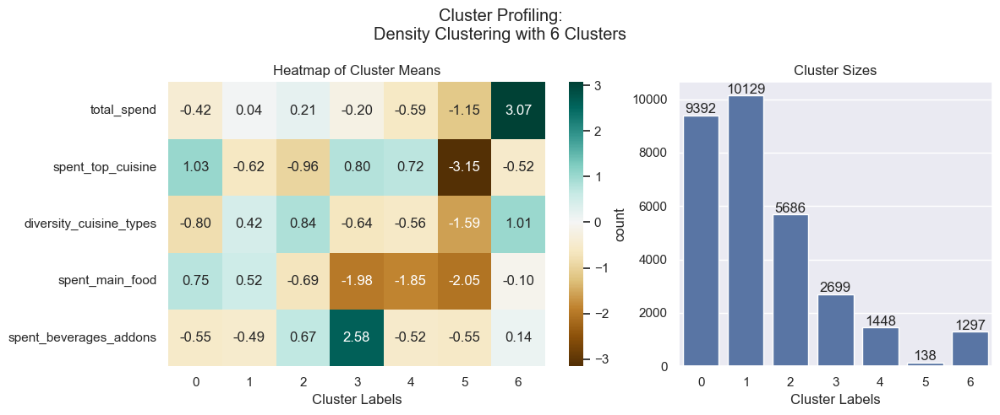

In [277]:
# Define figure and axes
fig, axes = plt.subplots(1, 2, figsize=(12, 5), width_ratios=[0.6, 0.4], tight_layout=True)

# Heatmap for cluster means
den_profile = df_concat[perspective2+['ms_labels']].groupby('ms_labels').mean().T
sns.heatmap(den_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0])
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")

# Countplot for cluster sizes
sns.countplot(data=df_concat, x='ms_labels', ax=axes[1])

# Annotate counts above bars
for bar in axes[1].patches:
    count = int(bar.get_height())  # Get the height of each bar
    axes[1].annotate(f"{count}", 
                     xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()),  # Position at the top of the bar
                     xytext=(0, 5),  # Offset text by 5 points
                     textcoords="offset points",
                     ha='center', va='center')

axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

# Add an overall title
fig.suptitle("Cluster Profiling:\nDensity Clustering with 6 Clusters")
plt.show()

In [278]:
# Computing the R^2 of the cluster solution
sst = get_ss_2(data[perspective2])  # get total sum of squares
ssw_labels = df_concat.groupby(by='ms_labels').apply(get_ss_2)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
print("Cluster solution with R^2 of %0.4f" % r2)

Cluster solution with R^2 of 0.6917


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\518408698.py:3: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



## 4.3 Perspective 3: Temporal Ordering Profile

Purpose: Analyze customer interactions with services over time, focusing on ordering habits, preferences, and patterns. This approach helps uncover distinct behavioral segments, allowing for more targeted and effective strategies that align with customer needs.

In [368]:
perspective3 = ['breakfast_orders', 'lunch_snack_orders', 'dinner_orders', 'night_orders', 'startweek_orders', 'endweek_orders']

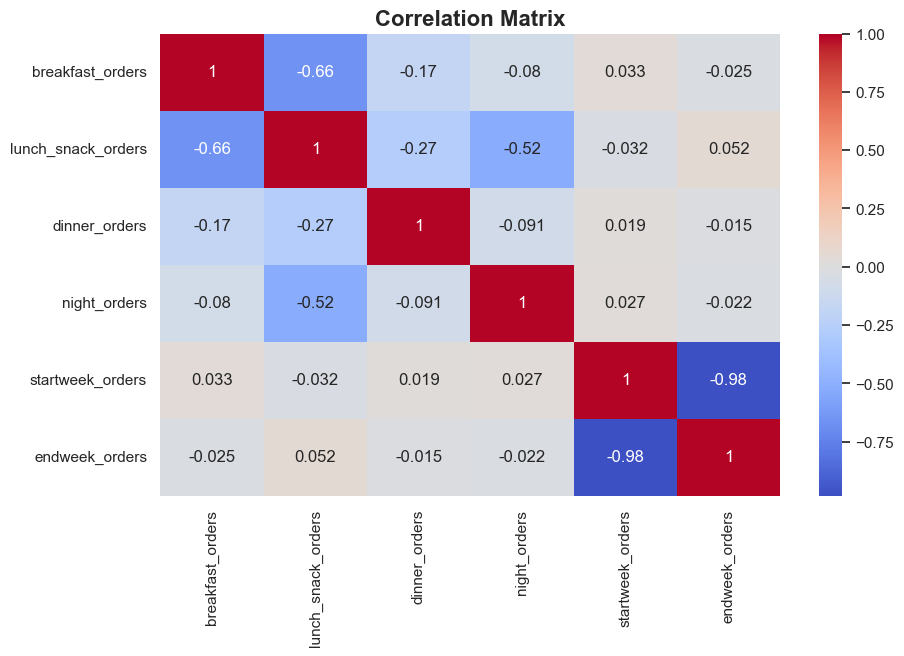

In [369]:
plt.figure(figsize=(10, 6))
sns.heatmap(data[perspective3].corr(), annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Matrix', fontsize=16, fontweight='bold')
plt.show()

We noticed a strong negative correlation between breakfast_orders and lunch_snack_orders and between lunch_snack_orders and night_orders, suggesting that customers ordering more during breakfast tend to order less during lunch/snack times and the ones who order more in lunch/snack times tend to order less in night_orders.

Weak correlations between most features (except breakfast_orders and lunch_snack_orders) suggest that the features are not redundant and could independently contribute to clustering.
The strong negative correlations (e.g., breakfast_orders vs. lunch_snack_orders) highlight clear behavioral differences, which could lead to well-defined clusters (e.g., "breakfast-heavy customers" vs. "lunch-heavy customers").

In [370]:
perspective3.remove('endweek_orders')

### 4.3.1 Hierarchical Clustering

#### R Squared

In [371]:
# hc_methods = ["ward", "complete", "average", "single"]

hc_methods = ["ward"]
max_nclus = 10

r2_hc = np.vstack([get_r2_hc(data[perspective3], 
                              link, 
                              max_nclus=max_nclus, 
                              min_nclus=1, 
                              dist="euclidean") 
                              for link in hc_methods])

C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\156999461.py:7: UserWarning:

The markers list has more values (4) than needed (1), which may not be intended.



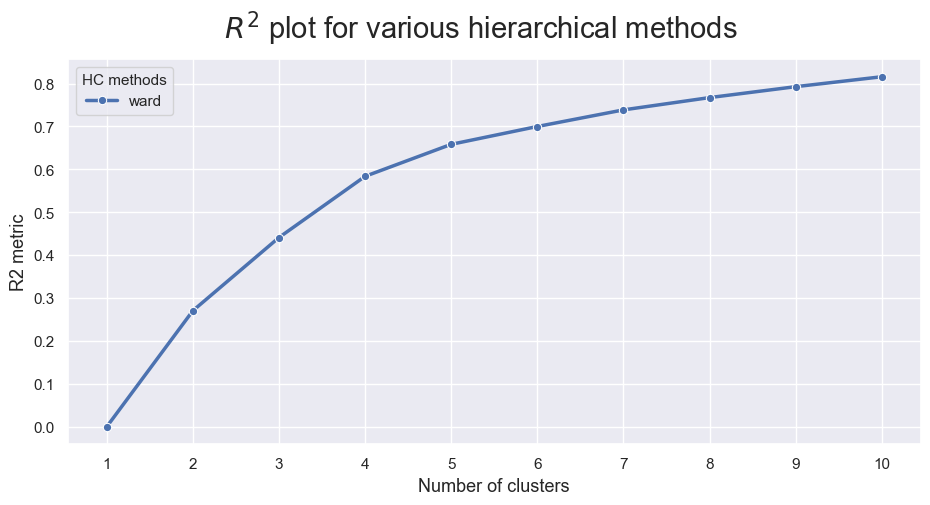

In [372]:
r2_hc_methods = pd.DataFrame(r2_hc.T, index=range(1, max_nclus + 1), columns=hc_methods)

sns.set()

# Plot data
fig = plt.figure(figsize=(11,5))
sns.lineplot(data=r2_hc_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
plt.legend(title="HC methods", title_fontsize=11)
plt.xticks(range(1, max_nclus + 1))
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)

fig.suptitle("$R^2$ plot for various hierarchical methods", fontsize=21)

plt.show()

#### Dendogram

In [373]:
# setting distance_threshold=0 and n_clusters=None ensures we compute the full tree
linkage = 'ward'
distance = 'euclidean'


hclust = AgglomerativeClustering(linkage=linkage, 
                                 metric=distance,
                                 distance_threshold=0,
                                 n_clusters=None)

hclust.fit_predict(data[perspective3])

array([30788, 30787, 24347, ...,     2,     1,     0], dtype=int64)

In [374]:
# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

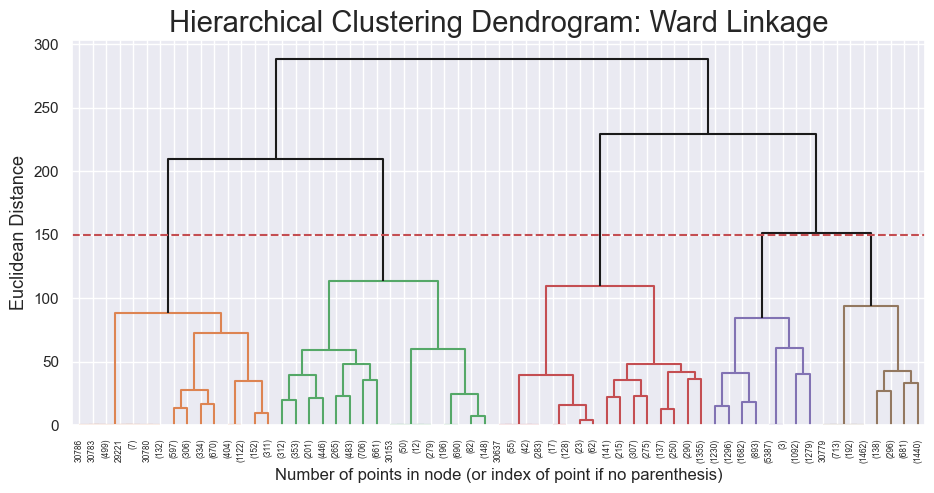

In [375]:
# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 150
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering Dendrogram: {linkage.title()} Linkage', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
plt.show()

#### Defining the number of Clusters

Number of clusters: 4
Average Silhouette Score: 0.43689163317518026

Cluster 0: Average Silhouette Score = 0.5307695867198666
Cluster 1: Average Silhouette Score = 0.21356432826604646
Cluster 2: Average Silhouette Score = 0.21928791943359457
Cluster 3: Average Silhouette Score = 0.4810902624386202


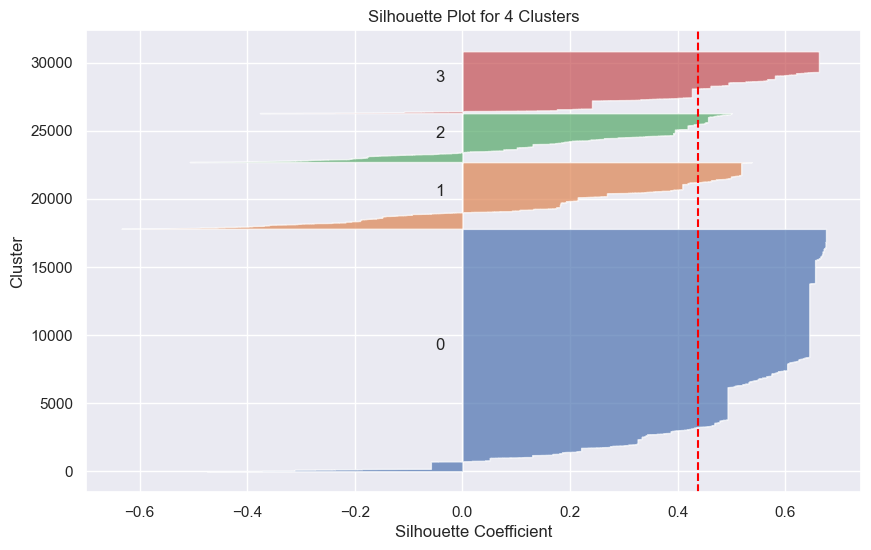

Calinski-Harabasz Index: 14391.615488228681
Davies-Bouldin Index: 0.9688097053537738

Number of clusters: 5
Average Silhouette Score: 0.38292393941501046

Cluster 0: Average Silhouette Score = 0.18818282752846602
Cluster 1: Average Silhouette Score = 0.3035329529380554
Cluster 2: Average Silhouette Score = 0.1799624415604421
Cluster 3: Average Silhouette Score = 0.4432205617718077
Cluster 4: Average Silhouette Score = 0.5225080794829536


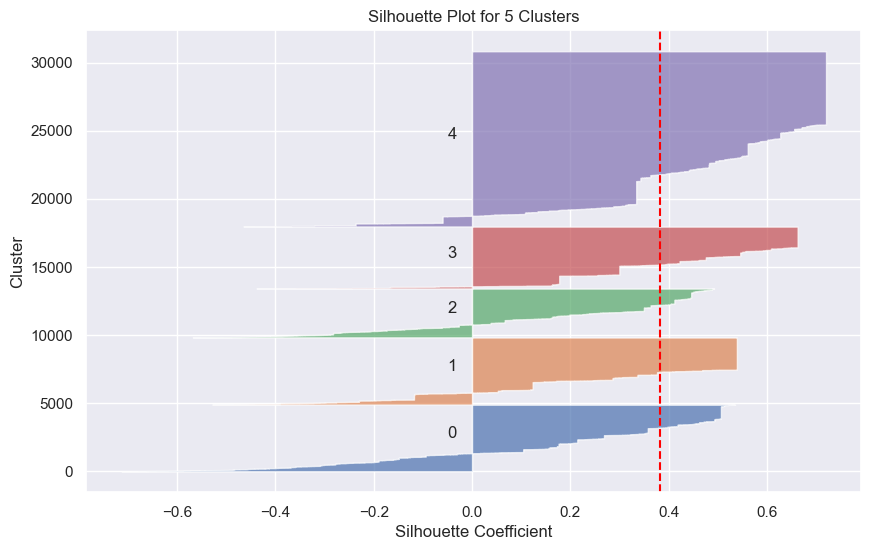

Calinski-Harabasz Index: 14829.25717947516
Davies-Bouldin Index: 0.9993611340521198

Number of clusters: 6
Average Silhouette Score: 0.3872826215896944

Cluster 0: Average Silhouette Score = 0.1738344506850156
Cluster 1: Average Silhouette Score = 0.30207852913563793
Cluster 2: Average Silhouette Score = 0.6120326019273824
Cluster 3: Average Silhouette Score = 0.40845299887975284
Cluster 4: Average Silhouette Score = 0.5222268215757035
Cluster 5: Average Silhouette Score = 0.10260468271204373


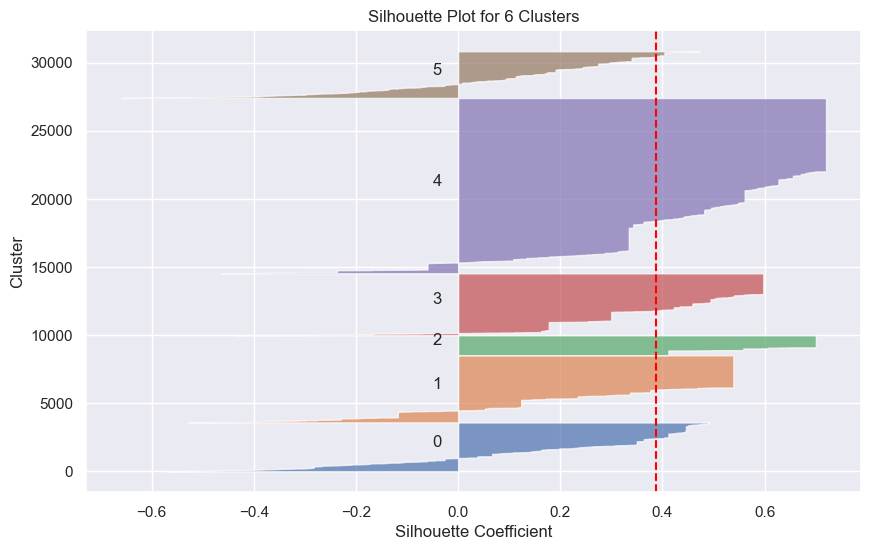

Calinski-Harabasz Index: 14358.172181604468
Davies-Bouldin Index: 1.0473303504842468

Number of clusters: 7
Average Silhouette Score: 0.39758770398357424

Cluster 0: Average Silhouette Score = 0.30207852913563793
Cluster 1: Average Silhouette Score = 0.4078649623444394
Cluster 2: Average Silhouette Score = 0.6120326019273824
Cluster 3: Average Silhouette Score = 0.20092468174890818
Cluster 4: Average Silhouette Score = 0.5167073043173611
Cluster 5: Average Silhouette Score = 0.10116892431531956
Cluster 6: Average Silhouette Score = 0.6900473481727942


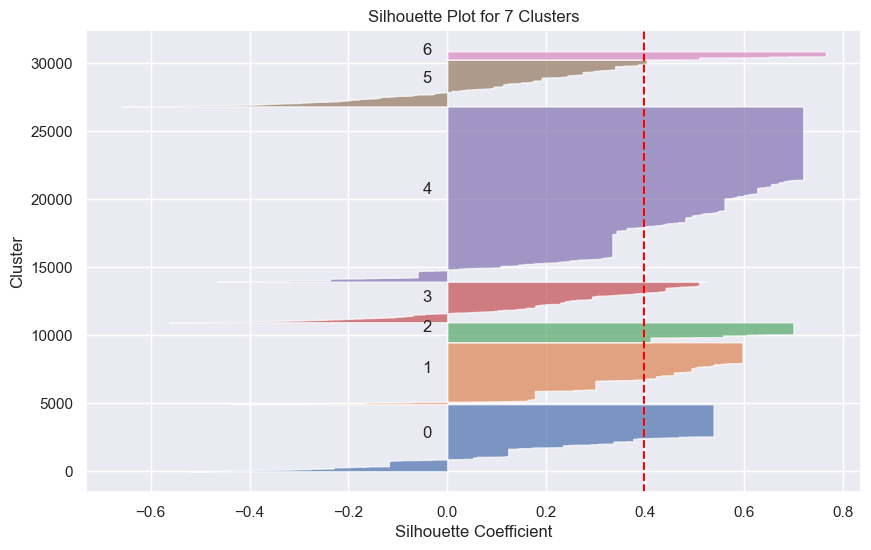

Calinski-Harabasz Index: 14496.771716063251
Davies-Bouldin Index: 1.0015929919268867



In [376]:
# Define the range of clusters to test
cluster_range = [4, 5, 6, 7]

# Create a dictionary to store results for each number of clusters
cluster_results = {}

# Run Agglomerative Clustering for each value in the cluster range
for n_clusters in cluster_range:
    hc_model = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    labels = hc_model.fit_predict(data[perspective3])
    silhouette_analysis(data[perspective3], labels, n_clusters)
    evaluate_clustering_metrics(data[perspective3], labels)
    cluster_results[n_clusters] = labels  # Store labels for each n_clusters

# Convert results to a DataFrame for easier visualization
results_df = pd.DataFrame(cluster_results, index=data.index)
results_df.columns = [f'Cluster_{n}' for n in cluster_range]

In [377]:
results_df

,Cluster_4,Cluster_5,Cluster_6,Cluster_7
0,0,4,4,4
1,0,1,1,0
2,0,1,1,0
3,0,4,4,4
4,3,3,3,1
...,...,...,...,...
31883,0,1,1,0
31884,0,1,1,0
31885,3,3,3,1
31886,0,1,1,0


##### Comparison between 4 and 5

In [378]:
pd.crosstab(
    pd.Series(results_df['Cluster_5'], name='Cluster_5', index=data.index),
    pd.Series(results_df['Cluster_4'], name='Cluster_4', index=data.index),)

Cluster_4,0,1,2,3
Cluster_5,,,,
0,0,4885,0,0
1,4923,0,0,0
2,0,0,3581,0
3,0,0,0,4538
4,12862,0,0,0


#### Final Solution **(k=5)**

In [379]:
data_concat = pd.concat([
    data_inversed[perspective3], 
    pd.Series(results_df['Cluster_5'], name='labels', index=data_inversed.index)
    ], 
    axis=1)
data_concat.groupby('labels').mean()

,breakfast_orders,lunch_snack_orders,dinner_orders,night_orders,startweek_orders
labels,,,,,
0,0.225757,0.160464,0.006249,0.607529,0.676237
1,0.179810,0.791379,0.000470,0.000309,0.212146
2,0.080504,0.372184,0.502999,0.044314,0.672044
3,0.826420,0.168718,0.002175,0.002687,0.756356
4,0.029615,0.952469,0.015554,0.002361,0.795273


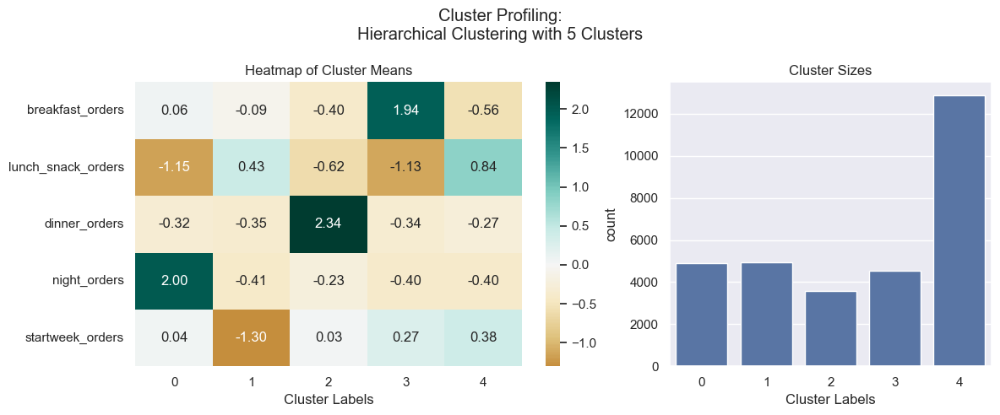

In [380]:
label_counts = None 

fig, axes = plt.subplots(1,2, figsize=(12,5), width_ratios=[.6,.4], tight_layout=True)

data_concat = pd.concat([
    data[perspective3], 
    pd.Series(results_df['Cluster_5'], name='labels', index=data.index)
    ], 
    axis=1)

hc_profile = data_concat.groupby('labels').mean().T

sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0]
            )
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")


sns.countplot(data_concat, x='labels', ax=axes[1])
axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

fig.suptitle("Cluster Profiling:\nHierarchical Clustering with 5 Clusters")
plt.show()

In [381]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(data_concat[perspective3])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = data_concat[perspective3 + ["labels"]].groupby(by='labels').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(data_concat)  # Total number of data points
k = data_concat['labels'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.6583
Adjusted R²: 0.6583


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\3797923497.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



### 4.3.2 KMeans

#### Inertia

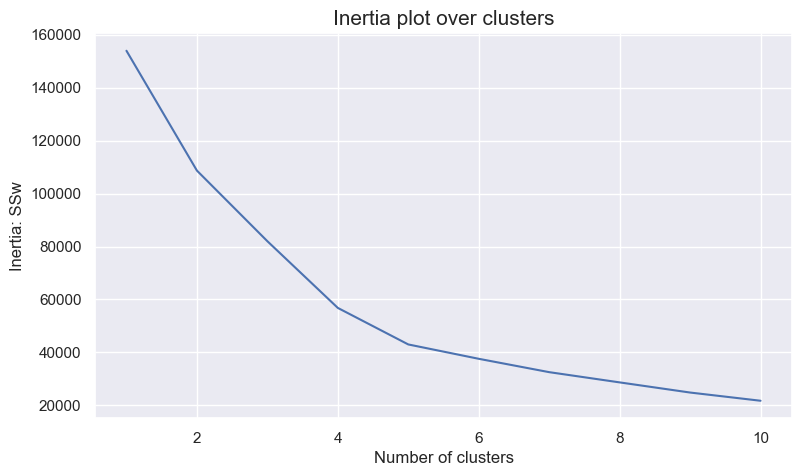

In [382]:
range_clusters = range(1, 11)

inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit(data[perspective3])
    inertia.append(kmclust.inertia_)

# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(range_clusters, inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

#### Defining the number of Clusters

In [383]:
# Storing average silhouette metric
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(data[perspective3])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(data[perspective3], cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(data[perspective3], cluster_labels)

For n_clusters = 2, the average silhouette_score is : 0.38520964615116143
For n_clusters = 3, the average silhouette_score is : 0.4259665256208058
For n_clusters = 4, the average silhouette_score is : 0.47197742069552723
For n_clusters = 5, the average silhouette_score is : 0.4354359010810789
For n_clusters = 6, the average silhouette_score is : 0.43391017187611797
For n_clusters = 7, the average silhouette_score is : 0.4509454624504591
For n_clusters = 8, the average silhouette_score is : 0.46840957742690165
For n_clusters = 9, the average silhouette_score is : 0.47757244563094536
For n_clusters = 10, the average silhouette_score is : 0.4989189191439136


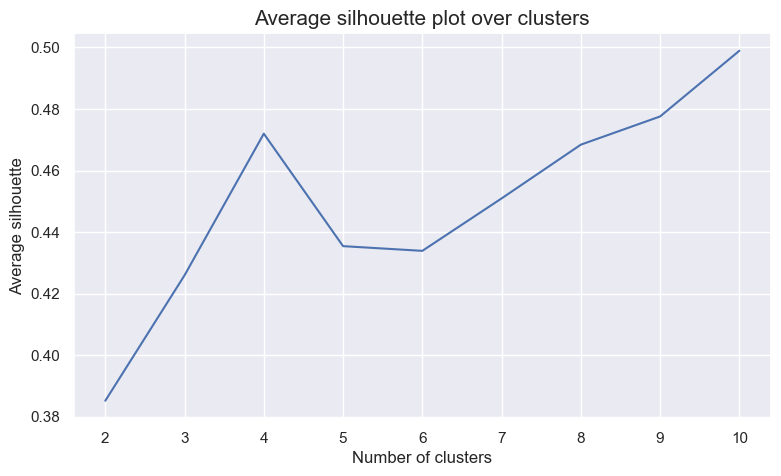

In [384]:
# The average silhouette plot
# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(range_clusters[1:], 
         avg_silhouette)    

plt.ylabel("Average silhouette")
plt.xlabel("Number of clusters")
plt.title("Average silhouette plot over clusters", size=15)
plt.show()

In [385]:
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(data[perspective3])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    print(f"For n_clusters = {nclus}, the metrics are :")
    metrics_avg = evaluate_clustering_metrics(data[perspective3], cluster_labels)

For n_clusters = 2, the metrics are :
Calinski-Harabasz Index: 12822.793181584697
Davies-Bouldin Index: 1.3984749148844338

For n_clusters = 3, the metrics are :
Calinski-Harabasz Index: 13503.078206063814
Davies-Bouldin Index: 1.1182069161522348

For n_clusters = 4, the metrics are :
Calinski-Harabasz Index: 17547.590269751803
Davies-Bouldin Index: 0.852865330088028

For n_clusters = 5, the metrics are :
Calinski-Harabasz Index: 19852.936243062195
Davies-Bouldin Index: 0.8410330316802426

For n_clusters = 6, the metrics are :
Calinski-Harabasz Index: 19060.622446014735
Davies-Bouldin Index: 0.908892650774245

For n_clusters = 7, the metrics are :
Calinski-Harabasz Index: 19142.656778143417
Davies-Bouldin Index: 0.8845235112271459

For n_clusters = 8, the metrics are :
Calinski-Harabasz Index: 19212.224993345964
Davies-Bouldin Index: 0.8063945716281502

For n_clusters = 9, the metrics are :
Calinski-Harabasz Index: 19999.240666329857
Davies-Bouldin Index: 0.8587949457306686

For n_clus

##### Cluster = 4

In [386]:
kmclust_4 = KMeans(n_clusters=4, init='k-means++', n_init=15, random_state=1)
kmclust_4.fit(data[perspective3])
labels_4 = kmclust_4.predict(data[perspective3])

Number of clusters: 4
Average Silhouette Score: 0.47197742069552723

Cluster 0: Average Silhouette Score = 0.33131856057724457
Cluster 1: Average Silhouette Score = 0.5394368767703118
Cluster 2: Average Silhouette Score = 0.385999569570816
Cluster 3: Average Silhouette Score = 0.4009739825656814


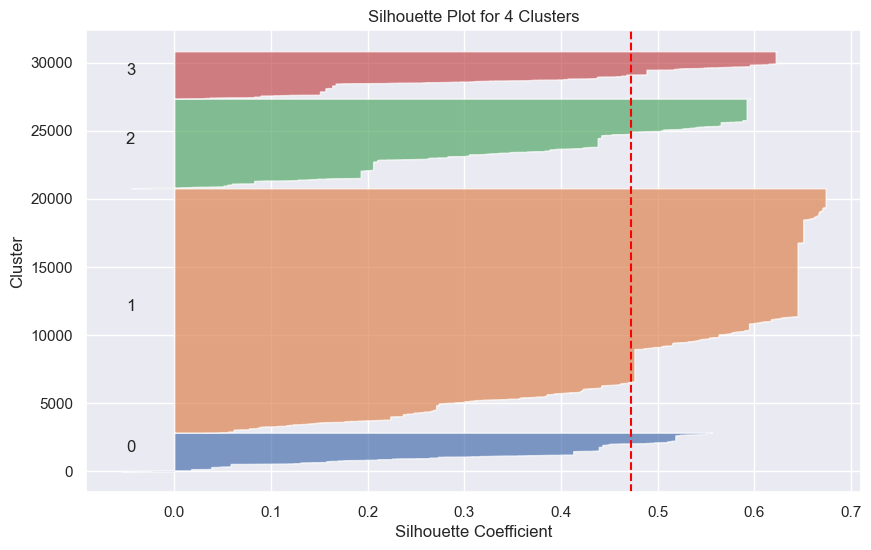

In [387]:
silhouette_analysis(data[perspective3], labels_4, 4)

In [388]:
evaluate_clustering_metrics(data[perspective3], labels_4)

Calinski-Harabasz Index: 17547.590269751803
Davies-Bouldin Index: 0.852865330088028



##### Cluster = 5

In [389]:
kmclust_5 = KMeans(n_clusters=5, init='k-means++', n_init=15, random_state=1)
kmclust_5.fit(data[perspective3])
labels_5 = kmclust_5.predict(data[perspective3])

Number of clusters: 5
Average Silhouette Score: 0.4354359010810789

Cluster 0: Average Silhouette Score = 0.3330166586325378
Cluster 1: Average Silhouette Score = 0.39652776775714554
Cluster 2: Average Silhouette Score = 0.35760686232846617
Cluster 3: Average Silhouette Score = 0.3900748857289913
Cluster 4: Average Silhouette Score = 0.5371569023341598


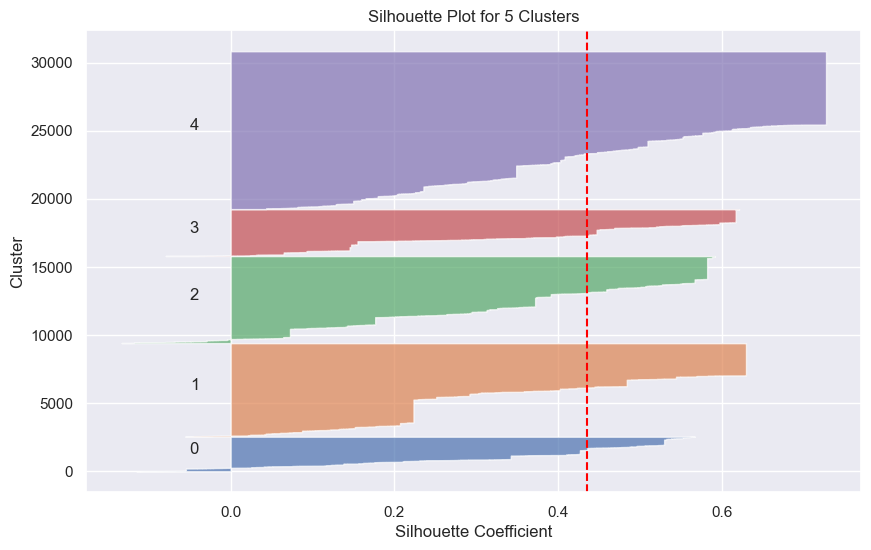

In [390]:
silhouette_analysis(data[perspective3], labels_5, 5)

In [391]:
evaluate_clustering_metrics(data[perspective3], labels_5)

Calinski-Harabasz Index: 19852.936243062195
Davies-Bouldin Index: 0.8410330316802426



##### Comparison between 4 and 5

In [392]:
pd.crosstab(
    pd.Series(labels_5, name='labels_5', index=data.index),
    pd.Series(labels_4, name='labels_4', index=data.index),)

labels_4,0,1,2,3
labels_5,,,,
0,2535,0,0,0
1,120,6483,210,42
2,6,55,6321,0
3,2,0,0,3428
4,166,11384,37,0


#### Final Solution **(k=5)**

In [393]:
data_concat = pd.concat([
    data_inversed[perspective3], 
    pd.Series(labels_5, name='labels', index=data_inversed.index)
    ], 
    axis=1)
data_concat.groupby('labels').mean()

,breakfast_orders,lunch_snack_orders,dinner_orders,night_orders,startweek_orders
labels,,,,,
0,0.049134,0.304108,0.608093,0.038665,0.678650
1,0.051032,0.899986,0.018037,0.010814,0.245426
2,0.747922,0.196057,0.007398,0.048623,0.701612
3,0.146555,0.091562,0.011619,0.750263,0.691751
4,0.056721,0.908200,0.025181,0.009899,0.877050


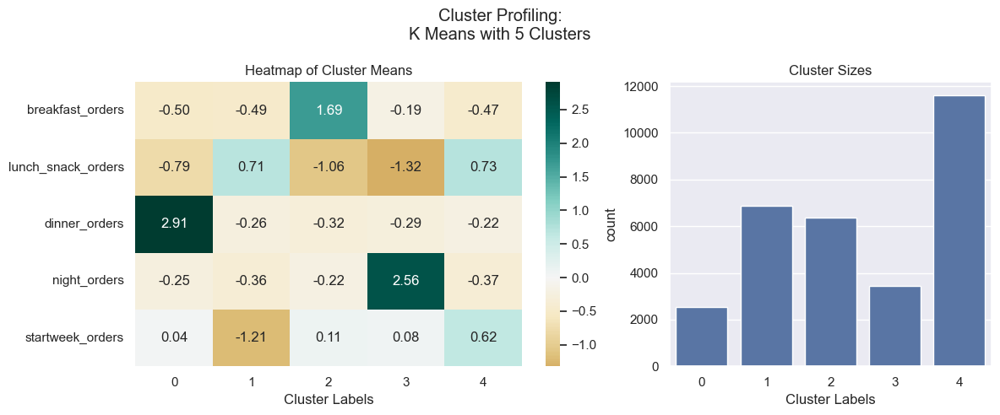

In [394]:
label_counts = None 

fig, axes = plt.subplots(1,2, figsize=(12,5), width_ratios=[.6,.4], tight_layout=True)

data_concat = pd.concat([
    data[perspective3], 
    pd.Series(labels_5, name='labels', index=data.index)
    ], 
    axis=1)

hc_profile = data_concat.groupby('labels').mean().T

sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0]
            )
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")


sns.countplot(data_concat, x='labels', ax=axes[1])
axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

fig.suptitle("Cluster Profiling:\nK Means with 5 Clusters")
plt.show()

In [395]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(data_concat[perspective3])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = data_concat[perspective3 + ["labels"]].groupby(by='labels').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(data_concat)  # Total number of data points
k = data_concat['labels'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.7206
Adjusted R²: 0.7206


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\3797923497.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



### 4.3.3 SOM

#### Training

In [396]:
neighborhood_function = 'gaussian' # Defines how neighboring neurons affect each other during training. A 'gaussian' function is used here, meaning the influence decreases with distance.
topology = 'rectangular' 
n_feats = len(perspective3)
learning_rate = 0.7

som_data = data[perspective3].values
M, N = calculate_grid_size(len(som_data), aspect_ratio=1)  # Square grid
print(f"Grid size: M={M}, N={N}")

sm = MiniSom(M, N,              # 10x10 map size
             n_feats,           # Number of the elements of the vectors in input.
             learning_rate=learning_rate, 
             topology=topology, 
             neighborhood_function=neighborhood_function, 
             activation_distance='euclidean',
             random_seed=42
             )

# Initializes the weights of the SOM picking random samples from data.
sm.random_weights_init(som_data) 


print("Before training:")
print("QE", np.round(sm.quantization_error(som_data),4)) # Quantization Error (QE): Measures how well the SOM represents the input data. It calculates the average distance between input vectors and their best-matching units (BMUs).
print("TE", np.round(sm.topographic_error(som_data),4)) # Topographic Error (TE): Measures how well the SOM preserves the topological relationships in the input data.

# Trains the SOM using all the vectors in data sequentially
# minisom does not distinguish between unfolding and fine tuning phase;

sm.train_batch(som_data, 150000)

print("After training:")
print("QE", np.round(sm.quantization_error(som_data),4))
print("TE", np.round(sm.topographic_error(som_data),4))

Grid size: M=30, N=30
Before training:


c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\minisom.py:513: RuntimeWarning:

invalid value encountered in sqrt



QE 0.081
TE 0.9996
After training:
QE 0.0281
TE 0.1372


We started with a QE of 0.081, reflecting the mismatch between input data and untrained weights, and a very high value of TE (0.9996), indicating poor topology preservation. This is expected with untrained weights.

After training, we observe a **significant improvement in QE**, showing that the SOM has learned to represent the input data better. The final QE value is 0.0281 (<0.2), which is considered good. This indicates that the neurons are now closer to the input data points, resulting in improved cluster quality.

Additionally, we observe a **substantial improvement in TE**, reflecting the trained SOM's ability to preserve topology well. The final TE value is 0.1372 (<0.3), which is also considered good. This indicates better preservation of the data's topological structure.

The grid size, set at M=30 and N=30, was determined using a rule of thumb that suggests the number of neurons should be approximately 5* sqrt(N) where N is the number of input data points.

#### Hexagons heatmap

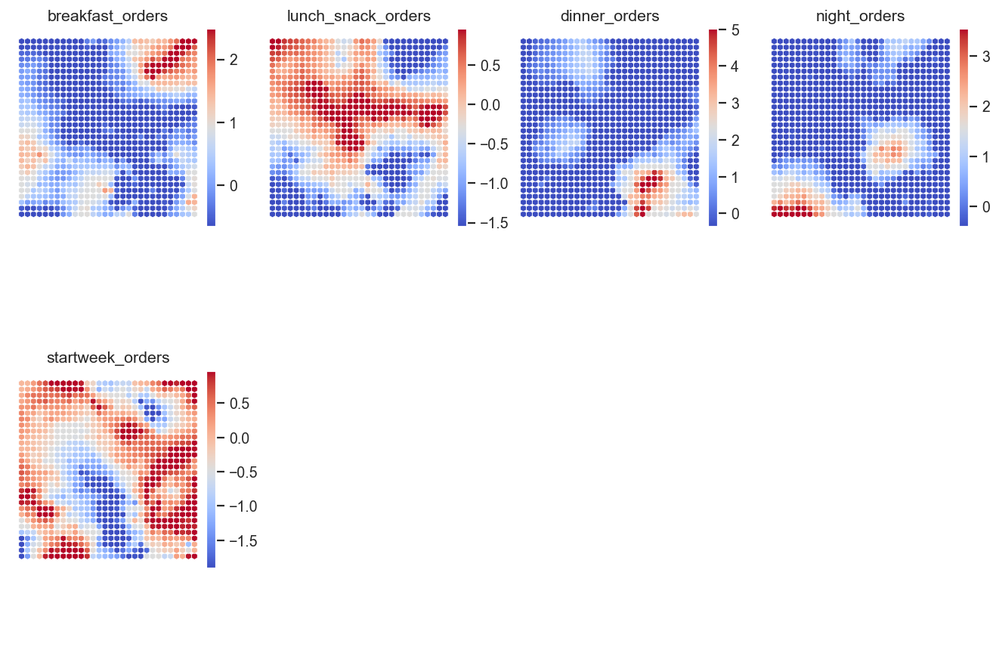

In [397]:
weights = sm.get_weights()

figsize=(10,7)
fig = plt.figure(figsize=figsize, constrained_layout=True, dpi=128, )

subfigs = fig.subfigures(2,4,wspace=.15)

colornorm = mpl_colors.Normalize(vmin=np.min(weights), vmax=np.max(weights))

for cpi, sf in zip(range(len(perspective3)), subfigs.flatten()):
    
    matrix_vals = weights[:,:,cpi]
    vext = np.max(np.abs([np.min(matrix_vals), np.max(matrix_vals)]))
    colornorm = mpl_colors.Normalize(vmin=np.min(matrix_vals), vmax=np.max(matrix_vals))
    # colornorm = mpl_colors.CenteredNorm(vcenter=0, halfrange=vext)


    sf = plot_hexagons(sm, sf, 
                    colornorm,
                    matrix_vals,
                    label=perspective3[cpi],
                    cmap=cm.coolwarm,
                    )

**Distinct Meal Preferences**
- Clusters for breakfast, lunch/snacks, dinner and night orders are clearly separated, suggesting distinct customer segments with strong preferences for specific meal times.

**High Spenders**
- The total_spend heatmap highlights a few concentrated clusters of high-spending customers. These align partially with frequent order cluster.

**Order Frequency vs Spending**
- Clusters with high total_orders do not completely align with high total_spend, suggesting that frequent orderers are not necessarily high spenders, emphasizing differing customer behaviors (e.g., frequent small orders vs infrequent large orders).

**Lunch/Snack Dominance**
- The lunch/snack_orders heatmap shows broader distribution, suggesting that this is the most commonly ordered meal, with overlapping behaviors compared to other meal types.

#### U-Matrix

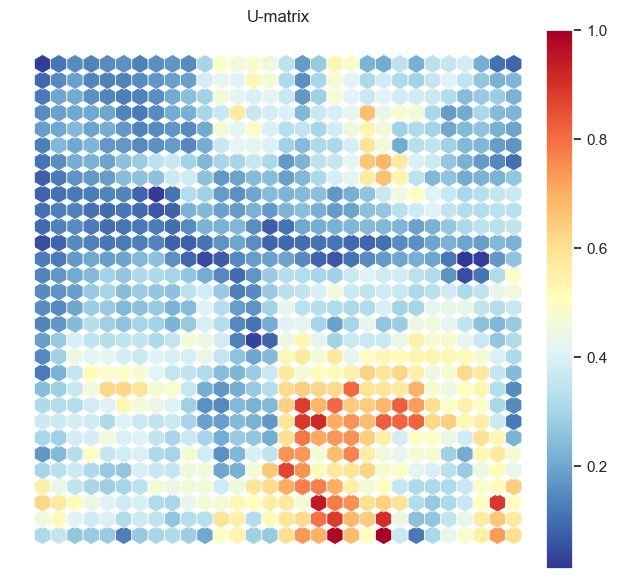

In [398]:
umatrix = sm.distance_map(scaling='mean')
fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=np.min(umatrix), vmax=np.max(umatrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    umatrix,
                    label="U-matrix",
                    cmap=cm.RdYlBu_r
                    )

The U-Matrix shows the distances between neighboring neurons, giving us a sense of how the data clusters. 

**Insights:**

The large blue areas suggest that **many data points are similar**, with smooth transitions across the grid. In contrast, the red and yellow areas highlight regions where there are sharp separations, pointing to well-defined clusters. Some small, isolated red spots indicate **unique groups with distinct behaviors**, likely representing niche patterns. Overall, the **map’s smoothness suggests the data has subtle variations rather than strong, distinct segments, leading to softer clustering boundaries**.

#### Hit Map

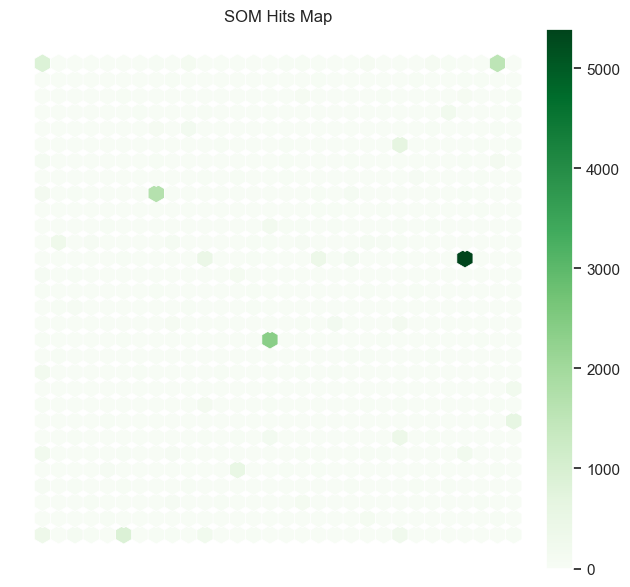

In [399]:
hitsmatrix = sm.activation_response(data[perspective3].values)

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hitsmatrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    hitsmatrix,
                    label="SOM Hits Map",
                    cmap=cm.Greens
                    )

**Insights**

This SOM Hits Map shows a **highly uneven distribution of data points across the grid**. The dense dark green regions indicate neurons that capture a large number of data points, suggesting that these areas represent dominant or highly common patterns in the dataset. However, this concentration might indicate over-clustering in those regions, which could mask finer distinctions.

The lighter green and empty areas suggest that some neurons are underutilized or not capturing any data, pointing to potential inefficiencies in the grid size or feature representation. This imbalance raises concerns that the SOM might not fully capture the diversity of the data, focusing more on dominant clusters while neglecting smaller, niche behaviors.

In [400]:
bmus = np.array([sm.winner(x) for x in som_data])  # (row, col) for each data point
weights = sm.get_weights().reshape((M*N),len(perspective3))
weights.shape

(900, 5)

#### 4.3.3.1 SOM - Hierarchical

In [401]:
# setting distance_threshold=0 and n_clusters=None ensures we compute the full tree
linkage = 'ward'
distance = 'euclidean'


hclust = AgglomerativeClustering(linkage=linkage, 
                                 metric=distance,
                                 distance_threshold=0,
                                 n_clusters=None)

hclust.fit_predict(weights)

array([672, 638, 477, 665, 652, 719, 661, 481, 483, 755, 814, 742, 701,
       651, 710, 713, 655, 784, 875, 756, 841, 869, 752, 854, 753, 728,
       746, 508, 885, 889, 459, 833, 377, 767, 586, 821, 456, 825, 569,
       873, 468, 550, 611, 476, 859, 837, 819, 829, 852, 857, 684, 745,
       657, 798, 560, 556, 729, 695, 768, 881, 658, 557, 781, 461, 535,
       590, 749, 467, 543, 715, 730, 612, 659, 736, 463, 740, 741, 660,
       696, 792, 797, 563, 774, 567, 613, 589, 643, 534, 716, 708, 541,
       779, 486, 645, 370, 739, 703, 845, 656, 621, 511, 847, 721, 545,
       787, 603, 780, 835, 738, 757, 759, 604, 714, 514, 627, 769, 633,
       577, 683, 562, 806, 799, 705, 646, 610, 592, 673, 570, 510, 839,
       460, 681, 469, 521, 537, 516, 484, 704, 680, 707, 357, 853, 503,
       725, 639, 891, 588, 726, 682, 482, 860, 426, 546, 551, 631, 524,
       505, 823, 843, 763, 499, 871, 876, 478, 529, 552, 328, 625, 724,
       776, 553, 640, 581, 650, 720, 512, 766, 564, 647, 674, 54

Number of clusters: 4
Average Silhouette Score: 0.45382218607849434

Cluster 0: Average Silhouette Score = 0.47585997404740615
Cluster 1: Average Silhouette Score = 0.48078383859704704
Cluster 2: Average Silhouette Score = 0.3741621303276084
Cluster 3: Average Silhouette Score = 0.42277111902723885


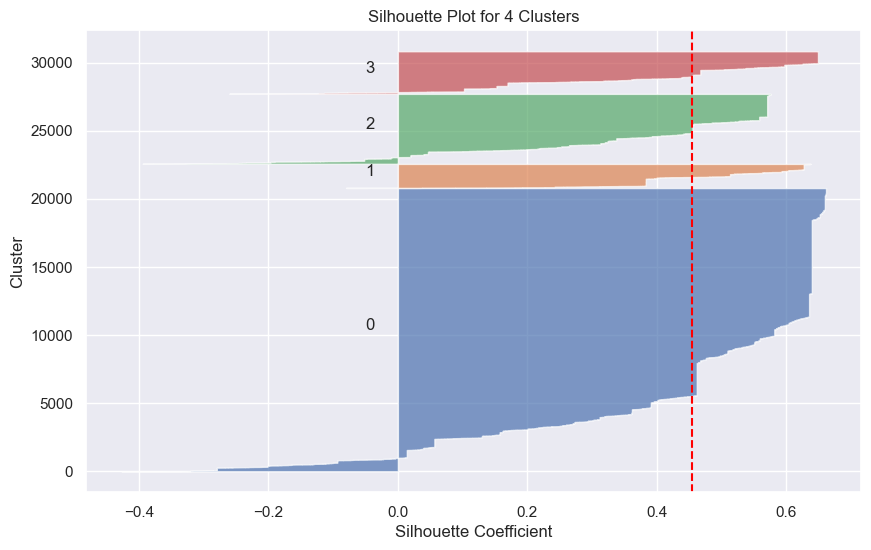

Calinski-Harabasz Index: 14653.4818623641
Davies-Bouldin Index: 0.8732411093354675

Number of clusters: 5
Average Silhouette Score: 0.37246797914096746

Cluster 0: Average Silhouette Score = 0.4055060744613149
Cluster 1: Average Silhouette Score = 0.35256599324921967
Cluster 2: Average Silhouette Score = 0.3322120881002758
Cluster 3: Average Silhouette Score = 0.4100027979642121
Cluster 4: Average Silhouette Score = 0.46192317627873236


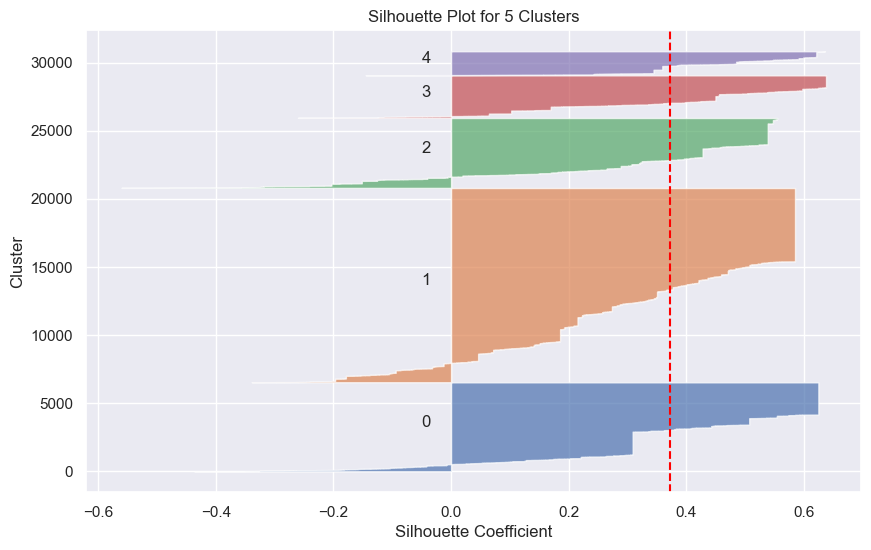

Calinski-Harabasz Index: 15715.70100549496
Davies-Bouldin Index: 0.9449959186006167

Number of clusters: 6
Average Silhouette Score: 0.3579874672968591

Cluster 0: Average Silhouette Score = 0.3133525255661552
Cluster 1: Average Silhouette Score = 0.23442540955011218
Cluster 2: Average Silhouette Score = 0.319164716203428
Cluster 3: Average Silhouette Score = 0.3973132951815109
Cluster 4: Average Silhouette Score = 0.5321946636765758
Cluster 5: Average Silhouette Score = 0.24596242355387496


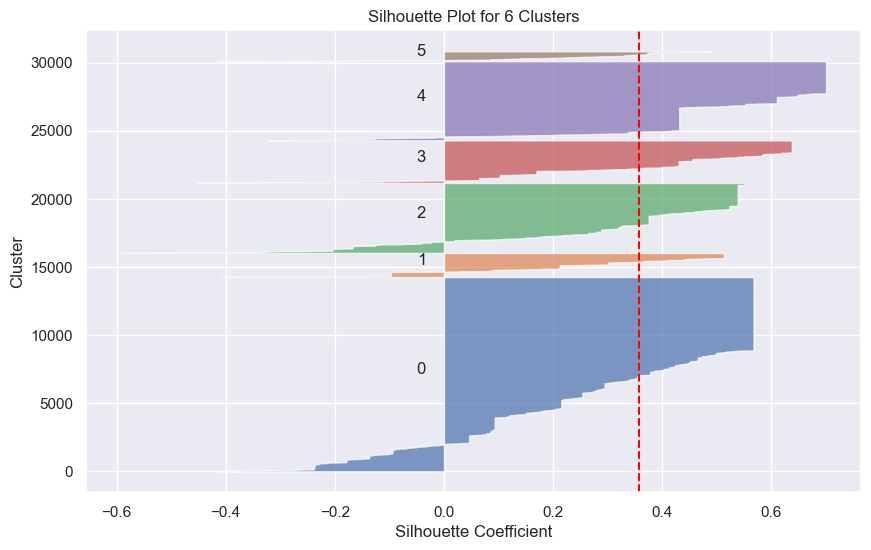

Calinski-Harabasz Index: 13690.506697176748
Davies-Bouldin Index: 1.00843685907081

Number of clusters: 7
Average Silhouette Score: 0.38030606700761

Cluster 0: Average Silhouette Score = 0.17581256209287327
Cluster 1: Average Silhouette Score = 0.23442540955011218
Cluster 2: Average Silhouette Score = 0.5288904466549375
Cluster 3: Average Silhouette Score = 0.3843304789735413
Cluster 4: Average Silhouette Score = 0.4977786568481886
Cluster 5: Average Silhouette Score = 0.2125255907253652
Cluster 6: Average Silhouette Score = 0.22332911559886806


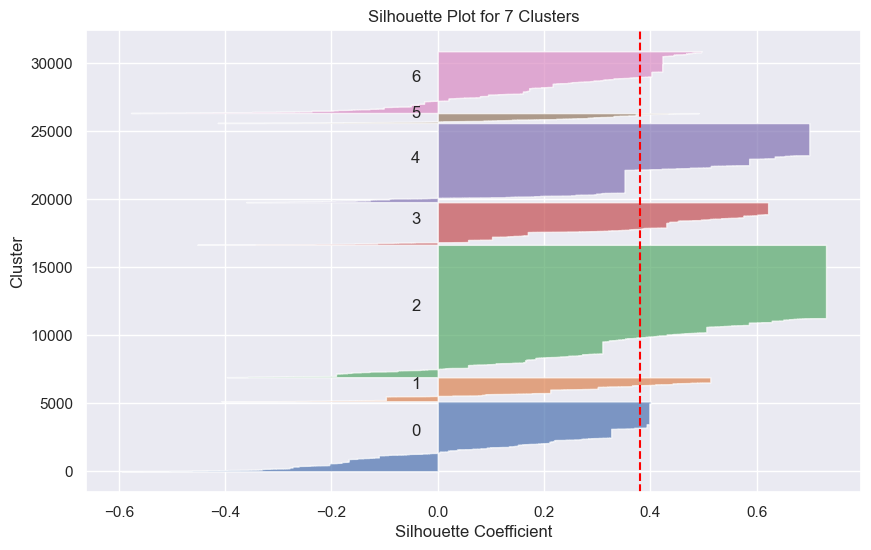

Calinski-Harabasz Index: 14077.41942366336
Davies-Bouldin Index: 1.1016583130670443



In [402]:
# Define the range of clusters to test
cluster_range = [4, 5, 6, 7]


# Run Agglomerative Clustering for each value in the cluster range
for n_clusters in cluster_range:
    hc_model = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    nodeclus_labels = hc_model.fit_predict(weights)
    hclust_matrix = nodeclus_labels.reshape((M,N))

    bmu_index = np.array([sm.winner(x) for x in data[perspective3].values])
    som_final_labels = [hclust_matrix[i[0]][i[1]] for i in bmu_index]

    df_final = pd.concat([data,
                    pd.Series(som_final_labels, name='label', index=data.index)], axis=1)
    
    silhouette_analysis(df_final[perspective3], np.array(som_final_labels), n_clusters)
    evaluate_clustering_metrics(df_final[perspective3], np.array(som_final_labels))

In [403]:
# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

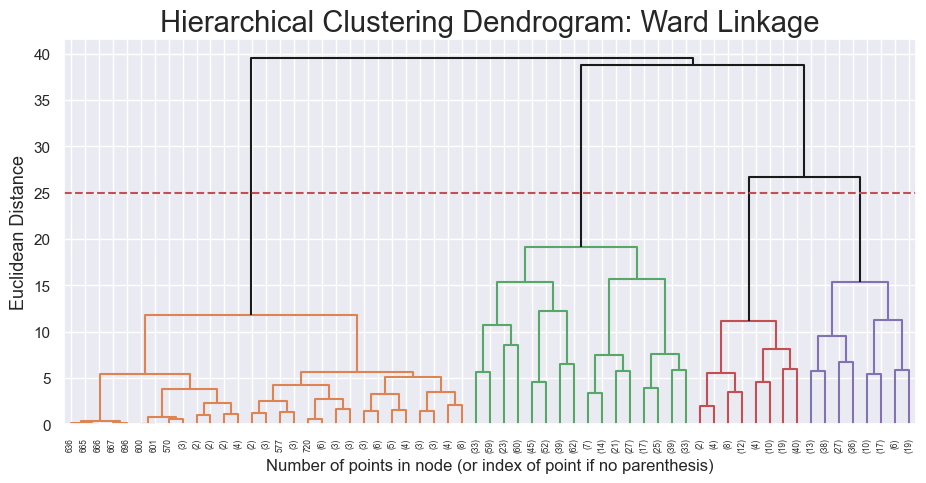

In [404]:
# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 25
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering Dendrogram: {linkage.title()} Linkage', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
plt.show()

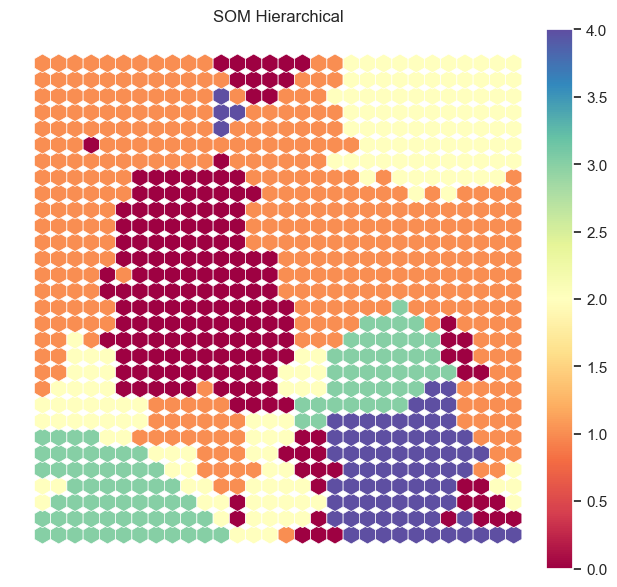

In [405]:
# Perform Hierarchical clustering on top of the MxN units 
hierclust = AgglomerativeClustering(n_clusters=5, linkage='ward')
nodeclus_labels = hierclust.fit_predict(weights)
hclust_matrix = nodeclus_labels.reshape((M,N))
figsize=(10,7)
fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hclust_matrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    hclust_matrix,
                    label="SOM Hierarchical",
                    cmap=cm.Spectral,
                    )

The map provides a clear and structured view of the dataset's segmentation. The clear boundaries between most clusters show that the data has strong separability, but there are a few transition areas where boundaries are less sharp, suggesting some overlap or gradual shifts in behavior. 

In [406]:
# Check the nodes and and respective clusters
nodes = weights

df_nodes = pd.DataFrame(nodes, columns=perspective3)
df_nodes['label'] = nodeclus_labels

bmu_index = np.array([sm.winner(x) for x in data[perspective3].values])
som_final_labels = [hclust_matrix[i[0]][i[1]] for i in bmu_index]

df_final = pd.concat([data_inversed,
                pd.Series(som_final_labels, name='label', index=data_inversed.index)], axis=1)

# Characterizing the final clusters
df_final[perspective3+['label']].groupby('label').mean()

,breakfast_orders,lunch_snack_orders,dinner_orders,night_orders,startweek_orders
label,,,,,
0,0.034756,0.912524,0.046395,0.006324,0.268897
1,0.121010,0.834928,0.026933,0.017128,0.841915
2,0.776443,0.107383,0.004256,0.085012,0.609002
3,0.136980,0.059403,0.029674,0.773944,0.729914
4,0.026189,0.248017,0.705822,0.019972,0.715117


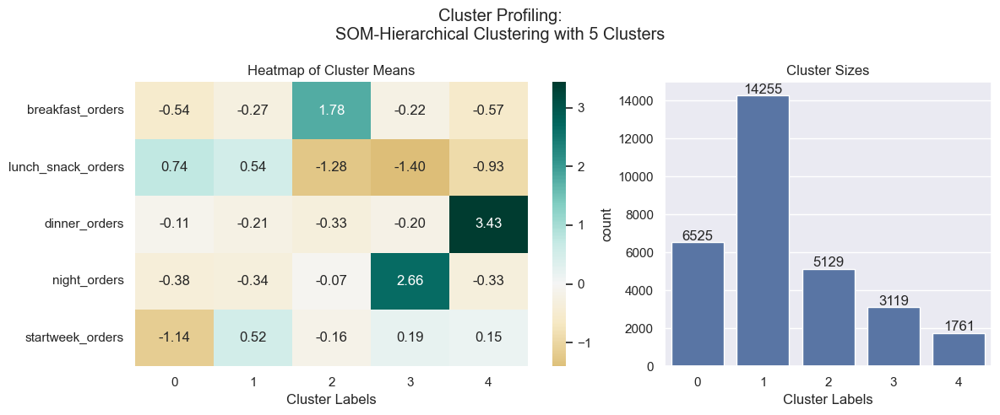

In [407]:
# Define figure and axes
fig, axes = plt.subplots(1, 2, figsize=(12, 5), width_ratios=[0.6, 0.4], tight_layout=True)

df_final = pd.concat([data,
                pd.Series(som_final_labels, name='label', index=data.index)], axis=1)

# Heatmap for cluster means
hc_profile = df_final[perspective3 + ['label']].groupby('label').mean().T
sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0])
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")

# Countplot for cluster sizes
sns.countplot(data=df_final, x='label', ax=axes[1])

# Annotate counts above bars
for bar in axes[1].patches:
    count = int(bar.get_height())  # Get the height of each bar
    axes[1].annotate(f"{count}", 
                     xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()),  # Position at the top of the bar
                     xytext=(0, 5),  # Offset text by 5 points
                     textcoords="offset points",
                     ha='center', va='center')

axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

# Add an overall title
fig.suptitle("Cluster Profiling:\nSOM-Hierarchical Clustering with 5 Clusters")
plt.show()

In [408]:
silhouette_score(data[perspective3], som_final_labels)

0.37246797914096746

In [409]:
evaluate_clustering_metrics(data[perspective3], som_final_labels)

Calinski-Harabasz Index: 15715.70100549496
Davies-Bouldin Index: 0.9449959186006167



In [410]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(df_final[perspective3])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = df_final[perspective3 + ["label"]].groupby(by='label').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(df_final)  # Total number of data points
k = df_final['label'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.6713
Adjusted R²: 0.6712


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\272435134.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



#### 4.3.3.2 SOM - K-Means

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Wi

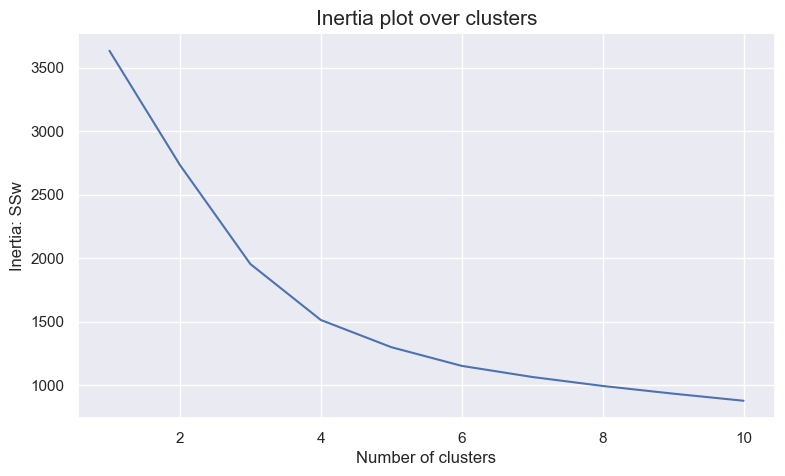

In [411]:
range_clusters = range(1, 11)

inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit_predict(weights)
    inertia.append(kmclust.inertia_)

# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(range_clusters, inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



Number of clusters: 3
Average Silhouette Score: 0.43786632364023176

Cluster 0: Average Silhouette Score = 0.3626897877863083
Cluster 1: Average Silhouette Score = 0.5536270849116379
Cluster 2: Average Silhouette Score = 0.19974807955493543


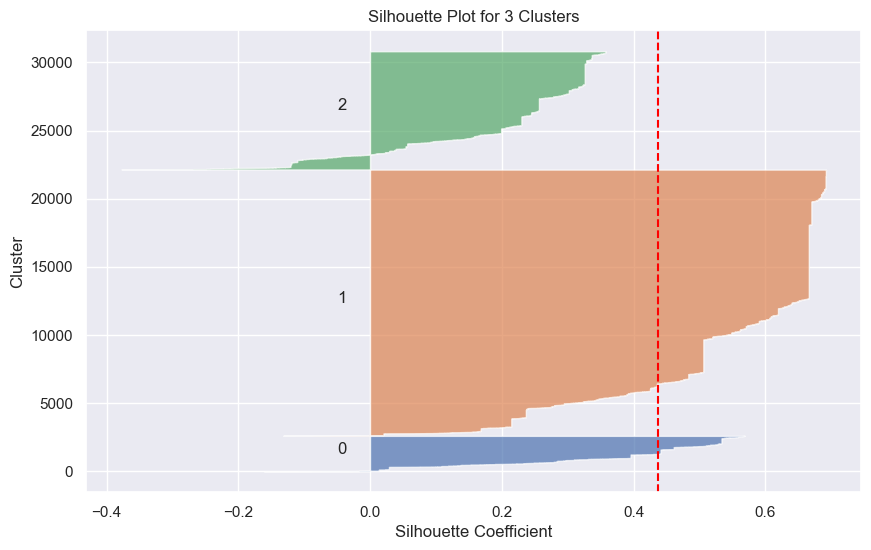

Calinski-Harabasz Index: 13177.119130747915
Davies-Bouldin Index: 1.124996386090548



c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



Number of clusters: 4
Average Silhouette Score: 0.46999350885031566

Cluster 0: Average Silhouette Score = 0.37403955215961165
Cluster 1: Average Silhouette Score = 0.37187010667490633
Cluster 2: Average Silhouette Score = 0.3606853117189505
Cluster 3: Average Silhouette Score = 0.5404697507457131


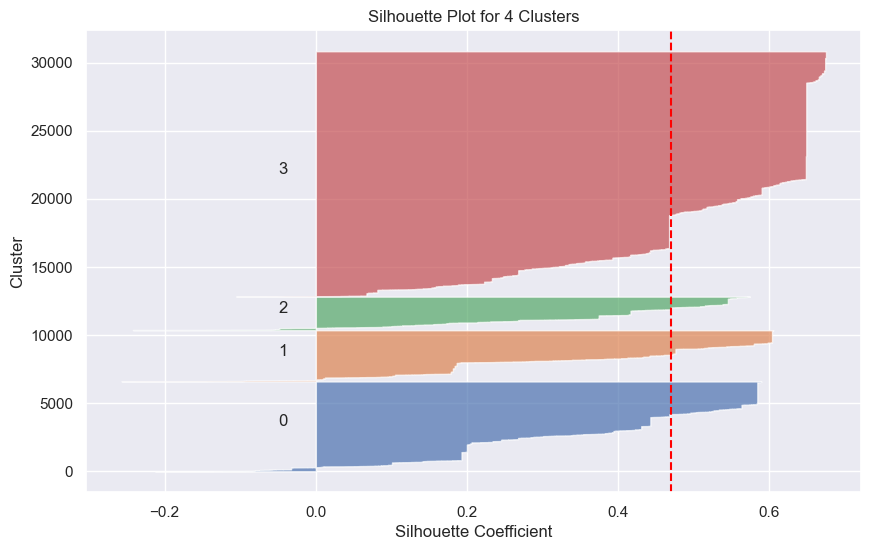

Calinski-Harabasz Index: 17349.592778342452
Davies-Bouldin Index: 0.8697183623287574



c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



Number of clusters: 5
Average Silhouette Score: 0.4322276607092649

Cluster 0: Average Silhouette Score = 0.41052847976317164
Cluster 1: Average Silhouette Score = 0.356064945193676
Cluster 2: Average Silhouette Score = 0.5059173008119096
Cluster 3: Average Silhouette Score = 0.3869690445315207
Cluster 4: Average Silhouette Score = 0.3533968241864257


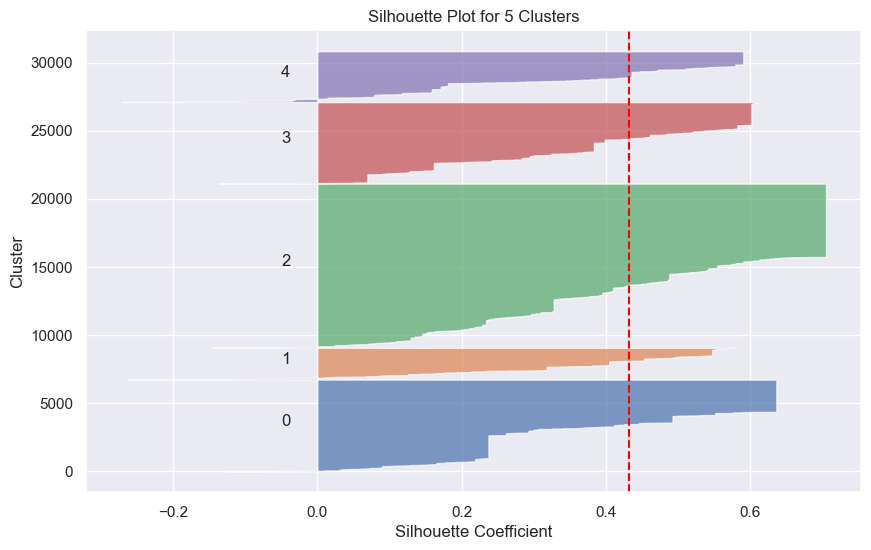

Calinski-Harabasz Index: 19708.667261578237
Davies-Bouldin Index: 0.8556505078141624



c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



Number of clusters: 6
Average Silhouette Score: 0.4540064425290295

Cluster 0: Average Silhouette Score = 0.5233251406774099
Cluster 1: Average Silhouette Score = 0.3873647733961556
Cluster 2: Average Silhouette Score = 0.34405068007392536
Cluster 3: Average Silhouette Score = 0.36364496075332187
Cluster 4: Average Silhouette Score = 0.40726561835797825
Cluster 5: Average Silhouette Score = 0.47699523449907805


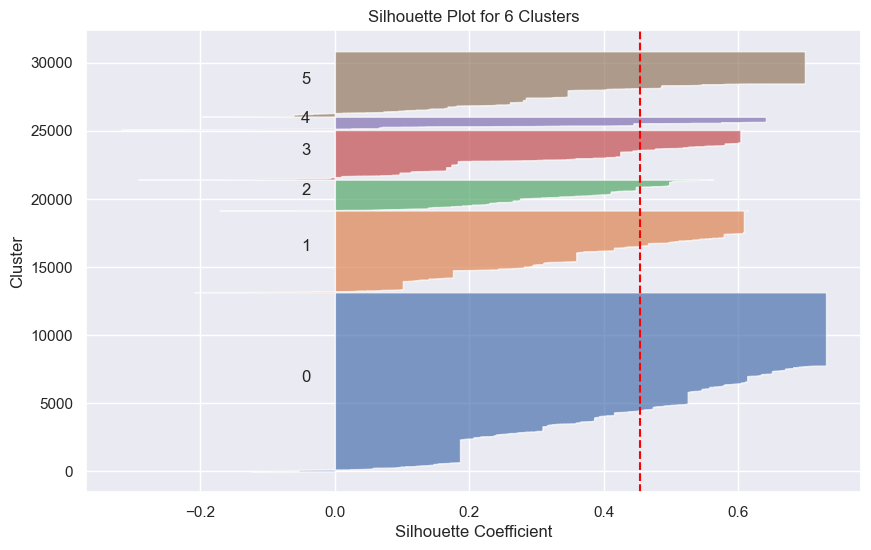

Calinski-Harabasz Index: 18453.753337809514
Davies-Bouldin Index: 0.8401740760166577



In [412]:
# Storing average silhouette metric
cluster_range = [3,4,5,6]
for nclus in cluster_range:
    # Skip nclus == 1
    if nclus == 1:
        continue

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(weights)
    bmu_index = np.array([sm.winner(x) for x in data[perspective3].values])
    kmeans_matrix = cluster_labels.reshape((M,N))
    som_final_labels = [kmeans_matrix[i[0]][i[1]] for i in bmu_index]

    df_final = pd.concat([data,
                    pd.Series(som_final_labels, name='label', index=data.index)], axis=1)
    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_analysis(df_final[perspective3], np.array(som_final_labels), nclus)
    evaluate_clustering_metrics(df_final[perspective3], np.array(som_final_labels))



##### Cluster = 5

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



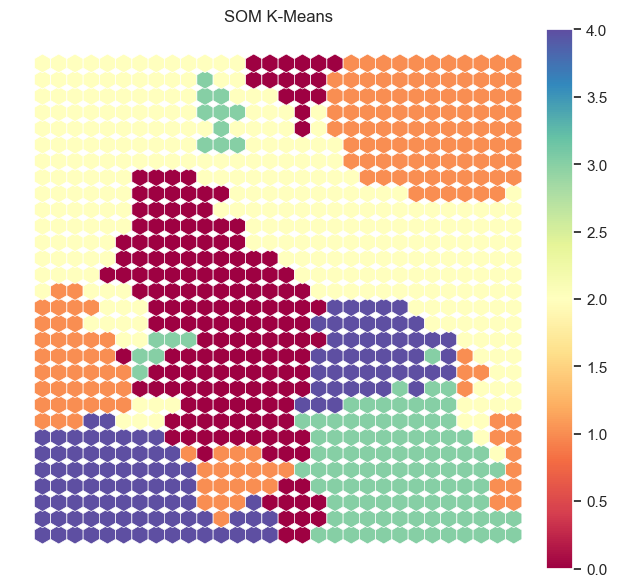

In [413]:
kmeans = KMeans(n_clusters=5, init='k-means++', n_init=20, random_state=42)
nodeclus_labels = kmeans.fit_predict(weights)
nodeclus_labels

kmeans_matrix = nodeclus_labels.reshape((M,N))

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(kmeans_matrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    kmeans_matrix,
                    label="SOM K-Means",
                    cmap=cm.Spectral,
                    )

In [414]:
# Check the nodes and and respective clusters
nodes = weights

df_nodes = pd.DataFrame(nodes, columns=perspective3)
df_nodes['label'] = nodeclus_labels

bmu_index = np.array([sm.winner(x) for x in data[perspective3].values])
som_final_labels = [kmeans_matrix[i[0]][i[1]] for i in bmu_index]

df_final = pd.concat([data_inversed,
                pd.Series(som_final_labels, name='label', index=data_inversed.index)], axis=1)

# Characterizing the final clusters
df_final[perspective3+['label']].groupby('label').mean()

,breakfast_orders,lunch_snack_orders,dinner_orders,night_orders,startweek_orders
label,,,,,
0,0.052423,0.901982,0.014460,0.010532,0.238271
1,0.770588,0.183364,0.006515,0.039533,0.705670
2,0.059698,0.896888,0.033860,0.009553,0.865701
3,0.048787,0.269038,0.643291,0.038884,0.676274
4,0.158673,0.107353,0.013634,0.720340,0.690394


In [415]:
df_final = pd.concat([data,
                pd.Series(som_final_labels, name='label', index=data.index)], axis=1)

# Compute SST (Total Sum of Squares)
sst = get_ss_2(df_final[perspective3])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = df_final[perspective3 + ["label"]].groupby(by='label').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(df_final)  # Total number of data points
k = df_final['label'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.7191
Adjusted R²: 0.7190


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\1130321352.py:8: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



##### Cluster = 6

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



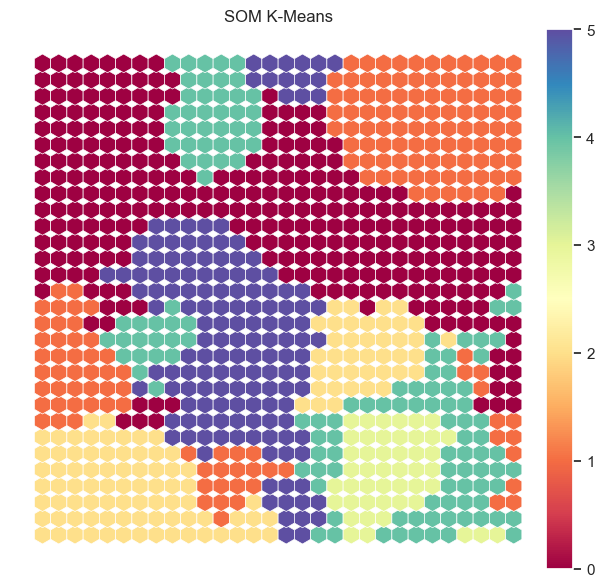

In [416]:
kmeans = KMeans(n_clusters=6, init='k-means++', n_init=20, random_state=42)
nodeclus_labels = kmeans.fit_predict(weights)
nodeclus_labels

kmeans_matrix = nodeclus_labels.reshape((M,N))

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(kmeans_matrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    kmeans_matrix,
                    label="SOM K-Means",
                    cmap=cm.Spectral,
                    )

In [417]:
# Check the nodes and and respective clusters
nodes = weights

df_nodes = pd.DataFrame(nodes, columns=perspective3)
df_nodes['label'] = nodeclus_labels

bmu_index = np.array([sm.winner(x) for x in data[perspective3].values])
som_final_labels = [kmeans_matrix[i[0]][i[1]] for i in bmu_index]

df_final = pd.concat([data_inversed,
                pd.Series(som_final_labels, name='label', index=data_inversed.index)], axis=1)

# Characterizing the final clusters
df_final[perspective3+['label']].groupby('label').mean()

,breakfast_orders,lunch_snack_orders,dinner_orders,night_orders,startweek_orders
label,,,,,
0,0.051899,0.926345,0.014191,0.007565,0.822820
1,0.771941,0.183088,0.005825,0.039146,0.706495
2,0.157894,0.106371,0.010067,0.725669,0.689573
3,0.012111,0.090283,0.883668,0.013939,0.694168
4,0.074932,0.484340,0.390646,0.050081,0.678894
5,0.071242,0.874040,0.011617,0.014333,0.137450


In [418]:
df_final = pd.concat([data,
                pd.Series(som_final_labels, name='label', index=data.index)], axis=1)

# Compute SST (Total Sum of Squares)
sst = get_ss_2(df_final[perspective3])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = df_final[perspective3 + ["label"]].groupby(by='label').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(df_final)  # Total number of data points
k = df_final['label'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.7498
Adjusted R²: 0.7498


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\1130321352.py:8: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



##### Final Solution **(k=6)**

In [419]:
kmeans = KMeans(n_clusters=6, init='k-means++', n_init=20, random_state=42)
nodeclus_labels = kmeans.fit_predict(weights)
nodeclus_labels

kmeans_matrix = nodeclus_labels.reshape((M,N))

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



In [420]:
# Check the nodes and and respective clusters
nodes = weights

df_nodes = pd.DataFrame(nodes, columns=perspective3)
df_nodes['label'] = nodeclus_labels

bmu_index = np.array([sm.winner(x) for x in data[perspective3].values])
som_final_labels = [kmeans_matrix[i[0]][i[1]] for i in bmu_index]

df_final = pd.concat([data_inversed,
                pd.Series(som_final_labels, name='label', index=data_inversed.index)], axis=1)

# Characterizing the final clusters
df_final[perspective3+['label']].groupby('label').mean()

,breakfast_orders,lunch_snack_orders,dinner_orders,night_orders,startweek_orders
label,,,,,
0,0.051899,0.926345,0.014191,0.007565,0.822820
1,0.771941,0.183088,0.005825,0.039146,0.706495
2,0.157894,0.106371,0.010067,0.725669,0.689573
3,0.012111,0.090283,0.883668,0.013939,0.694168
4,0.074932,0.484340,0.390646,0.050081,0.678894
5,0.071242,0.874040,0.011617,0.014333,0.137450


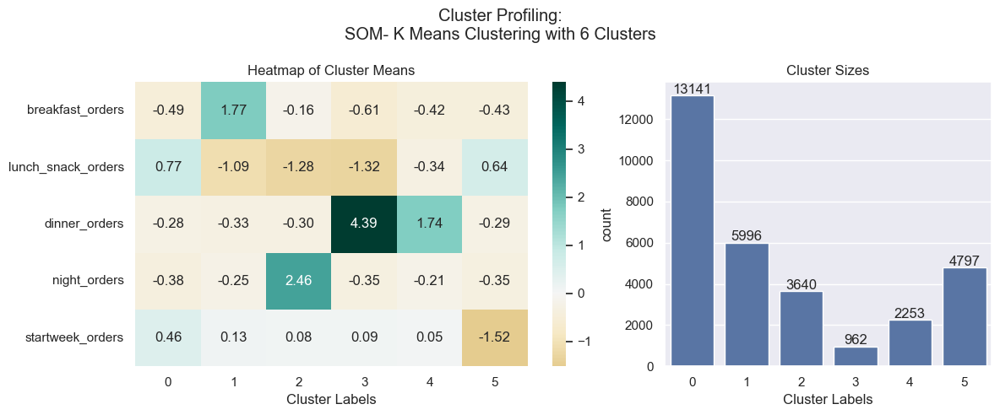

In [421]:
df_final = pd.concat([data,
                pd.Series(som_final_labels, name='label', index=data.index)], axis=1)

# Define figure and axes
fig, axes = plt.subplots(1, 2, figsize=(12, 5), width_ratios=[0.6, 0.4], tight_layout=True)

# Heatmap for cluster means
km_profile = df_final[perspective3 + ['label']].groupby('label').mean().T
sns.heatmap(km_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0])
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")

# Countplot for cluster sizes
sns.countplot(data=df_final, x='label', ax=axes[1])

# Annotate counts above bars
for bar in axes[1].patches:
    count = int(bar.get_height())  # Get the height of each bar
    axes[1].annotate(f"{count}", 
                     xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()),  # Position at the top of the bar
                     xytext=(0, 5),  # Offset text by 5 points
                     textcoords="offset points",
                     ha='center', va='center')

axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

# Add an overall title
fig.suptitle("Cluster Profiling:\nSOM- K Means Clustering with 6 Clusters")
plt.show()

### 4.3.4 Density Clustering

#### Mean Shift

In [422]:
# defines the size of the neighborhood around each data point when forming clusters
# It determines how far the algorithm will look to consider data points as part of the same cluster.
# A small bandwidth results in many small clusters (high granularity), while a large bandwidth results in fewer, broader clusters.
bandwidth = estimate_bandwidth(data[perspective3], quantile=0.15, random_state=1, n_jobs=-1)
bandwidth

1.5196926075941026

In [423]:
# Perform mean-shift clustering with bandwidth set using estimate_bandwidth
ms = MeanShift(bandwidth=bandwidth, bin_seeding=True, n_jobs=4)
ms_labels = ms.fit_predict(data[perspective3])

ms_n_clusters = len(np.unique(ms_labels))
print("Number of estimated clusters : %d" % ms_n_clusters)

Number of estimated clusters : 9


In [424]:
# Concatenating the labels to df
df_concat = pd.concat([data[perspective3], pd.Series(ms_labels, index=data.index, name="ms_labels")], axis=1)

In [425]:
df_concat[perspective3+['ms_labels']].groupby('ms_labels').mean()

,breakfast_orders,lunch_snack_orders,dinner_orders,night_orders,startweek_orders
ms_labels,,,,,
0,-0.503592,0.814297,-0.338034,-0.383052,-0.018069
1,1.712493,-0.969873,-0.328437,-0.369590,0.588846
2,-0.430673,-0.154869,1.452825,-0.265494,0.026657
3,0.521693,-1.066378,-0.277558,1.247328,0.047282
4,-0.527090,-1.467456,-0.300870,3.220499,0.817955
5,1.767390,-1.221187,-0.322521,-0.369510,-1.486285
6,-0.521672,-1.412107,-0.275762,3.107799,-1.432791
7,-0.612878,-1.349926,4.445351,-0.355380,0.740516
8,-0.624669,-1.405404,4.591970,-0.361023,-1.375202


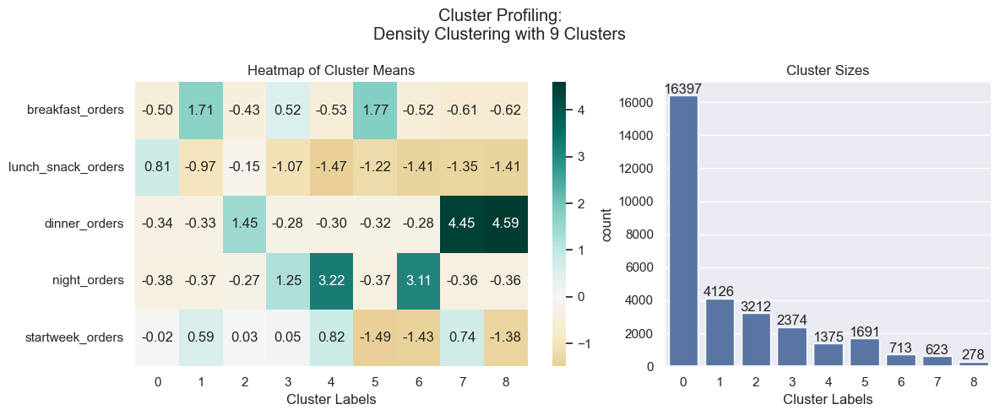

In [426]:
# Define figure and axes
fig, axes = plt.subplots(1, 2, figsize=(12, 5), width_ratios=[0.6, 0.4], tight_layout=True)

# Heatmap for cluster means
den_profile = df_concat[perspective3+['ms_labels']].groupby('ms_labels').mean().T
sns.heatmap(den_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0])
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")

# Countplot for cluster sizes
sns.countplot(data=df_concat, x='ms_labels', ax=axes[1])

# Annotate counts above bars
for bar in axes[1].patches:
    count = int(bar.get_height())  # Get the height of each bar
    axes[1].annotate(f"{count}", 
                     xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()),  # Position at the top of the bar
                     xytext=(0, 5),  # Offset text by 5 points
                     textcoords="offset points",
                     ha='center', va='center')

axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

# Add an overall title
fig.suptitle("Cluster Profiling:\nDensity Clustering with 9 Clusters")
plt.show()

In [427]:
# Computing the R^2 of the cluster solution
sst = get_ss_2(data[perspective3])  # get total sum of squares
ssw_labels = df_concat.groupby(by='ms_labels').apply(get_ss_2)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
print("Cluster solution with R^2 of %0.4f" % r2)

Cluster solution with R^2 of 0.7434


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\1431884569.py:3: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



## 4.4 Perspective 4: Ordering Behaviour Dynamics 

In [428]:
perspective4 = ['customer_age', 'vendor_count', 'product_count', 'products_per_order', 'spend_per_order', 'first_order', 'total_orders', 'total_spend', 'different_weekdays', 'purchase_frequency', 'recency', 'diversity_cuisine_types']

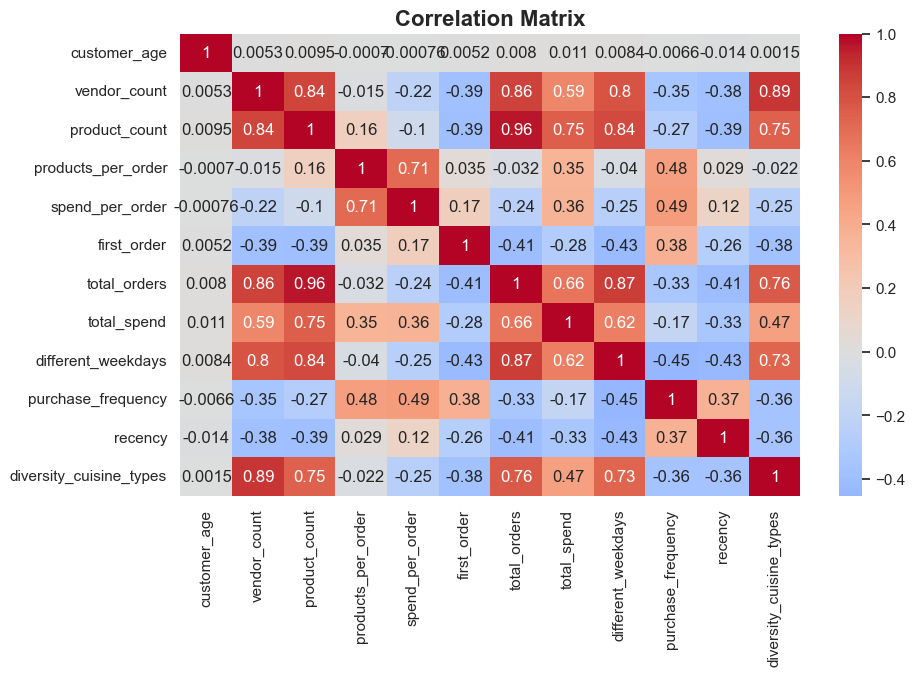

In [429]:
plt.figure(figsize=(10, 6))
sns.heatmap(data[perspective4].corr(), annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Matrix', fontsize=16, fontweight='bold')
plt.show()

In [430]:
# UNCOMMENT TO RUN!!

# combinations_results = feature_combinations_clustering(
#     data[perspective4], 
#     n_clusters=6, 
#     n_combinations=300, 
#     subset_sizes=(5, 6)
# )

# print(combinations_results)
# best_combination = combinations_results.iloc[0]
# print("\nBest Combination:")
# print(best_combination)

# combinations_results.to_csv('combinations_results.csv', index=False)

In [431]:
# perspective4 = [feature for feature in combinations_results.iloc[0]['Features']]

# perspective4

perspective4 = ['vendor_count', 'products_per_order', 'total_orders', 'different_weekdays', 'purchase_frequency']

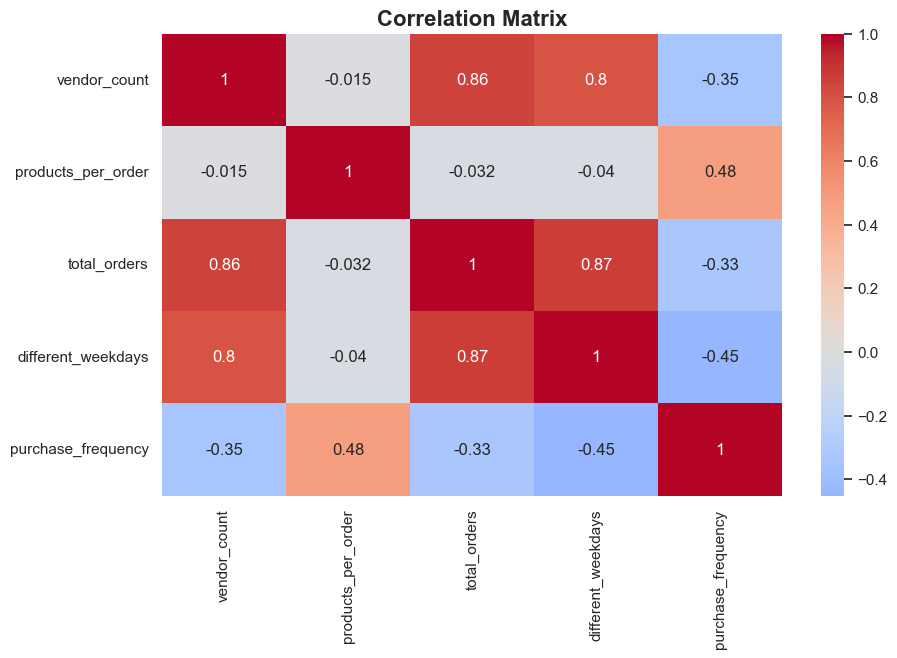

In [432]:
plt.figure(figsize=(10, 6))
sns.heatmap(data[perspective4].corr(), annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Matrix', fontsize=16, fontweight='bold')
plt.show()

### 4.4.1 Hierarchical Clustering

#### R Squared

In [433]:
# hc_methods = ["ward", "complete", "average", "single"]
hc_methods = ["ward"]
max_nclus = 10

r2_hc = np.vstack([get_r2_hc(data[perspective4], 
                              link, 
                              max_nclus=max_nclus, 
                              min_nclus=1, 
                              dist="euclidean") 
                              for link in hc_methods])

C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\156999461.py:7: UserWarning:

The markers list has more values (4) than needed (1), which may not be intended.



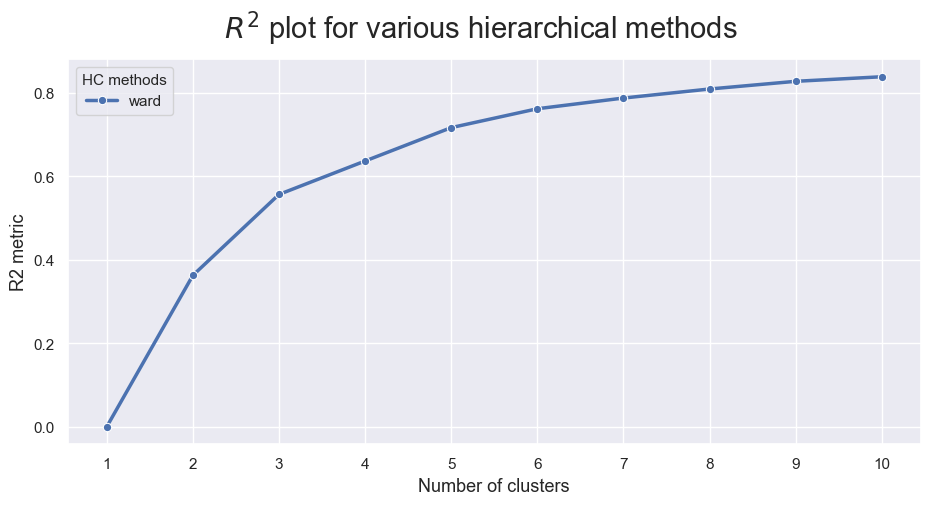

In [434]:
r2_hc_methods = pd.DataFrame(r2_hc.T, index=range(1, max_nclus + 1), columns=hc_methods)

sns.set()

# Plot data
fig = plt.figure(figsize=(11,5))
sns.lineplot(data=r2_hc_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
plt.legend(title="HC methods", title_fontsize=11)
plt.xticks(range(1, max_nclus + 1))
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)

fig.suptitle("$R^2$ plot for various hierarchical methods", fontsize=21)

plt.show()

#### Dendogram

In [435]:
# setting distance_threshold=0 and n_clusters=None ensures we compute the full tree
linkage = 'ward'
distance = 'euclidean'


hclust = AgglomerativeClustering(linkage=linkage, 
                                 metric=distance,
                                 distance_threshold=0,
                                 n_clusters=None)

hclust.fit_predict(data[perspective4])

array([30788, 30787, 30786, ...,     5,     2,     0], dtype=int64)

In [436]:
# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

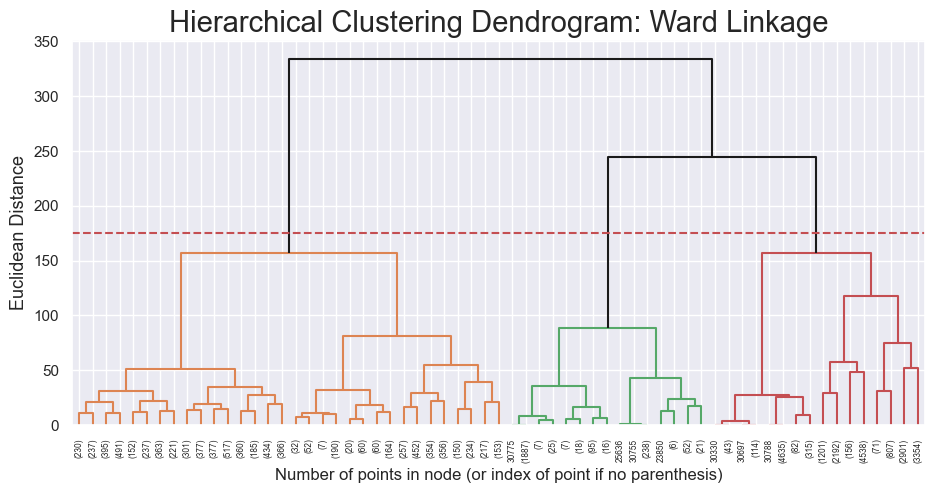

In [437]:
# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 175
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering Dendrogram: {linkage.title()} Linkage', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
plt.show()

#### Defining the number of Clusters

Number of clusters: 3
Average Silhouette Score: 0.44471513489338643

Cluster 0: Average Silhouette Score = 0.2753721472561501
Cluster 1: Average Silhouette Score = 0.47669042870398187
Cluster 2: Average Silhouette Score = 0.7402679744656314


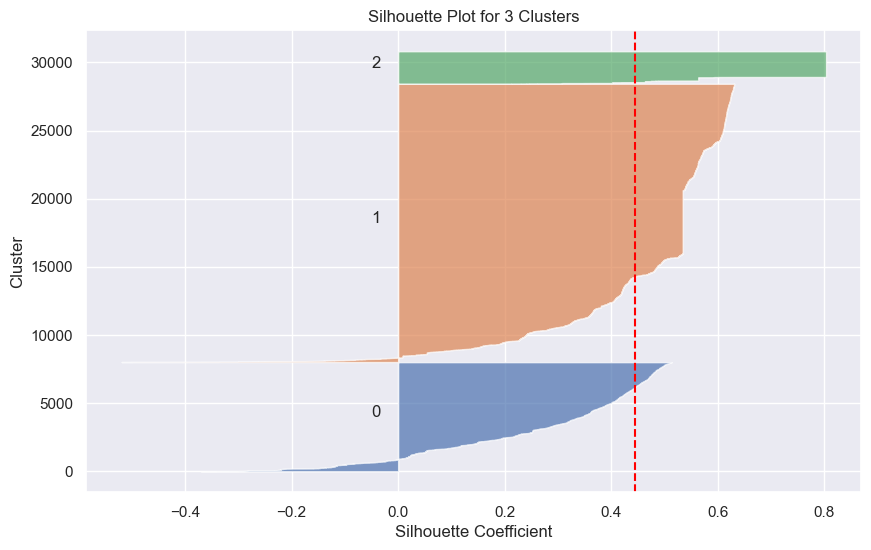

Calinski-Harabasz Index: 19333.08572470081
Davies-Bouldin Index: 0.8265643039848832

Number of clusters: 4
Average Silhouette Score: 0.3585964181752631

Cluster 0: Average Silhouette Score = 0.3274752207139628
Cluster 1: Average Silhouette Score = 0.17203281691317224
Cluster 2: Average Silhouette Score = 0.7402679744656314
Cluster 3: Average Silhouette Score = 0.4049318515368869


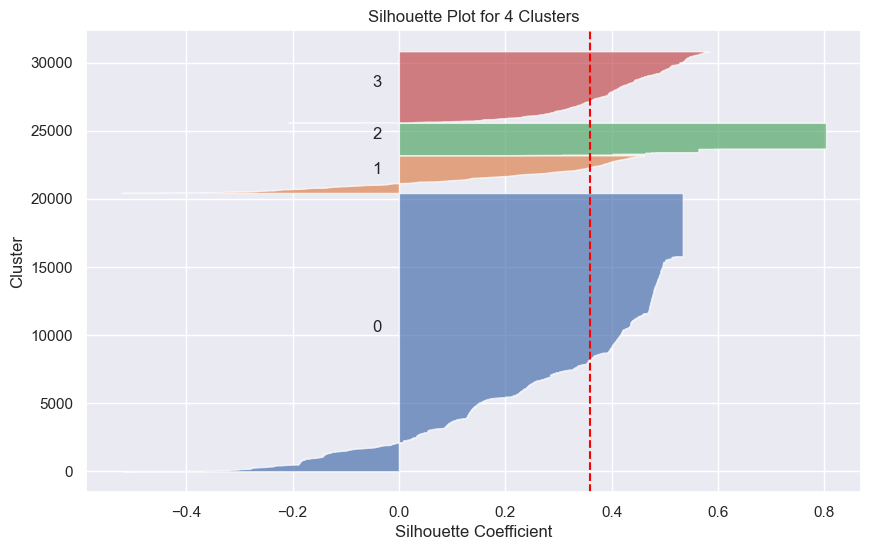

Calinski-Harabasz Index: 17996.39837398744
Davies-Bouldin Index: 0.9135514357160484

Number of clusters: 5
Average Silhouette Score: 0.38599115631784675

Cluster 0: Average Silhouette Score = 0.22241692112662279
Cluster 1: Average Silhouette Score = 0.17203281691317224
Cluster 2: Average Silhouette Score = 0.6929818712243196
Cluster 3: Average Silhouette Score = 0.34341287483087296
Cluster 4: Average Silhouette Score = 0.8816623718238072


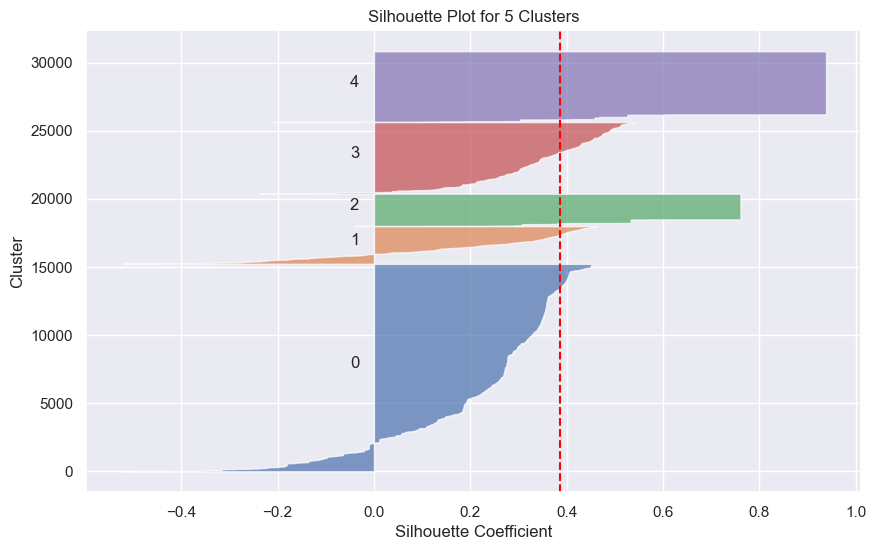

Calinski-Harabasz Index: 19482.922619112487
Davies-Bouldin Index: 0.885532009358751

Number of clusters: 6
Average Silhouette Score: 0.41405893376200814

Cluster 0: Average Silhouette Score = 0.6926098172204999
Cluster 1: Average Silhouette Score = 0.17203281691317224
Cluster 2: Average Silhouette Score = 0.1329221310497052
Cluster 3: Average Silhouette Score = 0.3047477539479395
Cluster 4: Average Silhouette Score = 0.8663089120953978
Cluster 5: Average Silhouette Score = 0.44324856813529545


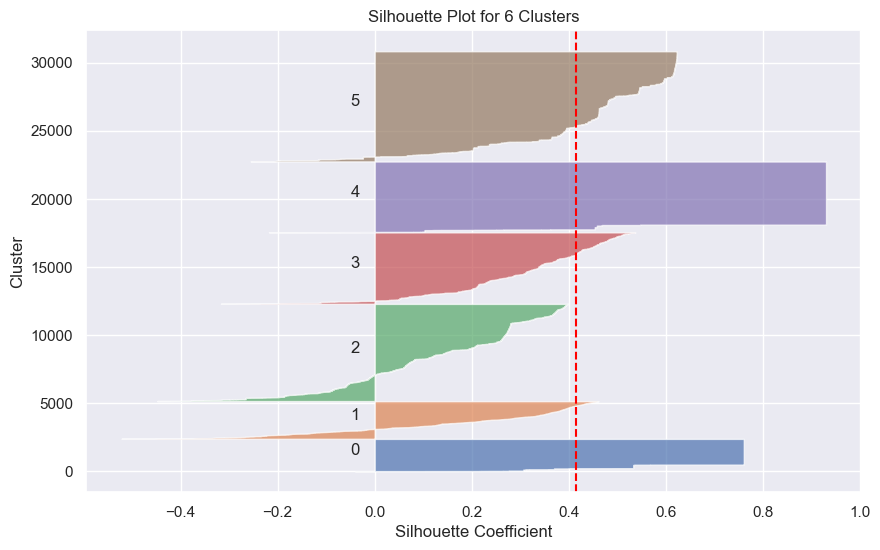

Calinski-Harabasz Index: 19720.56008861136
Davies-Bouldin Index: 0.9243961081555031



In [438]:
# Define the range of clusters to test
cluster_range = [3, 4, 5, 6]

# Create a dictionary to store results for each number of clusters
cluster_results = {}

# Run Agglomerative Clustering for each value in the cluster range
for n_clusters in cluster_range:
    hc_model = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    labels = hc_model.fit_predict(data[perspective4])
    silhouette_analysis(data[perspective4], labels, n_clusters)
    evaluate_clustering_metrics(data[perspective4], labels)
    cluster_results[n_clusters] = labels  # Store labels for each n_clusters

# Convert results to a DataFrame for easier visualization
results_df = pd.DataFrame(cluster_results, index=data.index)
results_df.columns = [f'Cluster_{n}' for n in cluster_range]

In [439]:
results_df

,Cluster_3,Cluster_4,Cluster_5,Cluster_6
0,2,2,2,0
1,1,0,4,4
2,1,0,4,4
3,1,0,0,2
4,1,0,0,2
...,...,...,...,...
31883,1,0,4,4
31884,1,0,4,4
31885,1,0,4,4
31886,1,0,4,4


The silhouette score measures how similar an object is to its own cluster compared to other clusters. It ranges from -1 to 1:

- A value close to 1 means well-clustered points.
- A value close to 0 means points lie between clusters.
- A negative value indicates points are likely assigned to the wrong cluster.

**Calinski-Harabasz Index**
This index measures the ratio of the sum of between-cluster dispersion to within-cluster dispersion:

- Higher values indicate well-separated clusters.
- Use this metric across clustering runs to evaluate the feature set.


**Davies-Bouldin Index**
This metric evaluates the average similarity ratio of each cluster with its most similar cluster:

- Lower values are better (indicating better separation between clusters).
- It's sensitive to feature selection and can provide insights into whether features differentiate clusters effectively.

Davies-Bouldin Index > 1 suggest less distinct clustering or overlapping clusters.

##### Comparison between 5 and 6

In [440]:
pd.crosstab(
    pd.Series(results_df['Cluster_6'], name='Cluster_6', index=data.index),
    pd.Series(results_df['Cluster_5'], name='Cluster_5', index=data.index),)

Cluster_5,0,1,2,3,4
Cluster_6,,,,,
0,0,0,2376,0,0
1,0,2758,0,0,0
2,7133,0,0,0,0
3,0,0,0,5243,0
4,0,0,0,0,5192
5,8087,0,0,0,0


#### Final Solution **(k=6)**

In [441]:
data_concat = pd.concat([
    data_inversed[perspective4], 
    pd.Series(results_df['Cluster_6'], name='labels', index=data_inversed.index)
    ], 
    axis=1)
data_concat.groupby('labels').mean()

,vendor_count,products_per_order,total_orders,different_weekdays,purchase_frequency
labels,,,,,
0,1.064815,2.152988,1.089226,1.014731,2.269220
1,7.766497,1.268710,12.276650,5.753807,0.229457
2,2.416234,1.554578,2.997196,2.379784,0.229328
3,4.260538,1.251080,6.088499,4.178524,0.151485
4,1.103043,1.002558,1.128082,1.083975,1.024499
5,2.275628,0.993697,2.706195,2.128725,0.113132


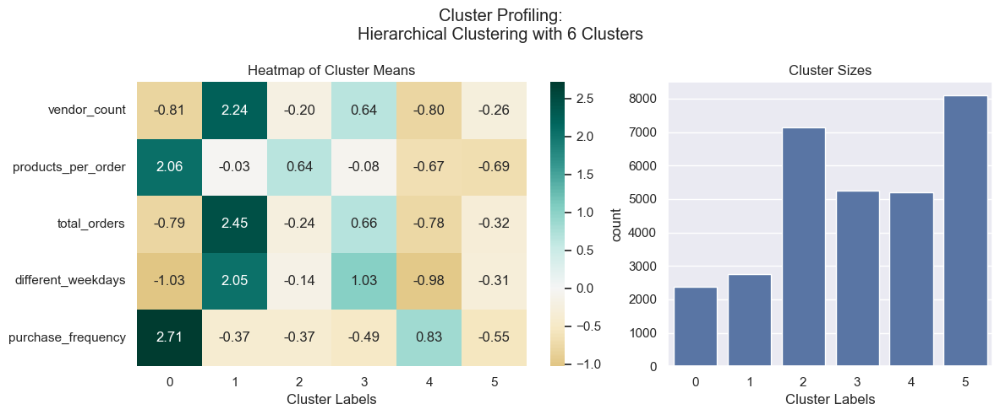

In [442]:
label_counts = None 

fig, axes = plt.subplots(1,2, figsize=(12,5), width_ratios=[.6,.4], tight_layout=True)

data_concat = pd.concat([
    data[perspective4], 
    pd.Series(results_df['Cluster_6'], name='labels', index=data.index)
    ], 
    axis=1)

hc_profile = data_concat.groupby('labels').mean().T

sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0]
            )
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")


sns.countplot(data_concat, x='labels', ax=axes[1])
axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

fig.suptitle("Cluster Profiling:\nHierarchical Clustering with 6 Clusters")
plt.show()

In [443]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(data_concat[perspective4])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = data_concat[perspective4 + ["labels"]].groupby(by='labels').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(data_concat)  # Total number of data points
k = data_concat['labels'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.7621
Adjusted R²: 0.7620


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\3744786398.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



### 4.4.2 KMeans

#### Inertia

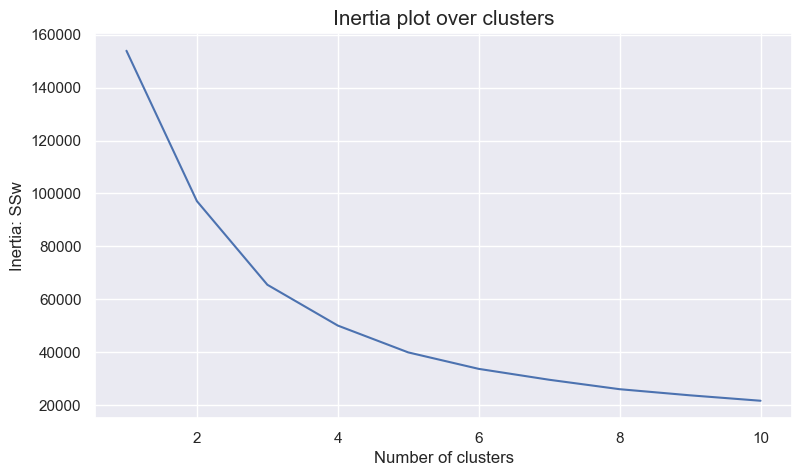

In [444]:
range_clusters = range(1, 11)

inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit(data[perspective4])
    inertia.append(kmclust.inertia_)

# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(range_clusters, inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

#### Defining the number of Clusters

In [445]:
# Storing average silhouette metric
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(data[perspective4])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(data[perspective4], cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(data[perspective4], cluster_labels)

For n_clusters = 2, the average silhouette_score is : 0.4141388113664973
For n_clusters = 3, the average silhouette_score is : 0.47415279828390067
For n_clusters = 4, the average silhouette_score is : 0.41666380619720955
For n_clusters = 5, the average silhouette_score is : 0.42437209288782435
For n_clusters = 6, the average silhouette_score is : 0.44345093520605866
For n_clusters = 7, the average silhouette_score is : 0.4540784534012895
For n_clusters = 8, the average silhouette_score is : 0.4422582079149851
For n_clusters = 9, the average silhouette_score is : 0.4444369918390644
For n_clusters = 10, the average silhouette_score is : 0.44073604991808596


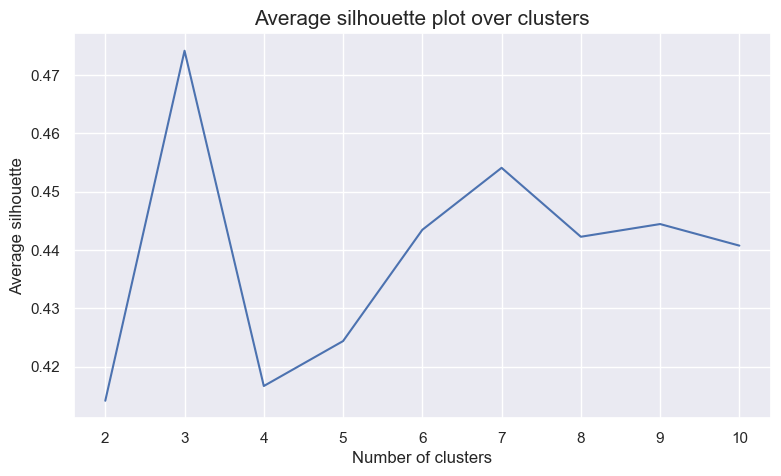

In [446]:
# The average silhouette plot
# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(range_clusters[1:], ## Plot X-axis; Why range_clusters[1:] ? Remember we skipped k=1 in the cell above
         avg_silhouette)     ## Plot Y-axis

plt.ylabel("Average silhouette")
plt.xlabel("Number of clusters")
plt.title("Average silhouette plot over clusters", size=15)
plt.show()

In [447]:
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(data[perspective4])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    print(f"For n_clusters = {nclus}, the metrics are :")
    metrics_avg = evaluate_clustering_metrics(data[perspective4], cluster_labels)

For n_clusters = 2, the metrics are :
Calinski-Harabasz Index: 18026.59977221932
Davies-Bouldin Index: 0.9816001153887091

For n_clusters = 3, the metrics are :
Calinski-Harabasz Index: 20796.142179269373
Davies-Bouldin Index: 0.7941587923445496

For n_clusters = 4, the metrics are :
Calinski-Harabasz Index: 21303.624661831615
Davies-Bouldin Index: 0.7461296904974611

For n_clusters = 5, the metrics are :
Calinski-Harabasz Index: 21997.124735082558
Davies-Bouldin Index: 0.8345735440868183

For n_clusters = 6, the metrics are :
Calinski-Harabasz Index: 21985.242083553
Davies-Bouldin Index: 0.8470885939383123

For n_clusters = 7, the metrics are :
Calinski-Harabasz Index: 21585.460778964283
Davies-Bouldin Index: 0.7819341455813698

For n_clusters = 8, the metrics are :
Calinski-Harabasz Index: 21647.127157548934
Davies-Bouldin Index: 0.8573371554236685

For n_clusters = 9, the metrics are :
Calinski-Harabasz Index: 21169.40106238271
Davies-Bouldin Index: 0.8592143452758889

For n_cluster

##### Cluster = 6

In [448]:
kmclust_6 = KMeans(n_clusters=6, init='k-means++', n_init=15, random_state=1)
kmclust_6.fit(data[perspective4])
labels_6 = kmclust_6.predict(data[perspective4])

Number of clusters: 6
Average Silhouette Score: 0.44345093520605866

Cluster 0: Average Silhouette Score = 0.4060227308415408
Cluster 1: Average Silhouette Score = 0.8082942879213237
Cluster 2: Average Silhouette Score = 0.2720806527518931
Cluster 3: Average Silhouette Score = 0.26580576626926294
Cluster 4: Average Silhouette Score = 0.6645657822567748
Cluster 5: Average Silhouette Score = 0.2926824018204515


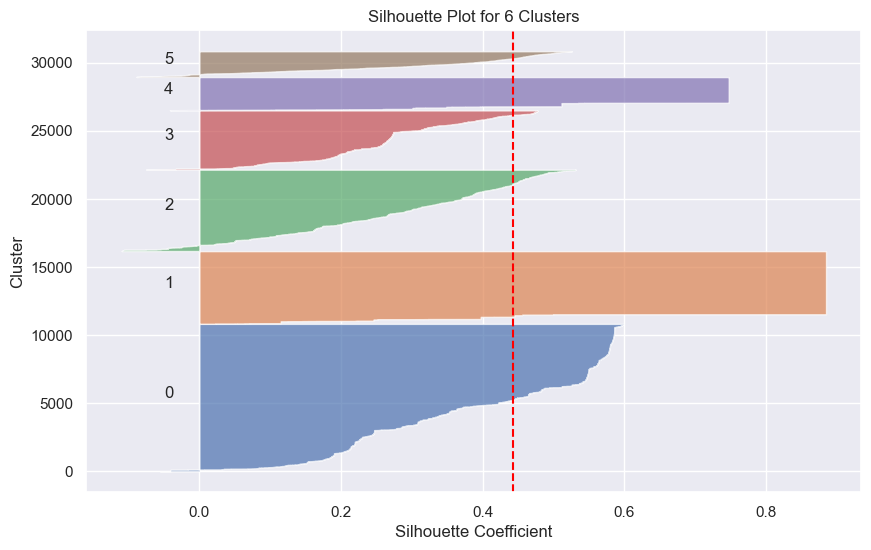

In [449]:
silhouette_analysis(data[perspective4], labels_6, 6)

In [450]:
evaluate_clustering_metrics(data[perspective4], labels_6)

Calinski-Harabasz Index: 21985.242083553
Davies-Bouldin Index: 0.8470885939383123



##### Cluster = 7

In [451]:
kmclust_7 = KMeans(n_clusters=7, init='k-means++', n_init=15, random_state=1)
kmclust_7.fit(data[perspective4])
labels_7 = kmclust_7.predict(data[perspective4])

Number of clusters: 7
Average Silhouette Score: 0.4540784534012895

Cluster 0: Average Silhouette Score = 0.2687636197354612
Cluster 1: Average Silhouette Score = 0.28940761590568437
Cluster 2: Average Silhouette Score = 0.835127299063638
Cluster 3: Average Silhouette Score = 0.41902812745107354
Cluster 4: Average Silhouette Score = 0.5363288103291308
Cluster 5: Average Silhouette Score = 0.8031714569688436
Cluster 6: Average Silhouette Score = 0.2531614865466


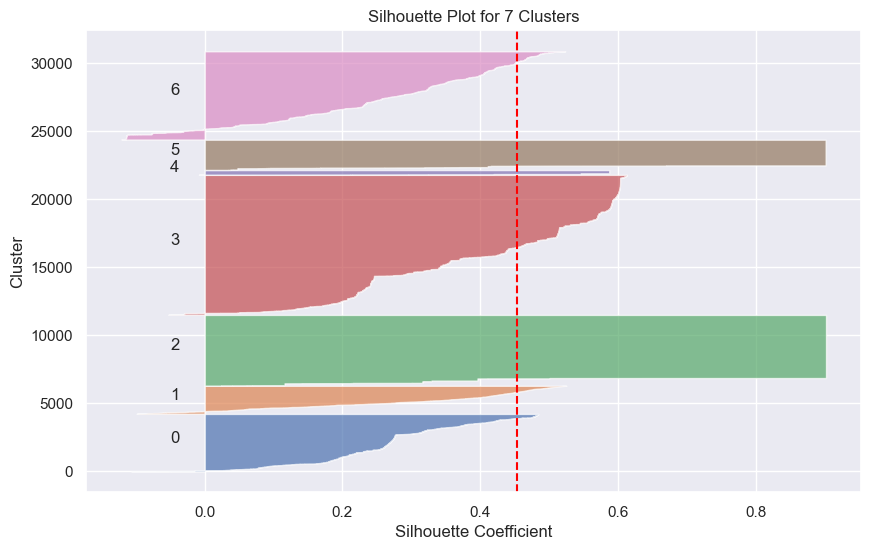

In [452]:
silhouette_analysis(data[perspective4], labels_7, 7)

In [453]:
evaluate_clustering_metrics(data[perspective4], labels_7)

Calinski-Harabasz Index: 21585.460778964283
Davies-Bouldin Index: 0.7819341455813698



#### Final Solution **(k=6)**

In [454]:
data_concat = pd.concat([
    data_inversed[perspective4], 
    pd.Series(labels_6, name='labels', index=data_inversed.index)
    ], 
    axis=1)
data_concat.groupby('labels').mean()

,vendor_count,products_per_order,total_orders,different_weekdays,purchase_frequency
labels,,,,,
0,2.358562,1.077164,2.933001,2.339155,0.133977
1,1.060413,0.983890,1.088743,1.047092,1.013946
2,4.604823,1.262230,6.603985,4.321165,0.160503
3,2.257604,1.703123,2.732028,2.198157,0.214324
4,1.086101,2.166134,1.121361,1.042640,2.244177
5,8.760996,1.267198,13.735029,5.948066,0.250294


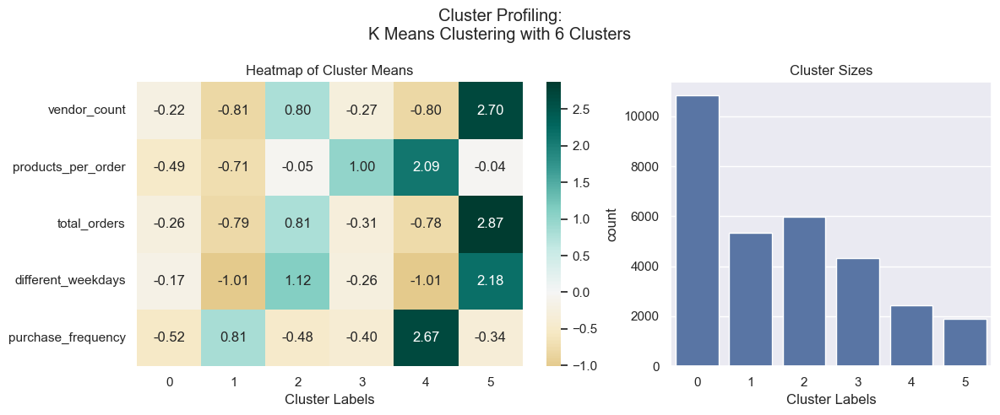

In [455]:
label_counts = None 

fig, axes = plt.subplots(1,2, figsize=(12,5), width_ratios=[.6,.4], tight_layout=True)

data_concat = pd.concat([
    data[perspective4], 
    pd.Series(labels_6, name='labels', index=data.index)
    ], 
    axis=1)

hc_profile = data_concat.groupby('labels').mean().T

sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0]
            )
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")


sns.countplot(data_concat, x='labels', ax=axes[1])
axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

fig.suptitle("Cluster Profiling:\nK Means Clustering with 6 Clusters")
plt.show()

In [456]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(data_concat[perspective4])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = data_concat[perspective4 + ["labels"]].groupby(by='labels').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(data_concat)  # Total number of data points
k = data_concat['labels'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.7812
Adjusted R²: 0.7812


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\3744786398.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



### 4.4.3 SOM

In [457]:
neighborhood_function = 'gaussian' # Defines how neighboring neurons affect each other during training. A 'gaussian' function is used here, meaning the influence decreases with distance.
topology = 'rectangular' 
n_feats = len(perspective4)
learning_rate = 0.7

som_data = data[perspective4].values
M, N = calculate_grid_size(len(som_data), aspect_ratio=1)  # Square grid
print(f"Grid size: M={M}, N={N}")

sm = MiniSom(M, N,              # 10x10 map size
             n_feats,           # Number of the elements of the vectors in input.
             learning_rate=learning_rate, 
             topology=topology, 
             neighborhood_function=neighborhood_function, 
             activation_distance='euclidean',
             random_seed=42
             )

# Initializes the weights of the SOM picking random samples from data.
sm.random_weights_init(som_data) 


print("Before training:")
print("QE", np.round(sm.quantization_error(som_data),4)) # Quantization Error (QE): Measures how well the SOM represents the input data. It calculates the average distance between input vectors and their best-matching units (BMUs).
print("TE", np.round(sm.topographic_error(som_data),4)) # Topographic Error (TE): Measures how well the SOM preserves the topological relationships in the input data.

# Trains the SOM using all the vectors in data sequentially
# minisom does not distinguish between unfolding and fine tuning phase;

sm.train_batch(som_data, 300000)

print("After training:")
print("QE", np.round(sm.quantization_error(som_data),4))
print("TE", np.round(sm.topographic_error(som_data),4))

Grid size: M=30, N=30
Before training:


c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\minisom.py:513: RuntimeWarning:

invalid value encountered in sqrt



QE 0.1487
TE 0.9983
After training:
QE 0.0888
TE 0.1222


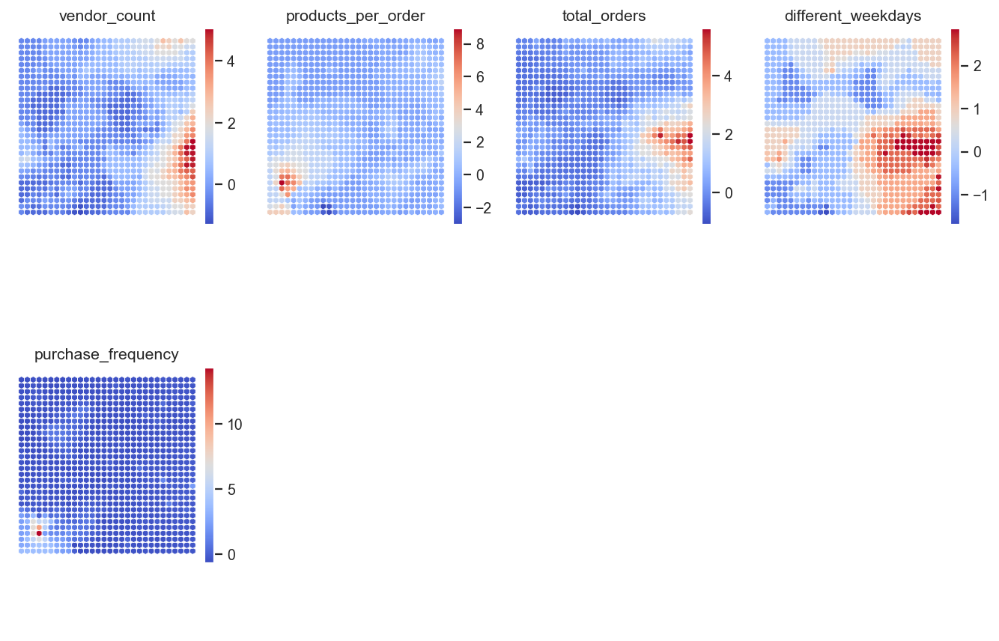

In [458]:
weights = sm.get_weights()

figsize=(10,7)
fig = plt.figure(figsize=figsize, constrained_layout=True, dpi=128, )

subfigs = fig.subfigures(2,4,wspace=.15)

colornorm = mpl_colors.Normalize(vmin=np.min(weights), vmax=np.max(weights))

for cpi, sf in zip(range(len(perspective4)), subfigs.flatten()):
    
    matrix_vals = weights[:,:,cpi]
    vext = np.max(np.abs([np.min(matrix_vals), np.max(matrix_vals)]))
    colornorm = mpl_colors.Normalize(vmin=np.min(matrix_vals), vmax=np.max(matrix_vals))
    # colornorm = mpl_colors.CenteredNorm(vcenter=0, halfrange=vext)


    sf = plot_hexagons(sm, sf, 
                    colornorm,
                    matrix_vals,
                    label=perspective4[cpi],
                    cmap=cm.coolwarm,
                    )

In vendor count, products_per_order and total orders, we see that the red areas are small and more localized, meaning that most customers interact with a limited number of vendors, have placed a small total number of orders and that most orders have a relatively low number of products. There's few outliers there, representing high order customers (as seen in vendor_count and total_orders) or people that buy more products per order (as seen in products_per_order).
In different_weekdays we see that some people order in different days of the week, not showing a preference for a speecific day, and is aligned with the high order customers identified in total_orders.


The heatmap for purchase_frequency raises concern due to the dense clustering in lower values (blue areas) and a strong red cluster in the bottom left. This suggests potential irregular behavior, particularly among customers who made a significant number of purchases in very few days. This issue was identified earlier (in Perspective 3), and an attempt to address it by removing customers with a purchase frequency greater than 6 showed minimal improvement in the overall results.

We decided to retain the data in its original form because we believe these customers represent genuine behavior that highlights a problem the company needs to address: the lack of consistent engagement. Instead of removing these data points, the company should focus on strategies to encourage more balanced and sustained customer interactions.

Winsorization was not a viable solution in this case. While it could cap extreme values in purchase_frequency, applying it would also require winsorizing product_count to maintain consistency. This would result in underestimating the true number of products purchased by these customers, even though they are not outliers in the product_count feature. As such, preserving the data integrity and addressing the underlying behavioral patterns directly is a more appropriate approach.

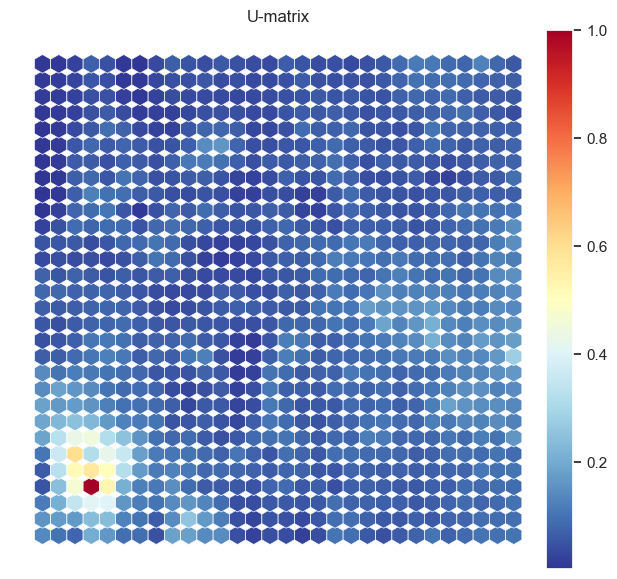

In [459]:
umatrix = sm.distance_map(scaling='mean')
fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=np.min(umatrix), vmax=np.max(umatrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    umatrix,
                    label="U-matrix",
                    cmap=cm.RdYlBu_r
                    )

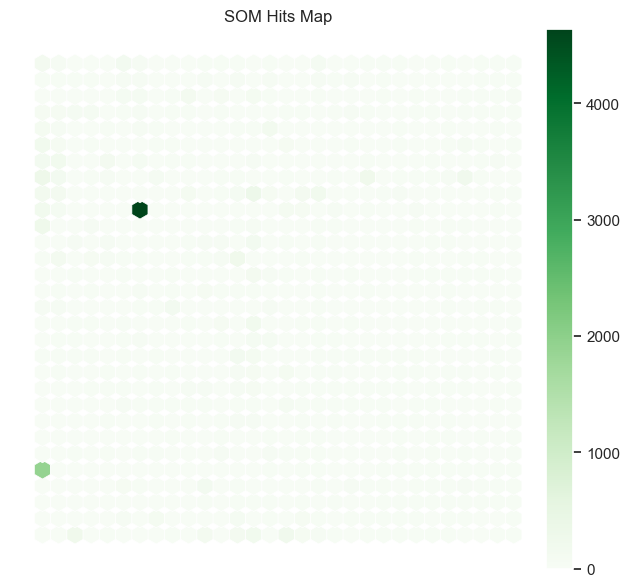

In [460]:
hitsmatrix = sm.activation_response(data[perspective4].values)

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hitsmatrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    hitsmatrix,
                    label="SOM Hits Map",
                    cmap=cm.Greens
                    )

In [461]:
bmus = np.array([sm.winner(x) for x in som_data])

mapped_data = pd.DataFrame({
    'BMU_X': bmus[:, 0],  # X-coordinate of the BMU
    'BMU_Y': bmus[:, 1],  # Y-coordinate of the BMU
    'Sample_Index': np.arange(len(data))  # Original index of data points
})

# Group data by BMU coordinates
grouped_nodes = mapped_data.groupby(['BMU_X', 'BMU_Y'])

# Count the number of data points assigned to each node
bmu_counts = grouped_nodes.size().reset_index(name='Hit_Count')

# Find the node with the highest hit count
most_populated_node = bmu_counts.loc[bmu_counts['Hit_Count'].idxmax()]
print("Most populated node:")
print(most_populated_node)

Most populated node:
BMU_X           6
BMU_Y          20
Hit_Count    4636
Name: 143, dtype: int64


The dark green dot raises concern and suggests that the dataset might be imbalanced and this dot represents a dominant cluster in the dataset. However it seems an overwhelming proportion, only 15.5% of the total customers are assigned to this cluster. While this isnt extrene, it's still significant enough to warrant attention because there's still a single dominant cluster that is overshadow smaller and meaningful groups.

In [462]:
node_indices = mapped_data[
    (mapped_data['BMU_X'] == most_populated_node[0]) & 
    (mapped_data['BMU_Y'] == most_populated_node[1])
]['Sample_Index'].tolist()

node_data = data.iloc[node_indices]  # Original data points

node_df = pd.DataFrame(node_data, columns=perspective4)
print(node_df.describe())


       vendor_count  products_per_order  total_orders  different_weekdays  \
count  4.636000e+03         4636.000000   4636.000000         4636.000000   
mean  -8.423977e-01           -0.671228     -0.814575           -1.038892   
std    1.110343e-16            0.000000      0.000000            0.000000   
min   -8.423977e-01           -0.671228     -0.814575           -1.038892   
25%   -8.423977e-01           -0.671228     -0.814575           -1.038892   
50%   -8.423977e-01           -0.671228     -0.814575           -1.038892   
75%   -8.423977e-01           -0.671228     -0.814575           -1.038892   
max   -8.423977e-01           -0.671228     -0.814575           -1.038892   

       purchase_frequency  
count        4.636000e+03  
mean         7.914056e-01  
std          1.110343e-16  
min          7.914056e-01  
25%          7.914056e-01  
50%          7.914056e-01  
75%          7.914056e-01  
max          7.914056e-01  


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\3925989637.py:2: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\3925989637.py:3: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



In [463]:
node_data_inversed = data_inversed.iloc[node_indices]  # Original data points

node_df_inversed = pd.DataFrame(node_data_inversed, columns=perspective4)
print(node_df_inversed.describe())

       vendor_count  products_per_order  total_orders  different_weekdays  \
count        4636.0              4636.0        4636.0              4636.0   
mean            1.0                 1.0           1.0                 1.0   
std             0.0                 0.0           0.0                 0.0   
min             1.0                 1.0           1.0                 1.0   
25%             1.0                 1.0           1.0                 1.0   
50%             1.0                 1.0           1.0                 1.0   
75%             1.0                 1.0           1.0                 1.0   
max             1.0                 1.0           1.0                 1.0   

       purchase_frequency  
count              4636.0  
mean                  1.0  
std                   0.0  
min                   1.0  
25%                   1.0  
50%                   1.0  
75%                   1.0  
max                   1.0  


The customer in this node have exactly the same values, suggesting that all 4636 customers in this cluster are identical in their behaviour. This node is capturing a single pattern of customer behavior that is repeated across the dataset and these customers belong to a uniform group - people that buyed once one product. They likely contribute less to overall revenue but may represent a potential growth opportunity if converted into repeat customers. This could indicate a lack of customer retention strategies!!

In [464]:
bmus = np.array([sm.winner(x) for x in som_data])  # (row, col) for each data point
weights = sm.get_weights().reshape((M*N),len(perspective4))
weights.shape

(900, 5)

#### 4.4.3.1 SOM - Hierarchical

In [465]:
# setting distance_threshold=0 and n_clusters=None ensures we compute the full tree
linkage = 'ward'
distance = 'euclidean'


hclust = AgglomerativeClustering(linkage=linkage, 
                                 metric=distance,
                                 distance_threshold=0,
                                 n_clusters=None)

hclust.fit_predict(weights)

array([643, 733, 821, 896, 576, 887, 891, 715, 501, 493, 888, 513, 754,
       628, 687, 596, 593, 709, 755, 882, 892, 890, 877, 886, 872, 873,
       874, 820, 884, 812, 858, 803, 691, 823, 894, 799, 756, 485, 465,
       475, 489, 548, 697, 684, 585, 652, 673, 776, 478, 842, 516, 853,
       544, 883, 477, 519, 871, 592, 845, 865, 549, 763, 555, 583, 895,
       543, 467, 735, 535, 695, 505, 462, 811, 825, 441, 727, 866, 668,
       833, 791, 818, 701, 711, 868, 737, 718, 839, 796, 782, 672, 663,
       667, 551, 639, 655, 713, 831, 783, 627, 824, 589, 633, 785, 566,
       531, 893, 553, 864, 729, 669, 570, 461, 530, 804, 857, 622, 454,
       618, 636, 747, 517, 645, 793, 875, 855, 611, 575, 579, 581, 879,
       807, 769, 897, 569, 777, 488, 688, 730, 751, 447, 809, 629, 830,
       744, 562, 524, 677, 766, 674, 816, 810, 685, 541, 559, 719, 759,
       764, 538, 738, 863, 469, 450, 577, 631, 745, 568, 560, 632, 584,
       432, 898, 664, 630, 725, 835, 708, 880, 876, 889, 445, 60

In [466]:
# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

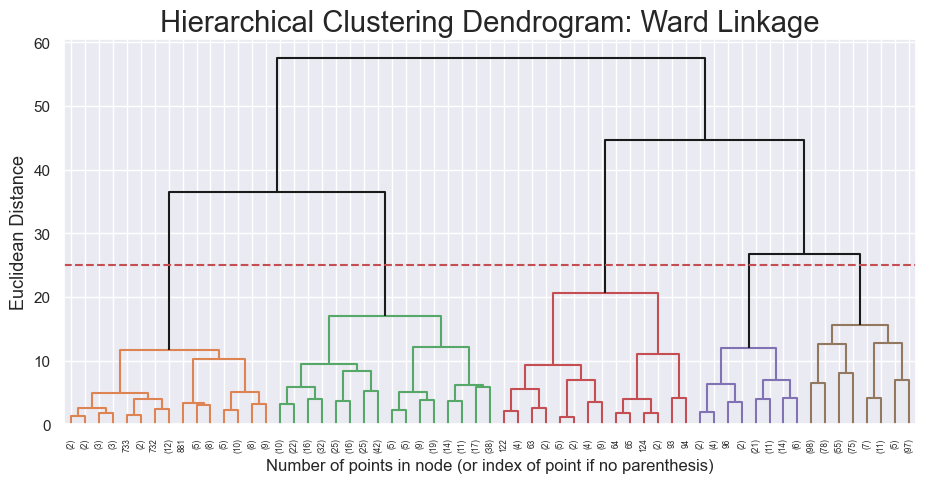

In [467]:
# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 25
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering Dendrogram: {linkage.title()} Linkage', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
plt.show()

Number of clusters: 4
Average Silhouette Score: 0.4039568721890759

Cluster 0: Average Silhouette Score = 0.39145091549990607
Cluster 1: Average Silhouette Score = 0.329072398622556
Cluster 2: Average Silhouette Score = 0.7349514170359923
Cluster 3: Average Silhouette Score = 0.3713398918895021


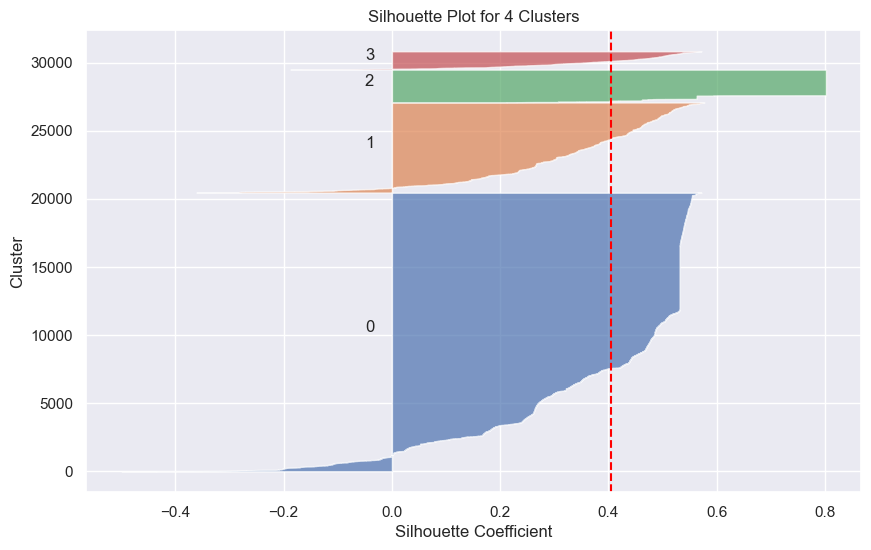

Calinski-Harabasz Index: 18025.39302438391
Davies-Bouldin Index: 0.8442502933433723

Number of clusters: 5
Average Silhouette Score: 0.4051556513308098

Cluster 0: Average Silhouette Score = 0.7011899553054598
Cluster 1: Average Silhouette Score = 0.3146639632996738
Cluster 2: Average Silhouette Score = 0.39851512643234915
Cluster 3: Average Silhouette Score = 0.3713398918895021
Cluster 4: Average Silhouette Score = 0.4604592184708883


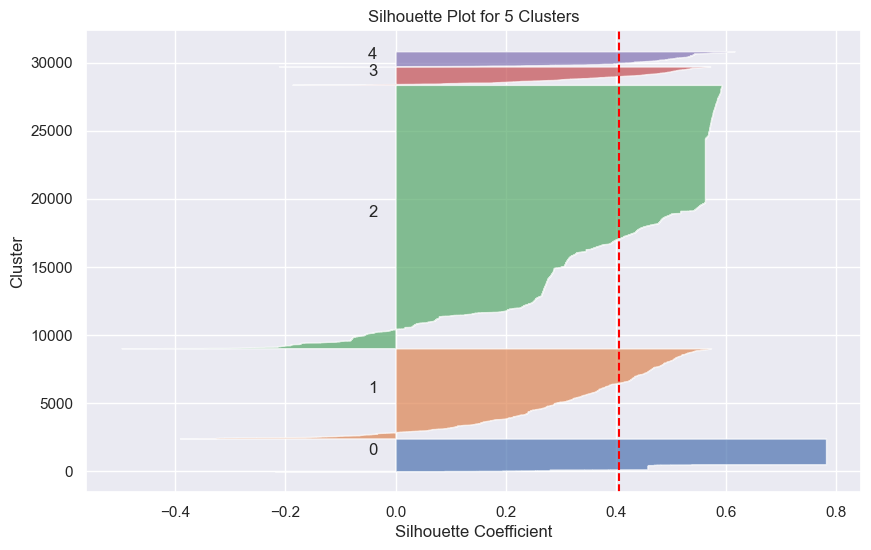

Calinski-Harabasz Index: 16489.51820763135
Davies-Bouldin Index: 0.8336143949585425

Number of clusters: 6
Average Silhouette Score: 0.404598470986236

Cluster 0: Average Silhouette Score = 0.3146639632996738
Cluster 1: Average Silhouette Score = 0.45553717927910153
Cluster 2: Average Silhouette Score = 0.3901482295625925
Cluster 3: Average Silhouette Score = 0.3713398918895021
Cluster 4: Average Silhouette Score = 0.6814621367843571
Cluster 5: Average Silhouette Score = 0.7665011316410119


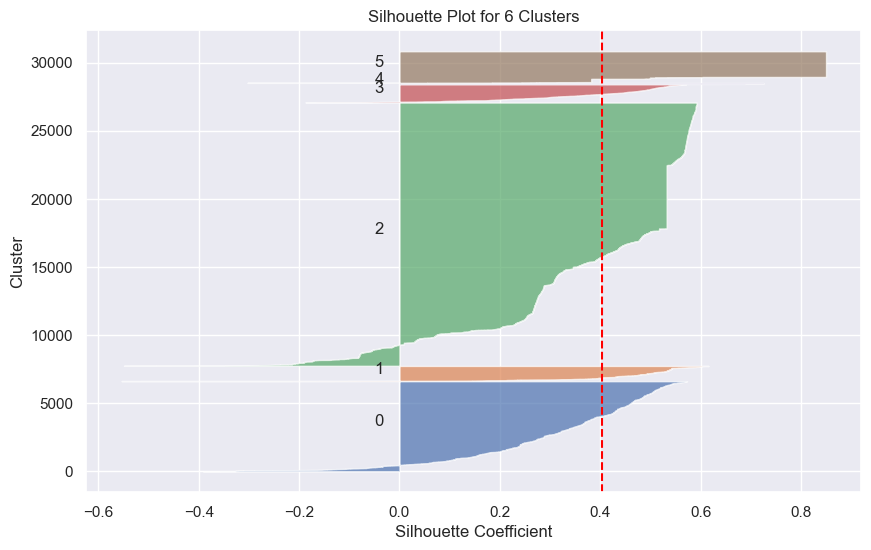

Calinski-Harabasz Index: 14535.899681144285
Davies-Bouldin Index: 0.748340359038079

Number of clusters: 7
Average Silhouette Score: 0.3267872250559808

Cluster 0: Average Silhouette Score = 0.3041269132676831
Cluster 1: Average Silhouette Score = 0.44189946890418924
Cluster 2: Average Silhouette Score = 0.14421905893949624
Cluster 3: Average Silhouette Score = 0.21602509076947812
Cluster 4: Average Silhouette Score = 0.6814621367843571
Cluster 5: Average Silhouette Score = 0.7665011316410119
Cluster 6: Average Silhouette Score = 0.2930330416068055


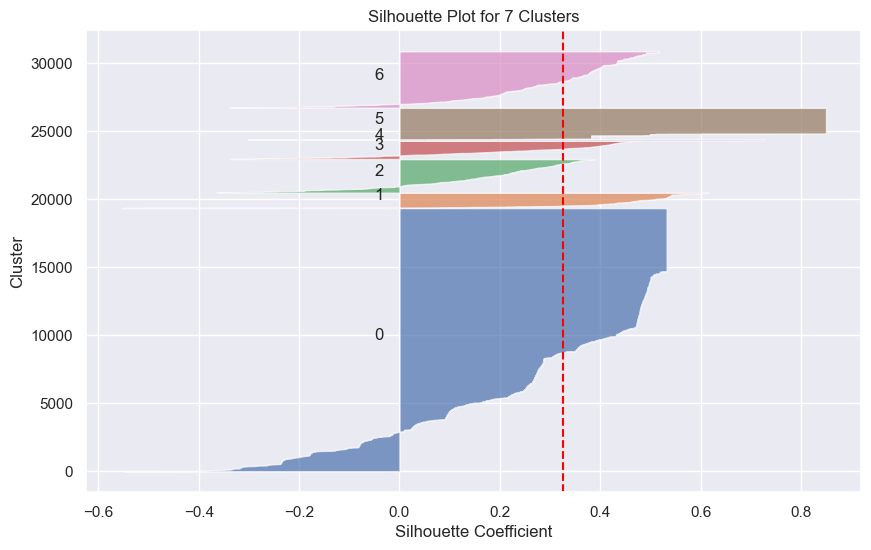

Calinski-Harabasz Index: 13307.410798226894
Davies-Bouldin Index: 0.98628890561414



In [468]:
# Define the range of clusters to test
cluster_range = [4, 5, 6, 7]


# Run Agglomerative Clustering for each value in the cluster range
for n_clusters in cluster_range:
    hc_model = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    nodeclus_labels = hc_model.fit_predict(weights)
    hclust_matrix = nodeclus_labels.reshape((M,N))

    bmu_index = np.array([sm.winner(x) for x in data[perspective4].values])
    som_final_labels = [hclust_matrix[i[0]][i[1]] for i in bmu_index]

    df_final = pd.concat([data,
                    pd.Series(som_final_labels, name='label', index=data.index)], axis=1)
    
    silhouette_analysis(df_final[perspective4], np.array(som_final_labels), n_clusters)
    evaluate_clustering_metrics(df_final[perspective4], np.array(som_final_labels))

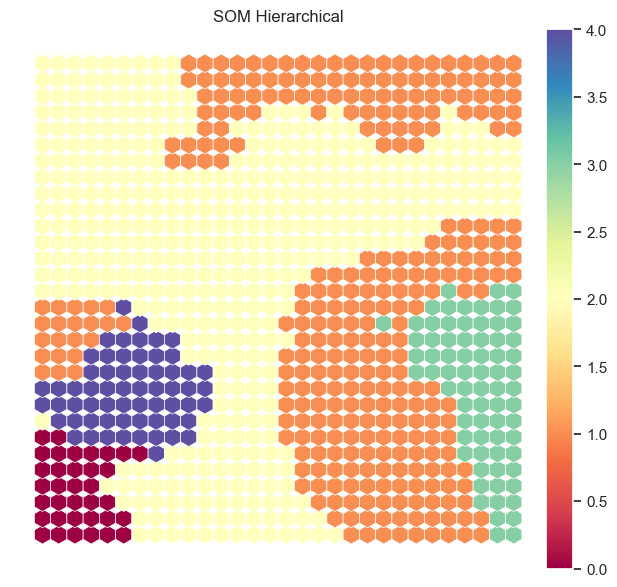

In [469]:
figsize=(10,7)

# Perform Hierarchical clustering on top of the MxN units 
hierclust = AgglomerativeClustering(n_clusters=5, linkage='ward')
nodeclus_labels = hierclust.fit_predict(weights)
hclust_matrix = nodeclus_labels.reshape((M,N))

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hclust_matrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    hclust_matrix,
                    label="SOM Hierarchical",
                    cmap=cm.Spectral,
                    )

In [470]:
# Check the nodes and and respective clusters
nodes = weights

df_nodes = pd.DataFrame(nodes, columns=perspective4)
df_nodes['label'] = nodeclus_labels

bmu_index = np.array([sm.winner(x) for x in data[perspective4].values])
som_final_labels = [hclust_matrix[i[0]][i[1]] for i in bmu_index]

df_final = pd.concat([data,
                pd.Series(som_final_labels, name='label', index=data.index)], axis=1)

# Characterizing the final clusters
df_final[perspective4+['label']].groupby('label').mean()

,vendor_count,products_per_order,total_orders,different_weekdays,purchase_frequency
label,,,,,
0,-0.810280,2.065764,-0.786371,-1.022915,2.696253
1,0.826165,-0.079920,0.861674,1.206293,-0.461996
2,-0.373184,-0.350468,-0.406189,-0.436632,-0.135841
3,2.965387,-0.056649,3.251628,2.331101,-0.320048
4,-0.245465,2.178440,-0.278997,-0.180735,-0.326316


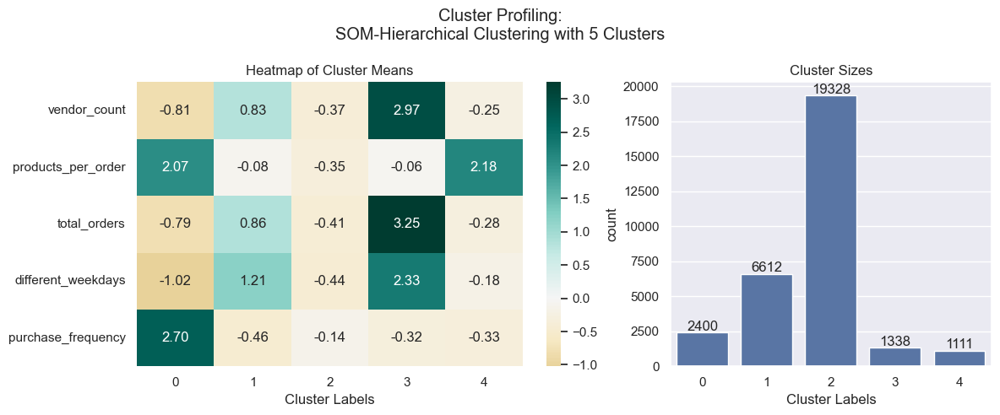

In [471]:
# Define figure and axes
fig, axes = plt.subplots(1, 2, figsize=(12, 5), width_ratios=[0.6, 0.4], tight_layout=True)

# Heatmap for cluster means
hc_profile = df_final[perspective4 + ['label']].groupby('label').mean().T
sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0])
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")

# Countplot for cluster sizes
sns.countplot(data=df_final, x='label', ax=axes[1])

# Annotate counts above bars
for bar in axes[1].patches:
    count = int(bar.get_height())  # Get the height of each bar
    axes[1].annotate(f"{count}", 
                     xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()),  # Position at the top of the bar
                     xytext=(0, 5),  # Offset text by 5 points
                     textcoords="offset points",
                     ha='center', va='center')

axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

# Add an overall title
fig.suptitle("Cluster Profiling:\nSOM-Hierarchical Clustering with 5 Clusters")
plt.show()

In [472]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(df_final[perspective4])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = df_final[perspective4 + ["label"]].groupby(by='label').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(df_final)  # Total number of data points
k = df_final['label'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.6818
Adjusted R²: 0.6817


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\3670559463.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



#### 4.4.3.2 SOM - K-Means

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Wi

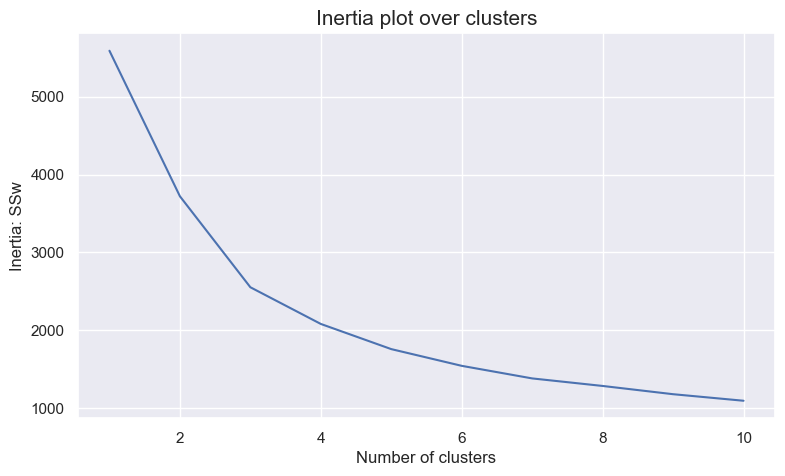

In [473]:
range_clusters = range(1, 11)

inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit_predict(weights)
    inertia.append(kmclust.inertia_)

# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(range_clusters, inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



Number of clusters: 4
Average Silhouette Score: 0.40160585456480263

Cluster 0: Average Silhouette Score = 0.36431670605530453
Cluster 1: Average Silhouette Score = 0.30297119655763366
Cluster 2: Average Silhouette Score = 0.7148812157591303
Cluster 3: Average Silhouette Score = 0.38497627978070914


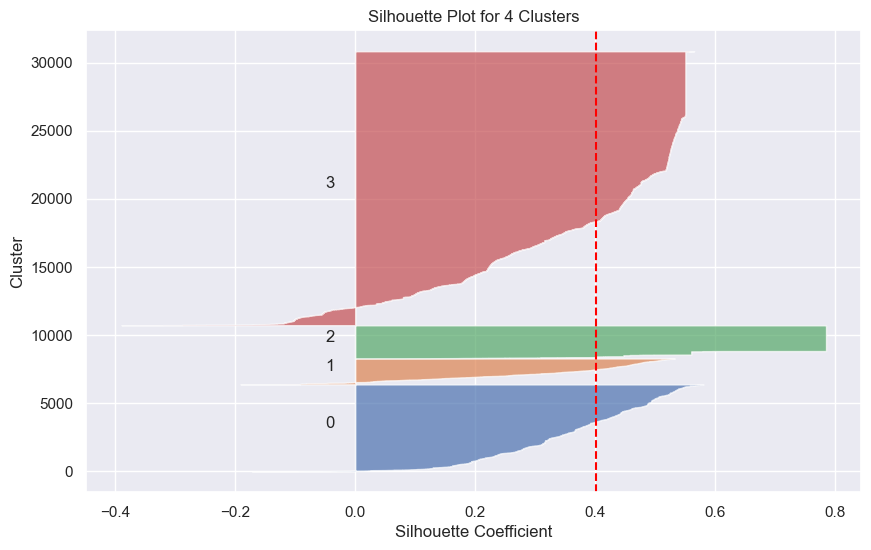

Calinski-Harabasz Index: 19339.334174411608
Davies-Bouldin Index: 0.8620897310847243



c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



Number of clusters: 5
Average Silhouette Score: 0.37946523952160216

Cluster 0: Average Silhouette Score = 0.27232792728732763
Cluster 1: Average Silhouette Score = 0.3769878415151642
Cluster 2: Average Silhouette Score = 0.28985944228595206
Cluster 3: Average Silhouette Score = 0.3726606741951667
Cluster 4: Average Silhouette Score = 0.41227334188568987


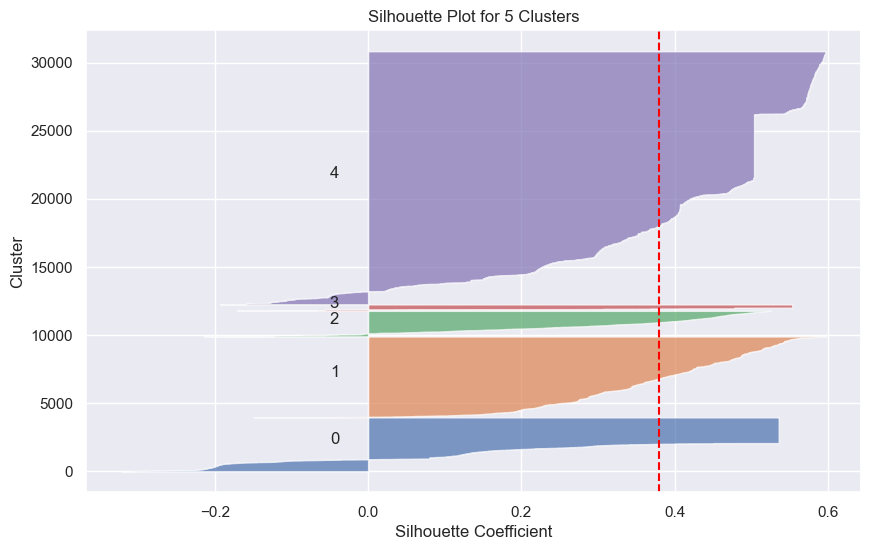

Calinski-Harabasz Index: 15277.93489743785
Davies-Bouldin Index: 0.9985501077582611



c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



Number of clusters: 6
Average Silhouette Score: 0.39426392520662884

Cluster 0: Average Silhouette Score = 0.30900479222523436
Cluster 1: Average Silhouette Score = 0.3812404059076345
Cluster 2: Average Silhouette Score = 0.5965343654262476
Cluster 3: Average Silhouette Score = 0.6555334408219745
Cluster 4: Average Silhouette Score = 0.35412826417263765
Cluster 5: Average Silhouette Score = 0.3590744986182407


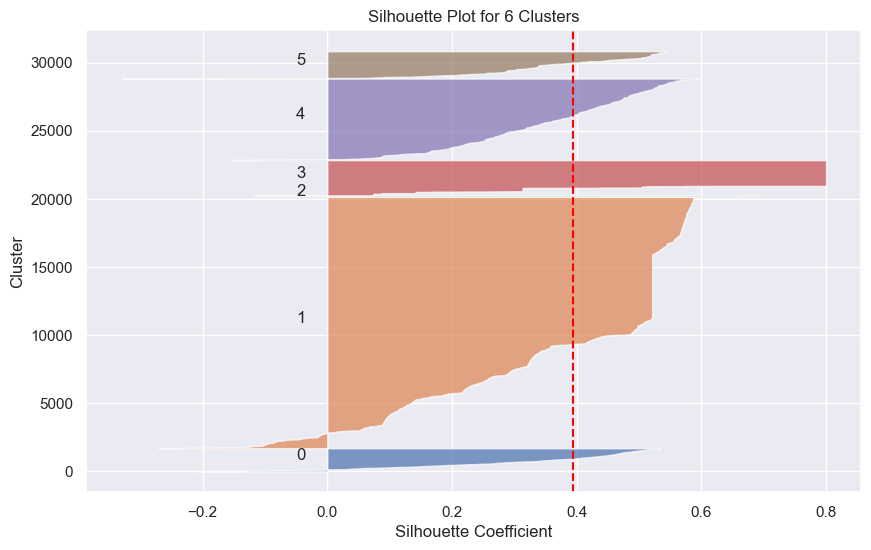

Calinski-Harabasz Index: 15833.14977286061
Davies-Bouldin Index: 0.7915693361958356



c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



Number of clusters: 7
Average Silhouette Score: 0.3591279463277894

Cluster 0: Average Silhouette Score = 0.3338629907590682
Cluster 1: Average Silhouette Score = 0.22367006904277562
Cluster 2: Average Silhouette Score = 0.5918706446051899
Cluster 3: Average Silhouette Score = 0.33473836074378516
Cluster 4: Average Silhouette Score = 0.3389918198678777
Cluster 5: Average Silhouette Score = 0.3160930237563481
Cluster 6: Average Silhouette Score = 0.7586283729168268


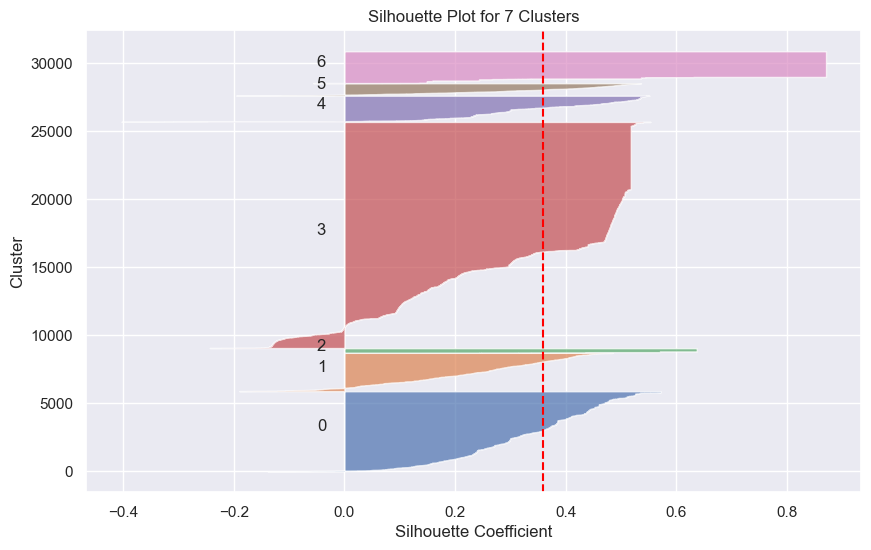

Calinski-Harabasz Index: 16453.56516628711
Davies-Bouldin Index: 0.8843417472885069



In [474]:
# Define the range of clusters to test
cluster_range = [4, 5, 6, 7]


# Run Agglomerative Clustering for each value in the cluster range
for n_clusters in cluster_range:
    kmclust = KMeans(n_clusters=n_clusters, init='k-means++', n_init=15, random_state=1)
    nodeclus_labels = kmclust.fit_predict(weights)
    hclust_matrix = nodeclus_labels.reshape((M,N))

    bmu_index = np.array([sm.winner(x) for x in data[perspective4].values])
    som_final_labels = [hclust_matrix[i[0]][i[1]] for i in bmu_index]

    df_final = pd.concat([data,
                    pd.Series(som_final_labels, name='label', index=data.index)], axis=1)
    
    silhouette_analysis(df_final[perspective4], np.array(som_final_labels), n_clusters)
    evaluate_clustering_metrics(df_final[perspective4], np.array(som_final_labels))

##### Clusters = 5

c:\Users\rbern\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.



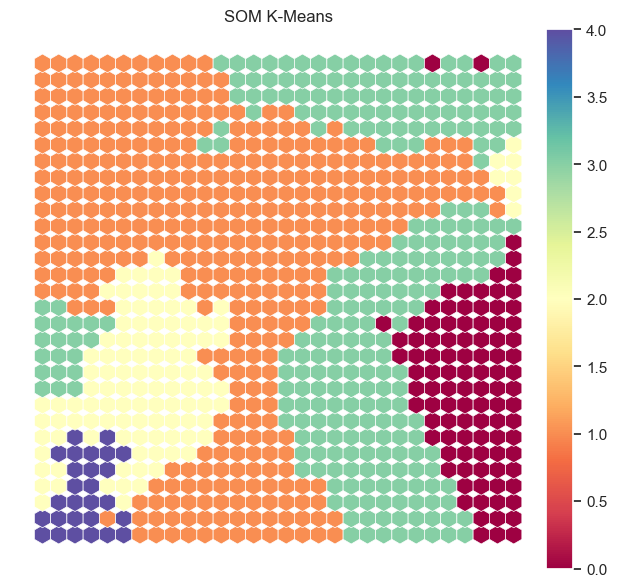

In [475]:
kmeans = KMeans(n_clusters=5, init='k-means++', n_init=20, random_state=42)
nodeclus_labels = kmeans.fit_predict(weights)
nodeclus_labels

kmeans_matrix = nodeclus_labels.reshape((M,N))

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(kmeans_matrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    kmeans_matrix,
                    label="SOM K-Means",
                    cmap=cm.Spectral,
                    )

In [476]:
# Check the nodes and and respective clusters
nodes = weights

df_nodes = pd.DataFrame(nodes, columns=perspective4)
df_nodes['label'] = nodeclus_labels

bmu_index = np.array([sm.winner(x) for x in data[perspective4].values])
som_final_labels = [kmeans_matrix[i[0]][i[1]] for i in bmu_index]

df_final = pd.concat([data,
                pd.Series(som_final_labels, name='label', index=data.index)], axis=1)

# Characterizing the final clusters
df_final[perspective4+['label']].groupby('label').mean()

,vendor_count,products_per_order,total_orders,different_weekdays,purchase_frequency
label,,,,,
0,2.722759,-0.043403,2.852800,2.171083,-0.343774
1,-0.404822,-0.424422,-0.422440,-0.435662,-0.132959
2,-0.497802,1.646625,-0.513530,-0.564321,0.991933
3,0.796649,-0.041509,0.820290,1.134884,-0.476492
4,-0.721690,3.683497,-0.709158,-1.014926,4.368894


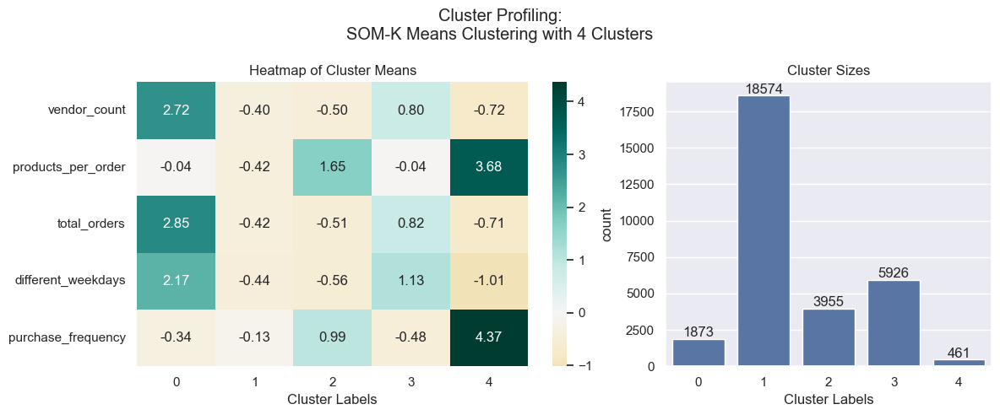

In [477]:
# Define figure and axes
fig, axes = plt.subplots(1, 2, figsize=(12, 5), width_ratios=[0.6, 0.4], tight_layout=True)

# Heatmap for cluster means
km_profile = df_final[perspective4 + ['label']].groupby('label').mean().T
sns.heatmap(km_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0])
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")

# Countplot for cluster sizes
sns.countplot(data=df_final, x='label', ax=axes[1])

# Annotate counts above bars
for bar in axes[1].patches:
    count = int(bar.get_height())  # Get the height of each bar
    axes[1].annotate(f"{count}", 
                     xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()),  # Position at the top of the bar
                     xytext=(0, 5),  # Offset text by 5 points
                     textcoords="offset points",
                     ha='center', va='center')

axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

# Add an overall title
fig.suptitle("Cluster Profiling:\nSOM-K Means Clustering with 4 Clusters")
plt.show()

In [478]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(df_final[perspective4])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = df_final[perspective4 + ["label"]].groupby(by='label').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(df_final)  # Total number of data points
k = df_final['label'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.6650
Adjusted R²: 0.6650


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\3670559463.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



### 4.4.4 Density Clustering

In [479]:
# defines the size of the neighborhood around each data point when forming clusters
# It determines how far the algorithm will look to consider data points as part of the same cluster.
# A small bandwidth results in many small clusters (high granularity), while a large bandwidth results in fewer, broader clusters.
bandwidth = estimate_bandwidth(data[perspective4], quantile=0.2, random_state=1, n_jobs=-1)
bandwidth

1.6697973142480298

In [480]:
# Perform mean-shift clustering with bandwidth set using estimate_bandwidth
ms = MeanShift(bandwidth=bandwidth, bin_seeding=True, n_jobs=4)
ms_labels = ms.fit_predict(data[perspective4])

ms_n_clusters = len(np.unique(ms_labels))
print("Number of estimated clusters : %d" % ms_n_clusters)

Number of estimated clusters : 19


In [481]:
# Concatenating the labels to df
df_concat = pd.concat([data[perspective4], pd.Series(ms_labels, index=data.index, name="ms_labels")], axis=1)

In [482]:
df_concat[perspective4+['ms_labels']].groupby('ms_labels').mean()

,vendor_count,products_per_order,total_orders,different_weekdays,purchase_frequency
ms_labels,,,,,
0,-0.111751,-0.206859,-0.128075,-0.047716,-0.246008
1,-0.786867,1.801607,-0.766050,-0.952822,2.062654
2,-0.446100,-0.008144,-0.470433,-0.760361,2.420664
3,-0.829471,4.042630,-0.805206,-1.017842,3.793733
4,-1.245885,-3.042557,-1.070467,-1.613809,-0.722013
5,-0.833792,6.465132,-0.809117,-1.026629,5.303105
6,-0.400995,1.534364,-0.403999,-1.017927,5.771040
7,-0.842398,8.814091,-0.814575,-1.038892,6.845079
8,-0.343711,4.667313,-0.266892,-0.215677,-0.057829


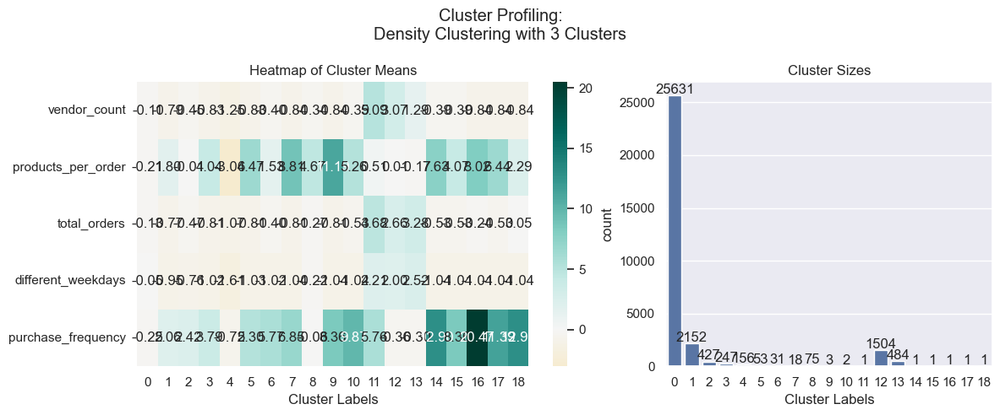

In [483]:
# Define figure and axes
fig, axes = plt.subplots(1, 2, figsize=(12, 5), width_ratios=[0.6, 0.4], tight_layout=True)

# Heatmap for cluster means
den_profile = df_concat[perspective4+['ms_labels']].groupby('ms_labels').mean().T
sns.heatmap(den_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0])
axes[0].set_xlabel("Cluster Labels")
axes[0].set_title("Heatmap of Cluster Means")

# Countplot for cluster sizes
sns.countplot(data=df_concat, x='ms_labels', ax=axes[1])

# Annotate counts above bars
for bar in axes[1].patches:
    count = int(bar.get_height())  # Get the height of each bar
    axes[1].annotate(f"{count}", 
                     xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()),  # Position at the top of the bar
                     xytext=(0, 5),  # Offset text by 5 points
                     textcoords="offset points",
                     ha='center', va='center')

axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

# Add an overall title
fig.suptitle("Cluster Profiling:\nDensity Clustering with 3 Clusters")
plt.show()

In [484]:
# Computing the R^2 of the cluster solution
sst = get_ss_2(data[perspective4])  # get total sum of squares
ssw_labels = df_concat.groupby(by='ms_labels').apply(get_ss_2)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
print("Cluster solution with R^2 of %0.4f" % r2)

Cluster solution with R^2 of 0.5768


C:\Users\rbern\AppData\Local\Temp\ipykernel_20300\1010977528.py:3: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



## 4.5 Multiple Perspectives

In [156]:
perspective2 = ['total_spend', 'spent_top_cuisine', 'diversity_cuisine_types', 'spent_main_food', 'spent_beverages_addons']
perspective3 = ['breakfast_orders', 'lunch_snack_orders', 'dinner_orders', 'night_orders', 'startweek_orders']
perspective4 = ['vendor_count', 'products_per_order', 'total_orders', 'different_weekdays', 'purchase_frequency']

In [157]:
df_spend = data[perspective2].copy()
df_temporal = data[perspective3].copy()
df_order = data[perspective4].copy()

#### Spend

In [158]:
cluster_spend = AgglomerativeClustering(n_clusters=5, linkage='ward')
labels_spend = cluster_spend.fit_predict(df_spend) 

#### Temporal

In [159]:
cluster_temporal = KMeans(n_clusters=5, init='k-means++', n_init=15, random_state=1)
cluster_temporal.fit(df_temporal)
labels_temporal = cluster_temporal.predict(df_temporal)

#### Order

In [160]:
cluster_order = KMeans(n_clusters=5, init='k-means++', n_init=15, random_state=1)
cluster_order.fit(df_order)
labels_order = cluster_order.predict(df_order)

### 4.5.1 Merging Perspectives

In [161]:
# Applying the right clustering (algorithm and number of clusters) for each perspective
data['labels_spend'] = labels_spend
data['labels_temporal'] = labels_temporal
data['labels_order'] = labels_order

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\73755678.py:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\73755678.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\73755678.py:4: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame,

In [162]:
# Count label frequencies (contigency table)
crosstab_result = pd.crosstab(
    index=[data['labels_spend'], data['labels_order']],
    columns=data['labels_temporal']
)
crosstab_result

labels_temporal              0     1     2    3     4
labels_spend labels_order                            
0            0             261   572   691  313  1567
             1              87   252   294  174   387
             2               1     3    12    7     9
             3               1     1     2    1     1
             4             169   240   247   69  1077
1            0              40    52    28   18   172
             1             335   635   538  205   854
             2              26    84    20    6   123
             3              63   330    64   24   203
             4               0     0     0    0     3
2            0              32    52   157   31   148
             1             166   406   709  289   513
             2              14   148   188   68   264
             3              40   139   303  113   275
             4               1     3     6    1    14
3            0               3    14    21   14    63
             1             222   749   520  410   848
             2              91   326   272  225   488
             3             255   918   738  441  1419
             4               0     0     0    0     2
4            0             160   346   373  240  1018
             1             519  1474  1087  704  1962
             2              18    29    49   41    46
             3              23    70    51   33    62
             4               8    12    12    3    69

In [163]:
# using all features to calculate the mean 
total_features = perspective2 + perspective3 + perspective4

In [164]:
# Centroids of the concatenated cluster labels
data_centroids = data.groupby(['labels_spend', 'labels_temporal', 'labels_order'])[total_features].mean()
data_centroids

total_spend  spent_top_cuisine  \
labels_spend labels_temporal labels_order                                   
0            0               0                0.187823          -1.195322   
                             1               -0.249272          -1.155069   
                             2                3.083259          -0.467887   
                             3               -0.657051          -1.492622   
                             4                1.046453          -1.370625   
...                                                ...                ...   
4            4               0                0.468948          -0.293606   
                             1               -0.252270          -0.339638   
                             2                0.379058           0.227682   
                             3               -0.571691          -0.247276   
                             4                1.135112          -0.029337   

                                           diversity_cuisine_types  \
labels_spend labels_temporal labels_order                            
0            0               0                            1.436303   
                             1                            0.740515   
                             2                           -0.136178   
                             3                            0.590225   
                             4                            2.614697   
...                                                            ...   
4            4               0                            0.242721   
                             1                            0.022653   
                             2                           -0.262509   
                             3                           -0.089314   
                             4                            0.527059   

                                           spent_main_food  \
labels_spend labels_temporal labels_order                    
0            0               0                   -0.018863   
                             1                   -0.195125   
                             2                   -0.262489   
                             3                   -0.347357   
                             4                    0.007950   
...                                                    ...   
4            4               0                    0.597641   
                             1                    0.682870   
                             2                    0.721701   
                             3                    0.693253   
                             4                    0.544226   

                                           spent_beverages_addons  \
labels_spend labels_temporal labels_order                           
0            0               0                          -0.150543   
                             1                          -0.146157   
                             2                           0.622809   
                             3                          -0.554992   
                             4                          -0.106669   
...                                                           ...   
4            4               0                          -0.512073   
                             1                          -0.533610   
                             2                          -0.543937   
                             3                          -0.554992   
                             4                          -0.489793   

                                           breakfast_orders  \
labels_spend labels_temporal labels_order                     
0            0               0                    -0.422942   
                             1                    -0.337885   
                             2                     0.392857   
                             3                     0.392857   
                             4                 

### 4.5.2 Merging using Hierarchical Clustering

##### R squared

In [165]:
hc_methods = ["ward"]
max_nclus = 10

r2_hc = np.vstack([get_r2_hc(data_centroids, 
                              link, 
                              max_nclus=max_nclus, 
                              min_nclus=1, 
                              dist="euclidean") 
                              for link in hc_methods])

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\156999461.py:7: UserWarning:

The markers list has more values (4) than needed (1), which may not be intended.



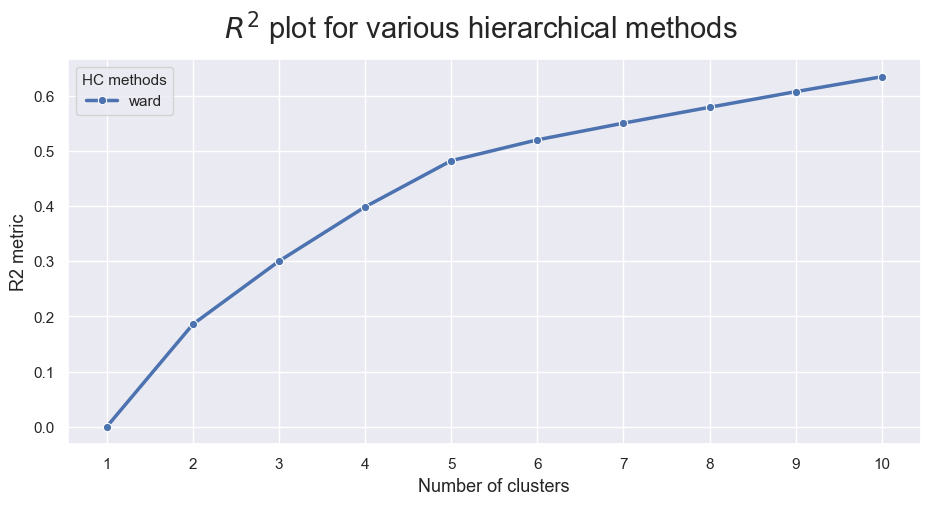

In [166]:
r2_hc_methods = pd.DataFrame(r2_hc.T, index=range(1, max_nclus + 1), columns=hc_methods)

sns.set()

# Plot data
fig = plt.figure(figsize=(11,5))
sns.lineplot(data=r2_hc_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
plt.legend(title="HC methods", title_fontsize=11)
plt.xticks(range(1, max_nclus + 1))
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)

fig.suptitle("$R^2$ plot for various hierarchical methods", fontsize=21)

plt.show()

##### Dendogram

In [167]:
# Using Hierarchical clustering to merge the concatenated cluster centroids
linkage = 'ward'
hclust = AgglomerativeClustering(
    linkage=linkage, 
    metric='euclidean', 
    distance_threshold=0, 
    n_clusters=None
)

hclust_labels = hclust.fit_predict(data_centroids)

In [168]:
# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

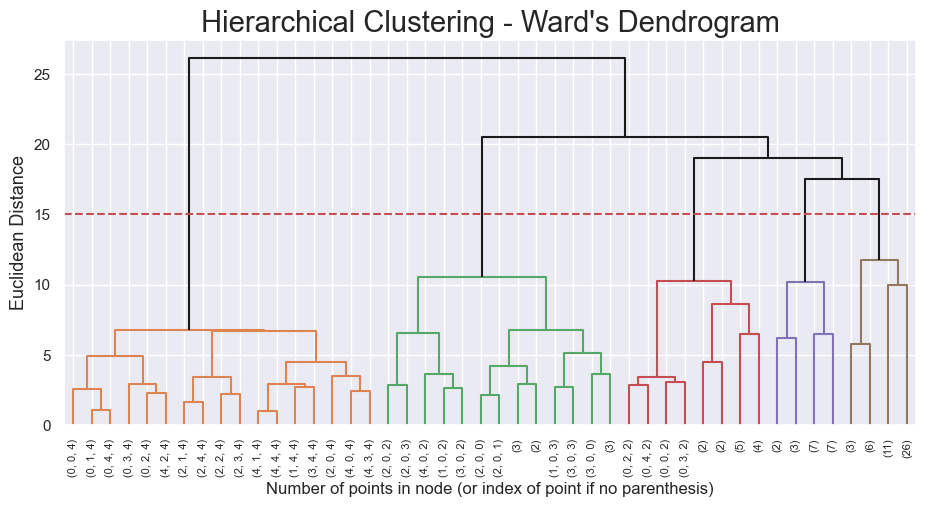

In [169]:
# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned

y_threshold = 15
# y_threshold = 3.3

dendrogram(linkage_matrix, 
           truncate_mode='level', 
           labels=data_centroids.index, p=5, 
           color_threshold=y_threshold, 
           above_threshold_color='k')

plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'Euclidean Distance', fontsize=13)
plt.show()

#### Final Solution

In [170]:
# Re-running the Hierarchical clustering based on the correct number of clusters

# The number os clusters of the dendogram above 
number_of_clusters = 5

hclust = AgglomerativeClustering(
    linkage='ward', 
    metric='euclidean', 
    n_clusters= number_of_clusters 
)

hclust_labels = hclust.fit_predict(data_centroids)
data_centroids['hclust_labels'] = hclust_labels

data_centroids  # centroid's cluster labels

total_spend  spent_top_cuisine  \
labels_spend labels_temporal labels_order                                   
0            0               0                0.187823          -1.195322   
                             1               -0.249272          -1.155069   
                             2                3.083259          -0.467887   
                             3               -0.657051          -1.492622   
                             4                1.046453          -1.370625   
...                                                ...                ...   
4            4               0                0.468948          -0.293606   
                             1               -0.252270          -0.339638   
                             2                0.379058           0.227682   
                             3               -0.571691          -0.247276   
                             4                1.135112          -0.029337   

                                           diversity_cuisine_types  \
labels_spend labels_temporal labels_order                            
0            0               0                            1.436303   
                             1                            0.740515   
                             2                           -0.136178   
                             3                            0.590225   
                             4                            2.614697   
...                                                            ...   
4            4               0                            0.242721   
                             1                            0.022653   
                             2                           -0.262509   
                             3                           -0.089314   
                             4                            0.527059   

                                           spent_main_food  \
labels_spend labels_temporal labels_order                    
0            0               0                   -0.018863   
                             1                   -0.195125   
                             2                   -0.262489   
                             3                   -0.347357   
                             4                    0.007950   
...                                                    ...   
4            4               0                    0.597641   
                             1                    0.682870   
                             2                    0.721701   
                             3                    0.693253   
                             4                    0.544226   

                                           spent_beverages_addons  \
labels_spend labels_temporal labels_order                           
0            0               0                          -0.150543   
                             1                          -0.146157   
                             2                           0.622809   
                             3                          -0.554992   
                             4                          -0.106669   
...                                                           ...   
4            4               0                          -0.512073   
                             1                          -0.533610   
                             2                          -0.543937   
                             3                          -0.554992   
                             4                          -0.489793   

                                           breakfast_orders  \
labels_spend labels_temporal labels_order                     
0            0               0                    -0.422942   
                             1                    -0.337885   
                             2                     0.392857   
                             3                     0.392857   
                             4                 

In [171]:
# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = data_centroids['hclust_labels'].to_dict()

In [172]:
# Mapping the hierarchical clusters on the centroids to the observations
data['HC_merged_labels'] = data.apply(
    lambda row: cluster_mapper[
        (row['labels_spend'], row['labels_temporal'],  row['labels_order'])], axis=1)

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\1228536198.py:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [173]:
# Merged cluster centroids
data.groupby('HC_merged_labels').mean(numeric_only=True)[total_features]

,total_spend,spent_top_cuisine,diversity_cuisine_types,spent_main_food,spent_beverages_addons,breakfast_orders,lunch_snack_orders,dinner_orders,night_orders,startweek_orders,vendor_count,products_per_order,total_orders,different_weekdays,purchase_frequency
HC_merged_labels,,,,,,,,,,,,,,,
0,-0.124454,-0.025265,-0.071323,0.012897,-0.029827,0.083509,0.256245,-0.264790,-0.322760,-0.018283,-0.117900,-0.223500,-0.119966,-0.055507,-0.218348
1,-0.148431,0.968969,-0.795875,-0.361087,0.390301,0.144144,0.306475,-0.349315,-0.390310,-0.106485,-0.784198,2.178300,-0.760608,-0.976697,2.549392
2,-0.463556,-0.000811,-0.061533,0.000427,-0.134239,-0.501304,-0.817265,2.983079,-0.258935,0.043271,-0.143794,-0.077206,-0.197835,-0.110533,-0.096934
3,1.689977,-1.192757,2.235888,-0.030950,-0.102451,-0.110550,0.168730,0.143999,-0.215265,0.124657,2.659754,-0.041344,2.848509,2.175728,-0.345060
4,0.223985,0.250401,-0.308564,0.159448,0.100202,-0.198188,-1.324626,-0.298415,2.578374,0.078350,-0.209826,0.139141,-0.282492,-0.227188,0.066918


In [174]:
# Merge cluster contigency table
# Getting size of each final cluster
data_counts = data.groupby('HC_merged_labels')\
    .size()\
    .to_frame()
data_counts

,0
HC_merged_labels,
0,21079
1,2069
2,2355
3,1936
4,3350


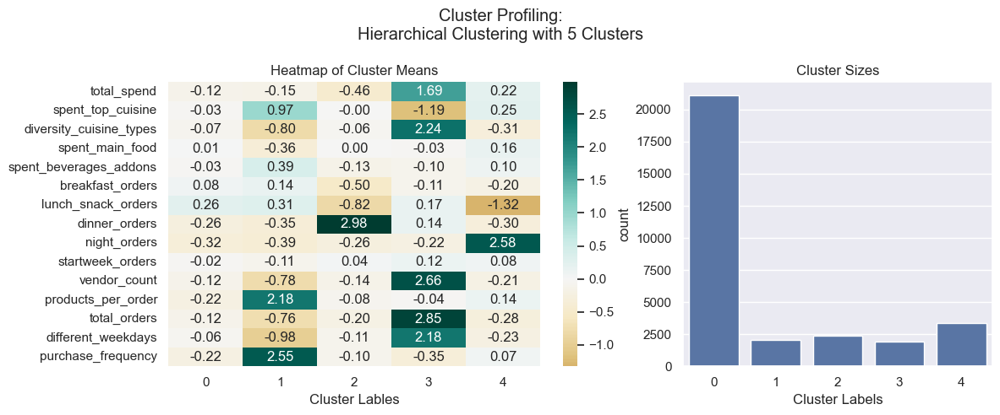

In [175]:
label_counts = None 

fig, axes = plt.subplots(1,2, figsize=(12,5), width_ratios=[.6,.4], tight_layout=True)

data_concat = pd.concat([
    data[total_features], 
    pd.Series(data['HC_merged_labels'], name='HC_merged_labels', index=data.index)
    ], 
    axis=1)

hc_profile = data_concat.groupby('HC_merged_labels').mean().T

sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0]
            )
axes[0].set_xlabel("Cluster Lables")
axes[0].set_title("Heatmap of Cluster Means")


sns.countplot(data_concat, x='HC_merged_labels', ax=axes[1])
axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

fig.suptitle("Cluster Profiling:\nHierarchical Clustering with 5 Clusters")
plt.show()

Number of clusters: 5
Average Silhouette Score: 0.19312601496719448

Cluster 0: Average Silhouette Score = 0.17019818550918822
Cluster 1: Average Silhouette Score = 0.23536809272375786
Cluster 2: Average Silhouette Score = 0.19554424423794955
Cluster 3: Average Silhouette Score = 0.389156366046934
Cluster 4: Average Silhouette Score = 0.1963162145624124


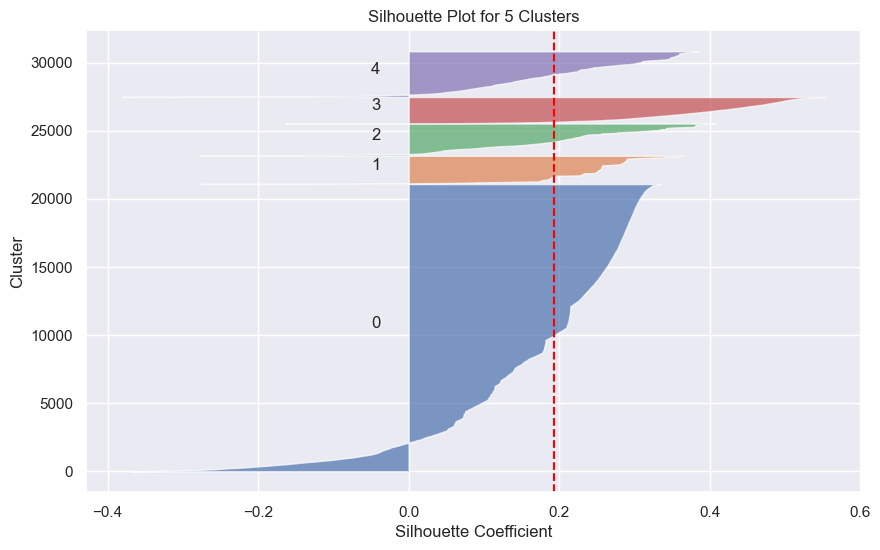

Calinski-Harabasz Index: 3774.6404809878627
Davies-Bouldin Index: 1.5703385511218677



In [176]:
silhouette_analysis(data[total_features], data['HC_merged_labels'], 5)
evaluate_clustering_metrics(data[total_features], data['HC_merged_labels'])

In [177]:
# Compute SST (Total Sum of Squares)
sst = get_ss_2(data[total_features])

# Compute SSW (Sum of Squares Within Clusters) for each label
ssw_labels = data[total_features + ["HC_merged_labels"]].groupby(by='HC_merged_labels').apply(get_ss_2)

# Compute SSB (Sum of Squares Between Clusters)
ssb = sst - np.sum(ssw_labels)

# Calculate R²
r2 = ssb / sst

# Adjusted R²
n = len(data_concat)  # Total number of data points
k = data_concat['HC_merged_labels'].nunique()  # Number of clusters
adjusted_r2 = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Print results
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")

R²: 0.3291
Adjusted R²: 0.3290


C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\1668841608.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



### 4.5.3 Merging using K-Means

c:\Users\bruna\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\2836441436.py:10: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

c:\Users\bruna\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.

c:\Users\bruna\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1

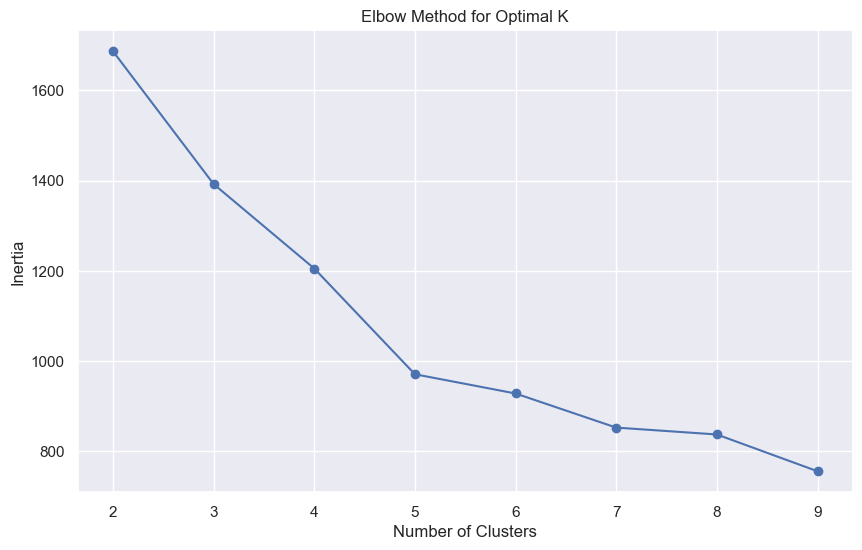

In [178]:
inertia = []
silhouette_scores = []
range_n_clusters = range(2, 10)

for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans_labels = kmeans.fit_predict(data_centroids)
    data_centroids['kmeans_labels'] = kmeans_labels
    cluster_mapper = data_centroids['kmeans_labels'].to_dict()
    data['merged_labels'] = data.apply(
        lambda row: cluster_mapper[
            (row['labels_spend'], row['labels_temporal'],  row['labels_order'])], axis=1)

    inertia.append(kmeans.inertia_)

# Plotting the elbow curve
plt.figure(figsize=(10, 6))
plt.plot(range_n_clusters, inertia, marker='o')
plt.title("Elbow Method for Optimal K")
plt.xlabel("Number of Clusters")
plt.ylabel("Inertia")
plt.show()


In [179]:
number_of_clusters = 7  # Determined from the dendrogram or other analysis

kmeans = KMeans(n_clusters=number_of_clusters, random_state=42)
kmeans_labels = kmeans.fit_predict(data_centroids)

data_centroids['kmeans_labels'] = kmeans_labels

c:\Users\bruna\anaconda3\envs\DM2425\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.



In [180]:
# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = data_centroids['kmeans_labels'].to_dict()

data['KM_merged_labels'] = data.apply(
    lambda row: cluster_mapper[
        (row['labels_spend'], row['labels_temporal'],  row['labels_order'])], axis=1)

data.groupby('KM_merged_labels').mean(numeric_only=True)[total_features]

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\1470877026.py:4: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



,total_spend,spent_top_cuisine,diversity_cuisine_types,spent_main_food,spent_beverages_addons,breakfast_orders,lunch_snack_orders,dinner_orders,night_orders,startweek_orders,vendor_count,products_per_order,total_orders,different_weekdays,purchase_frequency
KM_merged_labels,,,,,,,,,,,,,,,
0,-0.185649,0.986603,-0.805965,-0.363889,0.393577,0.139107,0.319664,-0.350843,-0.403645,-0.115052,-0.793656,2.158985,-0.768207,-0.988875,2.572521
1,0.599882,-0.810955,0.840759,0.008606,-0.110856,-0.052592,0.240941,-0.043093,-0.264434,0.065767,0.735650,-0.001383,0.689792,0.956358,-0.480307
2,0.223985,0.250401,-0.308564,0.159448,0.100202,-0.198188,-1.324626,-0.298415,2.578374,0.078350,-0.209826,0.139141,-0.282492,-0.227188,0.066918
3,-0.544745,0.148075,-0.248226,0.002831,-0.132207,-0.511071,-0.844834,3.073781,-0.269961,0.045324,-0.298282,-0.080986,-0.324723,-0.263908,-0.048341
4,-0.489388,0.273875,-0.421027,0.079759,-0.145030,-0.536450,0.787547,-0.295214,-0.380891,-0.118095,-0.457275,-0.330166,-0.428671,-0.452995,-0.106528
5,1.689977,-1.192757,2.235888,-0.030950,-0.102451,-0.110550,0.168730,0.143999,-0.215265,0.124657,2.659754,-0.041344,2.848509,2.175728,-0.345060
6,-0.158668,0.215352,-0.337975,-0.147040,0.351596,1.744380,-1.070893,-0.337147,-0.243952,0.119403,-0.349354,-0.222919,-0.384724,-0.357329,-0.152559


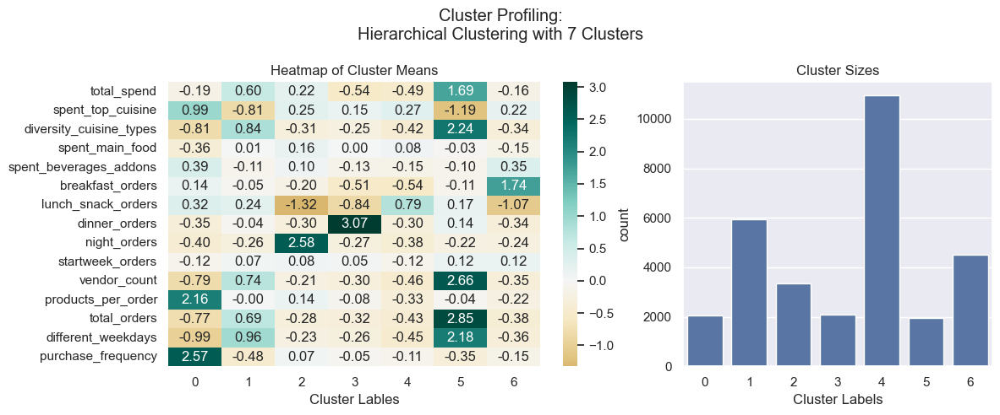

In [183]:
label_counts = None 

fig, axes = plt.subplots(1,2, figsize=(12,5), width_ratios=[.6,.4], tight_layout=True)

data_concat = pd.concat([
    data[total_features], 
    pd.Series(data['KM_merged_labels'], name='KM_merged_labels', index=data.index)
    ], 
    axis=1)

hc_profile = data_concat.groupby('KM_merged_labels').mean().T

sns.heatmap(hc_profile,
            center=0, annot=True, cmap="BrBG", fmt=".2f",
            ax=axes[0]
            )
axes[0].set_xlabel("Cluster Lables")
axes[0].set_title("Heatmap of Cluster Means")


sns.countplot(data_concat, x='KM_merged_labels', ax=axes[1])
axes[1].set_title("Cluster Sizes")
axes[1].set_xlabel("Cluster Labels")

fig.suptitle("Cluster Profiling:\nHierarchical Clustering with 7 Clusters")
plt.show()

Number of clusters: 7
Average Silhouette Score: 0.17670551750839472

Cluster 0: Average Silhouette Score = 0.1398431327228312
Cluster 1: Average Silhouette Score = 0.13875826490413695
Cluster 2: Average Silhouette Score = 0.1304671608705728
Cluster 3: Average Silhouette Score = 0.17273947983974122
Cluster 4: Average Silhouette Score = 0.22067544084070406
Cluster 5: Average Silhouette Score = 0.19424294359985322
Cluster 6: Average Silhouette Score = 0.16535539739932678


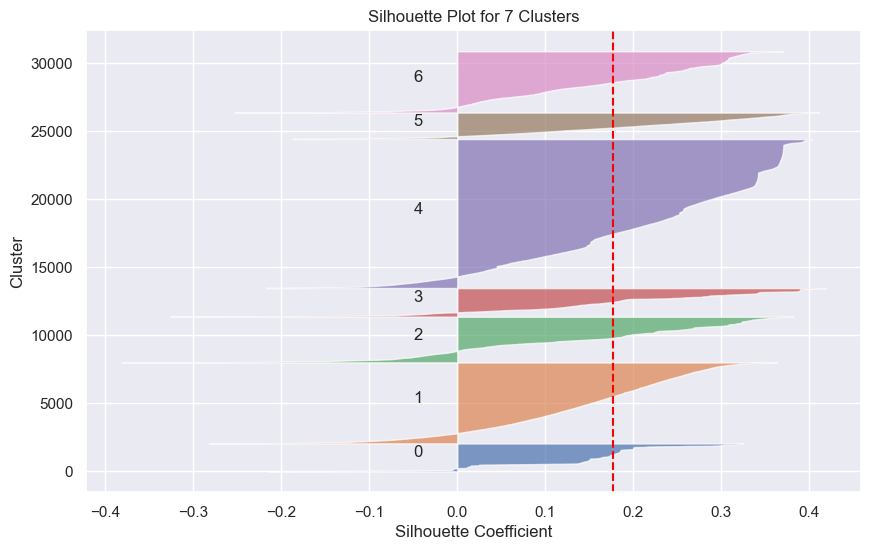

Calinski-Harabasz Index: 4516.282245956316
Davies-Bouldin Index: 1.5688861978226842



In [184]:
silhouette_analysis(data[total_features], data['KM_merged_labels'], 7)
evaluate_clustering_metrics(data[total_features], data['KM_merged_labels'])

In [185]:
# Computing the R^2 of the cluster solution
sst = get_ss_2(data[total_features])  # get total sum of squares
ssw_labels = data_concat.groupby(by='KM_merged_labels').apply(get_ss_2)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
print("Cluster solution with R^2 of %0.4f" % r2)

Cluster solution with R^2 of 0.4682


C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\3248538602.py:3: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



### 4.6.3 Cluster Analysis

In [186]:
data.drop(columns=['merged_labels', 'HC_merged_labels'], inplace=True)

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\2074131698.py:35: UserWarning:

The palette list has more values (10) than needed (5), which may not be intended.

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\2074131698.py:35: UserWarning:

The palette list has more values (10) than needed (5), which may not be intended.

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\2074131698.py:35: UserWarning:

The palette list has more values (10) than needed (5), which may not be intended.

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\2074131698.py:35: UserWarning:

The palette list has more values (10) than needed (7), which may not be intended.



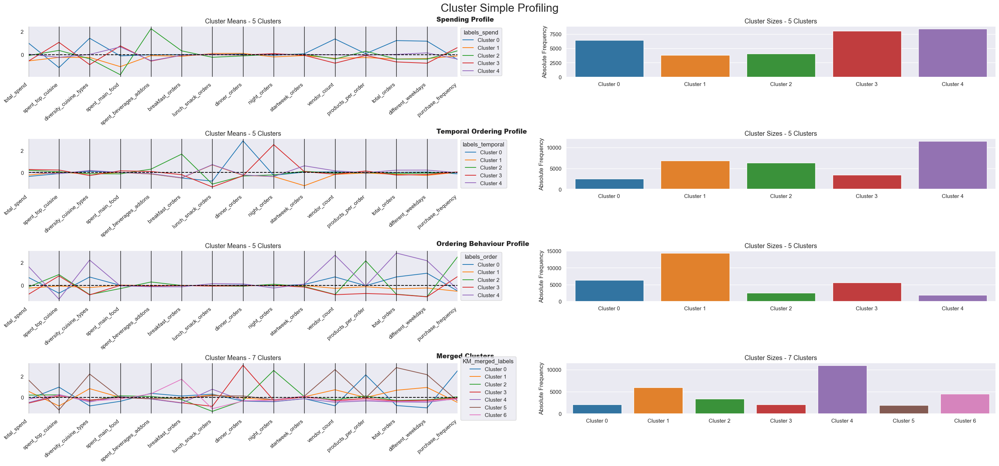

In [187]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = data[total_features + ['labels_spend', 'labels_temporal', 'labels_order', 'KM_merged_labels']], 
    label_columns = ['labels_spend', 'labels_temporal', 'labels_order', 'KM_merged_labels'], 
    figsize = (28, 13), 
    compare_titles = ["Spending Profile", "Temporal Ordering Profile", "Ordering Behaviour Profile", "Merged Clusters"])


In [188]:
two_dim = TSNE(random_state=42).fit_transform(data[total_features])

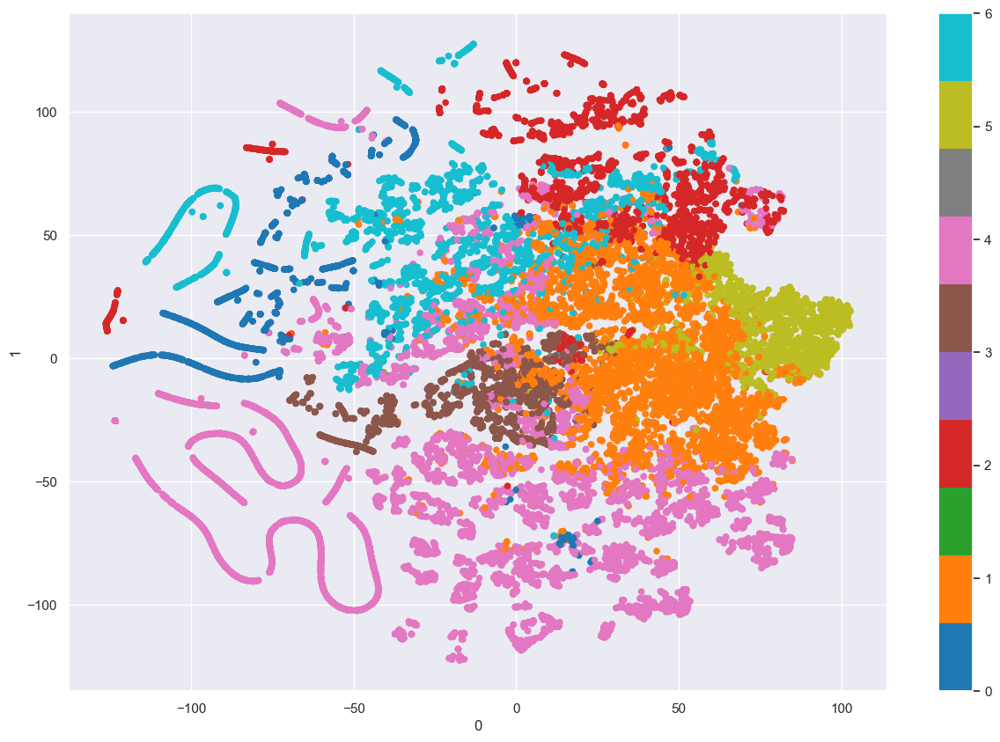

In [189]:
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=data['KM_merged_labels'], colormap='tab10', figsize=(15,10))
plt.show()

# 5. Profiling 

In [190]:
categorical_features

['customer_region',
 'last_promo',
 'payment_method',
 'day_pattern',
 'top_cuisine',
 'age_group']

In [193]:
addfeatures = [
    'last_promo',
    'customer_region',
    'payment_method',
    'age_group',
    'top_cuisine']
selected_features = data_treated[addfeatures]

aligned_features = selected_features.loc[data.index]

# Add the features to df
data = data.join(aligned_features)

In [194]:
merged_counts = data[['KM_merged_labels']].groupby(['KM_merged_labels']).value_counts()
merged_counts

KM_merged_labels
0     2040
1     5938
2     3350
3     2094
4    10935
5     1936
6     4496
Name: count, dtype: int64

#### 5.1 Last Promo

In [191]:
cat_last_promo = [col for col in data.columns if col.startswith('oh_last_promo')]

In [192]:
data_last_promo = data.groupby(['KM_merged_labels'])[cat_last_promo].sum()

data_last_promo

,oh_last_promo_DISCOUNT,oh_last_promo_FREEBIE,oh_last_promo_NO PROMO
KM_merged_labels,,,
0,33.373082,-49.128929,-750.314689
1,-352.386193,-37.120826,1199.426030
2,-59.487710,244.630945,-171.565242
3,180.245485,51.640768,-280.134070
4,345.444275,-322.719490,-95.646717
5,-107.442399,-97.981884,503.006457
6,-39.746539,210.679416,-404.771768


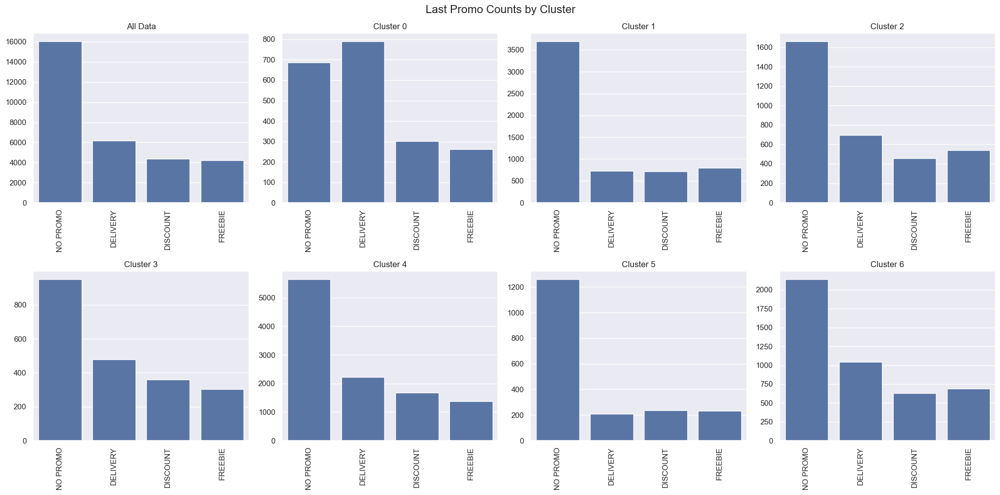

In [195]:
# Determine the number of unique clusters
n_clusters = data['KM_merged_labels'].nunique()

# Create a grid of subplots with 2 rows and 4 columns
fig, axes = plt.subplots(2, 4, figsize=(20, 10), tight_layout=True)

# Flatten axes for easy indexing
axes = axes.flatten()

# Loop through each cluster, including the "All Data" plot
for i in range(len(axes)):
    ax = axes[i]
    if i == 0:  # "All Data" plot
        sns.countplot(data=data, 
                      x='last_promo', 
                      order=data['last_promo'].value_counts().index,
                      ax=ax)
        ax.set_title("All Data")
    elif i <= n_clusters:  # Cluster-specific plots
        sns.countplot(data=data.loc[data['KM_merged_labels'] == i - 1], 
                      x='last_promo', 
                      order=data['last_promo'].value_counts().index,
                      ax=ax)
        ax.set_title(f"Cluster {i - 1}")
    else:  # Empty plots for remaining axes
        ax.axis('off')  # Turn off extra axes

    ax.tick_params(axis="x", labelrotation=90)
    ax.set_xlabel("")
    ax.set_ylabel("")

# Add a global title
plt.suptitle("Last Promo Counts by Cluster", fontsize=16)
plt.show()

In [238]:
# Calculate counts of each last_promo category within each cluster
counts = data.groupby(['KM_merged_labels', 'last_promo']).size().unstack(fill_value=0)
proportions = counts.div(counts.sum(axis=1), axis=0)

proportions

last_promo,DELIVERY,DISCOUNT,FREEBIE,NO PROMO
KM_merged_labels,,,,
0,0.386765,0.148039,0.128431,0.336765
1,0.122432,0.121590,0.134557,0.621421
2,0.207164,0.136119,0.161791,0.494925
3,0.228749,0.172397,0.145177,0.453677
4,0.203932,0.153361,0.126566,0.516141
5,0.107438,0.122934,0.119318,0.650310
6,0.232429,0.139235,0.152802,0.475534


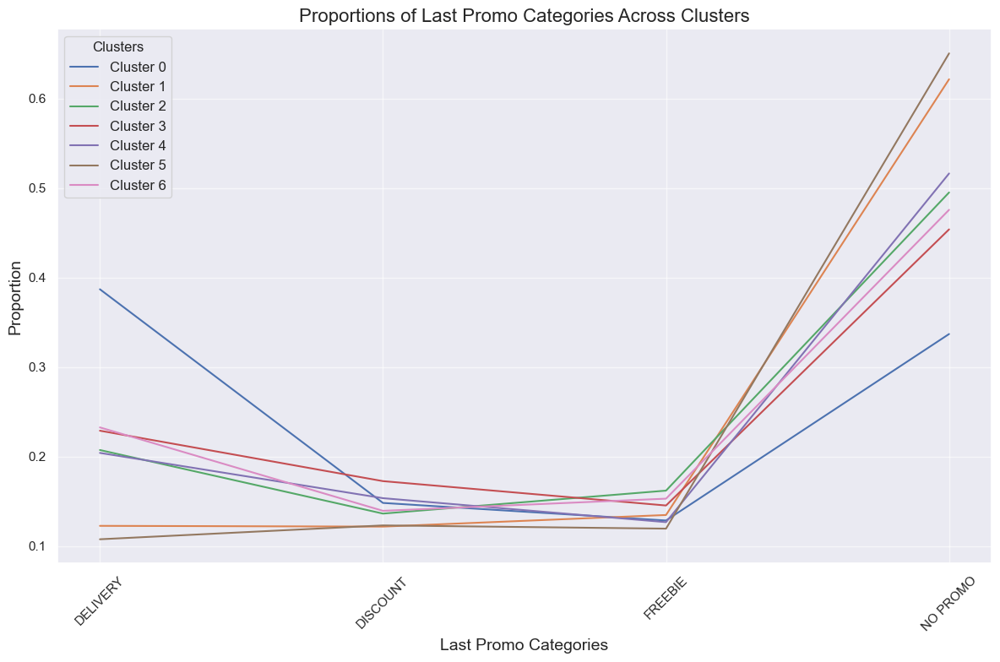

In [239]:
# Ensure the first column is correctly excluded from categories
proportions.reset_index(inplace=True)
categories = proportions.columns[1:]  # Exclude 'KM_merged_labels'

# Create the plot
plt.figure(figsize=(12, 8))

# Plot a line for each cluster
for cluster in proportions['KM_merged_labels']:
    cluster_values = proportions.loc[proportions['KM_merged_labels'] == cluster, categories].values.flatten()
    plt.plot(categories, cluster_values, label=f"Cluster {cluster}")

# Customize the plot
plt.title("Proportions of Last Promo Categories Across Clusters", fontsize=16)
plt.xlabel("Last Promo Categories", fontsize=14)
plt.ylabel("Proportion", fontsize=14)
plt.xticks(rotation=45)
plt.legend(title="Clusters", fontsize=12)
plt.grid(True, alpha=0.6)

# Show the plot
plt.tight_layout()
plt.show()


<Axes: xlabel='KM_merged_labels'>

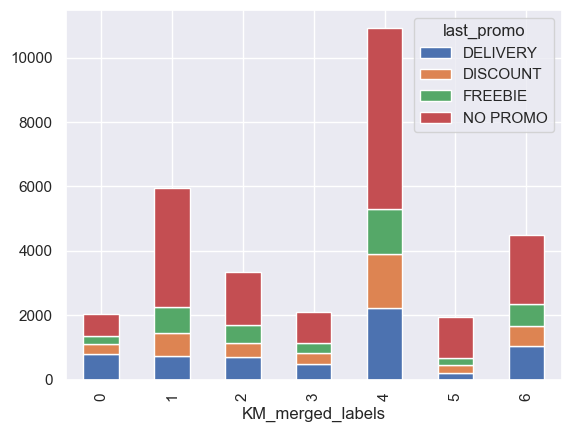

In [197]:
data.groupby([
    "KM_merged_labels", 
    "last_promo",])['last_promo'].size().unstack().plot.bar(stacked=True)

<Axes: xlabel='last_promo'>

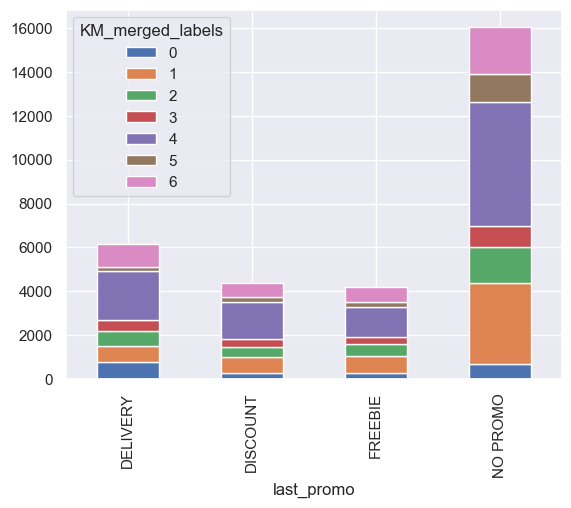

In [199]:
data.groupby(["last_promo","KM_merged_labels",])['KM_merged_labels'].size().unstack().plot.bar(stacked=True)

In [329]:
pd.crosstab(data["KM_merged_labels"],data["last_promo"])

last_promo,DELIVERY,DISCOUNT,FREEBIE,NO PROMO
merged_labels,,,,
0,789,302,262,687
1,479,361,304,950
2,208,238,231,1259
3,1045,626,687,2138
4,365,285,412,1370
5,2230,1677,1384,5644
6,329,171,130,288
7,726,722,793,3680
8,1,0,6,10


### 5.2 Payment Method

In [240]:
cat_payment_method = [col for col in data.columns if col.startswith('oh_payment_method')]

In [241]:
data_payment = data.groupby(['KM_merged_labels'])[cat_payment_method].sum()

data_payment

,oh_payment_method_CASH,oh_payment_method_DIGI
KM_merged_labels,,
0,451.582094,702.630798
1,-1187.671629,-545.120921
2,-2.308594,210.595540
3,97.354116,5.217646
4,677.442228,-59.801489
5,-301.698357,-254.172467
6,265.300143,-59.349107


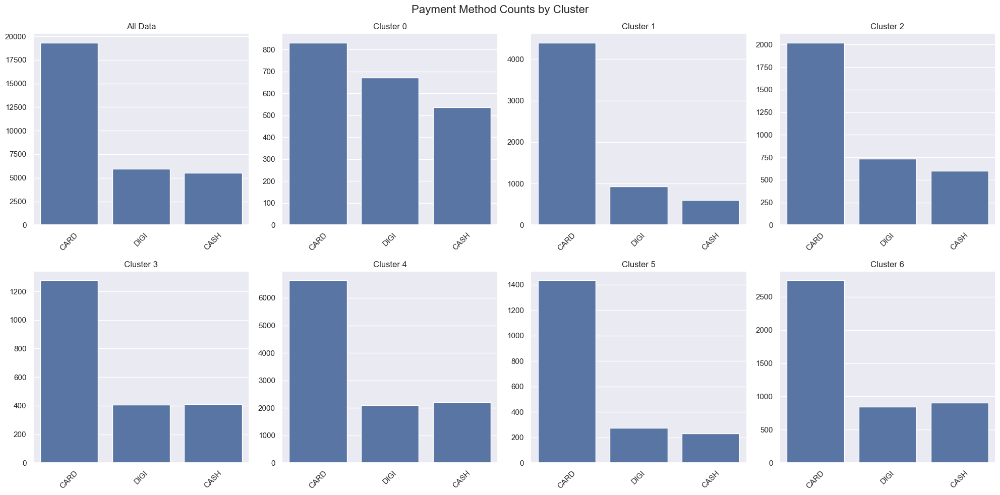

In [243]:
# Determine the number of unique clusters
n_clusters = data['KM_merged_labels'].nunique()

# Create a grid of subplots with 2 rows and 4 columns
fig, axes = plt.subplots(2, 4, figsize=(20, 10), tight_layout=True)
axes = axes.flatten()

# Loop through each cluster, including the "All Data" plot
for i in range(len(axes)):
    ax = axes[i]
    if i == 0:  # "All Data" plot
        sns.countplot(data=data, 
                      x='payment_method', 
                      order=data['payment_method'].value_counts().index,
                      ax=ax)
        ax.set_title("All Data")
    elif i <= n_clusters:  # Cluster-specific plots
        sns.countplot(data=data.loc[data['KM_merged_labels'] == i - 1], 
                      x='payment_method', 
                      order=data['payment_method'].value_counts().index,
                      ax=ax)
        ax.set_title(f"Cluster {i - 1}")
    else:  # Empty plots for remaining axes
        ax.axis('off')  # Turn off extra axes

    ax.tick_params(axis="x", labelrotation=45)
    ax.set_xlabel("")
    ax.set_ylabel("")

# Add a global title
plt.suptitle("Payment Method Counts by Cluster", fontsize=16)
plt.show()

In [244]:
# Calculate counts of each payment_method category within each cluster
counts = data.groupby(['KM_merged_labels', 'payment_method']).size().unstack(fill_value=0)
proportions = counts.div(counts.sum(axis=1), axis=0)

proportions

payment_method,CARD,CASH,DIGI
KM_merged_labels,,,
0,0.407353,0.263235,0.329412
1,0.740990,0.101886,0.157124
2,0.603582,0.178209,0.218209
3,0.609360,0.196275,0.194365
4,0.606584,0.202195,0.191221
5,0.739669,0.118802,0.141529
6,0.610765,0.201068,0.188167


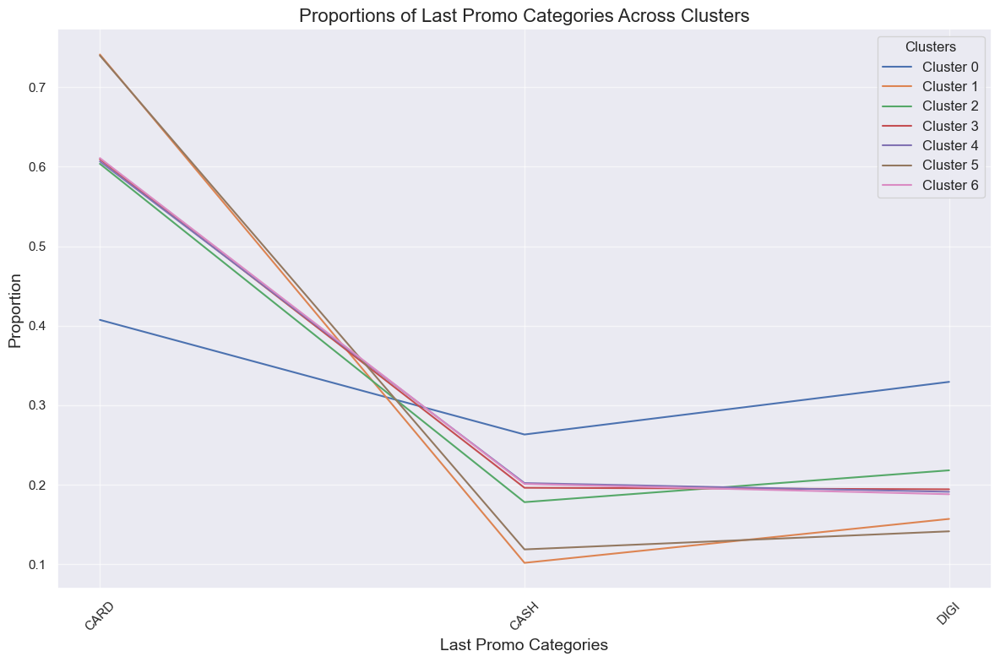

In [245]:
# Ensure the first column is correctly excluded from categories
proportions.reset_index(inplace=True)
categories = proportions.columns[1:]  # Exclude 'KM_merged_labels'

# Create the plot
plt.figure(figsize=(12, 8))

# Plot a line for each cluster
for cluster in proportions['KM_merged_labels']:
    cluster_values = proportions.loc[proportions['KM_merged_labels'] == cluster, categories].values.flatten()
    plt.plot(categories, cluster_values, label=f"Cluster {cluster}")

# Customize the plot
plt.title("Proportions of Last Promo Categories Across Clusters", fontsize=16)
plt.xlabel("Last Promo Categories", fontsize=14)
plt.ylabel("Proportion", fontsize=14)
plt.xticks(rotation=45)
plt.legend(title="Clusters", fontsize=12)
plt.grid(True, alpha=0.6)

# Show the plot
plt.tight_layout()
plt.show()

<Axes: xlabel='KM_merged_labels'>

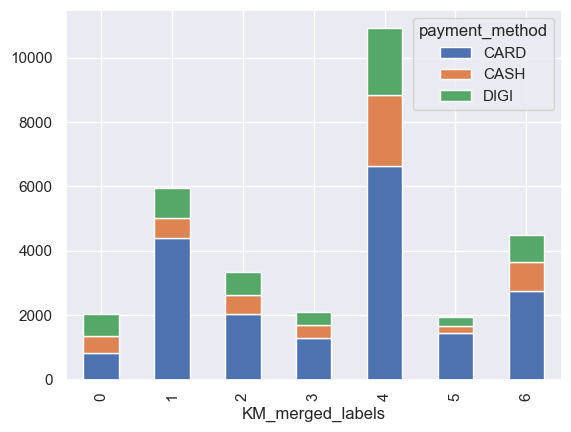

In [246]:
data.groupby([
    "KM_merged_labels", 
    "payment_method",
    ])['payment_method'].size().unstack().plot.bar(stacked=True)

<Axes: xlabel='payment_method'>

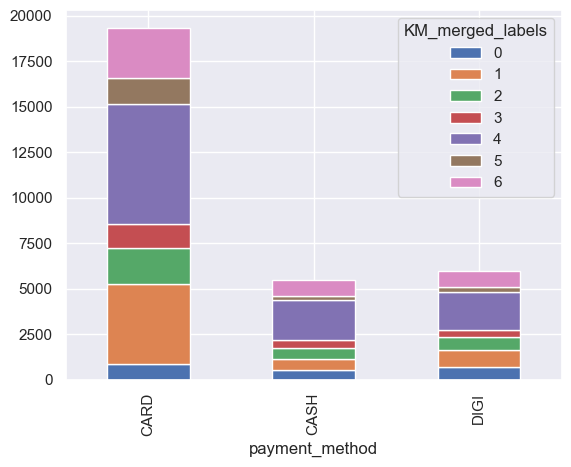

In [248]:
data.groupby([ 
    "payment_method",
    "KM_merged_labels",
    ])["KM_merged_labels"].size().unstack().plot.bar(stacked=True)

In [249]:
pd.crosstab(data["KM_merged_labels"],data["payment_method"])

payment_method,CARD,CASH,DIGI
KM_merged_labels,,,
0,831,537,672
1,4400,605,933
2,2022,597,731
3,1276,411,407
4,6633,2211,2091
5,1432,230,274
6,2746,904,846


### 5.3 Customer Region

In [250]:
cat_region = [col for col in data.columns if col.startswith('oh_customer_region')]

In [251]:
data_payment = data.groupby(['KM_merged_labels'])[cat_region].sum()

data_payment

,oh_customer_region_2440,oh_customer_region_2490,oh_customer_region_4140,oh_customer_region_4660,oh_customer_region_8370,oh_customer_region_8550,oh_customer_region_8670
KM_merged_labels,,,,,,,
0,-100.077770,-69.176415,3.750967,-118.172215,195.317215,61.044527,394.595955
1,345.695680,66.893413,-403.351507,677.752302,-408.235380,-15.925088,-1307.010795
2,-646.637980,-286.004952,-442.807489,-2034.126033,829.603437,136.503579,3930.903490
3,558.705684,193.629505,141.043141,-626.298055,-110.147904,9.315140,-996.735482
4,165.470336,205.140457,1267.302088,3113.626532,-891.782500,-215.921689,-4094.076019
5,354.810157,136.930874,-192.209678,-176.066218,-203.274531,-38.228111,-832.353984
6,-677.966108,-247.412882,-373.727524,-836.716313,588.519663,63.211642,2904.676835


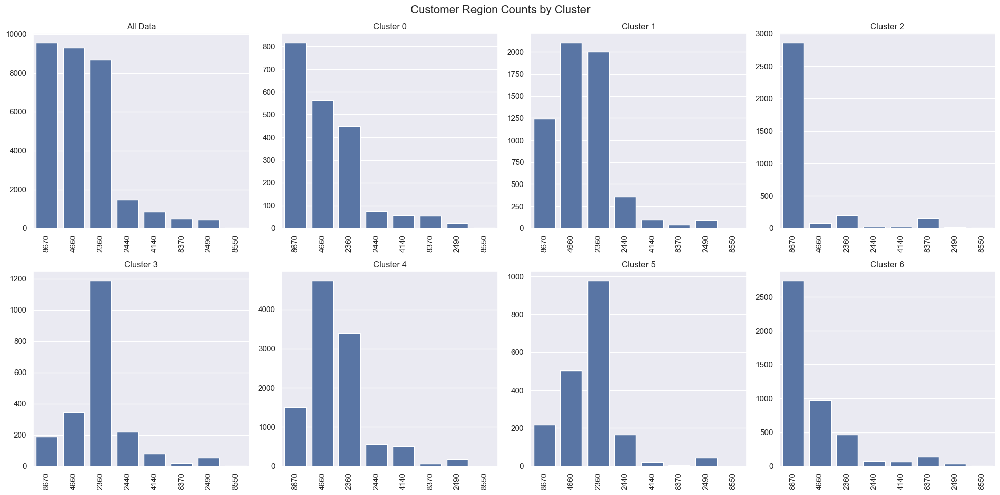

In [252]:
# Determine the number of unique clusters
n_clusters = data['KM_merged_labels'].nunique()

# Create a grid of subplots with 2 rows and 4 columns
fig, axes = plt.subplots(2, 4, figsize=(20, 10), tight_layout=True)

# Flatten axes for easy indexing
axes = axes.flatten()

# Loop through each cluster, including the "All Data" plot
for i in range(len(axes)):
    ax = axes[i]
    if i == 0:  # "All Data" plot
        sns.countplot(data=data, 
                      x='customer_region', 
                      order=data['customer_region'].value_counts().index,
                      ax=ax)
        ax.set_title("All Data")
    elif i <= n_clusters:  # Cluster-specific plots
        sns.countplot(data=data.loc[data['KM_merged_labels'] == i - 1], 
                      x='customer_region', 
                      order=data['customer_region'].value_counts().index,
                      ax=ax)
        ax.set_title(f"Cluster {i - 1}")
    else:  # Empty plots for remaining axes
        ax.axis('off')  # Turn off extra axes

    ax.tick_params(axis="x", labelrotation=90)
    ax.set_xlabel("")
    ax.set_ylabel("")

# Add a global title
plt.suptitle("Customer Region Counts by Cluster", fontsize=16)
plt.show()


In [253]:
# Calculate counts of each customer_region category within each cluster
counts = data.groupby(['KM_merged_labels', 'customer_region']).size().unstack(fill_value=0)
proportions = counts.div(counts.sum(axis=1), axis=0)

proportions

customer_region,2360,2440,2490,4140,4660,8370,8550,8670
KM_merged_labels,,,,,,,,
0,0.220588,0.037255,0.010294,0.027941,0.275490,0.027451,0.000980,0.400000
1,0.337151,0.060121,0.015662,0.016504,0.354496,0.007073,0.000337,0.208656
2,0.059104,0.006567,0.004179,0.005970,0.023284,0.046269,0.001194,0.853433
3,0.566858,0.104585,0.025310,0.038682,0.164756,0.009074,0.000478,0.090258
4,0.310288,0.050937,0.016552,0.046639,0.432830,0.005487,0.000000,0.137266
5,0.504649,0.086777,0.022727,0.011364,0.260331,0.002583,0.000000,0.111570
6,0.104093,0.015569,0.007785,0.014012,0.216637,0.031806,0.000667,0.609431


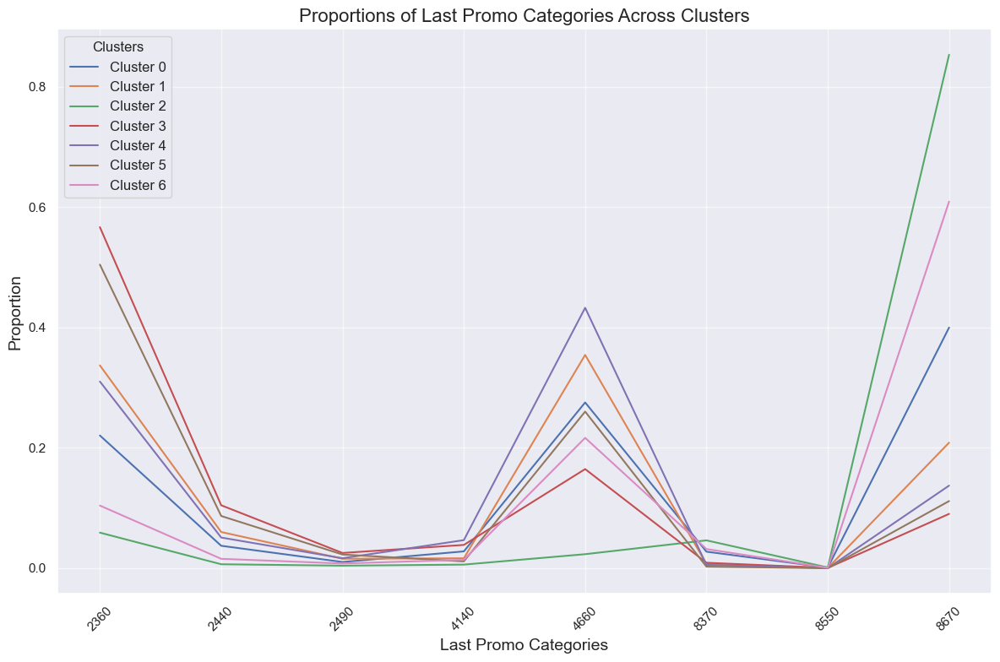

In [254]:
# Ensure the first column is correctly excluded from categories
proportions.reset_index(inplace=True)
categories = proportions.columns[1:]  # Exclude 'KM_merged_labels'

# Create the plot
plt.figure(figsize=(12, 8))

# Plot a line for each cluster
for cluster in proportions['KM_merged_labels']:
    cluster_values = proportions.loc[proportions['KM_merged_labels'] == cluster, categories].values.flatten()
    plt.plot(categories, cluster_values, label=f"Cluster {cluster}")

# Customize the plot
plt.title("Proportions of Last Promo Categories Across Clusters", fontsize=16)
plt.xlabel("Last Promo Categories", fontsize=14)
plt.ylabel("Proportion", fontsize=14)
plt.xticks(rotation=45)
plt.legend(title="Clusters", fontsize=12)
plt.grid(True, alpha=0.6)

# Show the plot
plt.tight_layout()
plt.show()


<Axes: xlabel='KM_merged_labels'>

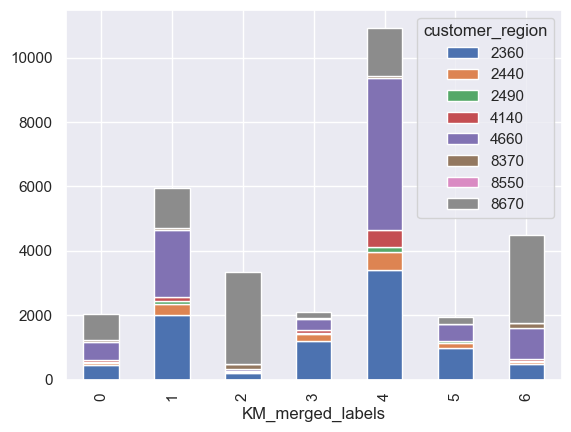

In [255]:
data.groupby([
    "KM_merged_labels", 
    "customer_region",
    ])['customer_region'].size().unstack().plot.bar(stacked=True)

<Axes: xlabel='customer_region'>

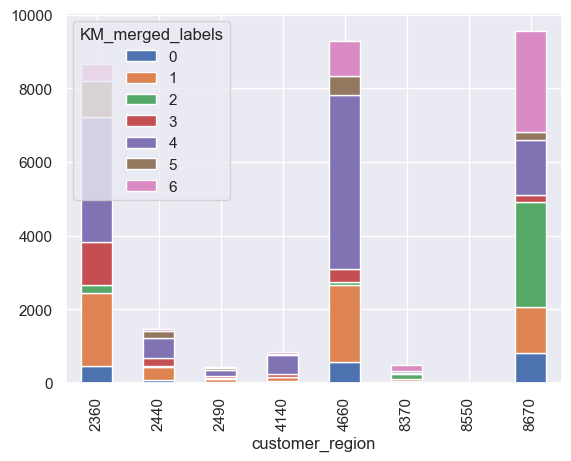

In [256]:
data.groupby([ 
    "customer_region",
    "KM_merged_labels",
    ])["KM_merged_labels"].size().unstack().plot.bar(stacked=True)

In [257]:
pd.crosstab(data["KM_merged_labels"],data["customer_region"])

customer_region,2360,2440,2490,4140,4660,8370,8550,8670
KM_merged_labels,,,,,,,,
0,450,76,21,57,562,56,2,816
1,2002,357,93,98,2105,42,2,1239
2,198,22,14,20,78,155,4,2859
3,1187,219,53,81,345,19,1,189
4,3393,557,181,510,4733,60,0,1501
5,977,168,44,22,504,5,0,216
6,468,70,35,63,974,143,3,2740


### 5.4 Customer Age

In [258]:
cat_age = [col for col in data.columns if col.startswith('oh_age_group')]

In [259]:
data_age = data.groupby(['KM_merged_labels'])[cat_age].sum()

data_age

,oh_age_group_19-25,oh_age_group_26-35,oh_age_group_36-45,oh_age_group_46-55,oh_age_group_56-65,oh_age_group_65+
KM_merged_labels,,,,,,
0,-9.607192,9.919869,-39.711769,9.359826,-4.832249,0.482055
1,-11.743542,36.656503,-12.606214,-9.257657,29.921619,-17.767171
2,71.021029,-52.393787,-58.154952,11.038841,-49.753599,28.892695
3,9.387748,21.347795,4.809154,-40.852206,25.454633,-1.583895
4,-152.754589,95.297203,74.094058,-45.207359,15.628462,0.466752
5,-4.744921,-67.051522,65.834599,38.516784,51.675720,4.460922
6,98.441467,-43.776061,-34.264876,36.401771,-68.094588,-14.951358


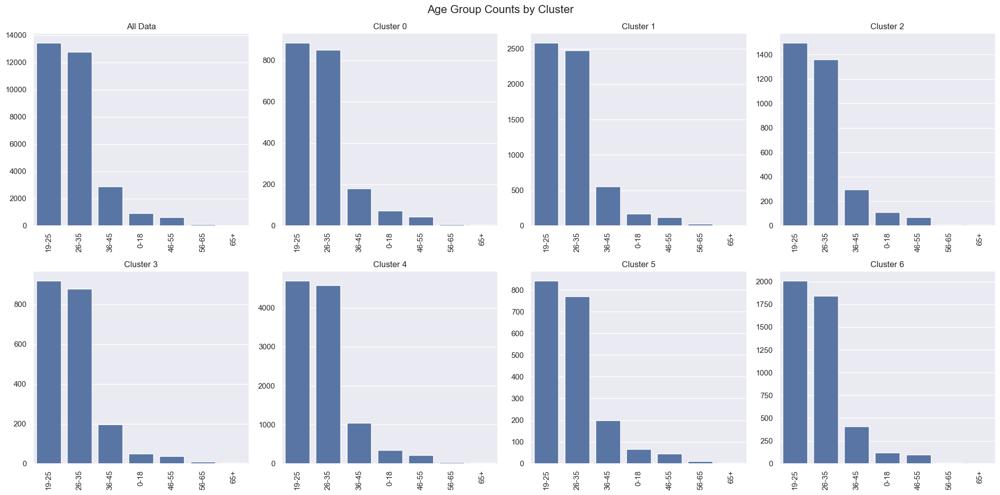

In [260]:
# Determine the number of unique clusters
n_clusters = data['KM_merged_labels'].nunique()

# Create a grid of subplots with 2 rows and 4 columns
fig, axes = plt.subplots(2, 4, figsize=(20, 10), tight_layout=True)

# Flatten axes for easy indexing
axes = axes.flatten()

# Loop through each cluster, including the "All Data" plot
for i in range(len(axes)):
    ax = axes[i]
    if i == 0:  # "All Data" plot
        sns.countplot(data=data, 
                      x='age_group', 
                      order=data['age_group'].value_counts().index,
                      ax=ax)
        ax.set_title("All Data")
    elif i <= n_clusters:  # Cluster-specific plots
        sns.countplot(data=data.loc[data['KM_merged_labels'] == i - 1], 
                      x='age_group', 
                      order=data['age_group'].value_counts().index,
                      ax=ax)
        ax.set_title(f"Cluster {i - 1}")
    else:  # Empty plots for remaining axes
        ax.axis('off')  # Turn off extra axes

    ax.tick_params(axis="x", labelrotation=90)
    ax.set_xlabel("")
    ax.set_ylabel("")

# Add a global title
plt.suptitle("Age Group Counts by Cluster", fontsize=16)
plt.show()

In [261]:
# Calculate counts of each age_group category within each cluster
counts = data.groupby(['KM_merged_labels', 'age_group']).size().unstack(fill_value=0)
proportions = counts.div(counts.sum(axis=1), axis=0)

proportions

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\2162577687.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



age_group,0-18,19-25,26-35,36-45,46-55,56-65,65+
KM_merged_labels,,,,,,,
0,0.035294,0.434314,0.416667,0.087745,0.021078,0.003431,0.001471
1,0.028798,0.435669,0.417312,0.092792,0.020209,0.003873,0.001347
2,0.032537,0.447164,0.406567,0.088358,0.020896,0.002687,0.001791
3,0.024355,0.438873,0.419293,0.094078,0.017670,0.004298,0.001433
4,0.031367,0.429721,0.418564,0.095382,0.019845,0.003658,0.001463
5,0.034091,0.435434,0.397211,0.103306,0.023244,0.005165,0.001550
6,0.026246,0.447509,0.409475,0.091192,0.021575,0.002669,0.001335


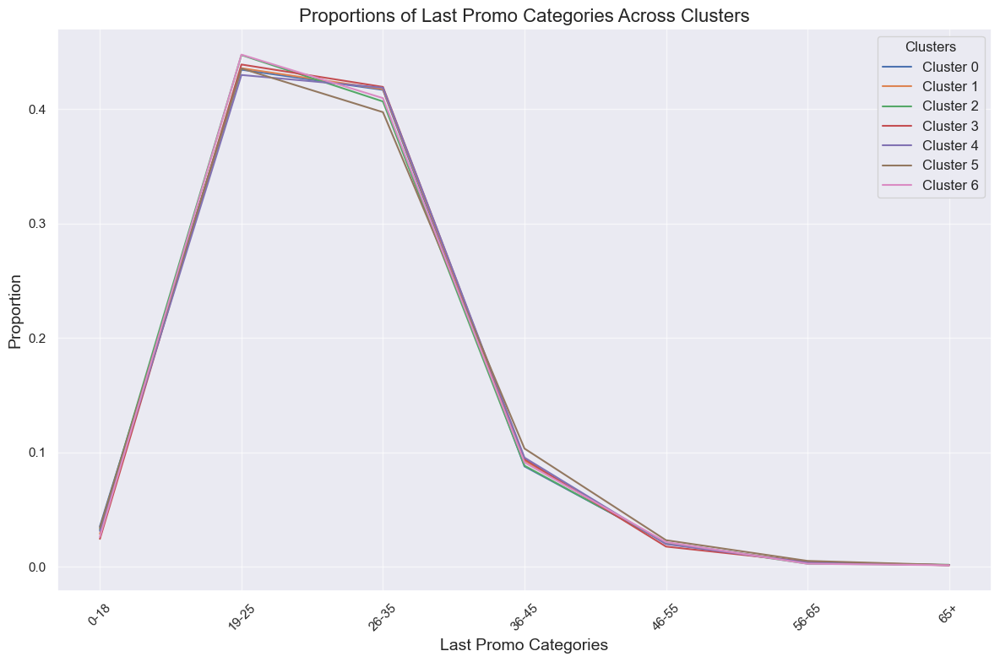

In [262]:
# Ensure the first column is correctly excluded from categories
proportions.reset_index(inplace=True)
categories = proportions.columns[1:]  # Exclude 'KM_merged_labels'

# Create the plot
plt.figure(figsize=(12, 8))

# Plot a line for each cluster
for cluster in proportions['KM_merged_labels']:
    cluster_values = proportions.loc[proportions['KM_merged_labels'] == cluster, categories].values.flatten()
    plt.plot(categories, cluster_values, label=f"Cluster {cluster}")

# Customize the plot
plt.title("Proportions of Last Promo Categories Across Clusters", fontsize=16)
plt.xlabel("Last Promo Categories", fontsize=14)
plt.ylabel("Proportion", fontsize=14)
plt.xticks(rotation=45)
plt.legend(title="Clusters", fontsize=12)
plt.grid(True, alpha=0.6)

# Show the plot
plt.tight_layout()
plt.show()

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\827565738.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



<Axes: xlabel='KM_merged_labels'>

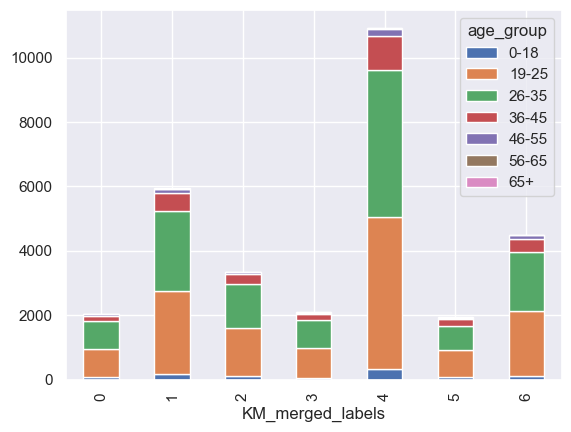

In [264]:
data.groupby([
    "KM_merged_labels", 
    "age_group",
    ])['age_group'].size().unstack().plot.bar(stacked=True)

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\2938486595.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



<Axes: xlabel='age_group'>

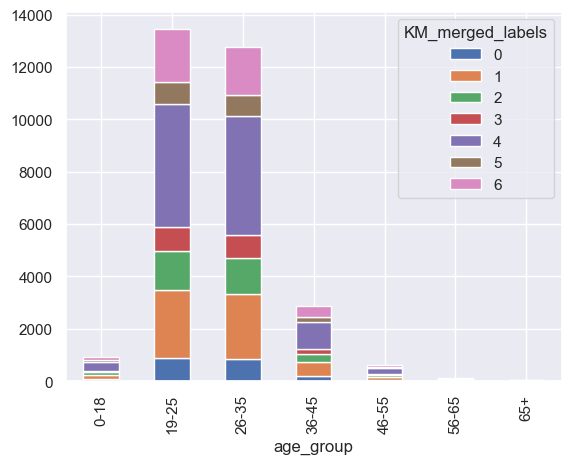

In [265]:
data.groupby([
    "age_group",
    "KM_merged_labels", 
    ])["KM_merged_labels"].size().unstack().plot.bar(stacked=True)

In [266]:
filtered_data = data[data['age_group'].isin(['56-65', '65+'])]

C:\Users\bruna\AppData\Local\Temp\ipykernel_19788\1127592291.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



<Axes: xlabel='age_group'>

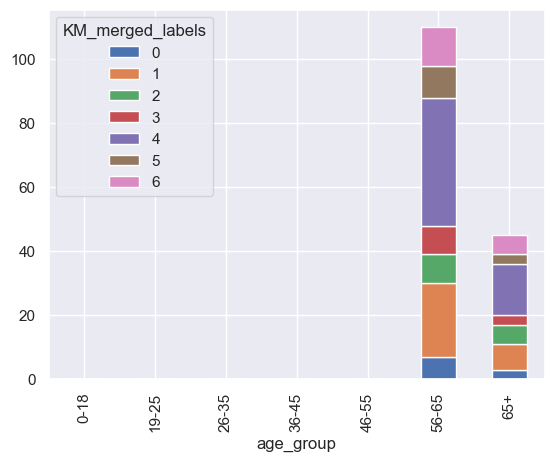

In [267]:
filtered_data.groupby([
    "age_group",
    "KM_merged_labels", 
    ])["KM_merged_labels"].size().unstack().plot.bar(stacked=True)

In [269]:
pd.crosstab(data["KM_merged_labels"],data["age_group"])

age_group,0-18,19-25,26-35,36-45,46-55,56-65,65+
KM_merged_labels,,,,,,,
0,72,886,850,179,43,7,3
1,171,2587,2478,551,120,23,8
2,109,1498,1362,296,70,9,6
3,51,919,878,197,37,9,3
4,343,4699,4577,1043,217,40,16
5,66,843,769,200,45,10,3
6,118,2012,1841,410,97,12,6


### 5.5 Cuisines

In [270]:
cat_cuisine = [col for col in data.columns if col.startswith('oh_top_cuisine')]

In [271]:
data_cuisine = data.groupby(['KM_merged_labels'])[cat_cuisine].sum()

data_cuisine

,oh_top_cuisine_CUI_Asian,oh_top_cuisine_CUI_Beverages,oh_top_cuisine_CUI_Cafe,oh_top_cuisine_CUI_Chicken Dishes,oh_top_cuisine_CUI_Chinese,oh_top_cuisine_CUI_Desserts,oh_top_cuisine_CUI_Healthy,oh_top_cuisine_CUI_Indian,oh_top_cuisine_CUI_Italian,oh_top_cuisine_CUI_Japanese,oh_top_cuisine_CUI_Noodle Dishes,oh_top_cuisine_CUI_OTHER,oh_top_cuisine_CUI_Street Food / Snacks,oh_top_cuisine_CUI_Thai
KM_merged_labels,,,,,,,,,,,,,,
0,-192.540553,-78.633837,-45.448910,-177.370765,-8.330171,130.236773,-164.221120,216.490757,-246.899659,25.542107,49.145212,56.723588,1042.770980,-78.930997
1,-297.416292,-559.840125,103.757358,245.669501,202.566747,-370.178482,24.195091,48.733653,-127.163950,151.373371,262.872115,804.009096,-385.262334,189.811028
2,2305.785265,323.015284,-371.669562,-597.470612,-252.693506,60.551303,124.735437,-601.481123,-973.713202,-250.773200,-301.156634,-966.902684,133.756905,-499.973246
3,-536.652533,32.457571,-135.861249,394.323214,329.353617,-144.410554,-199.267284,399.075879,103.495651,-254.676956,292.958721,297.178268,-210.930251,3.938634
4,-2172.209271,-530.997708,-433.583977,562.004647,-150.668831,-239.310966,-116.046354,472.331077,2316.947272,337.357932,-114.795439,285.456273,-830.046000,801.442495
5,-205.907737,-43.030855,193.608206,147.281517,347.477616,-129.295932,-21.046106,81.332730,-158.758025,-35.493884,325.974033,366.200236,-333.647728,2.650552
6,1098.941122,857.029671,689.198135,-574.437502,-467.705473,692.407859,351.650337,-616.482974,-913.908087,26.670629,-514.998008,-842.664776,583.358427,-418.938465


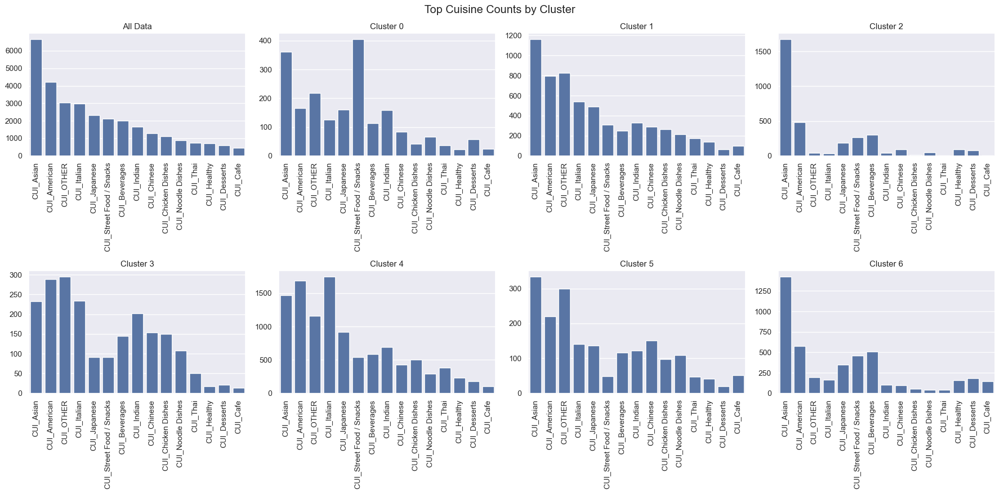

In [276]:
# Create a grid of subplots with 2 rows and 4 columns for filtered data
fig, axes = plt.subplots(2, 4, figsize=(20, 10), tight_layout=True)
axes = axes.flatten()

# Loop through each cluster and create the plots
for i in range(len(axes)):
    ax = axes[i]
    if i == 0:  # "All Data" plot for filtered data
        sns.countplot(data=data, 
                      x='top_cuisine', 
                      order=data['top_cuisine'].value_counts().index,
                      ax=ax)
        ax.set_title("All Data")
    elif i <= n_clusters:  # Cluster-specific plots
        sns.countplot(data=data.loc[data['KM_merged_labels'] == i - 1], 
                      x='top_cuisine', 
                      order=data['top_cuisine'].value_counts().index,
                      ax=ax)
        ax.set_title(f"Cluster {i - 1}")
    else:  # Empty plots for remaining axes
        ax.axis('off')  # Turn off extra axes

    ax.tick_params(axis="x", labelrotation=90)
    ax.set_xlabel("")
    ax.set_ylabel("")

# Add a global title
plt.suptitle("Top Cuisine Counts by Cluster", fontsize=16)
plt.show()

In [277]:
# Calculate counts of each top_cuisine category within each cluster
counts = data.groupby(['KM_merged_labels', 'top_cuisine']).size().unstack(fill_value=0)
proportions = counts.div(counts.sum(axis=1), axis=0)

proportions

top_cuisine,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai
KM_merged_labels,,,,,,,,,,,,,,,
0,0.080882,0.177451,0.055882,0.011765,0.020098,0.041176,0.028431,0.010784,0.077451,0.061275,0.078922,0.032353,0.106863,0.198529,0.018137
1,0.133715,0.195689,0.042102,0.016504,0.044123,0.048838,0.010946,0.023409,0.055406,0.090771,0.082351,0.035702,0.138936,0.052543,0.028966
2,0.143284,0.499701,0.089254,0.001194,0.002985,0.026866,0.022090,0.028358,0.013134,0.011045,0.055821,0.013433,0.012537,0.079104,0.001194
3,0.137536,0.110793,0.069245,0.006686,0.071633,0.073543,0.010029,0.008596,0.096466,0.111748,0.043457,0.051576,0.140879,0.043457,0.024355
4,0.154458,0.134522,0.053406,0.009694,0.045999,0.039232,0.016552,0.021216,0.063283,0.159854,0.083768,0.026612,0.106356,0.049749,0.035299
5,0.113636,0.172521,0.059917,0.026343,0.050620,0.077996,0.010331,0.021178,0.063017,0.072831,0.070764,0.056302,0.154959,0.025310,0.024277
6,0.128336,0.316948,0.112544,0.032696,0.012456,0.021130,0.040925,0.034475,0.022687,0.036922,0.077180,0.009342,0.042705,0.101868,0.009786


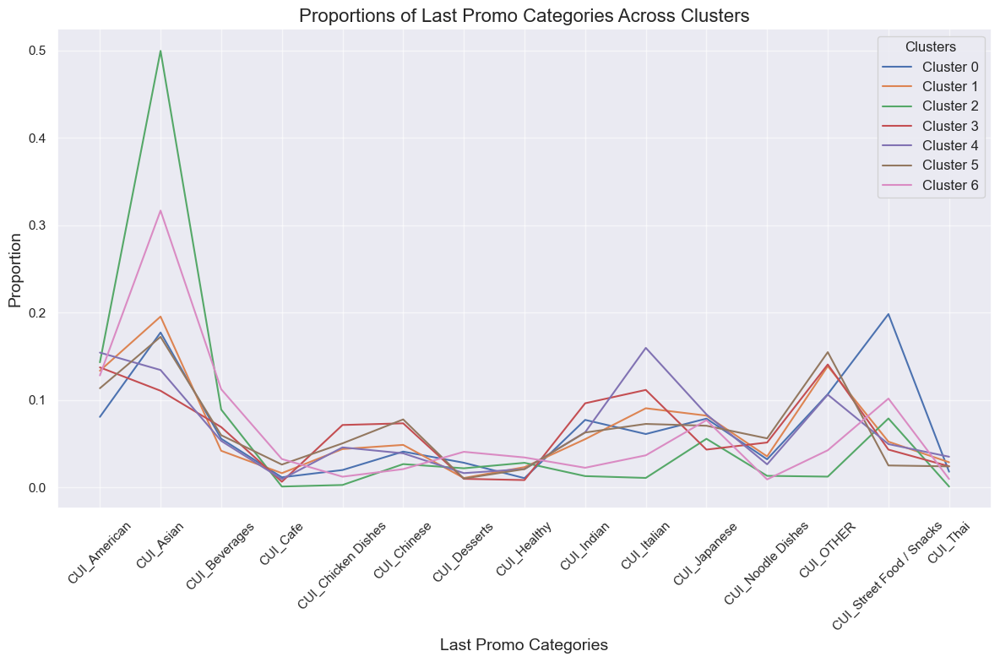

In [278]:
# Ensure the first column is correctly excluded from categories
proportions.reset_index(inplace=True)
categories = proportions.columns[1:]  # Exclude 'KM_merged_labels'

# Create the plot
plt.figure(figsize=(12, 8))

# Plot a line for each cluster
for cluster in proportions['KM_merged_labels']:
    cluster_values = proportions.loc[proportions['KM_merged_labels'] == cluster, categories].values.flatten()
    plt.plot(categories, cluster_values, label=f"Cluster {cluster}")

# Customize the plot
plt.title("Proportions of Last Promo Categories Across Clusters", fontsize=16)
plt.xlabel("Last Promo Categories", fontsize=14)
plt.ylabel("Proportion", fontsize=14)
plt.xticks(rotation=45)
plt.legend(title="Clusters", fontsize=12)
plt.grid(True, alpha=0.6)

# Show the plot
plt.tight_layout()
plt.show()

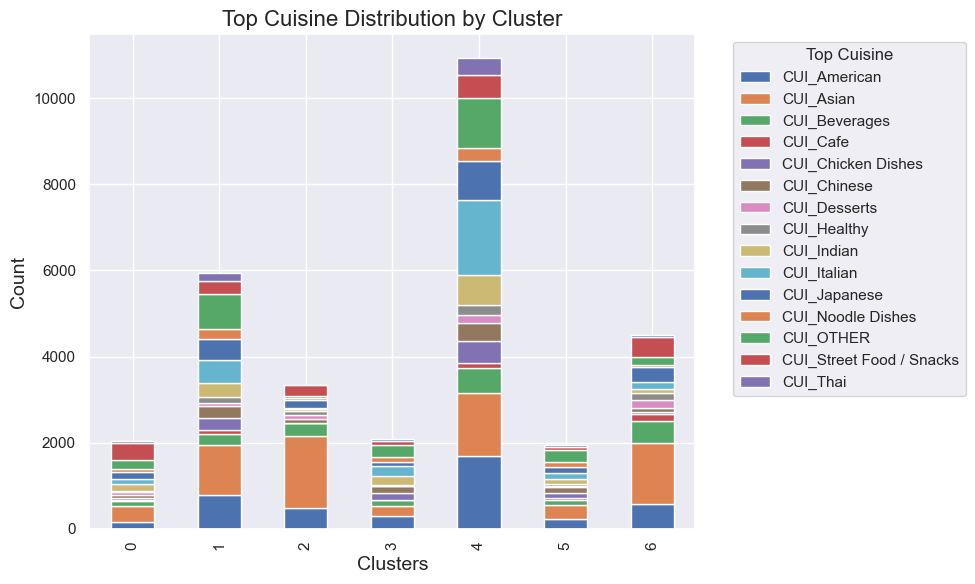

In [281]:
# Create the bar plot with the provided code
ax = data.groupby([
    "KM_merged_labels", 
    "top_cuisine",
])['top_cuisine'].size().unstack().plot.bar(stacked=True, figsize=(10, 6))

# Move the legend outside the plot area
ax.legend(title="Top Cuisine", bbox_to_anchor=(1.05, 1), loc='upper left')

# Customize the plot
plt.title("Top Cuisine Distribution by Cluster", fontsize=16)
plt.xlabel("Clusters", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.tight_layout()

# Show the plot
plt.show()


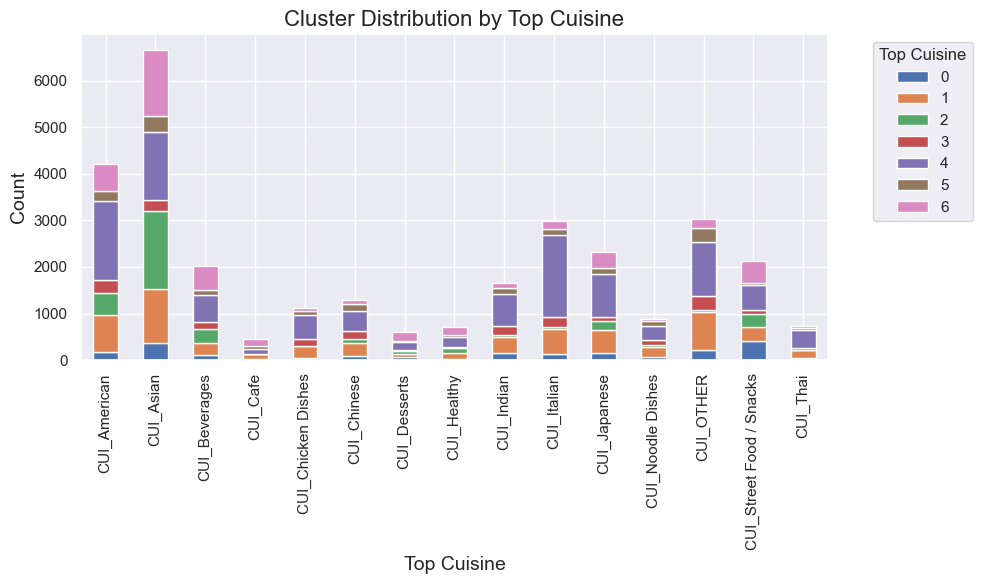

In [283]:
# Create the bar plot with the provided code
ax = data.groupby([
    "top_cuisine",
    "KM_merged_labels", 
])["KM_merged_labels"].size().unstack().plot.bar(stacked=True, figsize=(10, 6))

# Move the legend outside the plot area
ax.legend(title="Top Cuisine", bbox_to_anchor=(1.05, 1), loc='upper left')

# Customize the plot
plt.title("Cluster Distribution by Top Cuisine", fontsize=16)
plt.xlabel("Top Cuisine", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.tight_layout()

# Show the plot
plt.show()


In [285]:
pd.crosstab(data["KM_merged_labels"],data["top_cuisine"])

top_cuisine,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai
KM_merged_labels,,,,,,,,,,,,,,,
0,165,362,114,24,41,84,58,22,158,125,161,66,218,405,37
1,794,1162,250,98,262,290,65,139,329,539,489,212,825,312,172
2,480,1674,299,4,10,90,74,95,44,37,187,45,42,265,4
3,288,232,145,14,150,154,21,18,202,234,91,108,295,91,51
4,1689,1471,584,106,503,429,181,232,692,1748,916,291,1163,544,386
5,220,334,116,51,98,151,20,41,122,141,137,109,300,49,47
6,577,1425,506,147,56,95,184,155,102,166,347,42,192,458,44
